# Base de curvas de performances

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.optimize
import pandas as pd
import seaborn as sns
import random

In [2]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.model_selection import GridSearchCV, train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler

Rotação - Diâmetro externo - Diâmetro interno do olho do impelidor - Área de entrada - b2 - b3 - Esfera - GD2 - Número de pás

In [3]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.datasets import load_digits
from sklearn.model_selection import learning_curve
from sklearn.model_selection import ShuffleSplit


def plot_learning_curve(
    estimator,
    title,
    X,
    y,
    axes=None,
    ylim=None,
    cv=None,
    n_jobs=None,
    train_sizes=np.linspace(0.1, 1.0, 5),
):
    """
    Generate 3 plots: the test and training learning curve, the training
    samples vs fit times curve, the fit times vs score curve.

    Parameters
    ----------
    estimator : estimator instance
        An estimator instance implementing `fit` and `predict` methods which
        will be cloned for each validation.

    title : str
        Title for the chart.

    X : array-like of shape (n_samples, n_features)
        Training vector, where ``n_samples`` is the number of samples and
        ``n_features`` is the number of features.

    y : array-like of shape (n_samples) or (n_samples, n_features)
        Target relative to ``X`` for classification or regression;
        None for unsupervised learning.

    axes : array-like of shape (3,), default=None
        Axes to use for plotting the curves.

    ylim : tuple of shape (2,), default=None
        Defines minimum and maximum y-values plotted, e.g. (ymin, ymax).

    cv : int, cross-validation generator or an iterable, default=None
        Determines the cross-validation splitting strategy.
        Possible inputs for cv are:

          - None, to use the default 5-fold cross-validation,
          - integer, to specify the number of folds.
          - :term:`CV splitter`,
          - An iterable yielding (train, test) splits as arrays of indices.

        For integer/None inputs, if ``y`` is binary or multiclass,
        :class:`StratifiedKFold` used. If the estimator is not a classifier
        or if ``y`` is neither binary nor multiclass, :class:`KFold` is used.

        Refer :ref:`User Guide <cross_validation>` for the various
        cross-validators that can be used here.

    n_jobs : int or None, default=None
        Number of jobs to run in parallel.
        ``None`` means 1 unless in a :obj:`joblib.parallel_backend` context.
        ``-1`` means using all processors. See :term:`Glossary <n_jobs>`
        for more details.

    train_sizes : array-like of shape (n_ticks,)
        Relative or absolute numbers of training examples that will be used to
        generate the learning curve. If the ``dtype`` is float, it is regarded
        as a fraction of the maximum size of the training set (that is
        determined by the selected validation method), i.e. it has to be within
        (0, 1]. Otherwise it is interpreted as absolute sizes of the training
        sets. Note that for classification the number of samples usually have
        to be big enough to contain at least one sample from each class.
        (default: np.linspace(0.1, 1.0, 5))
    """
    ig, ax = plt.subplots()

    ax.set_ylim(bottom=ylim[0])

    plt.figsize=(20, 5)

    plt.title(title)

    plt.xlabel("Training examples")
    plt.ylabel("Score")

    train_sizes, train_scores, test_scores = learning_curve(
        estimator,
        X,
        y,
        cv=cv,
        n_jobs=n_jobs,
        train_sizes=train_sizes,
    )
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    print(train_sizes)
    print(train_scores_mean)
    print(test_scores_mean)


    # Plot learning curve
    plt.grid()
    plt.fill_between(
        train_sizes,
        train_scores_mean - train_scores_std,
        train_scores_mean + train_scores_std,
        alpha=0.1,
        color="r",
    )
    plt.fill_between(
        train_sizes,
        test_scores_mean - test_scores_std,
        test_scores_mean + test_scores_std,
        alpha=0.1,
        color="g",
    )
    plt.plot(
        train_sizes, train_scores_mean, "o-", color="r", label="Training score"
    )
    plt.plot(
        train_sizes, test_scores_mean, "o-", color="g", label="Cross-validation score"
    )
    plt.legend(loc="best")


    return plt

## 3x2x11FS

In [83]:
_2100_11_s_3x2x11FS = [[0,25,50,75,100,125,150,175,200,225,250,274],
                       [75.5,75.3,75.1,74.4,72.9,70.4,67.4,63,57.6,51.2,43.4,34.5],
                      [2100,11,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_2100_103_s_3x2x11FS = [[0.        ,  20.52454921,  41.04909842,  61.57364763,
        82.09819684, 102.62274606, 123.14729527, 143.67184448,
       164.19639369, 184.7209429 , 205.24549211, 224.94905935],
                       [66.19665289, 66.02129752, 65.84594215, 65.23219835, 63.91703306,
       61.72509091, 59.09476033, 55.23694215, 50.50234711, 44.89097521,
       38.0521157 , 30.24880165],
                       [2100,10.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_2100_95_s_3x2x11FS = [[0.        ,  16.10396319,  32.20792637,  48.31188956,
        64.41585274,  80.51981593,  96.62377911, 112.7277423 ,
       128.83170548, 144.93566867, 161.03963186, 176.49943651],
                      [56.31301653, 56.16384298, 56.01466942, 55.49256198, 54.37376033,
       52.50909091, 50.2714876 , 46.98966942, 42.96198347, 38.18842975,
       32.37066116, 25.73243802],
                      [2100,9.5,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_2100_87_s_3x2x11FS = [[0.        ,  12.36857626,  24.73715252,  37.10572878,
        49.47430503,  61.84288129,  74.21145755,  86.58003381,
        98.94861007, 111.31718633, 123.68576258, 135.55959579],
                      [47.22805785, 47.10295041, 46.97784298, 46.53996694, 45.60166116,
       44.03781818, 42.16120661, 39.40884298, 36.03094215, 32.02750413,
       27.14831405, 21.58103306],
                      [2100,8.7,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_2350_11_s_3x2x11FS = [[0,25,50,75,100,125,150,175,200,225,250,275,300,307],
                               [95,95,94,93,92,90,87,83,78,72,64,56,46,43],
                      [2350,11,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_2350_103_s_3x2x11FS = [[0,  20.52454921,  41.04909842,  61.57364763,
        82.09819684, 102.62274606, 123.14729527, 143.67184448,
       164.19639369, 184.7209429 , 205.24549211, 225.77004132,
       246.29459053, 252.04146431],
                       [83.29380165, 83.29380165, 82.41702479, 81.54024793, 80.66347107,
       78.90991736, 76.27958678, 72.77247934, 68.38859504, 63.12793388,
       56.11371901, 49.09950413, 40.33173554, 37.70140496],
                       [2350,10.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_2350_97_s_3x2x11FS = [[0.        ,  17.14261833,  34.28523666,  51.427855  ,
        68.57047333,  85.71309166, 102.85570999, 119.99832832,
       137.14094666, 154.28356499, 171.42618332, 188.56880165,
       205.71141998, 210.51135312],
                      [73.87231405, 73.87231405, 73.09471074, 72.31710744, 71.53950413,
       69.98429752, 67.6514876 , 64.54107438, 60.65305785, 55.98743802,
       49.76661157, 43.54578512, 35.76975207, 33.43694215],
                      [2350,9.7,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_2350_9_s_3x2x11FS = [[ 0.        ,  13.69271225,  27.38542449,  41.07813674,
        54.77084899,  68.46356123,  82.15627348,  95.84898573,
       109.54169797, 123.23441022, 136.92712246, 150.61983471,
       164.31254696, 168.14650639],
                     [63.59504132, 63.59504132, 62.92561983, 62.25619835, 61.58677686,
       60.24793388, 58.23966942, 55.56198347, 52.21487603, 48.19834711,
       42.84297521, 37.48760331, 30.79338843, 28.78512397],
                     [2350,9,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_2350_83_s_3x2x11FS = [[0.        ,  10.7398009 ,  21.4796018 ,  32.2194027 ,
        42.95920361,  53.69900451,  64.43880541,  75.17860631,
        85.91840721,  96.65820811, 107.39800902, 118.13780992,
       128.87761082, 131.88475507],
                      [54.08719008, 54.08719008, 53.51785124, 52.9485124 , 52.37917355,
       51.24049587, 49.53247934, 47.25512397, 44.40842975, 40.99239669,
       36.43768595, 31.88297521, 26.18958678, 24.48157025],
                      [2350,8.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_2350_76_s_3x2x11FS = [[0.        ,   8.24522915,  16.4904583 ,  24.73568745,
        32.9809166 ,  41.22614576,  49.47137491,  57.71660406,
        65.96183321,  74.20706236,  82.45229151,  90.69752066,
        98.94274981, 101.25141397],
                      [45.34876033, 45.34876033, 44.87140496, 44.39404959, 43.91669421,
       42.96198347, 41.52991736, 39.62049587, 37.23371901, 34.36958678,
       30.5507438 , 26.73190083, 21.95834711, 20.52628099],
                      [2350,7.6,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_2960_11_s_3x2x11FS = [[0,25,50,75,100,125,150,175,200,225,250,275,300,318],
                                   [147.5,148,148,147.5,146,145,143,140,136,130,123,114,104,96],
                      [2960,11,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_2960_103_s_3x2x11FS = [[0.        ,  20.52454921,  41.04909842,  61.57364763,
        82.09819684, 102.62274606, 123.14729527, 143.67184448,
       164.19639369, 184.7209429 , 205.24549211, 225.77004132,
       246.29459053, 261.07226597],
                       [129.32458678, 129.76297521, 129.76297521, 129.32458678,
       128.00942149, 127.13264463, 125.37909091, 122.74876033,
       119.24165289, 113.98099174, 107.84355372,  99.95256198,
        91.18479339,  84.17057851],
                       [2960,10.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_2960_97_s_3x2x11FS = [[0.        ,  17.14261833,  34.28523666,  51.427855  ,
        68.57047333,  85.71309166, 102.85570999, 119.99832832,
       137.14094666, 154.28356499, 171.42618332, 188.56880165,
       205.71141998, 218.05410518],
                      [114.6964876 , 115.08528926, 115.08528926, 114.6964876 ,
       113.53008264, 112.75247934, 111.19727273, 108.86446281,
       105.75404959, 101.08842975,  95.64520661,  88.64677686,
        80.8707438 ,  74.64991736],
                      [2960,9.7,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_2960_9_s_3x2x11FS = [[0.        ,  13.69271225,  27.38542449,  41.07813674,
        54.77084899,  68.46356123,  82.15627348,  95.84898573,
       109.54169797, 123.23441022, 136.92712246, 150.61983471,
       164.31254696, 174.17129977],
                     [98.73966942, 99.07438017, 99.07438017, 98.73966942, 97.73553719,
       97.0661157 , 95.72727273, 93.71900826, 91.04132231, 87.02479339,
       82.33884298, 76.31404959, 69.61983471, 64.26446281],
                     [2960,9,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_2960_83_s_3x2x11FS = [[0.        ,  10.7398009 ,  21.4796018 ,  32.2194027 ,
        42.95920361,  53.69900451,  64.43880541,  75.17860631,
        85.91840721,  96.65820811, 107.39800902, 118.13780992,
       128.87761082, 136.61026747],
                      [83.97747934, 84.26214876, 84.26214876, 83.97747934, 83.12347107,
       82.55413223, 81.41545455, 79.70743802, 77.43008264, 74.01404959,
       70.02867769, 64.9046281 , 59.21123967, 54.65652893],
                      [2960,8.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_2960_76_s_3x2x11FS = [list(np.array(_2960_11_s_3x2x11FS[0])*(7.6/11)**3),
                      list(np.array(_2960_11_s_3x2x11FS[1])*(7.6/11)),
                      [2960,7.6,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_3000_11_s_3x2x11FS = [[0,25,50,75,100,125,150,175,200,225,250,275,300,322.5],
                                   [152,152,152,151,150,149,147,144,140,135,127,119,109,98],
                      [3000,11,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_3000_103_s_3x2x11FS = [list(np.array(_3000_11_s_3x2x11FS[0])*(10.3/11)**3),
                       list(np.array(_3000_11_s_3x2x11FS[1])*(10.3/11)**2),
                       [3000,10.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_3000_97_s_3x2x11FS = [list(np.array(_3000_11_s_3x2x11FS[0])*(9.7/11)**3),
                      list(np.array(_3000_11_s_3x2x11FS[1])*(9.7/11)**2),
                      [3000,9.7,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_3000_9_s_3x2x11FS = [list(np.array(_3000_11_s_3x2x11FS[0])*(9/11)**3),
                     list(np.array(_3000_11_s_3x2x11FS[1])*(9/11)**2),
                     [3000,9,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_3000_83_s_3x2x11FS = [list(np.array(_3000_11_s_3x2x11FS[0])*(8.3/11)**3),
                      list(np.array(_3000_11_s_3x2x11FS[1])*(8.3/11)**2),
                      [3000,8.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_3000_76_s_3x2x11FS = [list(np.array(_3000_11_s_3x2x11FS[0])*(7.6/11)**3),
                      list(np.array(_3000_11_s_3x2x11FS[1])*(7.6/11)**2),
                      [3000,7.6,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_3300_11_s_3x2x11FS = [[0,25,50,75,100,125,150,175,200,225,250,275,300,325,350,355],
                               [184,184,184,183,182.5,181,179,176,173,168,162,154,145,134,122,119],
                      [3300,11,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_3300_103_s_3x2x11FS = [list(np.array(_3300_11_s_3x2x11FS[0])*(10.3/11)**3),
                       list(np.array(_3300_11_s_3x2x11FS[1])*(10.3/11)**2),
                       [3300,10.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_3300_97_s_3x2x11FS = [list(np.array(_3300_11_s_3x2x11FS[0])*(9.7/11)**3),
                      list(np.array(_3300_11_s_3x2x11FS[1])*(9.7/11)**2),
                      [3300,9.7,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_3300_9_s_3x2x11FS = [list(np.array(_3300_11_s_3x2x11FS[0])*(9/11)**3),
                     list(np.array(_3300_11_s_3x2x11FS[1])*(9/11)**2),
                     [3300,9,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_3300_83_s_3x2x11FS = [list(np.array(_3300_11_s_3x2x11FS[0])*(8.3/11)**3),
                      list(np.array(_3300_11_s_3x2x11FS[1])*(8.3/11)**2),
                      [3300,8.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_3300_76_s_3x2x11FS = [list(np.array(_3300_11_s_3x2x11FS[0])*(7.6/11)**3),
                      list(np.array(_3300_11_s_3x2x11FS[1])*(7.6/11)**2),
                      [3300,7.6,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_3550_11_s_3x2x11FS = [[0,25,50,75,100,125,150,175,200,225,250,275,300,325,350,375,382],
                               [212.5,212.5,212.5,212,211,210,209,206,202.5,198,192.5,186,177,167,155,141,137.5],
                      [3550,11,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_3550_103_s_3x2x11FS = [list(np.array(_3550_11_s_3x2x11FS[0])*(10.3/11)**3),
                      list(np.array(_3550_11_s_3x2x11FS[1])*(10.3/11)**2),
                       [3550,10.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_3550_97_s_3x2x11FS = [list(np.array(_3550_11_s_3x2x11FS[0])*(9.7/11)**3),
                      list(np.array(_3550_11_s_3x2x11FS[1])*(9.7/11)**2),
                      [3550,9.7,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_3550_9_s_3x2x11FS = [list(np.array(_3550_11_s_3x2x11FS[0])*(9/11)**3),
                     list(np.array(_3550_11_s_3x2x11FS[1])*(9/11)**2),
                     [3550,9,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_3550_83_s_3x2x11FS = [list(np.array(_3550_11_s_3x2x11FS[0])*(8.3/11)**3),
                      list(np.array(_3550_11_s_3x2x11FS[1])*(8.3/11)**2),
                      [3550,8.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

_3550_76_s_3x2x11FS = [list(np.array(_3550_11_s_3x2x11FS[0])*(7.6/11)**3),
                      list(np.array(_3550_11_s_3x2x11FS[1])*(7.6/11)**2),
                      [3550,7.6,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']]

##  6x4x9F

In [84]:
_2950_98_6x4x9F = [[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700,750,800,850,890],
                            [115,115,114,112,110,108,106,104,102,99,96,92.5,88,84,78,73,67,60,54],
                  [2950,9.8,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']]

_2950_91_6x4x9F = [list(np.array(_2950_98_6x4x9F[0])*(9.1/9.8)**3),
                  list(np.array(_2950_98_6x4x9F[1])*(9.1/9.8)**2),
                  [2950,9.1,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']]

_2950_84_6x4x9F = [list(np.array(_2950_98_6x4x9F[0])*(8.4/9.8)**3),
                  list(np.array(_2950_98_6x4x9F[1])*(8.4/9.8)**2),
                  [2950,8.4,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']]

_2950_77_6x4x9F = [list(np.array(_2950_98_6x4x9F[0])*(7.7/9.8)**3),
                  list(np.array(_2950_98_6x4x9F[1])*(7.7/9.8)**2),
                  [2950,7.7,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']]

_2950_7_6x4x9F = [list(np.array(_2950_98_6x4x9F[0])*(7/9.8)**3),
                 list(np.array(_2950_98_6x4x9F[1])*(7/9.8)**2),
                 [2950,7,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']]

_3000_98_6x4x9F = [[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700,750,800,850,900],
                            [117,116,115,113,112,110,108,105,103,100,97.5,94,90,85,80,74,67,61,54],
                  [3000,9.8,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']]

_3000_91_6x4x9F = [list(np.array(_3000_98_6x4x9F[0])*(9.1/9.8)**3),
                  list(np.array(_2950_98_6x4x9F[1])*(9.1/9.8)**2),
                  [3000,9.1,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']]

_3000_84_6x4x9F = [list(np.array(_3000_98_6x4x9F[0])*(8.4/9.8)**3),
                  list(np.array(_2950_98_6x4x9F[1])*(8.4/9.8)**2),
                  [3000,8.4,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']]

_3000_77_6x4x9F = [list(np.array(_3000_98_6x4x9F[0])*(7.7/9.8)**3),
                  list(np.array(_2950_98_6x4x9F[1])*(7.7/9.8)**2),
                  [3000,7.7,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']]

_3000_7_6x4x9F = [list(np.array(_3000_98_6x4x9F[0])*(7/9.8)**3),
                  list(np.array(_2950_98_6x4x9F[1])*(7/9.8)**2),
                 [3000,7,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']]

_3300_98_6x4x9F = [[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700,750,800,850,900,950,980],
                           [141,140,139,138,136,134,132,130,127.5,124,121,117.5,114,109,105,99,93,87,80,72,67],
                  [3300,9.8,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']]

_3300_91_6x4x9F = [list(np.array(_3300_98_6x4x9F[0])*(9.1/9.8)**3),
                  list(np.array(_3300_98_6x4x9F[1])*(9.1/9.8)**2),
                  [3300,9.1,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']]

_3300_84_6x4x9F = [list(np.array(_3300_98_6x4x9F[0])*(8.4/9.8)**3),
                  list(np.array(_3300_98_6x4x9F[1])*(8.4/9.8)**2),
                  [3300,8.4,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']]

_3300_77_6x4x9F = [list(np.array(_3300_98_6x4x9F[0])*(7.7/9.8)**3),
                  list(np.array(_3300_98_6x4x9F[1])*(7.7/9.8)**2),
                  [3300,7.7,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']]

_3300_7_6x4x9F = [list(np.array(_3300_98_6x4x9F[0])*(7/9.8)**3),
                  list(np.array(_3300_98_6x4x9F[1])*(7/9.8)**2),
                 [3300,7,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']]

_3550_98_6x4x9F = [[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700,750,800,850,900,950,980],
                            [164,162.5,161,159,157.5,156,154,151,149,146,143,140,135.5,131,126,121,115,109,102,95,90],
                  [3550,9.8,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']]

_3550_91_6x4x9F = [list(np.array(_3550_98_6x4x9F[0])*(9.1/9.8)**3),
                  list(np.array(_3550_98_6x4x9F[1])*(9.1/9.8)**2),
                  [3550,9.1,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']]

_3550_84_6x4x9F = [list(np.array(_3550_98_6x4x9F[0])*(8.4/9.8)**3),
                  list(np.array(_3550_98_6x4x9F[1])*(8.4/9.8)**2),
                  [3550,8.4,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']]

_3550_77_6x4x9F = [list(np.array(_3550_98_6x4x9F[0])*(7.7/9.8)**3),
                  list(np.array(_3550_98_6x4x9F[1])*(7.7/9.8)**2),
                  [3550,7.7,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']]

_3550_7_6x4x9F = [list(np.array(_3550_98_6x4x9F[0])*(7/9.8)**3),
                  list(np.array(_3550_98_6x4x9F[1])*(7/9.8)**2),
                 [3550,7,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']]

## 6x4x10F-M

In [85]:
_6x4x10FM_2960_12 = [[0,100,200,300,400,500,600,700,800,900,1000,1070],
                        [175,175,175,174,171,167.5,162.5,156,148,138,128,120],
                      [2960,12,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']]

_6x4x10FM_2960_11 = [list(np.array(_6x4x10FM_2960_12[0])*(11/12)**3),
                  list(np.array(_6x4x10FM_2960_12[1])*(11/12)**2),
                    [2960,11,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']]

_6x4x10FM_2960_10 = [list(np.array(_6x4x10FM_2960_12[0])*(10/12)**3),
                  list(np.array(_6x4x10FM_2960_12[1])*(10/12)**2),
                    [2960,10,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']]

_6x4x10FM_3000_12 = [[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700,750,800,850,900,950,995],
                      [187.5,187.5,187,187,186,185,184,183,182,180,177.5,175.5,173,170,167.5,164,160,157,152,147.5,143],
                      [3000,12,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']]

_6x4x10FM_3000_115 = [list(np.array(_6x4x10FM_3000_12[0])*(11.5/12)**3),
                  list(np.array(_6x4x10FM_3000_12[1])*(11.5/12)**2),
                     [3000,11.5,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']]

_6x4x10FM_3000_109 = [list(np.array(_6x4x10FM_3000_12[0])*(10.9/12)**3),
                  list(np.array(_6x4x10FM_3000_12[1])*(10.9/12)**2),
                     [3000,10.9,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']]

_6x4x10FM_3000_104 = [list(np.array(_6x4x10FM_3000_12[0])*(10.4/12)**3),
                  list(np.array(_6x4x10FM_3000_12[1])*(10.4/12)**2),
                     [3000,10.4,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']]

_6x4x10FM_3300_12 = [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1230],
                     [227.5,227,226,225,223,220,216,210,204,195,185,173,161,152],
                     [3300,12,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']]

_6x4x10FM_3300_109 = [list(np.array(_6x4x10FM_3300_12[0])*(10.9/12)**3),
                  list(np.array(_6x4x10FM_3300_12[1])*(10.9/12)**2),
                     [3300,10.9,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']]

_6x4x10FM_3300_98 = [list(np.array(_6x4x10FM_3300_12[0])*(9.8/12)**3),
                  list(np.array(_6x4x10FM_3300_12[1])*(9.8/12)**2),
                    [3300,9.8,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']]

_6x4x10FM_3300_88 = [list(np.array(_6x4x10FM_3300_12[0])*(8.8/12)**3),
                  list(np.array(_6x4x10FM_3300_12[1])*(8.8/12)**2),
                    [3300,8.8,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']]

_6x4x10FM_3555_12 = [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1418],
                     [265,265,264,262,260,256,251,245,237,227.5,217,205,191,176,159,157],
                     [3555,12,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']]

_6x4x10FM_3555_109 = [list(np.array(_6x4x10FM_3555_12[0])*(10.9/12)**3),
                  list(np.array(_6x4x10FM_3555_12[1])*(10.9/12)**2),
                     [3555,10.9,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']]

_6x4x10FM_3555_98 = [list(np.array(_6x4x10FM_3555_12[0])*(9.8/12)**3),
                  list(np.array(_6x4x10FM_3555_12[1])*(9.8/12)**2),
                    [3555,9.8,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']]

_6x4x10FM_3555_87 = [list(np.array(_6x4x10FM_3555_12[0])*(8.7/12)**3),
                  list(np.array(_6x4x10FM_3555_12[1])*(8.7/12)**2),
                    [3555,8.7,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']]

## 6x4x11F

In [86]:
_6x4x11F_2960_116 = [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1500,1600,1620],
                    [174.5,174.5,174.5,174,173,172,170,167.5,165,161.5,157,151,145,137.5,130,120,110,108],
                    [2960,11.6,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']]

_6x4x11F_2960_105 = [list(np.array(_6x4x11F_2960_116[0])*(10.5/11.6)**3),
                  list(np.array(_6x4x11F_2960_116[1])*(10.5/11.6)**2),
                    [2960,10.5,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']]

_6x4x11F_3000_116 = [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1500,1600,1640],
                    [178,178,178,177.5,177,176,175,172.5,169,165,160,155,148,140,132.5,124,115,110],
                    [3000,11.6,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']]

_6x4x11F_3000_105 = [list(np.array(_6x4x11F_3000_116[0])*(10.5/11.6)**3),
                  list(np.array(_6x4x11F_3000_116[1])*(10.5/11.6)**2),
                    [3000,10.5,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']]

_6x4x11F_3300_116 = [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1650],
                    [212.5,212.5,212.5,212.5,211,210,207.5,203,197.5,191,182.5,170.2,162,150,147.5],
                    [3300,11.6,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']]

_6x4x11F_3300_103 = [list(np.array(_6x4x11F_3300_116[0])*(10.3/11.6)**3),
                  list(np.array(_6x4x11F_3300_116[1])*(10.3/11.6)**2),
                    [3300,10.3,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']]

_6x4x11F_3300_9 = [list(np.array(_6x4x11F_3300_116[0])*(9/11.6)**3),
                  list(np.array(_6x4x11F_3300_116[1])*(9/11.6)**2),
                  [3300,9,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']]

_6x4x11F_3555_116 = [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1800],
                    [249,249,249,249,248,246,244.5,240,235,227.5,220,210,197,188,168,162],
                    [3555,11.6,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']]

_6x4x11F_3555_103 = [list(np.array(_6x4x11F_3555_116[0])*(10.3/11.6)**3),
                  list(np.array(_6x4x11F_3555_116[1])*(10.3/11.6)**2),
                    [3555,10.3,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']]

_6x4x11F_3555_9 = [list(np.array(_6x4x11F_3555_116[0])*(9/11.6)**3),
                  list(np.array(_6x4x11F_3555_116[1])*(9/11.6)**2),
                  [3555,9,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']]

## 6x4x12F-M

In [87]:
_6x4x12FM_1470_137 = [[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700,750,800,850,900],
                     [60,60,59.9,59.6,59.3,59,58.7,58,57.3,56.5,55.3,54,52.6,51,49,46.7,44.2,41.8,39],
                     [1470,13.7,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']]

_6x4x12FM_1470_124 = [list(np.array(_6x4x12FM_1470_137[0])*(12.4/13.7)**3),
                  list(np.array(_6x4x12FM_1470_137[1])*(12.4/13.7)**2),
                     [1470,12.4,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']]

_6x4x12FM_1770_137 = [[0,100,200,300,400,500,600,700,800,900,1000,1050],
                     [87.5,87,86.5,85.5,84,82,79.5,76.5,73,68.5,63.5,60.5],
                     [1770,13.7,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']]

_6x4x12FM_1770_122 = [list(np.array(_6x4x12FM_1770_137[0])*(12.2/13.7)**3),
                  list(np.array(_6x4x12FM_1770_137[1])*(12.2/13.7)**2),
                     [1770,12.2,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']]

_6x4x12FM_1770_102 = [list(np.array(_6x4x12FM_1770_137[0])*(10.2/13.7)**3),
                  list(np.array(_6x4x12FM_1770_137[1])*(10.2/13.7)**2),
                     [1770,10.2,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']]

_6x4x12FM_2100_137 = [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200],
                     [120,120,119,118,116,115,112,109,105,101,95,88,79],
                     [2100,13.7,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']]

_6x4x12FM_2100_123 = [list(np.array(_6x4x12FM_2100_137[0])*(12.3/13.7)**3),
                  list(np.array(_6x4x12FM_2100_137[1])*(12.3/13.7)**2),
                     [2100,12.3,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']]

_6x4x12FM_2100_105 = [list(np.array(_6x4x12FM_2100_137[0])*(10.5/13.7)**3),
                  list(np.array(_6x4x12FM_2100_137[1])*(10.5/13.7)**2),
                     [2100,10.5,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']]

_6x4x12FM_2100_86 = [list(np.array(_6x4x12FM_2100_137[0])*(8.6/13.7)**3),
                  list(np.array(_6x4x12FM_2100_137[1])*(8.6/13.7)**2),
                    [2100,8.6,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']]

_6x4x12FM_2350_137 = [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1500],
                     [147.5,147,146.5,146,145,144,142.5,140,136,132,126,119,112.5,103,94,85],
                     [2350,13.7,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']]

_6x4x12FM_2350_119 = [list(np.array(_6x4x12FM_2350_137[0])*(11.9/13.7)**3),
                  list(np.array(_6x4x12FM_2350_137[1])*(11.9/13.7)**2),
                     [2350,11.9,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']]

_6x4x12FM_2350_101 = [list(np.array(_6x4x12FM_2350_137[0])*(10.1/13.7)**3),
                  list(np.array(_6x4x12FM_2350_137[1])*(10.1/13.7)**2),
                     [2350,10.1,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']]

_6x4x12FM_2350_78 = [list(np.array(_6x4x12FM_2350_137[0])*(7.8/13.7)**3),
                  list(np.array(_6x4x12FM_2350_137[1])*(7.8/13.7)**2),
                    [2350,7.8,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']]

_6x4x12FM_2960_137 = [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1460],
                     [231,230,230,229,228,225,221,217,210,201,192,181,176],
                     [2960,13.7,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']]

_6x4x12FM_2960_124 = [list(np.array(_6x4x12FM_2960_137[0])*(12.4/13.7)**3),
                  list(np.array(_6x4x12FM_2960_137[1])*(12.4/13.7)**2),
                     [2960,12.4,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']]

_6x4x12FM_2960_11 = [list(np.array(_6x4x12FM_2960_137[0])*(11/13.7)**3),
                  list(np.array(_6x4x12FM_2960_137[1])*(11/13.7)**2),
                    [2960,11,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']]

_6x4x12FM_2960_95 = [list(np.array(_6x4x12FM_2960_137[0])*(9.5/13.7)**3),
                  list(np.array(_6x4x12FM_2960_137[1])*(9.5/13.7)**2),
                    [2960,9.5,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']]

_6x4x12FM_3000_137 = [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1487],
                     [242,241,240,239,236,231,228,222,217,209,200,189,177],
                     [3000,13.7,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']]

_6x4x12FM_3000_124 = [list(np.array(_6x4x12FM_3000_137[0])*(12.4/13.7)**3),
                  list(np.array(_6x4x12FM_3000_137[1])*(12.4/13.7)**2),
                     [3000,12.4,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']]

_6x4x12FM_3000_11 = [list(np.array(_6x4x12FM_3000_137[0])*(11/13.7)**3),
                  list(np.array(_6x4x12FM_3000_137[1])*(11/13.7)**2),
                    [3000,11,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']]

_6x4x12FM_3000_95 = [list(np.array(_6x4x12FM_3000_137[0])*(9.5/13.7)**3),
                  list(np.array(_6x4x12FM_3000_137[1])*(9.5/13.7)**2),
                    [3000,9.5,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']]

## 6x6x9F

In [88]:
_6x6x9F_2950_98 = [[0,100,200,300,400,500,600,700,800,900,1000,1100,1140],
                  [112,109,106,104,100.5,97.5,94,90,84,78,71,63,59],
                  [2950,9.8,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']]

_6x6x9F_2950_9 = [list(np.array(_6x6x9F_2950_98[0])*(9/9.8)**3),
                  list(np.array(_6x6x9F_2950_98[1])*(9/9.8)**2),
                 [2950,9,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']]

_6x6x9F_2950_82 = [list(np.array(_6x6x9F_2950_98[0])*(8.2/9.8)**3),
                  list(np.array(_6x6x9F_2950_98[1])*(8.2/9.8)**2),
                  [2950,8.2,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']]

_6x6x9F_2950_74 = [list(np.array(_6x6x9F_2950_98[0])*(7.4/9.8)**3),
                  list(np.array(_6x6x9F_2950_98[1])*(7.4/9.8)**2),
                  [2950,7.4,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']]

_6x6x9F_2950_65 = [list(np.array(_6x6x9F_2950_98[0])*(6.5/9.8)**3),
                  list(np.array(_6x6x9F_2950_98[1])*(6.5/9.8)**2),
                  [2950,6.5,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']]

_6x6x9F_3000_98 = [[0,100,200,300,400,500,600,700,800,900,1000,1100,1160],
                  [115,112.5,110,107.5,105,101,97.5,93,87.5,82,75,67,62],
                  [3000,9.8,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']]

_6x6x9F_3000_9 = [list(np.array(_6x6x9F_3000_98[0])*(9/9.8)**3),
                  list(np.array(_6x6x9F_3000_98[1])*(9/9.8)**2),
                 [3000,9,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']]

_6x6x9F_3000_82 = [list(np.array(_6x6x9F_3000_98[0])*(8.2/9.8)**3),
                  list(np.array(_6x6x9F_3000_98[1])*(8.2/9.8)**2),
                  [3000,8.2,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']]

_6x6x9F_3000_74 = [list(np.array(_6x6x9F_3000_98[0])*(7.4/9.8)**3),
                  list(np.array(_6x6x9F_3000_98[1])*(7.4/9.8)**2),
                  [3000,7.4,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']]

_6x6x9F_3000_65 = [list(np.array(_6x6x9F_3000_98[0])*(6.5/9.8)**3),
                  list(np.array(_6x6x9F_3000_98[1])*(6.5/9.8)**2),
                  [3000,6.5,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']]

_6x6x9F_3300_98 = [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300],
                  [140,137.5,134.5,131,127.5,124.5,120,115,110,105,97.5,90,81,72],
                  [3300,9.8,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']]

_6x6x9F_3300_9 = [list(np.array(_6x6x9F_3300_98[0])*(9/9.8)**3),
                  list(np.array(_6x6x9F_3300_98[1])*(9/9.8)**2),
                 [3300,9,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']]

_6x6x9F_3300_82 = [list(np.array(_6x6x9F_3300_98[0])*(8.2/9.8)**3),
                  list(np.array(_6x6x9F_3300_98[1])*(8.2/9.8)**2),
                  [3300,8.2,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']]

_6x6x9F_3300_74 = [list(np.array(_6x6x9F_3300_98[0])*(7.4/9.8)**3),
                  list(np.array(_6x6x9F_3300_98[1])*(7.4/9.8)**2),
                  [3300,7.4,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']]

_6x6x9F_3300_65 = [list(np.array(_6x6x9F_3300_98[0])*(6.5/9.8)**3),
                  list(np.array(_6x6x9F_3300_98[1])*(6.5/9.8)**2),
                  [3300,6.5,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']]

_6x6x9F_3550_98 = [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400],
                  [162,158,155,152,148,145,140,136,132,125,118,110,102,92.5,82.5],
                  [3550,9.8,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']]

_6x6x9F_3550_9 = [list(np.array(_6x6x9F_3550_98[0])*(9/9.8)**3),
                  list(np.array(_6x6x9F_3550_98[1])*(9/9.8)**2),
                  [3550,9,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']]

_6x6x9F_3550_83 = [list(np.array(_6x6x9F_3550_98[0])*(8.3/9.8)**3),
                  list(np.array(_6x6x9F_3550_98[1])*(8.3/9.8)**2),
                  [3550,8.3,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']]

_6x6x9F_3550_76 = [list(np.array(_6x6x9F_3550_98[0])*(7.6/9.8)**3),
                  list(np.array(_6x6x9F_3550_98[1])*(7.6/9.8)**2),
                  [3550,7.6,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']]

_6x6x9F_3550_7 = [list(np.array(_6x6x9F_3550_98[0])*(7/9.8)**3),
                  list(np.array(_6x6x9F_3550_98[1])*(7/9.8)**2),
                 [3550,7,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']]

## 8x6x9F

In [89]:
_8x6x9F_2950_98 = [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1500,1600,1700,1720],
                    [115,112.5,110,107.5,105,102.5,100,97,94.5,90.5,87,83,78,73,67.5,62,55,48,47],
                    [2950,9.8,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']]

_8x6x9F_2950_91 = [list(np.array(_8x6x9F_2950_98[0])*(9.1/9.8)**3),
                  list(np.array(_8x6x9F_2950_98[1])*(9.1/9.8)**2),
                  [2950,9.1,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']]

_8x6x9F_2950_84 = [list(np.array(_8x6x9F_2950_98[0])*(8.4/9.8)**3),
                  list(np.array(_8x6x9F_2950_98[1])*(8.4/9.8)**2),
                  [2950,8.4,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']]

_8x6x9F_2950_77 = [list(np.array(_8x6x9F_2950_98[0])*(7.7/9.8)**3),
                  list(np.array(_8x6x9F_2950_98[1])*(7.7/9.8)**2),
                  [2950,7.7,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']]

_8x6x9F_2950_7 = [list(np.array(_8x6x9F_2950_98[0])*(7/9.8)**3),
                  list(np.array(_8x6x9F_2950_98[1])*(7/9.8)**2),
                 [2950,7,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']]

_8x6x9F_3000_98 = [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750],
                    [119.5,115.5,112.5,110,106,103,99.5,95,90.5,85,80,72.5,65.5,57.5,49],
                    [3000,9.8,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']]

_8x6x9F_3000_91 = [list(np.array(_8x6x9F_3000_98[0])*(9.1/9.8)**3),
                  list(np.array(_8x6x9F_3000_98[1])*(9.1/9.8)**2),
                  [3000,9.1,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']]

_8x6x9F_3000_84 = [list(np.array(_8x6x9F_3000_98[0])*(8.4/9.8)**3),
                  list(np.array(_8x6x9F_3000_98[1])*(8.4/9.8)**2),
                  [3000,8.4,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']]

_8x6x9F_3000_77 = [list(np.array(_8x6x9F_3000_98[0])*(7.7/9.8)**3),
                  list(np.array(_8x6x9F_3000_98[1])*(7.7/9.8)**2),
                  [3000,7.7,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']]

_8x6x9F_3000_7 = [list(np.array(_8x6x9F_3000_98[0])*(7/9.8)**3),
                  list(np.array(_8x6x9F_3000_98[1])*(7/9.8)**2),
                 [3000,7,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']]

_8x6x9F_3300_98 = [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875],
                    [143,140,137,133,130,126,122.5,117,114,108,102.5,95.5,88,80,72,62.5],
                    [3300,9.8,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']]

_8x6x9F_3300_91 = [list(np.array(_8x6x9F_3300_98[0])*(9.1/9.8)**3),
                  list(np.array(_8x6x9F_3300_98[1])*(9.1/9.8)**2),
                  [3300,9.1,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']]

_8x6x9F_3300_84 = [list(np.array(_8x6x9F_3300_98[0])*(8.4/9.8)**3),
                  list(np.array(_8x6x9F_3300_98[1])*(8.4/9.8)**2),
                  [3300,8.4,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']]

_8x6x9F_3300_77 = [list(np.array(_8x6x9F_3300_98[0])*(7.7/9.8)**3),
                  list(np.array(_8x6x9F_3300_98[1])*(7.7/9.8)**2),
                  [3300,7.7,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']]

_8x6x9F_3300_7 = [list(np.array(_8x6x9F_3300_98[0])*(7/9.8)**3),
                  list(np.array(_8x6x9F_3300_98[1])*(7/9.8)**2),
                 [3300,7,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']]

_8x6x9F_3550_98 = [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,1950],
                  [165,162,159,155,152,148,145,140,135,130,124,117,110,102,93,84,78],
                  [3550,9.8,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']]

_8x6x9F_3550_91 = [list(np.array(_8x6x9F_3550_98[0])*(9.1/9.8)**3),
                  list(np.array(_8x6x9F_3550_98[1])*(9.1/9.8)**2),
                  [3550,9.1,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']]

_8x6x9F_3550_84 = [list(np.array(_8x6x9F_3550_98[0])*(8.4/9.8)**3),
                  list(np.array(_8x6x9F_3550_98[1])*(8.4/9.8)**2),
                  [3550,8.4,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']]

_8x6x9F_3550_77 = [list(np.array(_8x6x9F_3550_98[0])*(7.7/9.8)**3),
                  list(np.array(_8x6x9F_3550_98[1])*(7.7/9.8)**2),
                  [3550,7.7,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']]

_8x6x9F_3550_7 = [list(np.array(_8x6x9F_3550_98[0])*(7/9.8)**3),
                  list(np.array(_8x6x9F_3550_98[1])*(7/9.8)**2),
                 [3550,7,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']]

## 8x6x10F

In [90]:
_8x6x10F_2960_10 = [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,2000,2125,2250,2320],
                   [121,118,115,112,110,107,105,102,100,97,93,90,85,81,76,70,65,58,52,48],
                   [2960,10,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']]

_8x6x10F_2960_94 = [list(np.array(_8x6x10F_2960_10[0])*(10.4/10)**3),
                  list(np.array(_8x6x10F_2960_10[1])*(10.4/10)**2),
                   [2960,9.4,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']]

_8x6x10F_2960_88 = [list(np.array(_8x6x10F_2960_10[0])*(8.8/10)**3),
                  list(np.array(_8x6x10F_2960_10[1])*(8.8/10)**2),
                   [2960,8.8,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']]

_8x6x10F_2960_82 = [list(np.array(_8x6x10F_2960_10[0])*(8.2/10)**3),
                  list(np.array(_8x6x10F_2960_10[1])*(8.2/10)**2),
                   [2960,8.2,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']]

_8x6x10F_2960_76 = [list(np.array(_8x6x10F_2960_10[0])*(7.6/10)**3),
                  list(np.array(_8x6x10F_2960_10[1])*(7.6/10)**2),
                   [2960,7.6,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']]

_8x6x10F_3000_10 = [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,2000,2125,2250,2350],
                   [125,121,117.5,115,112.5,110,107.5,105,102,100,96,93,89,85,79,74,67.5,61,55,49],
                   [3000,10,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']]

_8x6x10F_3000_94 = [list(np.array(_8x6x10F_3000_10[0])*(9.4/10)**3),
                  list(np.array(_8x6x10F_3000_10[1])*(9.4/10)**2),
                   [3000,9.4,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']]

_8x6x10F_3000_88 = [list(np.array(_8x6x10F_3000_10[0])*(8.8/10)**3),
                  list(np.array(_8x6x10F_3000_10[1])*(8.8/10)**2),
                   [3000,8.8,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']]

_8x6x10F_3000_82 = [list(np.array(_8x6x10F_3000_10[0])*(8.2/10)**3),
                  list(np.array(_8x6x10F_3000_10[1])*(8.2/10)**2),
                   [3000,8.2,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']]

_8x6x10F_3000_76 = [list(np.array(_8x6x10F_3000_10[0])*(7.6/10)**3),
                  list(np.array(_8x6x10F_3000_10[1])*(7.6/10)**2),
                   [3000,7.6,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']]

_8x6x10F_3300_10 = [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2550],
                   [151,142,136,131,126,120,112.5,103,92,78,63,60],
                   [3300,10,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']]

_8x6x10F_3300_94 = [list(np.array(_8x6x10F_3300_10[0])*(9.4/10)**3),
                  list(np.array(_8x6x10F_3300_10[1])*(9.4/10)**2),
                   [3300,9.4,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']]

_8x6x10F_3300_88 = [list(np.array(_8x6x10F_3300_10[0])*(8.8/10)**3),
                  list(np.array(_8x6x10F_3300_10[1])*(8.8/10)**2),
                   [3300,8.8,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']]

_8x6x10F_3300_82 = [list(np.array(_8x6x10F_3300_10[0])*(8.2/10)**3),
                  list(np.array(_8x6x10F_3300_10[1])*(8.2/10)**2),
                   [3300,8.2,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']]

_8x6x10F_3300_76 = [list(np.array(_8x6x10F_3300_10[0])*(7.6/10)**3),
                  list(np.array(_8x6x10F_3300_10[1])*(7.6/10)**2),
                   [3300,7.6,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']]

_8x6x10F_3550_10 = [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750],
                   [175,165,159,153,147.5,141,134,124,112,99,84,67.5],
                   [3550,10,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']]

_8x6x10F_3550_94 = [list(np.array(_8x6x10F_3550_10[0])*(9.4/10)**3),
                  list(np.array(_8x6x10F_3550_10[1])*(9.4/10)**2),
                   [3550,9.4,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']]

_8x6x10F_3550_88 = [list(np.array(_8x6x10F_3550_10[0])*(8.8/10)**3),
                  list(np.array(_8x6x10F_3550_10[1])*(8.8/10)**2),
                   [3550,8.8,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']]

_8x6x10F_3550_82 = [list(np.array(_8x6x10F_3550_10[0])*(8.2/10)**3),
                  list(np.array(_8x6x10F_3550_10[1])*(8.2/10)**2),
                   [3550,8.2,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']]

_8x6x10F_3550_76 = [list(np.array(_8x6x10F_3550_10[0])*(7.6/10)**3),
                  list(np.array(_8x6x10F_3550_10[1])*(7.6/10)**2),
                   [3550,7.6,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']]

## 8x6x12F-S

In [91]:
_8x6x12FS_1485_129 = [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400],
                     [51.3,50.8,50.1,49.2,48.4,47.3,46.2,44.9,43.6,42,40.4,38.5,36.5,34,31.9],
                     [1485,12.9,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']]

_8x6x12FS_1485_128 = [list(np.array(_8x6x12FS_1485_129[0])*(12.8/12.9)**3),
                  list(np.array(_8x6x10F_3550_10[1])*(12.8/12.9)**2),
                     [1485,12.9,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']]

_8x6x12FS_1485_122 = [list(np.array(_8x6x12FS_1485_129[0])*(12.2/12.9)**3),
                  list(np.array(_8x6x10F_3550_10[1])*(12.2/12.9)**2),
                     [1485,12.2,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']]

_8x6x12FS_1765_129 = [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1825],
                     [72,71.1,70.1,69.5,68,66.8,65.5,63.7,61,58.7,55.8,52,48,44,39,35.9],
                     [1765,12.9,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']]

_8x6x12FS_1765_128 = [list(np.array(_8x6x12FS_1765_129[0])*(12.8/12.9)**3),
                  list(np.array(_8x6x12FS_1765_129[1])*(12.8/12.9)**2),
                     [1765,12.8,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']]

_8x6x12FS_1765_122 = [list(np.array(_8x6x12FS_1765_129[0])*(12.2/12.9)**3),
                  list(np.array(_8x6x12FS_1765_129[1])*(12.2/12.9)**2),
                     [1765,12.2,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']]

_8x6x12FS_1765_116 = [list(np.array(_8x6x12FS_1765_129[0])*(11.6/12.9)**3),
                  list(np.array(_8x6x12FS_1765_129[1])*(11.6/12.9)**2),
                     [1765,11.6,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']]

_8x6x12FS_1765_11 = [list(np.array(_8x6x12FS_1765_129[0])*(11/12.9)**3),
                  list(np.array(_8x6x12FS_1765_129[1])*(11/12.9)**2),
                     [1765,11,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']]

_8x6x12FS_1765_104 = [list(np.array(_8x6x12FS_1765_129[0])*(10.4/12.9)**3),
                  list(np.array(_8x6x12FS_1765_129[1])*(10.4/12.9)**2),
                     [1765,10.4,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']]

_8x6x12FS_2100_129 = [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1825],
                     [104,102,100,99,97,96,95,93,91,88,85,82,78,74,69,63],
                     [2100,12.9,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']]

_8x6x12FS_2100_128 = [list(np.array(_8x6x12FS_2100_129[0])*(12.8/12.9)**3),
                  list(np.array(_8x6x12FS_2100_129[1])*(12.8/12.9)**2),
                     [2100,12.8,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']]

_8x6x12FS_2100_122 = [list(np.array(_8x6x12FS_2100_129[0])*(12.2/12.9)**3),
                  list(np.array(_8x6x12FS_2100_129[1])*(12.2/12.9)**2),
                     [2100,12.2,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']]

_8x6x12FS_2100_116 = [list(np.array(_8x6x12FS_2100_129[0])*(11.6/12.9)**3),
                  list(np.array(_8x6x12FS_2100_129[1])*(11.6/12.9)**2),
                     [2100,11.6,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']]

_8x6x12FS_2100_11 = [list(np.array(_8x6x12FS_2100_129[0])*(11/12.9)**3),
                  list(np.array(_8x6x12FS_2100_129[1])*(11/12.9)**2),
                     [2100,11,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']]

_8x6x12FS_2350_129 = [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,1950],
                     [128,126,125,124,122,120,119,117,115,113,110,107,103,99,95,90,86],
                     [2350,12.9,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']]

_8x6x12FS_2350_128 = [list(np.array(_8x6x12FS_2350_129[0])*(12.8/12.9)**3),
                  list(np.array(_8x6x12FS_2350_129[1])*(12.8/12.9)**2),
                     [2350,12.8,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']]

_8x6x12FS_2350_122 = [list(np.array(_8x6x12FS_2350_129[0])*(12.2/12.9)**3),
                  list(np.array(_8x6x12FS_2350_129[1])*(12.2/12.9)**2),
                     [2350,12.2,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']]

_8x6x12FS_2350_116 = [list(np.array(_8x6x12FS_2350_129[0])*(11.6/12.9)**3),
                  list(np.array(_8x6x12FS_2350_129[1])*(11.6/12.9)**2),
                     [2350,11.6,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']]

_8x6x12FS_2350_11 = [list(np.array(_8x6x12FS_2350_129[0])*(11/12.9)**3),
                  list(np.array(_8x6x12FS_2350_129[1])*(11/12.9)**2),
                     [2350,11,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']]

## 8x6x12F-M

In [92]:
_8x6x12FM_2960_115 = [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2570],
                     [160,158,155,152.5,149,145,140,135,130,120,110,106],
                     [2960,11.5,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']]

_8x6x12FM_2960_108 = [list(np.array(_8x6x12FM_2960_115[0])*(10.8/11.5)**3),
                  list(np.array(_8x6x12FM_2960_115[1])*(10.8/12.9)**2),
                     [2960,10.8,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']]

_8x6x12FM_2960_101 = [list(np.array(_8x6x12FM_2960_115[0])*(10.1/11.5)**3),
                  list(np.array(_8x6x12FM_2960_115[1])*(10.1/12.9)**2),
                     [2960,10.1,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']]

_8x6x12FM_2960_93 = [list(np.array(_8x6x12FM_2960_115[0])*(9.3/11.5)**3),
                  list(np.array(_8x6x12FM_2960_115[1])*(9.3/12.9)**2),
                     [2960,9.3,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']]

_8x6x12FM_3000_114 = [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2525],
                     [169,168,165.5,163,159,154,148,142,135,129,121,120],
                     [3000,11.4,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']]

_8x6x12FM_3000_107 = [list(np.array(_8x6x12FM_3000_114[0])*(10.7/11.4)**3),
                  list(np.array(_8x6x12FM_3000_114[1])*(10.7/11.4)**2),
                     [3000,10.7,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']]

_8x6x12FM_3000_10 = [list(np.array(_8x6x12FM_3000_114[0])*(10/11.4)**3),
                  list(np.array(_8x6x12FM_3000_114[1])*(10/11.4)**2),
                     [3000,10,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']]

_8x6x12FM_3000_92 = [list(np.array(_8x6x12FM_3000_114[0])*(9.2/11.4)**3),
                  list(np.array(_8x6x12FM_3000_114[1])*(9.2/11.4)**2),
                     [3000,9.2,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']]

_8x6x12FM_3300_114 = [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3200],
                     [200,199,197.5,195,192,188,184,177.5,171,164,155,145,135,125],
                     [3300,11.4,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']]

_8x6x12FM_3300_102 = [list(np.array(_8x6x12FM_3300_114[0])*(10.2/11.4)**3),
                  list(np.array(_8x6x12FM_3300_114[1])*(10.2/11.4)**2),
                     [3300,10.2,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']]

_8x6x12FM_3300_91 = [list(np.array(_8x6x12FM_3300_114[0])*(9.1/11.4)**3),
                  list(np.array(_8x6x12FM_3300_114[1])*(9.1/11.4)**2),
                     [3300,9.1,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']]

_8x6x12FM_3300_8 = [list(np.array(_8x6x12FM_3300_114[0])*(8/11.4)**3),
                  list(np.array(_8x6x12FM_3300_114[1])*(8/11.4)**2),
                     [3300,8,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']]

_8x6x12FM_3555_113 = [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500],
                     [230,229,225,222,220,216,210,204,199,190,182,174,165,153,141],
                     [3555,11.3,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']]

_8x6x12FM_3555_102 = [list(np.array(_8x6x12FM_3555_113[0])*(10.2/11.3)**3),
                  list(np.array(_8x6x12FM_3555_113[1])*(10.2/11.3)**2),
                     [3555,10.2,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']]

_8x6x12FM_3555_91 = [list(np.array(_8x6x12FM_3555_113[0])*(9.1/11.3)**3),
                  list(np.array(_8x6x12FM_3555_113[1])*(9.1/11.3)**2),
                     [3555,9.1,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']]

_8x6x12FM_3555_8 = [list(np.array(_8x6x12FM_3555_113[0])*(8/11.3)**3),
                  list(np.array(_8x6x12FM_3555_113[1])*(8/11.3)**2),
                     [3555,8,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']]

## 8x6x13F

In [93]:
_8x6x13F_1480_131 = [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1500,1600,1700,1800],
                    [52.4,51.9,51.1,50.8,50.2,49.8,49.1,48.5,47.8,46.8,45.5,44,42.5,40.8,38.8,36.5,34,31.5,28.8],
                    [1480,13.1,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']]

_8x6x13F_1480_125 = [list(np.array(_8x6x13F_1480_131[0])*(12.5/13.1)**3),
                  list(np.array(_8x6x13F_1480_131[1])*(12.5/13.1)**2),
                    [1480,12.5,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']]

_8x6x13F_1780_131 = [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,2000,2125,2250,2300],
                    [76.5,75.5,74.5,74,73.5,72.5,72,71,70,68,66.5,64,62,58.5,55.5,52,48,43.5,39,37.5],
                    [1780,13.1,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']]

_8x6x13F_1780_124 = [list(np.array(_8x6x13F_1780_131[0])*(12.4/13.1)**3),
                  list(np.array(_8x6x13F_1780_131[1])*(12.4/13.1)**2),
                    [1780,12.4,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']]

_8x6x13F_1780_117 = [list(np.array(_8x6x13F_1780_131[0])*(11.7/13.1)**3),
                  list(np.array(_8x6x13F_1780_131[1])*(11.7/13.1)**2),
                    [1780,11.7,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']]

_8x6x13F_1780_11 = [list(np.array(_8x6x13F_1780_131[0])*(11/13.1)**3),
                  list(np.array(_8x6x13F_1780_131[1])*(11/13.1)**2),
                    [1780,11,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']]

_8x6x13F_2100_131 = [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750],
                    [105.5,103.5,102,100,98,94.5,90.5,85,78,70,60.5,50],
                    [2100,13.1,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']]

_8x6x13F_2100_12 = [list(np.array(_8x6x13F_2100_131[0])*(12/13.1)**3),
                  list(np.array(_8x6x13F_2100_131[1])*(12/13.1)**2),
                   [2100,12,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']]

_8x6x13F_2100_108 = [list(np.array(_8x6x13F_2100_131[0])*(10.8/13.1)**3),
                  list(np.array(_8x6x13F_2100_131[1])*(10.8/13.1)**2),
                   [2100,10.8,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']]

_8x6x13F_2100_96 = [list(np.array(_8x6x13F_2100_131[0])*(9.6/13.1)**3),
                  list(np.array(_8x6x13F_2100_131[1])*(9.6/13.1)**2),
                   [2100,9.6,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']]

_8x6x13F_2350_131 = [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750],
                    [134.5,132,130,127.5,125,121.5,117.5,112.5,105.5,98,90,79.5],
                    [2350,13.1,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']]

_8x6x13F_2350_121 = [list(np.array(_8x6x13F_2350_131[0])*(12.1/13.1)**3),
                  list(np.array(_8x6x13F_2350_131[1])*(12.1/13.1)**2),
                    [2350,12.1,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']]

_8x6x13F_2350_11 = [list(np.array(_8x6x13F_2350_131[0])*(11/13.1)**3),
                  list(np.array(_8x6x13F_2350_131[1])*(11/13.1)**2),
                    [2350,11,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']]

_8x6x13F_2350_99 = [list(np.array(_8x6x13F_2350_131[0])*(9.9/13.1)**3),
                  list(np.array(_8x6x13F_2350_131[1])*(9.9/13.1)**2),
                    [2350,9.9,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']]

_8x6x13F_2350_86 = [list(np.array(_8x6x13F_2350_131[0])*(8.6/13.1)**3),
                  list(np.array(_8x6x13F_2350_131[1])*(8.6/13.1)**2),
                    [2350,8.6,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']]

## 8x6x18F

In [94]:
_8x6x18F_1480_172 = [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1500,1600,1700,1800],
                    [90,90,90,90,89.5,88.5,87.8,86.2,85,83.4,81.5,79,76.5,74,70.8,67.5,63.8,59.3,54.5],
                    [1480,17.2,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']]

_8x6x18F_1480_16 = [list(np.array(_8x6x18F_1480_172[0])*(16/17.2)**3),
                  list(np.array(_8x6x18F_1480_172[1])*(16/17.2)**2),
                   [1480,16,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']]

_8x6x18F_1480_15 = [list(np.array(_8x6x18F_1480_172[0])*(15/17.2)**3),
                  list(np.array(_8x6x18F_1480_172[1])*(15/17.2)**2),
                   [1480,15,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']]

_8x6x18F_1480_14 = [list(np.array(_8x6x18F_1480_172[0])*(14/17.2)**3),
                  list(np.array(_8x6x18F_1480_172[1])*(14/17.2)**2),
                   [1480,14,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']]

_8x6x18F_1480_13 = [list(np.array(_8x6x18F_1480_172[0])*(13/17.2)**3),
                  list(np.array(_8x6x18F_1480_172[1])*(13/17.2)**2),
                   [1480,13,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']]

_8x6x18F_1780_172 = [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,2000,2125,2250],
                    [130,130,130,130,129.5,127.5,126,125,122.5,120,117,114,110,105,100,95,88,80,72.5],
                    [1780,17.2,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']]

_8x6x18F_1780_16 = [list(np.array(_8x6x18F_1780_172[0])*(16/17.2)**3),
                  list(np.array(_8x6x18F_1780_172[1])*(16/17.2)**2),
                   [1780,16,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']]

_8x6x18F_1780_15 = [list(np.array(_8x6x18F_1780_172[0])*(15/17.2)**3),
                  list(np.array(_8x6x18F_1780_172[1])*(15/17.2)**2),
                   [1780,15,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']]

_8x6x18F_1780_14 = [list(np.array(_8x6x18F_1780_172[0])*(14/17.2)**3),
                  list(np.array(_8x6x18F_1780_172[1])*(14/17.2)**2),
                   [1780,14,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']]

_8x6x18F_1780_13 = [list(np.array(_8x6x18F_1780_172[0])*(13/17.2)**3),
                  list(np.array(_8x6x18F_1780_172[1])*(13/17.2)**2),
                   [1780,13,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']]

_8x6x18F_2100_172 = [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500],
                    [182,182,180,179,175,170,163,154,142,128,113],
                    [2100,17.2,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']]

_8x6x18F_2100_16 = [list(np.array(_8x6x18F_2100_172[0])*(16/17.2)**3),
                  list(np.array(_8x6x18F_2100_172[1])*(16/17.2)**2),
                   [2100,16,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']]

_8x6x18F_2100_15 = [list(np.array(_8x6x18F_2100_172[0])*(15/17.2)**3),
                  list(np.array(_8x6x18F_2100_172[1])*(15/17.2)**2),
                   [2100,15,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']]

_8x6x18F_2100_14 = [list(np.array(_8x6x18F_2100_172[0])*(14/17.2)**3),
                  list(np.array(_8x6x18F_2100_172[1])*(14/17.2)**2),
                   [2100,14,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']]

_8x6x18F_2100_13 = [list(np.array(_8x6x18F_2100_172[0])*(13/17.2)**3),
                  list(np.array(_8x6x18F_2100_172[1])*(13/17.2)**2),
                   [2100,16,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']]

_8x6x18F_2350_172 = [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3050],
                    [227,228,227,225,220,215,208,199,189,177,162.5,145,125,120],
                    [2350,17.2,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']]

_8x6x18F_2350_16 = [list(np.array(_8x6x18F_2350_172[0])*(16/17.2)**3),
                  list(np.array(_8x6x18F_2350_172[1])*(16/17.2)**2),
                   [2350,16,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']]

_8x6x18F_2350_15 = [list(np.array(_8x6x18F_2350_172[0])*(15/17.2)**3),
                  list(np.array(_8x6x18F_2350_172[1])*(15/17.2)**2),
                   [2350,15,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']]

_8x6x18F_2350_14 = [list(np.array(_8x6x18F_2350_172[0])*(14/17.2)**3),
                  list(np.array(_8x6x18F_2350_172[1])*(14/17.2)**2),
                   [2350,16,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']]

_8x6x18F_2350_13 = [list(np.array(_8x6x18F_2350_172[0])*(13/17.2)**3),
                  list(np.array(_8x6x18F_2350_172[1])*(13/17.2)**2),
                   [2350,13,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']]

## 8x8x12F

In [95]:
_8x8x12F_1470_128 = [[0,250,500,750,1000,1250,1500,1750,2000,2250,2345],
                    [48.5,48,48,47.2,46.2,44.9,42.9,40.1,37.1,33.9,32.7],
                    [1470,12.8,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']]

_8x8x12F_1470_121 = [list(np.array(_8x8x12F_1470_128[0])*(12.1/12.8)**3),
                  list(np.array(_8x8x12F_1470_128[1])*(12.1/12.8)**2),
                    [1470,12.1,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']]

_8x8x12F_1785_128 = [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3100],
                    [72.2,71.5,70.5,70,69,68,66,64,61,57.5,53.5,48.5,44,42],
                    [1785,12.8,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']]

_8x8x12F_1785_122 = [list(np.array(_8x8x12F_1785_128[0])*(12.2/12.8)**3),
                  list(np.array(_8x8x12F_1785_128[1])*(12.2/12.8)**2),
                    [1785,12.2,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']]

_8x8x12F_1785_116 = [list(np.array(_8x8x12F_1785_128[0])*(11.6/12.8)**3),
                  list(np.array(_8x8x12F_1785_128[1])*(11.6/12.8)**2),
                    [1785,11.6,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']]

_8x8x12F_1785_109 = [list(np.array(_8x8x12F_1785_128[0])*(10.9/12.8)**3),
                  list(np.array(_8x8x12F_1785_128[1])*(10.9/12.8)**2),
                    [1785,10.9,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']]

_8x8x12F_1785_102 = [list(np.array(_8x8x12F_1785_128[0])*(10.2/12.8)**3),
                  list(np.array(_8x8x12F_1785_128[1])*(10.2/12.8)**2),
                    [1785,10.2,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']]

_8x8x12F_2100_128 = [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3650],
                    [100.5,100,98.5,98,96.5,95,93.5,91,88,85.5,81.5,77,72,66,59,55],
                    [2100,12.8,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']]

_8x8x12F_2100_122 = [list(np.array(_8x8x12F_2100_128[0])*(12.2/12.8)**3),
                  list(np.array(_8x8x12F_2100_128[1])*(12.2/12.8)**2),
                    [2100,12.2,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']]

_8x8x12F_2100_116 = [list(np.array(_8x8x12F_2100_128[0])*(11.6/12.8)**3),
                  list(np.array(_8x8x12F_2100_128[1])*(11.6/12.8)**2),
                    [2100,11.6,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']]

_8x8x12F_2100_109 = [list(np.array(_8x8x12F_2100_128[0])*(10.9/12.8)**3),
                  list(np.array(_8x8x12F_2100_128[1])*(10.9/12.8)**2),
                    [2100,10.9,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']]

_8x8x12F_2100_102 = [list(np.array(_8x8x12F_2100_128[0])*(10.2/12.8)**3),
                  list(np.array(_8x8x12F_2100_128[1])*(10.2/12.8)**2),
                    [2100,10.2,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']]

_8x8x12F_2350_128 = [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,3850],
                    [126,124,123,122,121,120,119,117,115,112,108,104,100,94,87,78,75],
                    [2350,12.8,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']]

_8x8x12F_2350_122 = [list(np.array(_8x8x12F_2350_128[0])*(12.2/12.8)**3),
                  list(np.array(_8x8x12F_2350_128[1])*(12.2/12.8)**2),
                    [2350,12.2,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']]

_8x8x12F_2350_116 = [list(np.array(_8x8x12F_2350_128[0])*(11.6/12.8)**3),
                  list(np.array(_8x8x12F_2350_128[1])*(11.6/12.8)**2),
                    [2350,11.6,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']]

_8x8x12F_2350_109 = [list(np.array(_8x8x12F_2350_128[0])*(10.9/12.8)**3),
                  list(np.array(_8x8x12F_2350_128[1])*(10.9/12.8)**2),
                    [2350,10.9,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']]

_8x8x12F_2350_102 = [list(np.array(_8x8x12F_2350_128[0])*(10.2/12.8)**3),
                  list(np.array(_8x8x12F_2350_128[1])*(10.2/12.8)**2),
                    [2350,10.2,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']]

## 8x8x17F

In [96]:
_8x8x17F_1780_177 = [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3075],
                    [144.5,141,140,137.5,135,132,127.5,122,115,107.5,97.5,85,72.5,67.5],
                    [1780,17.7,3.081,40.2,1.182,2.733,0.98,17,7,'8x8x17F']]

_8x8x17F_1780_163 = [list(np.array(_8x8x17F_1780_177[0])*(16.3/17.7)**3),
                  list(np.array(_8x8x17F_1780_177[1])*(16.3/17.7)**2),
                    [1780,16.3,3.081,40.2,1.182,2.733,0.98,17,7,'8x8x17F']]

_8x8x17F_1780_148 = [list(np.array(_8x8x17F_1780_177[0])*(14.8/17.7)**3),
                  list(np.array(_8x8x17F_1780_177[1])*(14.8/17.7)**2),
                    [1780,14.8,3.081,40.2,1.182,2.733,0.98,17,7,'8x8x17F']]

_8x8x17F_1780_129 = [list(np.array(_8x8x17F_1780_177[0])*(12.9/17.7)**3),
                  list(np.array(_8x8x17F_1780_177[1])*(12.9/17.7)**2),
                    [1780,12.9,3.081,40.2,1.182,2.733,0.98,17,7,'8x8x17F']]

## 10x8x17F-S

In [97]:
_10x8x17FS_1785_176 = [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,4000,4200],
                      [142.5,143,143,142,141,140,137.5,135,131,127.5,122.5,117.5,112,105,98,90,82.5,75],
                      [1785,17.6,3.081,57.5,1.135,2.625,0.97,20.7,7,'10x8x17F-S']]

_10x8x17FS_1785_153 = [list(np.array(_10x8x17FS_1785_176[0])*(15.3/17.6)**3),
                  list(np.array(_10x8x17FS_1785_176[1])*(15.3/17.6)**2),
                      [1785,15.3,3.081,57.5,1.135,2.625,0.97,20.7,7,'10x8x17F-S']]

_10x8x17FS_1785_129 = [list(np.array(_10x8x17FS_1785_176[0])*(12.9/17.6)**3),
                  list(np.array(_10x8x17FS_1785_176[1])*(12.9/17.6)**2),
                      [1785,12.9,3.081,57.5,1.135,2.625,0.97,20.7,7,'10x8x17F-S']]

## 10x8x17F-L

In [98]:
_10x8x17FL_1785_172 = [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,4000,4220],
                      [144,142.5,141,140,139,138,136,135,132.5,130,127.5,125,121,118,115,110,106,103],
                      [1785,17.2,3.081,65.6,1.155,2.672,1.15,22.4,5,'10x8x17F-L']]

_10x8x17FL_1785_159 = [list(np.array(_10x8x17FL_1785_172[0])*(15.9/17.7)**3),
                  list(np.array(_10x8x17FL_1785_172[1])*(15.9/17.7)**2),
                      [1785,15.9,3.081,65.6,1.155,2.672,1.15,22.4,5,'10x8x17F-L']]

_10x8x17FL_1785_136 = [list(np.array(_10x8x17FL_1785_172[0])*(13.6/17.7)**3),
                  list(np.array(_10x8x17FL_1785_172[1])*(13.6/17.7)**2),
                      [1785,13.6,3.081,65.6,1.155,2.672,1.15,22.4,5,'10x8x17F-L']]

## 10x8x20F-S

In [99]:
_10x8x20FS_1485_202 = [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3675],
                      [125,123,121,120,117.5,115,112,108,103,97.5,91,85,76,67,57,48],
                      [1485,20.2,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']]

_10x8x20FS_1485_184 = [list(np.array(_10x8x20FS_1485_202[0])*(18.4/20.2)**3),
                  list(np.array(_10x8x20FS_1485_202[1])*(18.4/20.2)**2),
                      [1485,18.4,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']]

_10x8x20FS_1785_202 = [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,4000],
                      [182.5,181,180,178,175,172,167.5,163,157.5,150,144,136,128,119,110,99,89],
                      [1785,20.2,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']]

_10x8x20FS_1785_18 = [list(np.array(_10x8x20FS_1785_202[0])*(18/20.2)**3),
                  list(np.array(_10x8x20FS_1785_202[1])*(18/20.2)**2),
                     [1785,18,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']]

_10x8x20FS_1785_16 = [list(np.array(_10x8x20FS_1785_202[0])*(16/20.2)**3),
                  list(np.array(_10x8x20FS_1785_202[1])*(16/20.2)**2),
                     [1785,16,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']]

_10x8x20FS_1785_149 = [list(np.array(_10x8x20FS_1785_202[0])*(14.9/20.2)**3),
                  list(np.array(_10x8x20FS_1785_202[1])*(14.9/20.2)**2),
                     [1785,14.9,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']]

_10x8x20FS_2100_184 = [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,4000,4250,4500,4700],
                      [212,210,208,205,201,200,198,194,190,186,180,175,170,160,152,142,131,120,110,99],
                      [2100,18.4,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']]

_10x8x20FS_2100_125 = [list(np.array(_10x8x20FS_2100_184[0])*(12.5/18.4)**3),
                  list(np.array(_10x8x20FS_2100_184[1])*(12.5/18.4)**2),
                      [2100,12.5,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']]

_10x8x20FS_2350_161 = [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,4000,4250,4500,4720],
                      [205.5,204,201,199,196,194,190,188,184,180,175,169,163,155,148,138,128,117.5,105,94],
                      [2350,16.1,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']]

_10x8x20FS_2350_143 = [list(np.array(_10x8x20FS_2350_161[0])*(14.3/16.1)**3),
                  list(np.array(_10x8x20FS_2350_161[1])*(14.3/16.1)**2),
                      [2350,14.3,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']]

_10x8x20FS_2350_125 = [list(np.array(_10x8x20FS_2350_161[0])*(12.5/16.1)**3),
                  list(np.array(_10x8x20FS_2350_161[1])*(12.5/16.1)**2),
                      [2350,12.5,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']]

## 10x8x20F-L

In [100]:
_10x8x20FL_1485_202 = [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,3920],
                      [126,126,125.5,125,124,121,118,115,110,105,100,94,86,80,70,61,55],
                      [1485,20.2,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']]

_10x8x20FL_1485_157 = [list(np.array(_10x8x20FL_1485_202[0])*(15.7/20.2)**3),
                  list(np.array(_10x8x20FL_1485_202[1])*(15.7/20.2)**2),
                      [1485,15.7,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']]

_10x8x20FL_1785_202 = [[0,500,1000,1500,2000,2500,3000,3500,4000,4200],
                      [189,186,182.5,177,169,160,148,136,121,115],
                      [1785,20.2,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']]

_10x8x20FL_1785_18 = [list(np.array(_10x8x20FL_1785_202[0])*(18/20.2)**3),
                  list(np.array(_10x8x20FL_1785_202[1])*(18/20.2)**2),
                     [1785,18,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']]

_10x8x20FL_1785_157 = [list(np.array(_10x8x20FL_1785_202[0])*(15.7/20.2)**3),
                  list(np.array(_10x8x20FL_1785_202[1])*(15.7/20.2)**2),
                      [1785,15.7,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']]

_10x8x20FL_2100_178 = [[0,500,1000,1500,2000,2500,3000,3500,4000,4500,5000,5300],
                      [195,194,192,189,185,178,170,158,144,126,103,87],
                      [2100,17.8,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']]

_10x8x20FL_2100_154 = [list(np.array(_10x8x20FL_2100_178[0])*(15.4/17.8)**3),
                  list(np.array(_10x8x20FL_2100_178[1])*(15.4/17.8)**2),
                      [2100,15.4,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']]

_10x8x20FL_2100_13 = [list(np.array(_10x8x20FL_2100_178[0])*(13/17.8)**3),
                  list(np.array(_10x8x20FL_2100_178[1])*(13/17.8)**2),
                      [2100,13,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']]

_10x8x20FL_2350_157 = [[0,500,1000,1500,2000,2500,3000,3500,4000,4500,5000,5500,6000,],
                      [200,197.5,195,192,187,180,172.5,162,148,132,112,86,56],
                      [2350,15.7,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']]

_10x8x20FL_2350_138 = [list(np.array(_10x8x20FL_2350_157[0])*(13.8/15.7)**3),
                  list(np.array(_10x8x20FL_2350_157[1])*(13.8/15.7)**2),
                      [2350,13.8,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']]

_10x8x20FL_2350_118 = [list(np.array(_10x8x20FL_2350_157[0])*(11.8/15.7)**3),
                  list(np.array(_10x8x20FL_2350_157[1])*(11.8/15.7)**2),
                      [2350,11.8,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']]

## 12x10x18F

In [101]:
_12x10x18F_1485_18 = [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,4000,4250,4300],
                     [99,98.5,98,97.5,97,96,95.5,94.5,93.5,91.5,89.5,87,84,81,77.5,73,68,63,62],
                     [1485,18,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']]

_12x10x18F_1485_168 = [list(np.array(_12x10x18F_1485_18[0])*(16.8/18)**3),
                  list(np.array(_12x10x18F_1485_18[1])*(16.8/18)**2),
                      [1485,16.8,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']]

_12x10x18F_1485_157 = [list(np.array(_12x10x18F_1485_18[0])*(15.7/18)**3),
                  list(np.array(_12x10x18F_1485_18[1])*(15.7/18)**2),
                      [1485,15.7,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']]

_12x10x18F_1485_145 = [list(np.array(_12x10x18F_1485_18[0])*(14.5/18)**3),
                  list(np.array(_12x10x18F_1485_18[1])*(14.5/18)**2),
                      [1485,14.5,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']]

_12x10x18F_1785_18 = [[0,500,1000,1500,2000,2500,3000,3500,4000,4500,5000,5500],
                     [150,147.5,145,142.5,139,135,130,123,115,104,90,72.5],
                     [1785,18,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']]

_12x10x18F_1785_167 = [list(np.array(_12x10x18F_1785_18[0])*(16.7/18)**3),
                  list(np.array(_12x10x18F_1785_18[1])*(16.7/18)**2),
                      [1785,16.7,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']]

_12x10x18F_1785_153 = [list(np.array(_12x10x18F_1785_18[0])*(15.3/18)**3),
                  list(np.array(_12x10x18F_1785_18[1])*(15.3/18)**2),
                      [1785,15.3,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']]
                       
_12x10x18F_1785_14 = [list(np.array(_12x10x18F_1785_18[0])*(14/18)**3),
                  list(np.array(_12x10x18F_1785_18[1])*(14/18)**2),
                      [1785,14,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']]

_12x10x18F_2100_157 = [[0,500,1000,1500,2000,2500,3000,3500,4000,4500,5000,5500],
                      [147.5,147.5,146,145,142,138,135,129,122.5,115,105,92],
                      [2100,15.7,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']]
                      
_12x10x18F_2100_149 = [list(np.array(_12x10x18F_2100_157[0])*(14.9/15.7)**3),
                  list(np.array(_12x10x18F_2100_157[1])*(14.9/15.7)**2),
                      [2100,14.9,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']]

_12x10x18F_2100_14 = [list(np.array(_12x10x18F_2100_157[0])*(14/15.7)**3),
                  list(np.array(_12x10x18F_2100_157[1])*(14/15.7)**2),
                      [2100,14,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']]

_12x10x18F_2100_129 = [list(np.array(_12x10x18F_2100_157[0])*(12.9/15.7)**3),
                  list(np.array(_12x10x18F_2100_157[1])*(12.9/15.7)**2),
                      [2100,12.9,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']]

In [23]:
x = np.array(_2100_11_s_3x2x11FS[0])
y = _2100_11_s_3x2x11FS[1]

Text(0.5, 0, 'Flow (GPM)')

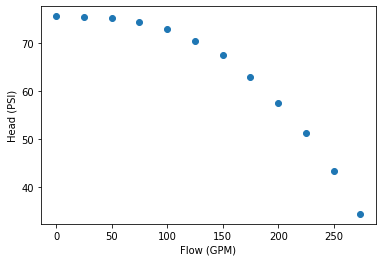

In [6]:
plt.scatter(x,y)
plt.ylabel('Head (PSI)')
plt.xlabel('Flow (GPM)')

In [183]:
type(x)

numpy.ndarray

In [184]:
p = np.polyfit(x,y,2)

p = np.flip(p)

plt.plot(x,y,'o')
yn = []
i = 0
for cte in p:
    yn.append(cte*x**i)
    i += 1
plt.plot(x,sum(yn))
plt.ylabel('Head (PSI)')
plt.xlabel('Flow (GPM)')

In [187]:
squaredDiffs = np.square(y - sum(yn))
squaredDiffsFromMean = np.square(y - np.mean(y))
rSquared = 1 - np.sum(squaredDiffs) / np.sum(squaredDiffsFromMean)
print(f"R² = {rSquared}")

R² = 0.9966175755998427


In [188]:
p

array([ 9.88854100e+01,  3.20221445e-03, -4.85598622e-06])

## Montando o dataframe

Rotação - Diâmetro externo - Diâmetro interno do olho do impelidor - Área de entrada - b2 - b3 - Esfera - GD2 - Número de pás

In [2]:
dici = {'_2100_11_s_3x2x11FS' : [[0,25,50,75,100,125,150,175,200,225,250,274],
                       [75.5,75.3,75.1,74.4,72.9,70.4,67.4,63,57.6,51.2,43.4,34.5],
                      [2100,11,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2350_11_s_3x2x11FS' : [[0,25,50,75,100,125,150,175,200,225,250,275,300,307],
                               [95,95,94,93,92,90,87,83,78,72,64,56,46,43],
                      [2350,11,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2960_11_s_3x2x11FS' : [[0,25,50,75,100,125,150,175,200,225,250,275,300,318],
                                   [147.5,148,148,147.5,146,145,143,140,136,130,123,114,104,96],
                      [2960,11,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3000_11_s_3x2x11FS' : [[0,25,50,75,100,125,150,175,200,225,250,275,300,322.5],
                                   [152,152,152,151,150,149,147,144,140,135,127,119,109,98],
                      [3000,11,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3300_11_s_3x2x11FS' : [[0,25,50,75,100,125,150,175,200,225,250,275,300,325,350,355],
                               [184,184,184,183,182.5,181,179,176,173,168,162,154,145,134,122,119],
                      [3300,11,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3550_11_s_3x2x11FS' : [[0,25,50,75,100,125,150,175,200,225,250,275,300,325,350,375,382],
                               [212.5,212.5,212.5,212,211,210,209,206,202.5,198,192.5,186,177,167,155,141,137.5],
                      [3550,11,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
       '_2950_98_6x4x9F' : [[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700,750,800,850,890],
                            [115,115,114,112,110,108,106,104,102,99,96,92.5,88,84,78,73,67,60,54],
                  [2950,9.8,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3000_98_6x4x9F' : [[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700,750,800,850,900],
                            [117,116,115,113,112,110,108,105,103,100,97.5,94,90,85,80,74,67,61,54],
                  [3000,9.8,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3300_98_6x4x9F' : [[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700,750,800,850,900,950,980],
                           [141,140,139,138,136,134,132,130,127.5,124,121,117.5,114,109,105,99,93,87,80,72,67],
                  [3300,9.8,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3550_98_6x4x9F' : [[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700,750,800,850,900,950,980],
                            [164,162.5,161,159,157.5,156,154,151,149,146,143,140,135.5,131,126,121,115,109,102,95,90],
                  [3550,9.8,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
       '_6x4x10FM_2960_122' : [[0,100,200,300,400,500,600,700,800,900,1000,1070],
                        [175,175,175,174,171,167.5,162.5,156,148,138,128,120],
                      [2960,12,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3000_122' : [[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700,750,800,850,900,950,995],
                      [187.5,187.5,187,187,186,185,184,183,182,180,177.5,175.5,173,170,167.5,164,160,157,152,147.5,143],
                      [3000,12,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3300_122' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1230],
                     [227.5,227,226,225,223,220,216,210,204,195,185,173,161,152],
                     [3300,12,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3555_122' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1418],
                     [265,265,264,262,260,256,251,245,237,227.5,217,205,191,176,159,157],
                     [3555,12,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
       '_6x4x11F_2960_116' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1500,1600,1620],
                    [174.5,174.5,174.5,174,173,172,170,167.5,165,161.5,157,151,145,137.5,130,120,110,108],
                    [2960,11.6,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']],
'_6x4x11F_3000_116' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1500,1600,1640],
                    [178,178,178,177.5,177,176,175,172.5,169,165,160,155,148,140,132.5,124,115,110],
                    [3000,11.6,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']],
'_6x4x11F_3300_116' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1650],
                    [212.5,212.5,212.5,212.5,211,210,207.5,203,197.5,191,182.5,170.2,162,150,147.5],
                    [3300,11.6,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']],
'_6x4x11F_3555_116' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1800],
                    [249,249,249,249,248,246,244.5,240,235,227.5,220,210,197,188,168,162],
                    [3555,11.6,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']],
       '_6x4x12FM_1470_137' : [[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700,750,800,850,900],
                     [60,60,59.9,59.6,59.3,59,58.7,58,57.3,56.5,55.3,54,52.6,51,49,46.7,44.2,41.8,39],
                     [1470,13.7,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_1770_137' : [[0,100,200,300,400,500,600,700,800,900,1000,1050],
                     [87.5,87,86.5,85.5,84,82,79.5,76.5,73,68.5,63.5,60.5],
                     [1770,13.7,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2100_137' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200],
                     [120,120,119,118,116,115,112,109,105,101,95,88,79],
                     [2100,13.7,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2350_137' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1500],
                     [147.5,147,146.5,146,145,144,142.5,140,136,132,126,119,112.5,103,94,85],
                     [2350,13.7,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2960_137' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1460],
                     [231,230,230,229,228,225,221,217,210,201,192,181,176],
                     [2960,13.7,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_3000_137' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1487],
                     [242,241,240,239,236,231,228,222,217,209,200,189,177],
                     [3000,13.7,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
       '_6x6x9F_2950_98' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1140],
                  [112,109,106,104,100.5,97.5,94,90,84,78,71,63,59],
                  [2950,9.8,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3000_98' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1160],
                  [115,112.5,110,107.5,105,101,97.5,93,87.5,82,75,67,62],
                  [3000,9.8,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3300_98' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300],
                  [140,137.5,134.5,131,127.5,124.5,120,115,110,105,97.5,90,81,72],
                  [3300,9.8,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3550_98' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400],
                  [162,158,155,152,148,145,140,136,132,125,118,110,102,92.5,82.5],
                  [3550,9.8,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
       '_8x6x9F_2950_98' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1500,1600,1700,1720],
                    [115,112.5,110,107.5,105,102.5,100,97,94.5,90.5,87,83,78,73,67.5,62,55,48,47],
                    [2950,9.8,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3000_98' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750],
                    [119.5,115.5,112.5,110,106,103,99.5,95,90.5,85,80,72.5,65.5,57.5,49],
                    [3000,9.8,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3300_98' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875],
                    [143,140,137,133,130,126,122.5,117,114,108,102.5,95.5,88,80,72,62.5],
                    [3300,9.8,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3550_98' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,1950],
                  [165,162,159,155,152,148,145,140,135,130,124,117,110,102,93,84,78],
                  [3550,9.8,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
       '_8x6x10F_2960_10' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,2000,2125,2250,2320],
                   [121,118,115,112,110,107,105,102,100,97,93,90,85,81,76,70,65,58,52,48],
                   [2960,10,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3000_10' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,2000,2125,2250,2350],
                   [125,121,117.5,115,112.5,110,107.5,105,102,100,96,93,89,85,79,74,67.5,61,55,49],
                   [3000,10,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3300_10' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2550],
                   [151,142,136,131,126,120,112.5,103,92,78,63,60],
                   [3300,10,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3550_10' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750],
                   [175,165,159,153,147.5,141,134,124,112,99,84,67.5],
                   [3550,10,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
       '_8x6x12FS_1485_129' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400],
                     [51.3,50.8,50.1,49.2,48.4,47.3,46.2,44.9,43.6,42,40.4,38.5,36.5,34,31.9],
                     [1485,12.9,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_1765_129' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1825],
                     [72,71.1,70.1,69.5,68,66.8,65.5,63.7,61,58.7,55.8,52,48,44,39,35.9],
                     [1765,12.9,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_2100_129' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1825],
                     [104,102,100,99,97,96,95,93,91,88,85,82,78,74,69,63],
                     [2100,12.9,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_2350_129' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,1950],
                     [128,126,125,124,122,120,119,117,115,113,110,107,103,99,95,90,86],
                     [2350,12.9,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
       '_8x6x12FM_2960_115' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2570],
                     [160,158,155,152.5,149,145,140,135,130,120,110,106],
                     [2960,11.5,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3000_114' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2525],
                     [169,168,165.5,163,159,154,148,142,135,129,121,120],
                     [3000,11.4,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3300_114' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3200],
                     [200,199,197.5,195,192,188,184,177.5,171,164,155,145,135,125],
                     [3300,11.4,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3555_113' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500],
                     [230,229,225,222,220,216,210,204,199,190,182,174,165,153,141],
                     [3555,11.3,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
       '_8x6x13F_1480_131' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1500,1600,1700,1800],
                    [52.4,51.9,51.1,50.8,50.2,49.8,49.1,48.5,47.8,46.8,45.5,44,42.5,40.8,38.8,36.5,34,31.5,28.8],
                    [1480,13.1,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_1780_131' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,2000,2125,2250,2300],
                    [76.5,75.5,74.5,74,73.5,72.5,72,71,70,68,66.5,64,62,58.5,55.5,52,48,43.5,39,37.5],
                    [1780,13.1,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_2100_131' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750],
                    [105.5,103.5,102,100,98,94.5,90.5,85,78,70,60.5,50],
                    [2100,13.1,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_2350_131' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750],
                    [134.5,132,130,127.5,125,121.5,117.5,112.5,105.5,98,90,79.5],
                    [2350,13.1,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
       '_8x6x18F_1480_172' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1500,1600,1700,1800],
                    [90,90,90,90,89.5,88.5,87.8,86.2,85,83.4,81.5,79,76.5,74,70.8,67.5,63.8,59.3,54.5],
                    [1480,17.2,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_1780_172' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,2000,2125,2250],
                    [130,130,130,130,129.5,127.5,126,125,122.5,120,117,114,110,105,100,95,88,80,72.5],
                    [1780,17.2,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_2100_172' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500],
                    [182,182,180,179,175,170,163,154,142,128,113],
                    [2100,17.2,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_2350_172' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3050],
                    [227,228,227,225,220,215,208,199,189,177,162.5,145,125,120],
                    [2350,17.2,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
       '_8x8x12F_1470_128' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2345],
                    [48.5,48,48,47.2,46.2,44.9,42.9,40.1,37.1,33.9,32.7],
                    [1470,12.8,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_1785_128' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3100],
                    [72.2,71.5,70.5,70,69,68,66,64,61,57.5,53.5,48.5,44,42],
                    [1785,12.8,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_2100_128' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3650],
                    [100.5,100,98.5,98,96.5,95,93.5,91,88,85.5,81.5,77,72,66,59,55],
                    [2100,12.8,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_2350_128' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,3850],
                    [126,124,123,122,121,120,119,117,115,112,108,104,100,94,87,78,75],
                    [2350,12.8,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
       '_8x8x17F_1780_176' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3075],
                    [144.5,141,140,137.5,135,132,127.5,122,115,107.5,97.5,85,72.5,67.5],
                    [1780,17.6,3.081,40.2,1.182,2.733,0.98,17,7,'8x8x17F']],
       '_10x8x17FS_1785_177' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,4000,4200],
                      [142.5,143,143,142,141,140,137.5,135,131,127.5,122.5,117.5,112,105,98,90,82.5,75],
                      [1785,17.7,3.081,57.5,1.135,2.625,0.97,20.7,7,'10x8x17F-S']],
       '_10x8x17FL_1785_172' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,4000,4220],
                      [144,142.5,141,140,139,138,136,135,132.5,130,127.5,125,121,118,115,110,106,103],
                      [1785,17.2,3.081,65.6,1.155,2.672,1.15,22.4,5,'10x8x17F-L']],
       '_10x8x20FS_1485_202' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3675],
                      [125,123,121,120,117.5,115,112,108,103,97.5,91,85,76,67,57,48],
                      [1485,20.2,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
'_10x8x20FS_1785_202' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,4000],
                      [182.5,181,180,178,175,172,167.5,163,157.5,150,144,136,128,119,110,99,89],
                      [1785,20.2,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
'_10x8x20FS_2100_184' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,4000,4250,4500,4700],
                      [212,210,208,205,201,200,198,194,190,186,180,175,170,160,152,142,131,120,110,99],
                      [2100,18.4,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
'_10x8x20FS_2350_161' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,4000,4250,4500,4720],
                      [205.5,204,201,199,196,194,190,188,184,180,175,169,163,155,148,138,128,117.5,105,94],
                      [2350,16.1,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
       '_10x8x20FL_1485_202' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,3920],
                      [126,126,125.5,125,124,121,118,115,110,105,100,94,86,80,70,61,55],
                      [1485,20.2,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
'_10x8x20FL_1785_202' : [[0,500,1000,1500,2000,2500,3000,3500,4000,4200],
                      [189,186,182.5,177,169,160,148,136,121,115],
                      [1785,20.2,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
'_10x8x20FL_2100_178' : [[0,500,1000,1500,2000,2500,3000,3500,4000,4500,5000,5300],
                      [195,194,192,189,185,178,170,158,144,126,103,87],
                      [2100,17.8,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
'_10x8x20FL_2350_157' : [[0,500,1000,1500,2000,2500,3000,3500,4000,4500,5000,5500,6000,],
                      [200,197.5,195,192,187,180,172.5,162,148,132,112,86,56],
                      [2350,15.7,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
       '_12x10x18F_1485_18' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,4000,4250,4300],
                     [99,98.5,98,97.5,97,96,95.5,94.5,93.5,91.5,89.5,87,84,81,77.5,73,68,63,62],
                     [1485,18,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']],
'_12x10x18F_1785_18' : [[0,500,1000,1500,2000,2500,3000,3500,4000,4500,5000,5500],
                     [150,147.5,145,142.5,139,135,130,123,115,104,90,72.5],
                     [1785,18,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']],
'_12x10x18F_2100_157' : [[0,500,1000,1500,2000,2500,3000,3500,4000,4500,5000,5500],
                      [147.5,147.5,146,145,142,138,135,129,122.5,115,105,92],
                      [2100,15.7,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']]}

In [3]:
dici

{'_2100_11_s_3x2x11FS': [[0,
   25,
   50,
   75,
   100,
   125,
   150,
   175,
   200,
   225,
   250,
   274],
  [75.5, 75.3, 75.1, 74.4, 72.9, 70.4, 67.4, 63, 57.6, 51.2, 43.4, 34.5],
  [2100, 11, 2.132, 7.7, 0.735, 1.699, 0.25, 3.6, 6, '3x2x11 F-S']],
 '_2350_11_s_3x2x11FS': [[0,
   25,
   50,
   75,
   100,
   125,
   150,
   175,
   200,
   225,
   250,
   275,
   300,
   307],
  [95, 95, 94, 93, 92, 90, 87, 83, 78, 72, 64, 56, 46, 43],
  [2350, 11, 2.132, 7.7, 0.735, 1.699, 0.25, 3.6, 6, '3x2x11 F-S']],
 '_2960_11_s_3x2x11FS': [[0,
   25,
   50,
   75,
   100,
   125,
   150,
   175,
   200,
   225,
   250,
   275,
   300,
   318],
  [147.5, 148, 148, 147.5, 146, 145, 143, 140, 136, 130, 123, 114, 104, 96],
  [2960, 11, 2.132, 7.7, 0.735, 1.699, 0.25, 3.6, 6, '3x2x11 F-S']],
 '_3000_11_s_3x2x11FS': [[0,
   25,
   50,
   75,
   100,
   125,
   150,
   175,
   200,
   225,
   250,
   275,
   300,
   322.5],
  [152, 152, 152, 151, 150, 149, 147, 144, 140, 135, 127, 119, 109, 98],

Rotação - Diâmetro externo - Diâmetro interno do olho do impelidor - Área de entrada - b2 - b3 - Esfera - GD2 - Número de pás

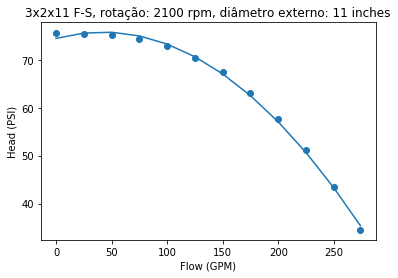

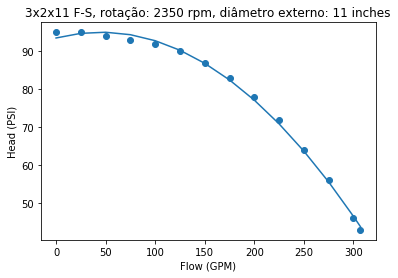

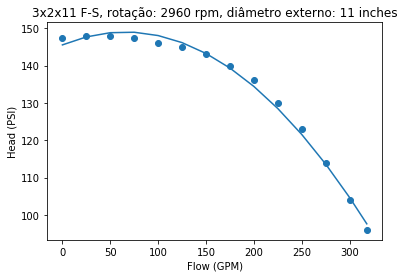

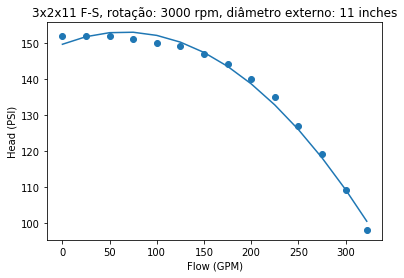

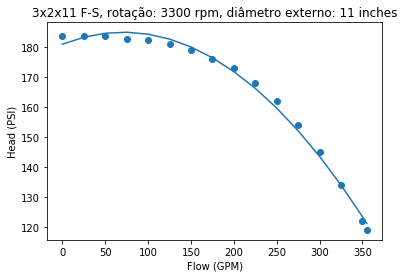

...

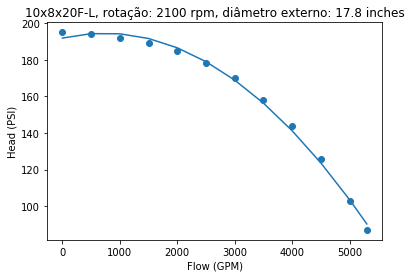

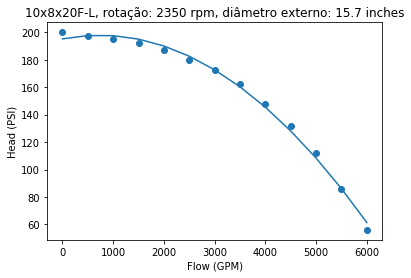

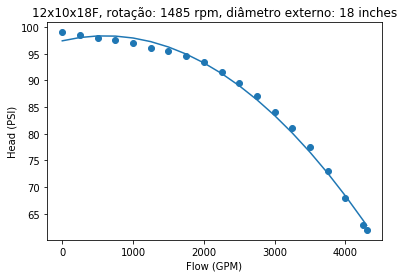

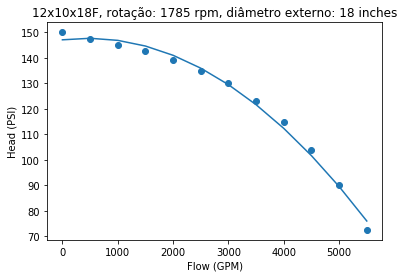

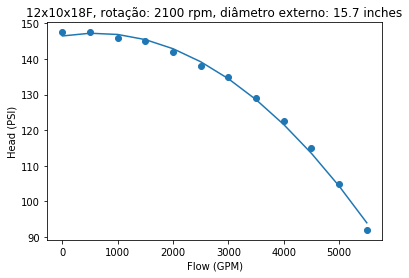

<Figure size 432x288 with 0 Axes>

In [4]:
data = []
for chave in list(dici.keys()):
    
    x = np.array(dici[chave][0])
    y = dici[chave][1]
    p = np.polyfit(x,y,2)
    p = np.flip(p)
    plt.scatter(x,y)
    plt.ylabel('Head (PSI)')
    plt.xlabel('Flow (GPM)')
    plt.title(dici[chave][2][-1]+', rotação: '+str(dici[chave][2][0])+' rpm, diâmetro externo: '+str(dici[chave][2][1])+' inches')
    yn = []
    i = 0
    for cte in p:
        yn.append(cte*x**i)
        i += 1
    plt.plot(x,sum(yn))
    plt.show()
    plt.clf()
    squaredDiffs = np.square(y - sum(yn))
    squaredDiffsFromMean = np.square(y - np.mean(y))
    rSquared = 1 - np.sum(squaredDiffs) / np.sum(squaredDiffsFromMean)
    data.append([dici[chave][2][0],dici[chave][2][1],dici[chave][2][2],dici[chave][2][3],dici[chave][2][4],dici[chave][2][5],dici[chave][2][6],
                dici[chave][2][7],dici[chave][2][8],dici[chave][2][9],p[0],p[1],p[2],dici[chave][0][-1],rSquared])
df_bombas = pd.DataFrame(data, columns=['Rotacao' , 'Dia_externo' , 'Dia_interno_olho' , 'area_entrada','b2','b3', 'Esfera' , 'GD2' , 'N_pas','Modelo',
                                       'a1','a2','a3','xn','r2'])

In [5]:
df_bombas.head()

,Rotacao,Dia_externo,Dia_interno_olho,area_entrada,b2,b3,Esfera,GD2,N_pas,Modelo,a1,a2,a3,xn,r2
0,2100,11.0,2.132,7.7,0.735,1.699,0.25,3.6,6,3x2x11 F-S,74.471923,0.063377,-0.000752,274.0,0.998192
1,2350,11.0,2.132,7.7,0.735,1.699,0.25,3.6,6,3x2x11 F-S,93.531040,0.067568,-0.000747,307.0,0.997879
2,2960,11.0,2.132,7.7,0.735,1.699,0.25,3.6,6,3x2x11 F-S,145.525126,0.105563,-0.000806,318.0,0.994369
3,3000,11.0,2.132,7.7,0.735,1.699,0.25,3.6,6,3x2x11 F-S,149.595986,0.104326,-0.000797,322.5,0.992303
4,3300,11.0,2.132,7.7,0.735,1.699,0.25,3.6,6,3x2x11 F-S,181.099836,0.112815,-0.000793,355.0,0.994378


In [6]:
df_bombas.to_excel('df_bombas2.xlsx',index=False)

In [7]:
df_bombas.Modelo.unique().shape

(19,)

In [8]:
df_bombas.describe()

,Rotacao,Dia_externo,Dia_interno_olho,area_entrada,b2,b3,Esfera,GD2,N_pas,a1,a2,a3,xn,r2
count,70.000000,70.000000,70.000000,70.000000,70.000000,70.000000,70.000000,70.000000,70.000000,70.000000,70.000000,70.000000,70.000000,70.000000
mean,2536.428571,13.182857,2.448914,28.332857,0.896657,2.073257,0.663714,8.101429,6.100000,145.825774,0.010391,-0.000086,2303.478571,0.997259
std,698.289392,3.118480,0.348739,23.004913,0.233103,0.538847,0.231937,7.952732,0.662669,50.827186,0.029352,0.000216,1412.960456,0.002082
min,1470.000000,9.800000,2.132000,5.900000,0.654000,1.513000,0.250000,2.400000,5.000000,48.182148,-0.014288,-0.000813,274.000000,0.990273
25%,1785.000000,11.000000,2.133000,10.200000,0.735000,1.699000,0.500000,3.000000,6.000000,114.003173,-0.002468,-0.000036,1247.500000,0.996395
50%,2350.000000,12.800000,2.449000,18.300000,0.855000,1.977000,0.700000,3.600000,6.000000,142.539479,0.002336,-0.000014,1850.000000,0.997779
75%,3000.000000,15.200000,2.449000,44.400000,1.080000,2.497750,0.750000,14.775000,6.000000,180.985716,0.009364,-0.000006,3093.750000,0.998673
max,3555.000000,20.200000,3.081000,74.000000,1.383000,3.197000,1.150000,24.200000,8.000000,263.497362,0.129867,-0.000002,6000.000000,0.999847


In [9]:
df_bombas.var()

Rotacao             4.876081e+05
Dia_externo         9.724919e+00
Dia_interno_olho    1.216189e-01
area_entrada        5.292260e+02
b2                  5.433710e-02
b3                  2.903566e-01
Esfera              5.379470e-02
GD2                 6.324594e+01
N_pas               4.391304e-01
a1                  2.583403e+03
a2                  8.615611e-04
a3                  4.683448e-08
xn                  1.996457e+06
r2                  4.336493e-06
dtype: float64

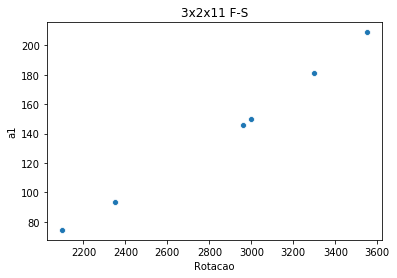

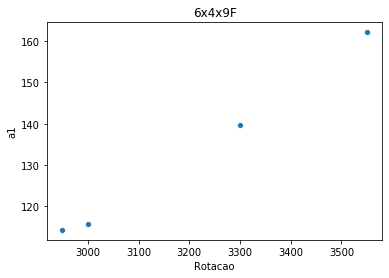

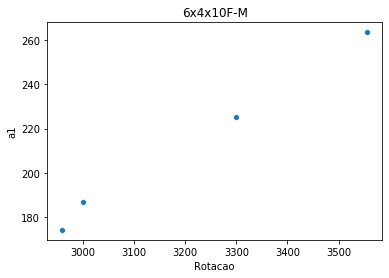

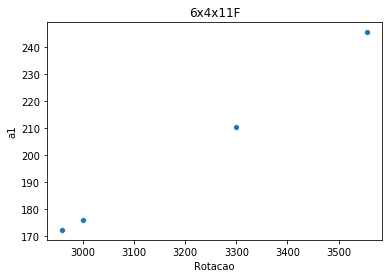

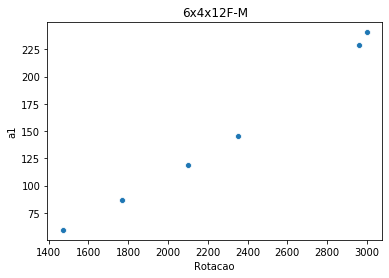

...

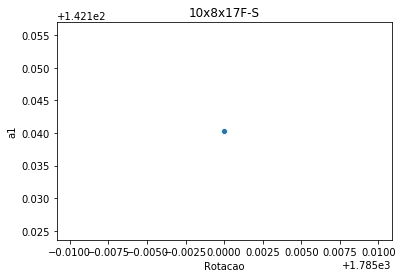

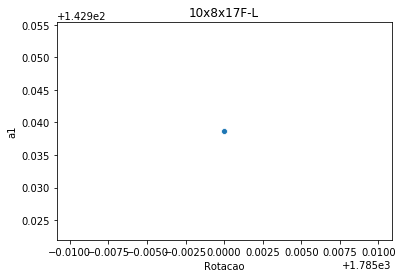

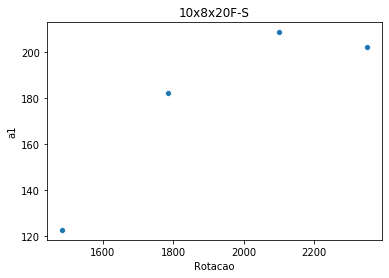

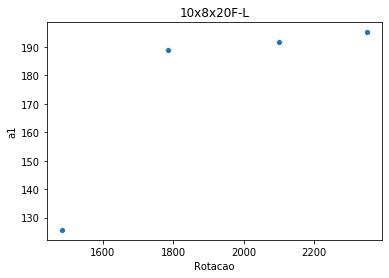

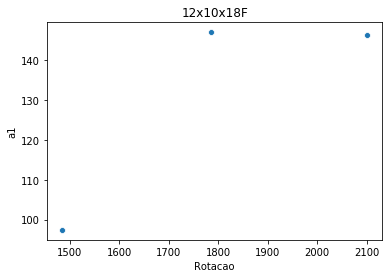

In [149]:
for model in df_bombas.Modelo.unique():
    f = plt.figure()
    sns.scatterplot(df_bombas[df_bombas.Modelo == model].Rotacao,df_bombas[df_bombas.Modelo == model].a1)
    plt.title(model)

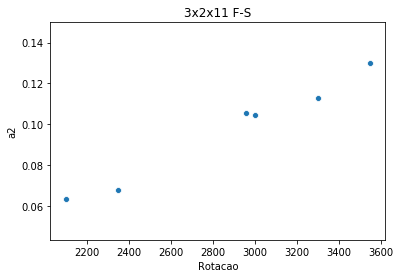

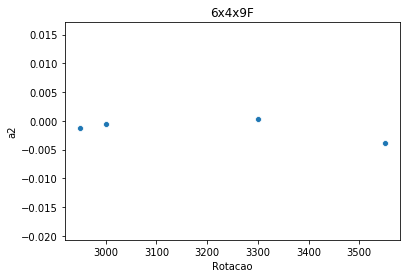

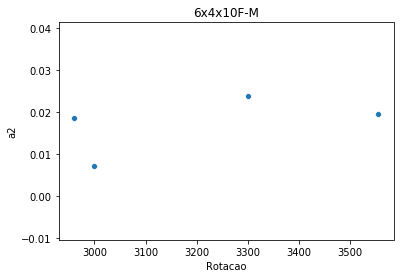

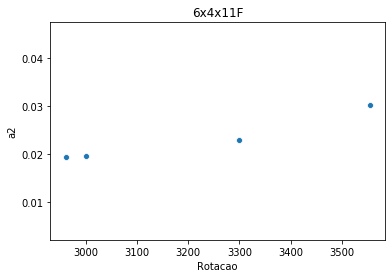

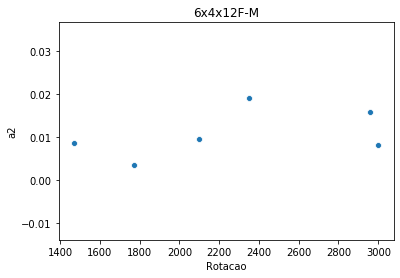

...

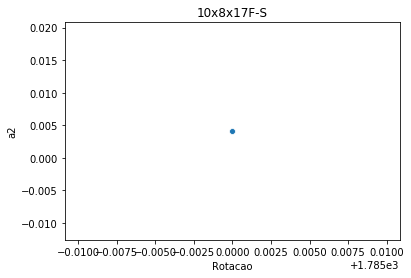

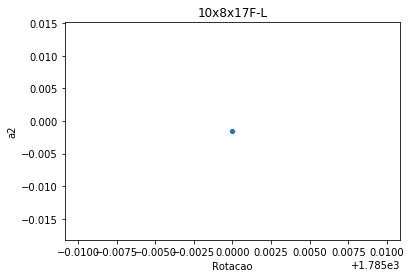

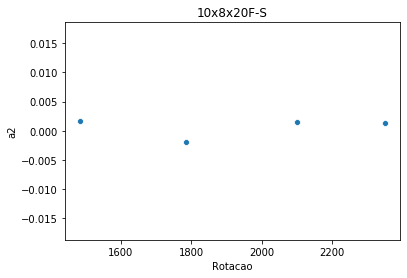

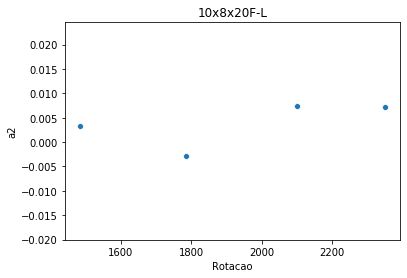

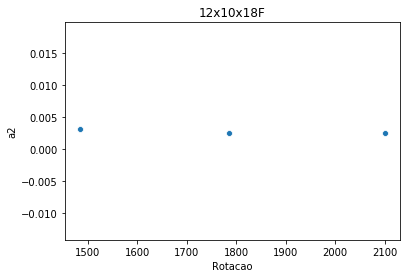

In [150]:
for model in df_bombas.Modelo.unique():
    f = plt.figure()
    sns.scatterplot(df_bombas[df_bombas.Modelo == model].Rotacao,df_bombas[df_bombas.Modelo == model].a2)
    plt.title(model)

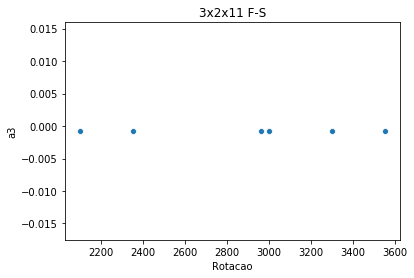

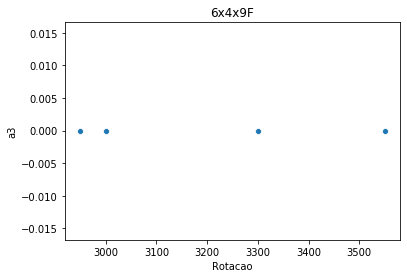

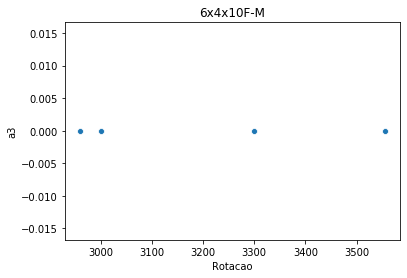

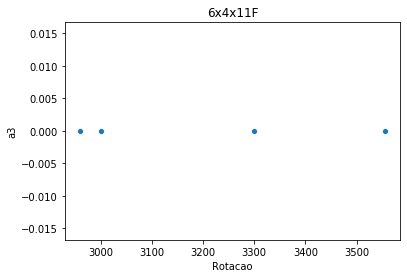

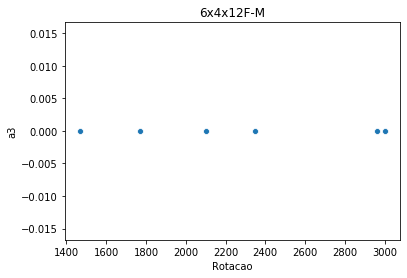

...

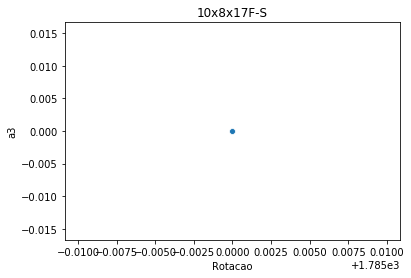

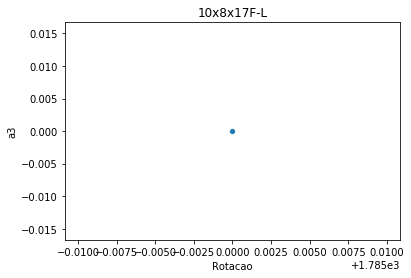

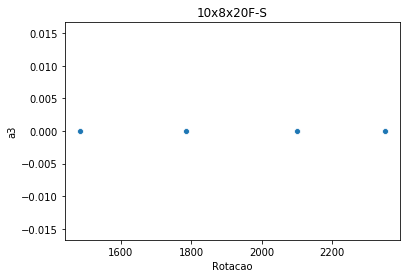

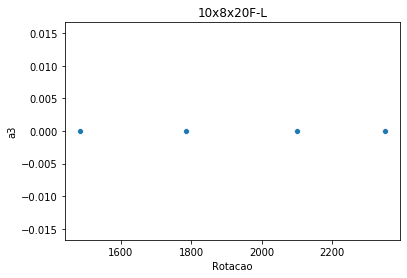

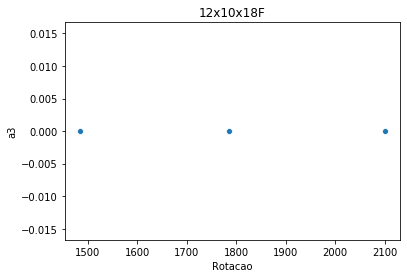

In [151]:
for model in df_bombas.Modelo.unique():
    f = plt.figure()
    sns.scatterplot(df_bombas[df_bombas.Modelo == model].Rotacao,df_bombas[df_bombas.Modelo == model].a3)
    plt.title(model)

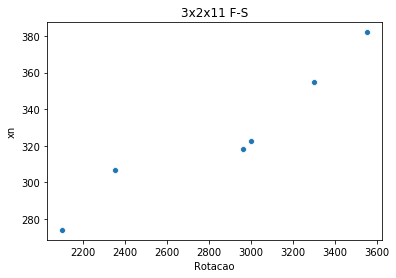

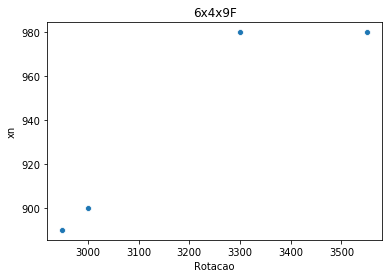

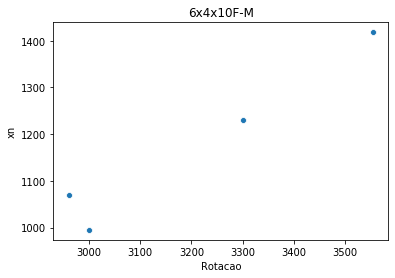

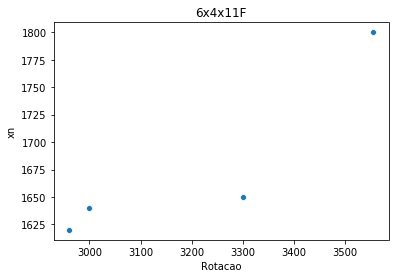

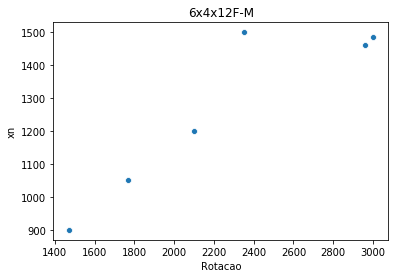

...

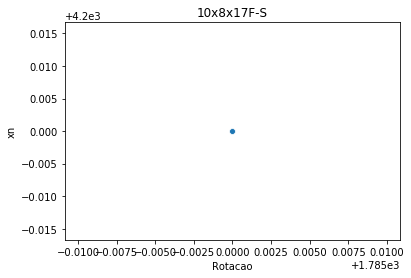

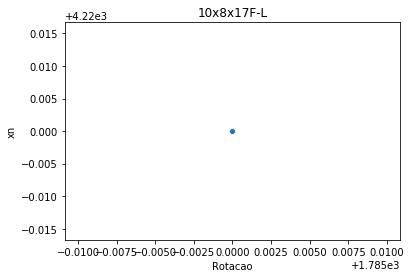

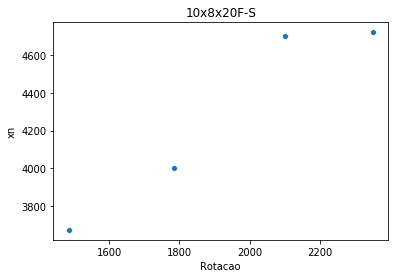

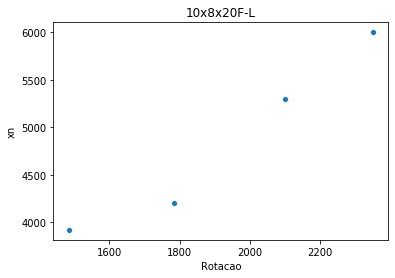

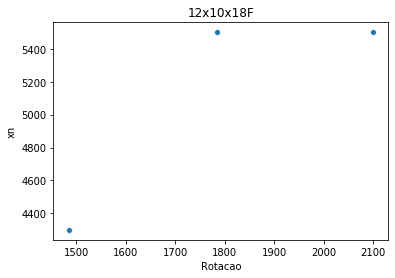

In [152]:
for model in df_bombas.Modelo.unique():
    f = plt.figure()
    sns.scatterplot(df_bombas[df_bombas.Modelo == model].Rotacao,df_bombas[df_bombas.Modelo == model].xn)
    plt.title(model)

## Criando o modelo

In [7]:
df_bombas = pd.read_excel('df_bombas2.xlsx')

In [57]:
df_bombas.shape

(70, 15)

In [8]:
df_bombas.head()

,Rotacao,Dia_externo,Dia_interno_olho,area_entrada,b2,b3,Esfera,GD2,N_pas,Modelo,a1,a2,a3,xn,r2
0,2100,11.0,2.132,7.7,0.735,1.699,0.25,3.6,6,3x2x11 F-S,74.471923,0.063377,-0.000752,274.0,0.998192
1,2350,11.0,2.132,7.7,0.735,1.699,0.25,3.6,6,3x2x11 F-S,93.531040,0.067568,-0.000747,307.0,0.997879
2,2960,11.0,2.132,7.7,0.735,1.699,0.25,3.6,6,3x2x11 F-S,145.525126,0.105563,-0.000806,318.0,0.994369
3,3000,11.0,2.132,7.7,0.735,1.699,0.25,3.6,6,3x2x11 F-S,149.595986,0.104326,-0.000797,322.5,0.992303
4,3300,11.0,2.132,7.7,0.735,1.699,0.25,3.6,6,3x2x11 F-S,181.099836,0.112815,-0.000793,355.0,0.994378


### Para a1

In [9]:
X = df_bombas[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]

In [10]:
y = df_bombas['a1']

In [11]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.model_selection import GridSearchCV, train_test_split, cross_val_score

In [12]:
X_train1, X_test1, y_train1, y_test1 = train_test_split(X, y, test_size=0.2, random_state=42)

In [13]:
random_forest = RandomForestRegressor(random_state = 42)

In [14]:
random_forest.fit(X_train1,y_train1)

C:\Users\evert\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=10,
                      n_jobs=None, oob_score=False, random_state=42, verbose=0,
                      warm_start=False)

In [15]:
y_pred1 = random_forest.predict(X_test1)

In [16]:
mean_absolute_error(y_test1,y_pred1)

20.267193097885013

In [17]:
random_forest.score(X_test1,y_test1)

0.8313266570350392

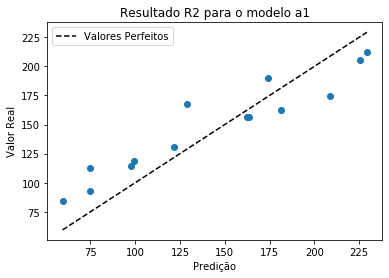

In [24]:
plt.title('Resultado R2 para o modelo a1')
plt.plot(y_test1,y_pred1,'o')
plt.plot([y_test1.min(),y_test1.max()],[y_test1.min(),y_test1.max()],'--k',label = 'Valores Perfeitos')
plt.xlabel('Predição')
plt.ylabel('Valor Real')
plt.legend()

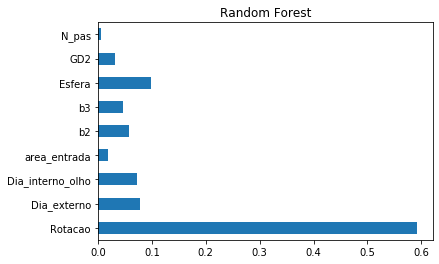

In [227]:
pd.Series(random_forest.feature_importances_, index=X_train1.columns).plot(kind='barh',title='Random Forest')
plt.show()

### Learning Curves

[ 5 11 16 22 28 33 39 44 50 56]
[0.77316836 0.82068002 0.8685513  0.90561067 0.92833585 0.94748233
 0.95303733 0.96047039 0.96516991 0.96869619]
[-0.36582779 -0.01243608  0.27650528  0.43887381  0.55863929  0.60949382
  0.68805992  0.72956556  0.76890247  0.78722514]


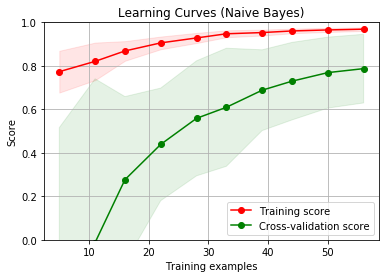

In [44]:
#fig, axes = plt.subplots(3, 2, figsize=(10, 15))

title = "Learning Curves (Naive Bayes)"
# Cross validation with 100 iterations to get smoother mean test and train
# score curves, each time with 20% data randomly selected as a validation set.
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)

estimator = RandomForestRegressor(random_state=42)
plot_learning_curve(
    estimator, title, X, y, ylim=(0, 1.01), cv=cv, n_jobs=4,train_sizes=np.linspace(0.1, 1.0, 10)
)

plt.show()

### Para a2

In [25]:
X = df_bombas[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y = df_bombas['a2']

In [26]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(X, y, test_size=0.2, random_state=42)
random_forest = RandomForestRegressor(random_state = 42)
random_forest.fit(X_train2,y_train2)

C:\Users\evert\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=10,
                      n_jobs=None, oob_score=False, random_state=42, verbose=0,
                      warm_start=False)

In [27]:
y_pred2 = random_forest.predict(X_test2)

In [28]:
mean_absolute_error(y_test2,y_pred2)

0.007809944212321695

In [29]:
random_forest.score(X_test2,y_test2)

0.9150447876568815

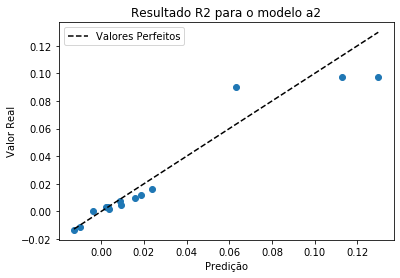

In [31]:
plt.title('Resultado R2 para o modelo a2')
plt.plot(y_test2,y_pred2,'o')
plt.plot([y_test2.min(),y_test2.max()],[y_test2.min(),y_test2.max()],'--k',label = 'Valores Perfeitos')
plt.xlabel('Predição')
plt.ylabel('Valor Real')
plt.legend()

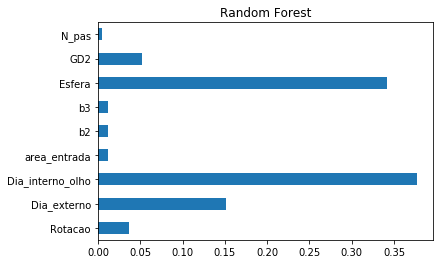

In [235]:
pd.Series(random_forest.feature_importances_, index=X_train2.columns).plot(kind='barh',title='Random Forest')
plt.show()

[ 5 11 16 22 28 33 39 44 50 56]
[0.78461161 0.82869319 0.87501306 0.92487941 0.95621205 0.9680626
 0.97424248 0.97737757 0.98539625 0.98993053]
[-1.38727428 -0.41084536  0.0049946   0.31088404  0.64220131  0.65232856
  0.77537671  0.80661066  0.83229817  0.87353458]


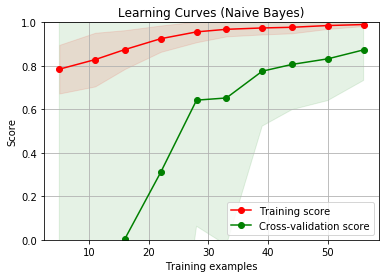

In [46]:
#fig, axes = plt.subplots(3, 2, figsize=(10, 15))

title = "Learning Curves (Naive Bayes)"
# Cross validation with 100 iterations to get smoother mean test and train
# score curves, each time with 20% data randomly selected as a validation set.
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)

estimator = RandomForestRegressor(random_state=42)
plot_learning_curve(
    estimator, title, X, y, ylim=(0, 1.01), cv=cv, n_jobs=4,train_sizes=np.linspace(0.1, 1.0, 10)
)

plt.show()

### Para a3

In [33]:
X = df_bombas[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y = df_bombas['a3']

In [34]:
from sklearn.preprocessing import StandardScaler

In [35]:
scaler = StandardScaler()
y = scaler.fit_transform(np.array(y).reshape(-1,1))

In [36]:
X_train3, X_test3, y_train3, y_test3 = train_test_split(X, y, test_size=0.2, random_state=42)
random_forest = RandomForestRegressor(random_state = 42)
random_forest.fit(X_train3,y_train3)

C:\Users\evert\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)
C:\Users\evert\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  This is separate from the ipykernel package so we can avoid doing imports until


RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=10,
                      n_jobs=None, oob_score=False, random_state=42, verbose=0,
                      warm_start=False)

In [37]:
y_pred3 = random_forest.predict(X_test3)

In [38]:
mean_absolute_error(y_test3,y_pred3)

0.03248090229020254

In [39]:
random_forest.score(X_test3,y_test3)

0.9987669410984275

In [40]:
random_forest.score(X_train3,y_train3)

0.9990937548853752

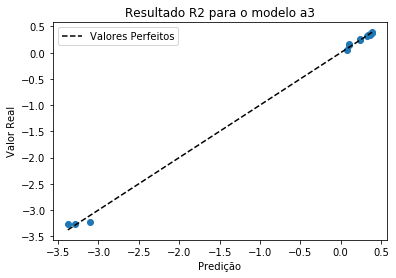

In [44]:
plt.title('Resultado R2 para o modelo a3')
plt.plot(y_test3,y_pred3,'o')
plt.plot([y_test3.min(),y_test3.max()],[y_test3.min(),y_test3.max()],'--k',label = 'Valores Perfeitos')
plt.xlabel('Predição')
plt.ylabel('Valor Real')
plt.legend()

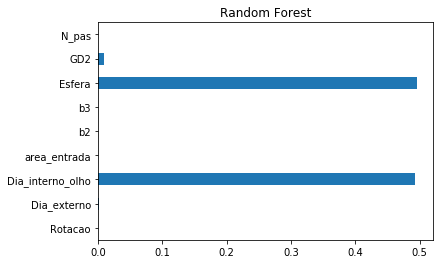

In [244]:
pd.Series(random_forest.feature_importances_, index=X_train3.columns).plot(kind='barh',title='Random Forest')
plt.show()

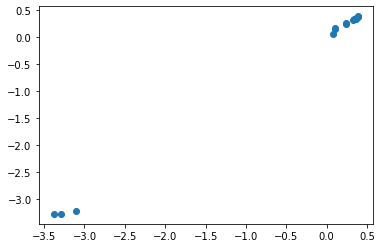

In [245]:
plt.plot(y_test3,y_pred3,'o')

In [42]:
y_test31 = scaler.inverse_transform(y_test3)
y_pred31 = scaler.inverse_transform(y_pred3)

In [43]:
mean_absolute_error(y_test31,y_pred31)

6.978891460664515e-06

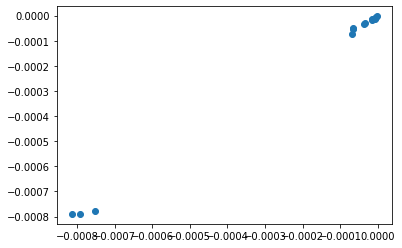

In [247]:
plt.plot(y_test31,y_pred31,'o')

[ 5 11 16 22 28 33 39 44 50 56]
[0.83154388 0.8669389  0.90532025 0.94472138 0.97092749 0.98183374
 0.98870691 0.99007034 0.99571107 0.99841825]
[-11.9430168   -4.72220144  -3.5516882   -1.53930717   0.57491788
   0.47766732   0.78933824   0.87459375   0.85315011   0.94811468]


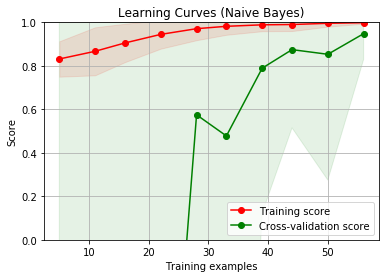

In [50]:
#fig, axes = plt.subplots(3, 2, figsize=(10, 15))

title = "Learning Curves (Naive Bayes)"
# Cross validation with 100 iterations to get smoother mean test and train
# score curves, each time with 20% data randomly selected as a validation set.
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)

estimator = RandomForestRegressor(random_state=42)
plot_learning_curve(
    estimator, title, X, y, ylim=(0, 1.01), cv=cv, n_jobs=4,train_sizes=np.linspace(0.1, 1.0, 10)
)

plt.show()

### Para xn

In [47]:
y = df_bombas['xn']

In [48]:
X_train4, X_test4, y_train4, y_test4 = train_test_split(X, y, test_size=0.2, random_state=42)
random_forest = RandomForestRegressor(random_state = 42)
random_forest.fit(X_train4,y_train4)

C:\Users\evert\Anaconda3\lib\site-packages\sklearn\ensemble\forest.py:245: FutureWarning: The default value of n_estimators will change from 10 in version 0.20 to 100 in 0.22.
  "10 in version 0.20 to 100 in 0.22.", FutureWarning)


RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=10,
                      n_jobs=None, oob_score=False, random_state=42, verbose=0,
                      warm_start=False)

In [49]:
y_pred4 = random_forest.predict(X_test4)

In [50]:
mean_absolute_error(y_test4,y_pred4)

97.53928571428574

In [51]:
random_forest.score(X_test4,y_test4)

0.9786470148524128

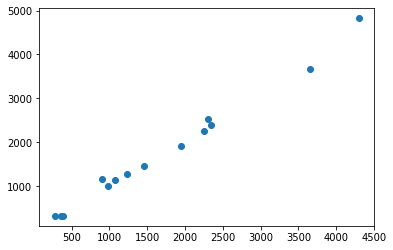

In [52]:
plt.plot(y_test4,y_pred4,'o')

### Diferença nas curvas

In [53]:
df_teste = X_test1

In [54]:
df_teste['a1'] = y_test1
df_teste['a2'] = y_test2
df_teste['a3'] = y_test31
df_teste['xn'] = y_test4
df_teste['a1p'] = y_pred1
df_teste['a2p'] = y_pred2
df_teste['a3p'] = y_pred31
df_teste['xnp'] = y_pred4

In [55]:
df_teste

,Rotacao,Dia_externo,Dia_interno_olho,area_entrada,b2,b3,Esfera,GD2,N_pas,a1,a2,a3,xn,a1p,a2p,a3p,xnp
22,2960,13.7,2.133,10.2,0.915,2.116,0.50,3.0,6,229.322540,0.015853,-0.000036,1460.0,212.094734,0.009392,-0.000034,1459.60
0,2100,11.0,2.132,7.7,0.735,1.699,0.25,3.6,6,74.471923,0.063377,-0.000752,274.0,112.843151,0.089994,-0.000779,314.95
49,1780,17.2,2.449,18.3,1.149,2.656,0.70,18.0,6,128.775940,0.009183,-0.000015,2250.0,167.808787,0.004545,-0.000013,2255.00
4,3300,11.0,2.132,7.7,0.735,1.699,0.25,3.6,6,181.099836,0.112815,-0.000793,355.0,162.816303,0.097345,-0.000789,318.05
54,2100,12.8,2.449,61.9,0.855,1.977,1.13,8.1,7,99.201420,0.002099,-0.000004,3650.0,118.808734,0.002904,-0.000004,3660.00
18,1470,13.7,2.133,10.2,0.915,2.116,0.50,3.0,6,59.409173,0.008688,-0.000034,900.0,83.894347,0.007455,-0.000031,1155.00
10,2960,12.0,2.449,15.9,0.801,1.853,0.50,2.9,6,174.296838,0.018604,-0.000065,1070.0,189.780182,0.012043,-0.000051,1142.40
33,3000,10.0,2.449,15.2,0.668,1.544,0.75,3.1,6,121.418671,-0.009927,-0.000009,2350.0,131.072551,-0.011099,-0.000012,2386.50
45,1780,13.1,2.449,44.4,0.875,2.023,1.00,5.3,7,74.713522,0.003625,-0.000009,2300.0,93.060824,0.001729,-0.000008,2527.00
12,3300,12.0,2.449,15.9,0.801,1.853,0.50,2.9,6,225.223218,0.023820,-0.000065,1230.0,205.363112,0.016520,-0.000054,1263.90


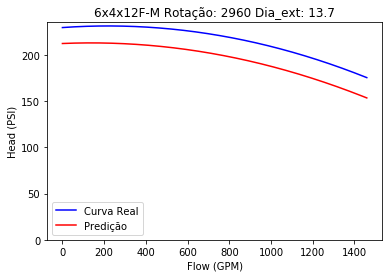

<Figure size 432x288 with 0 Axes>

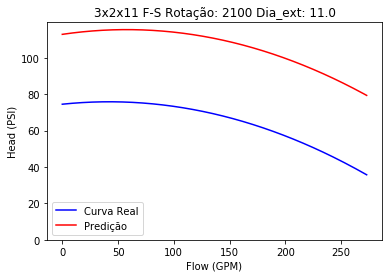

<Figure size 432x288 with 0 Axes>

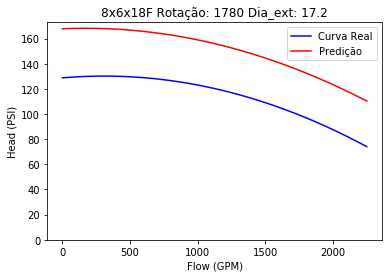

<Figure size 432x288 with 0 Axes>

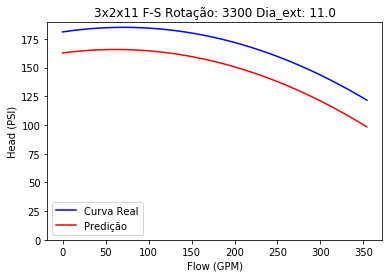

<Figure size 432x288 with 0 Axes>

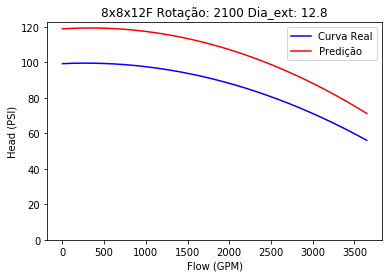

<Figure size 432x288 with 0 Axes>

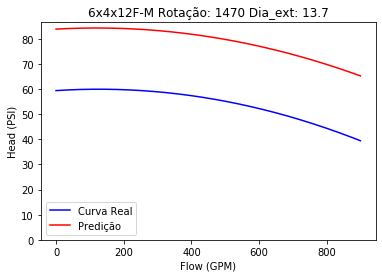

<Figure size 432x288 with 0 Axes>

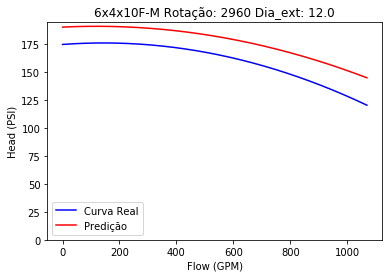

<Figure size 432x288 with 0 Axes>

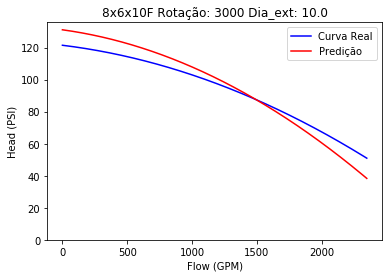

<Figure size 432x288 with 0 Axes>

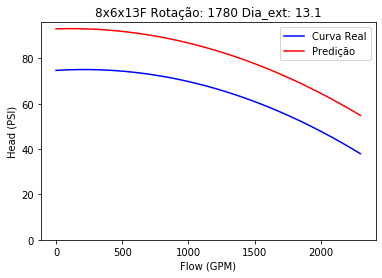

<Figure size 432x288 with 0 Axes>

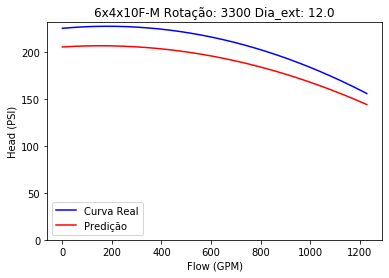

<Figure size 432x288 with 0 Axes>

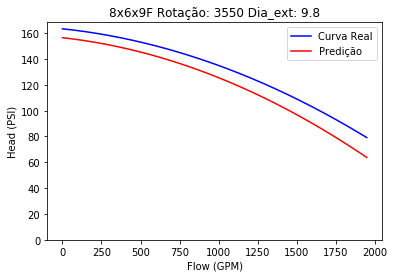

<Figure size 432x288 with 0 Axes>

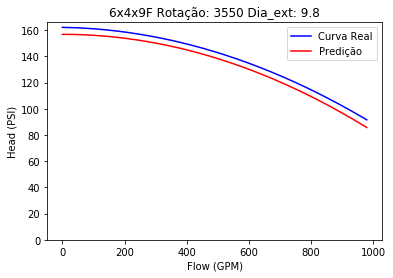

<Figure size 432x288 with 0 Axes>

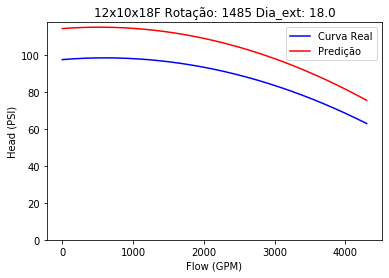

<Figure size 432x288 with 0 Axes>

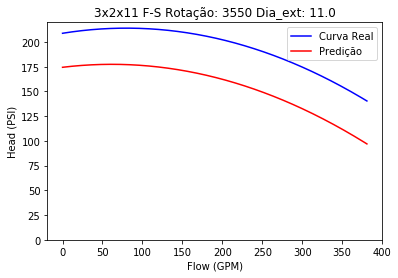

<Figure size 432x288 with 0 Axes>

In [56]:
for indice in df_teste.index:
    #print(X_test.loc[[i]]['Dia_externo'])
    ig, ax = plt.subplots()
    plt.ylabel('Head (PSI)')
    plt.xlabel('Flow (GPM)')
    #plt.title(dici[chave][2][-1]+', rotação: '+str(dici[chave][2][0])+' rpm, diâmetro externo: '+str(dici[chave][2][1])+' inches')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1'][indice],df_teste.loc[[indice]]['a2'][indice],df_teste.loc[[indice]]['a3'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='blue',label='Curva Real')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1p'][indice],df_teste.loc[[indice]]['a2p'][indice],df_teste.loc[[indice]]['a3p'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='red',label='Predição')
    plt.title(str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Modelo)+' Rotação: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Rotacao)+' Dia_ext: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Dia_externo))
    ax.set_ylim(bottom=0)
    plt.legend()
    plt.show()
    plt.clf()

## Hyperparameter Tunning a1

In [139]:
X = df_bombas[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y = df_bombas['a1']

In [140]:
X_train1, X_test1, y_train1, y_test1 = train_test_split(X, y, test_size=0.2, random_state=42)

In [141]:
# Create the random grid
random_grid = {'n_estimators': [10,50,100,200,300],
               'max_features': ['auto','sqrt'],
               'min_samples_split': [2,3,4],
               'min_samples_leaf': [1,2,3]}

rf = RandomForestRegressor(random_state=42)

rf_random = GridSearchCV(estimator = rf, param_grid = random_grid, scoring = 'r2', cv=5)

rf_random.fit(X_train1, y_train1)

C:\Users\evert\Anaconda3\lib\site-packages\sklearn\model_selection\_search.py:813: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


GridSearchCV(cv=5, error_score='raise-deprecating',
             estimator=RandomForestRegressor(bootstrap=True, criterion='mse',
                                             max_depth=None,
                                             max_features='auto',
                                             max_leaf_nodes=None,
                                             min_impurity_decrease=0.0,
                                             min_impurity_split=None,
                                             min_samples_leaf=1,
                                             min_samples_split=2,
                                             min_weight_fraction_leaf=0.0,
                                             n_estimators='warn', n_jobs=None,
                                             oob_score=False, random_state=42,
                                             verbose=0, warm_start=False),
             iid='warn', n_jobs=None,
             param_grid={'max_features': ['auto', 'sqrt'],

In [142]:
rf_random.best_params_

{'max_features': 'auto',
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 300}

In [143]:
y_pred1 = rf_random.predict(X_test1)

In [144]:
mean_absolute_error(y_test1,y_pred1)

21.059298819673106

In [145]:
rf_random.score(X_test1,y_test1)

0.7830613294445703

In [115]:
rf = RandomForestRegressor(random_state = 42, max_features = 'auto', min_samples_leaf=1, min_samples_split = 2, n_estimators = 300)
rf.fit(X_train1, y_train1)

RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=300,
                      n_jobs=None, oob_score=False, random_state=42, verbose=0,
                      warm_start=False)

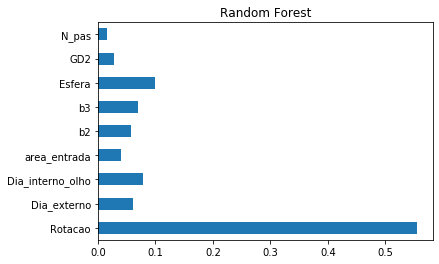

In [116]:
pd.Series(rf.feature_importances_, index=X_train1.columns).plot(kind='barh',title='Random Forest')
plt.show()

[ 5 11 16 22 28 33 39 44 50 56]
[0.82541496 0.88782024 0.91720836 0.93680421 0.95129277 0.95950969
 0.96695245 0.97134623 0.97664992 0.98058133]
[-0.31936988  0.09833207  0.33921637  0.50072216  0.60539256  0.6673909
  0.72829973  0.76556847  0.79965245  0.83098975]


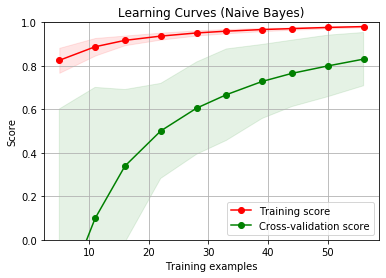

In [103]:
#fig, axes = plt.subplots(3, 2, figsize=(10, 15))

title = "Learning Curves (Naive Bayes)"
# Cross validation with 100 iterations to get smoother mean test and train
# score curves, each time with 20% data randomly selected as a validation set.
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)

estimator = RandomForestRegressor(random_state = 42, max_features = 'auto', min_samples_leaf=1, min_samples_split = 2, n_estimators = 300)
plot_learning_curve(
    estimator, title, X, y, ylim=(0, 1.01), cv=cv, n_jobs=4,train_sizes=np.linspace(0.1, 1.0, 10)
)

plt.show()

## Hyperparameter Tunning a2

In [146]:
X = df_bombas[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y = df_bombas['a2']

In [147]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(X, y, test_size=0.2, random_state=42)

In [148]:
# Create the random grid
random_grid = {'n_estimators': [10,50,100,200,300],
               'max_features': ['auto','sqrt'],
               'min_samples_split': [2,3,4],
               'min_samples_leaf': [1,2,3]}

rf = RandomForestRegressor(random_state=42)

rf_random = GridSearchCV(estimator = rf, param_grid = random_grid, scoring = 'r2', cv=5)

rf_random.fit(X_train2, y_train2)

C:\Users\evert\Anaconda3\lib\site-packages\sklearn\model_selection\_search.py:813: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


GridSearchCV(cv=5, error_score='raise-deprecating',
             estimator=RandomForestRegressor(bootstrap=True, criterion='mse',
                                             max_depth=None,
                                             max_features='auto',
                                             max_leaf_nodes=None,
                                             min_impurity_decrease=0.0,
                                             min_impurity_split=None,
                                             min_samples_leaf=1,
                                             min_samples_split=2,
                                             min_weight_fraction_leaf=0.0,
                                             n_estimators='warn', n_jobs=None,
                                             oob_score=False, random_state=42,
                                             verbose=0, warm_start=False),
             iid='warn', n_jobs=None,
             param_grid={'max_features': ['auto', 'sqrt'],

In [149]:
rf_random.best_params_

{'max_features': 'auto',
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 100}

In [150]:
y_pred2 = rf_random.predict(X_test2)

In [151]:
mean_absolute_error(y_test2,y_pred2)

0.006598022516197461

In [152]:
rf_random.score(X_test2,y_test2)

0.9389973984246475

In [126]:
rf = RandomForestRegressor(random_state = 42, max_features = 'auto', min_samples_leaf=1, min_samples_split = 2, n_estimators = 100)
rf.fit(X_train2, y_train2)

RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=100,
                      n_jobs=None, oob_score=False, random_state=42, verbose=0,
                      warm_start=False)

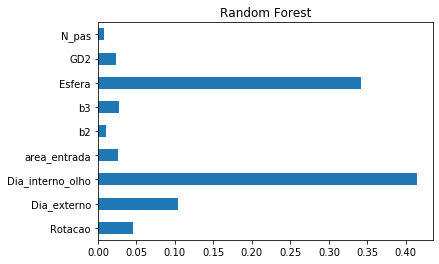

In [127]:
pd.Series(rf.feature_importances_, index=X_train2.columns).plot(kind='barh',title='Random Forest')
plt.show()

[ 5 11 16 22 28 33 39 44 50 56]
[0.81966326 0.86662578 0.90716042 0.94203588 0.96336609 0.97490311
 0.98198886 0.98343244 0.98910535 0.99313688]
[-1.24128926 -0.37085801 -0.03155668  0.21346901  0.66289555  0.72782652
  0.80567352  0.83261129  0.8588986   0.89057231]


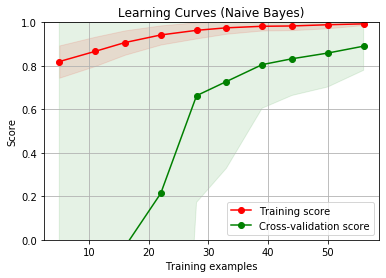

In [128]:
#fig, axes = plt.subplots(3, 2, figsize=(10, 15))

title = "Learning Curves (Naive Bayes)"
# Cross validation with 100 iterations to get smoother mean test and train
# score curves, each time with 20% data randomly selected as a validation set.
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)

estimator = RandomForestRegressor(random_state = 42, max_features = 'auto', min_samples_leaf=1, min_samples_split = 2, n_estimators = 100)
plot_learning_curve(
    estimator, title, X, y, ylim=(0, 1.01), cv=cv, n_jobs=4,train_sizes=np.linspace(0.1, 1.0, 10)
)

plt.show()

## Hyperparameter Tuning: a3

In [153]:
y = df_bombas['a3']
scaler = StandardScaler()
y = scaler.fit_transform(np.array(y).reshape(-1,1))

In [154]:
X_train3, X_test3, y_train3, y_test3 = train_test_split(X, y, test_size=0.2, random_state=42)

In [155]:
# Create the random grid
random_grid = {'n_estimators': [10,50,100,200,300],
               'max_features': ['auto','sqrt'],
               'min_samples_split': [2,3,4],
               'min_samples_leaf': [1,2,3]}

rf = RandomForestRegressor(random_state=42)

rf_random = GridSearchCV(estimator = rf, param_grid = random_grid, scoring = 'r2', cv=5)

rf_random.fit(X_train3, y_train3)

C:\Users\evert\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:514: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
C:\Users\evert\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:514: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
C:\Users\evert\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:514: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
C:\Users\evert\Anaconda3\lib\site-packages\sklearn\model_selection\_validation.py:514: DataConversionWarning: A column-vector y wa

GridSearchCV(cv=5, error_score='raise-deprecating',
             estimator=RandomForestRegressor(bootstrap=True, criterion='mse',
                                             max_depth=None,
                                             max_features='auto',
                                             max_leaf_nodes=None,
                                             min_impurity_decrease=0.0,
                                             min_impurity_split=None,
                                             min_samples_leaf=1,
                                             min_samples_split=2,
                                             min_weight_fraction_leaf=0.0,
                                             n_estimators='warn', n_jobs=None,
                                             oob_score=False, random_state=42,
                                             verbose=0, warm_start=False),
             iid='warn', n_jobs=None,
             param_grid={'max_features': ['auto', 'sqrt'],

In [156]:
rf_random.best_params_

{'max_features': 'auto',
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 100}

In [157]:
y_pred3 = rf_random.predict(X_test3)

In [158]:
mean_absolute_error(y_test3,y_pred3)

0.035918210545898464

In [159]:
rf_random.score(X_test3,y_test3)

0.9981106377858875

In [160]:
y_test31 = scaler.inverse_transform(y_test3)
y_pred31 = scaler.inverse_transform(y_pred3)

In [131]:
rf = RandomForestRegressor(random_state = 42, max_features = 'auto', min_samples_leaf=1, min_samples_split = 2, n_estimators = 100)
rf.fit(X_train3, y_train3)

C:\Users\evert\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=100,
                      n_jobs=None, oob_score=False, random_state=42, verbose=0,
                      warm_start=False)

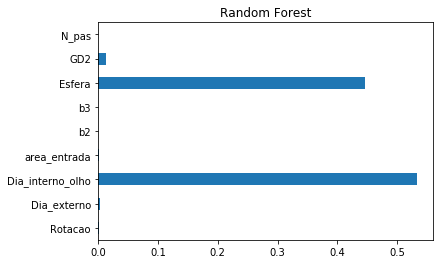

In [132]:
pd.Series(rf.feature_importances_, index=X_train3.columns).plot(kind='barh',title='Random Forest')
plt.show()

[ 5 11 16 22 28 33 39 44 50 56]
[0.85593415 0.89354469 0.92824312 0.95620289 0.97579756 0.98599718
 0.99360551 0.99396329 0.99697357 0.99930813]
[-11.08485837  -5.13985321  -4.21720115  -3.25596906   0.39527116
   0.50854039   0.88280312   0.89985951   0.91806238   0.95082829]


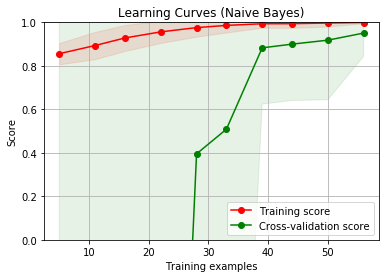

In [133]:
#fig, axes = plt.subplots(3, 2, figsize=(10, 15))

title = "Learning Curves (Naive Bayes)"
# Cross validation with 100 iterations to get smoother mean test and train
# score curves, each time with 20% data randomly selected as a validation set.
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)

estimator = RandomForestRegressor(random_state = 42, max_features = 'auto', min_samples_leaf=1, min_samples_split = 2, n_estimators = 100)
plot_learning_curve(
    estimator, title, X, y, ylim=(0, 1.01), cv=cv, n_jobs=4,train_sizes=np.linspace(0.1, 1.0, 10)
)

plt.show()

## Hyperparameter Tuning: xn

In [161]:
y = df_bombas['xn']

In [162]:
X_train4, X_test4, y_train4, y_test4 = train_test_split(X, y, test_size=0.2, random_state=42)

In [163]:
# Create the random grid
random_grid = {'n_estimators': [10,50,100,200,300],
               'max_features': ['auto','sqrt'],
               'min_samples_split': [2,3,4],
               'min_samples_leaf': [1,2,3]}

rf = RandomForestRegressor(random_state=42)

rf_random = GridSearchCV(estimator = rf, param_grid = random_grid, scoring = 'r2', cv=5)

rf_random.fit(X_train4, y_train4)

C:\Users\evert\Anaconda3\lib\site-packages\sklearn\model_selection\_search.py:813: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


GridSearchCV(cv=5, error_score='raise-deprecating',
             estimator=RandomForestRegressor(bootstrap=True, criterion='mse',
                                             max_depth=None,
                                             max_features='auto',
                                             max_leaf_nodes=None,
                                             min_impurity_decrease=0.0,
                                             min_impurity_split=None,
                                             min_samples_leaf=1,
                                             min_samples_split=2,
                                             min_weight_fraction_leaf=0.0,
                                             n_estimators='warn', n_jobs=None,
                                             oob_score=False, random_state=42,
                                             verbose=0, warm_start=False),
             iid='warn', n_jobs=None,
             param_grid={'max_features': ['auto', 'sqrt'],

In [164]:
rf_random.best_params_

{'max_features': 'auto',
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 50}

In [165]:
y_pred4 = rf_random.predict(X_test4)

In [166]:
mean_absolute_error(y_test4,y_pred4)

122.46142857142857

In [167]:
rf_random.score(X_test4,y_test4)

0.972491974937392

## Diferença nas curvas

In [168]:
df_teste = X_test1
df_teste['a1'] = y_test1
df_teste['a2'] = y_test2
df_teste['a3'] = y_test31
df_teste['xn'] = y_test4
df_teste['a1p'] = y_pred1
df_teste['a2p'] = y_pred2
df_teste['a3p'] = y_pred31
df_teste['xnp'] = y_pred4

In [169]:
df_teste.head()

,Rotacao,Dia_externo,Dia_interno_olho,area_entrada,b2,b3,Esfera,GD2,N_pas,a1,a2,a3,xn,a1p,a2p,a3p,xnp
22,2960,13.7,2.133,10.2,0.915,2.116,0.50,3.0,6,229.322540,0.015853,-0.000036,1460.0,183.600459,0.011263,-0.000035,1406.06
0,2100,11.0,2.132,7.7,0.735,1.699,0.25,3.6,6,74.471923,0.063377,-0.000752,274.0,105.123398,0.077066,-0.000743,323.54
49,1780,17.2,2.449,18.3,1.149,2.656,0.70,18.0,6,128.775940,0.009183,-0.000015,2250.0,174.941872,0.005310,-0.000014,2263.20
4,3300,11.0,2.132,7.7,0.735,1.699,0.25,3.6,6,181.099836,0.112815,-0.000793,355.0,152.723284,0.098105,-0.000772,332.80
54,2100,12.8,2.449,61.9,0.855,1.977,1.13,8.1,7,99.201420,0.002099,-0.000004,3650.0,107.418767,0.002583,-0.000004,3405.20


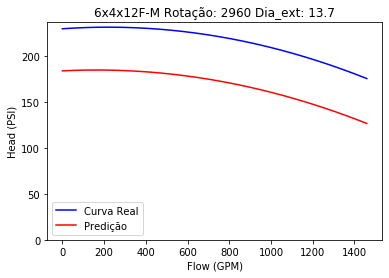

<Figure size 432x288 with 0 Axes>

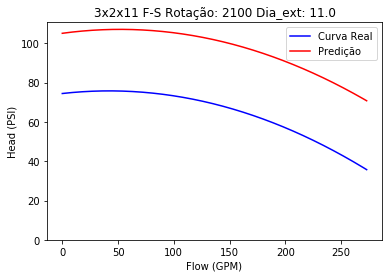

<Figure size 432x288 with 0 Axes>

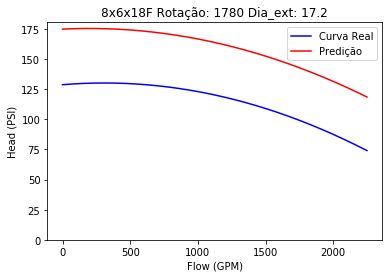

<Figure size 432x288 with 0 Axes>

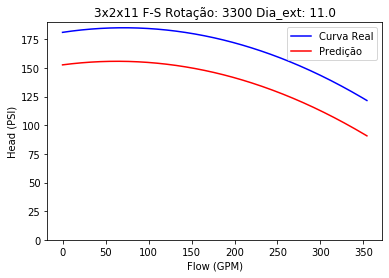

<Figure size 432x288 with 0 Axes>

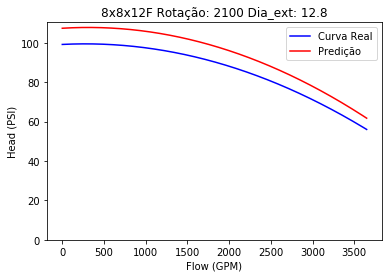

<Figure size 432x288 with 0 Axes>

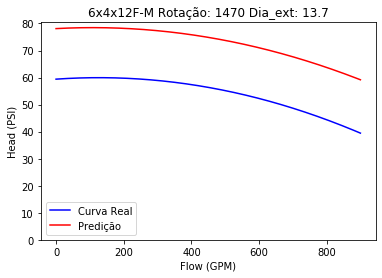

<Figure size 432x288 with 0 Axes>

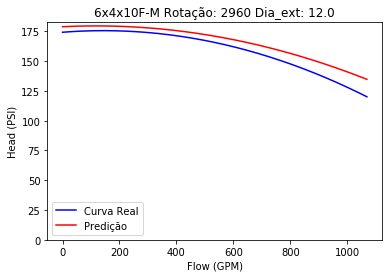

<Figure size 432x288 with 0 Axes>

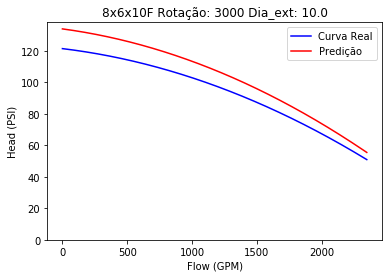

<Figure size 432x288 with 0 Axes>

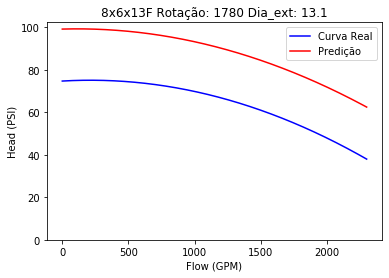

<Figure size 432x288 with 0 Axes>

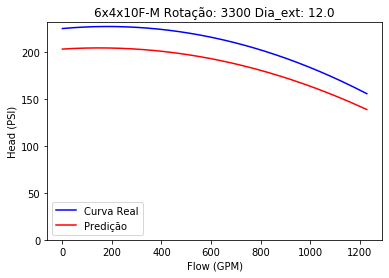

<Figure size 432x288 with 0 Axes>

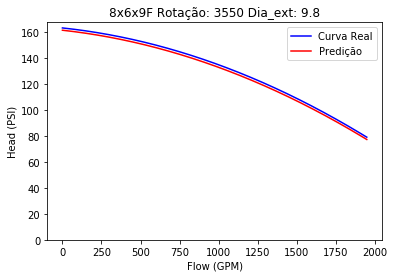

<Figure size 432x288 with 0 Axes>

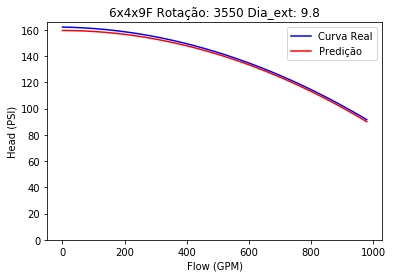

<Figure size 432x288 with 0 Axes>

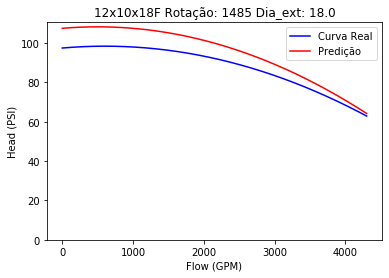

<Figure size 432x288 with 0 Axes>

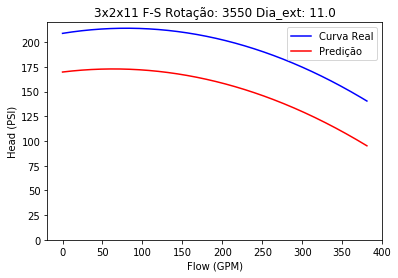

<Figure size 432x288 with 0 Axes>

In [171]:
for indice in df_teste.index:
    #print(X_test.loc[[i]]['Dia_externo'])
    ig, ax = plt.subplots()
    plt.ylabel('Head (PSI)')
    plt.xlabel('Flow (GPM)')
    #plt.title(dici[chave][2][-1]+', rotação: '+str(dici[chave][2][0])+' rpm, diâmetro externo: '+str(dici[chave][2][1])+' inches')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1'][indice],df_teste.loc[[indice]]['a2'][indice],df_teste.loc[[indice]]['a3'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='blue',label='Curva Real')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1p'][indice],df_teste.loc[[indice]]['a2p'][indice],df_teste.loc[[indice]]['a3p'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='red',label='Predição')
    plt.title(str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Modelo)+' Rotação: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Rotacao)+' Dia_ext: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Dia_externo))
    ax.set_ylim(bottom=0)
    plt.legend()
    plt.show()
    plt.clf()

# Montando o dataframe com mais curvas

In [24]:
dici = {'_2100_11_s_3x2x11FS' : [[0,25,50,75,100,125,150,175,200,225,250,274],
                       [75.5,75.3,75.1,74.4,72.9,70.4,67.4,63,57.6,51.2,43.4,34.5],
                      [2100,11,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2100_103_s_3x2x11FS' : [list(np.array(_2100_11_s_3x2x11FS[0])*(10.3/11)),
                       list(np.array(_2100_11_s_3x2x11FS[1])*(7.6/11)**2),
                       [2100,10.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2100_95_s_3x2x11FS' : [list(np.array(_2100_11_s_3x2x11FS[0])*(9.5/11)),
                      list(np.array(_2100_11_s_3x2x11FS[1])*(9.5/11)**2),
                      [2100,9.5,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2100_87_s_3x2x11FS' : [list(np.array(_2100_11_s_3x2x11FS[0])*(8.7/11)),
                      list(np.array(_2100_11_s_3x2x11FS[1])*(8.7/11)**2),
                      [2100,8.7,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2350_11_s_3x2x11FS' : [[0,25,50,75,100,125,150,175,200,225,250,275,300,307],
                               [95,95,94,93,92,90,87,83,78,72,64,56,46,43],
                      [2350,11,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2350_103_s_3x2x11FS' : [list(np.array(_2350_11_s_3x2x11FS[0])*(10.3/11)),
                       list(np.array(_2350_11_s_3x2x11FS[1])*(10.3/11)**2),
                       [2350,10.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2350_97_s_3x2x11FS' : [list(np.array(_2350_11_s_3x2x11FS[0])*(9.7/11)),
                      list(np.array(_2350_11_s_3x2x11FS[1])*(9.7/11)**2),
                      [2350,9.7,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2350_9_s_3x2x11FS' : [list(np.array(_2350_11_s_3x2x11FS[0])*(9/11)),
                     list(np.array(_2350_11_s_3x2x11FS[1])*(9/11)**2),
                     [2350,9,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2350_83_s_3x2x11FS' : [list(np.array(_2350_11_s_3x2x11FS[0])*(8.3/11)),
                      list(np.array(_2350_11_s_3x2x11FS[1])*(8.3/11)**2),
                      [2350,8.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2350_76_s_3x2x11FS' : [list(np.array(_2350_11_s_3x2x11FS[0])*(7.6/11)),
                      list(np.array(_2350_11_s_3x2x11FS[1])*(7.6/11)**2),
                      [2350,7.6,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2960_11_s_3x2x11FS' : [[0,25,50,75,100,125,150,175,200,225,250,275,300,318],
                                   [147.5,148,148,147.5,146,145,143,140,136,130,123,114,104,96],
                      [2960,11,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2960_103_s_3x2x11FS' : [list(np.array(_2960_11_s_3x2x11FS[0])*(10.3/11)),
                      list(np.array(_2960_11_s_3x2x11FS[1])*(10.3/11)**2),
                       [2960,10.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2960_97_s_3x2x11FS' : [list(np.array(_2960_11_s_3x2x11FS[0])*(9.7/11)),
                      list(np.array(_2350_11_s_3x2x11FS[1])*(9.7/11)**2),
                      [2960,9.7,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2960_9_s_3x2x11FS' : [list(np.array(_2960_11_s_3x2x11FS[0])*(9/11)),
                     list(np.array(_2350_11_s_3x2x11FS[1])*(9/11)**2),
                     [2960,9,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2960_83_s_3x2x11FS' : [list(np.array(_2960_11_s_3x2x11FS[0])*(8.3/11)),
                      list(np.array(_2350_11_s_3x2x11FS[1])*(8.3/11)**2),
                      [2960,8.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2960_76_s_3x2x11FS' : [list(np.array(_2960_11_s_3x2x11FS[0])*(7.6/11)),
                      list(np.array(_2960_11_s_3x2x11FS[1])*(7.6/11)**2),
                      [2960,7.6,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3000_11_s_3x2x11FS' : [[0,25,50,75,100,125,150,175,200,225,250,275,300,322.5],
                                   [152,152,152,151,150,149,147,144,140,135,127,119,109,98],
                      [3000,11,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3000_103_s_3x2x11FS' : [list(np.array(_3000_11_s_3x2x11FS[0])*(10.3/11)),
                       list(np.array(_3000_11_s_3x2x11FS[1])*(10.3/11)**2),
                       [3000,10.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3000_97_s_3x2x11FS' : [list(np.array(_3000_11_s_3x2x11FS[0])*(9.7/11)),
                      list(np.array(_3000_11_s_3x2x11FS[1])*(9.7/11)**2),
                      [3000,9.7,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3000_9_s_3x2x11FS' : [list(np.array(_3000_11_s_3x2x11FS[0])*(9/11)),
                     list(np.array(_3000_11_s_3x2x11FS[1])*(9/11)**2),
                     [3000,9,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3000_83_s_3x2x11FS' : [list(np.array(_3000_11_s_3x2x11FS[0])*(8.3/11)),
                      list(np.array(_3000_11_s_3x2x11FS[1])*(8.3/11)**2),
                      [3000,8.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3000_76_s_3x2x11FS' : [list(np.array(_3000_11_s_3x2x11FS[0])*(7.6/11)),
                      list(np.array(_3000_11_s_3x2x11FS[1])*(7.6/11)**2),
                      [3000,7.6,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3300_11_s_3x2x11FS' : [[0,25,50,75,100,125,150,175,200,225,250,275,300,325,350,355],
                               [184,184,184,183,182.5,181,179,176,173,168,162,154,145,134,122,119],
                      [3300,11,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3300_103_s_3x2x11FS' : [list(np.array(_3300_11_s_3x2x11FS[0])*(10.3/11)),
                       list(np.array(_3300_11_s_3x2x11FS[1])*(10.3/11)**2),
                       [3300,10.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3300_97_s_3x2x11FS' : [list(np.array(_3300_11_s_3x2x11FS[0])*(9.7/11)),
                      list(np.array(_3300_11_s_3x2x11FS[1])*(9.7/11)**2),
                      [3300,9.7,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3300_9_s_3x2x11FS' : [list(np.array(_3300_11_s_3x2x11FS[0])*(9/11)),
                     list(np.array(_3300_11_s_3x2x11FS[1])*(9/11)**2),
                     [3300,9,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3300_83_s_3x2x11FS' : [list(np.array(_3300_11_s_3x2x11FS[0])*(8.3/11)),
                      list(np.array(_3300_11_s_3x2x11FS[1])*(8.3/11)**2),
                      [3300,8.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3300_76_s_3x2x11FS' : [list(np.array(_3300_11_s_3x2x11FS[0])*(7.6/11)),
                      list(np.array(_3300_11_s_3x2x11FS[1])*(7.6/11)**2),
                      [3300,7.6,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3550_11_s_3x2x11FS' : [[0,25,50,75,100,125,150,175,200,225,250,275,300,325,350,375,382],
                               [212.5,212.5,212.5,212,211,210,209,206,202.5,198,192.5,186,177,167,155,141,137.5],
                      [3550,11,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3550_103_s_3x2x11FS' : [list(np.array(_3550_11_s_3x2x11FS[0])*(10.3/11)),
                      list(np.array(_3550_11_s_3x2x11FS[1])*(10.3/11)**2),
                       [3550,10.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3550_97_s_3x2x11FS' : [list(np.array(_3550_11_s_3x2x11FS[0])*(9.7/11)),
                      list(np.array(_3550_11_s_3x2x11FS[1])*(9.7/11)**2),
                      [3550,9.7,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3550_9_s_3x2x11FS' : [list(np.array(_3550_11_s_3x2x11FS[0])*(9/11)),
                     list(np.array(_3550_11_s_3x2x11FS[1])*(9/11)**2),
                     [3550,9,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3550_83_s_3x2x11FS' : [list(np.array(_3550_11_s_3x2x11FS[0])*(8.3/11)),
                      list(np.array(_3550_11_s_3x2x11FS[1])*(8.3/11)**2),
                      [3550,8.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3550_76_s_3x2x11FS' : [list(np.array(_3550_11_s_3x2x11FS[0])*(7.6/11)),
                      list(np.array(_3550_11_s_3x2x11FS[1])*(7.6/11)**2),
                      [3550,7.6,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
        '_2950_98_6x4x9F' : [[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700,750,800,850,890],
                            [115,115,114,112,110,108,106,104,102,99,96,92.5,88,84,78,73,67,60,54],
                  [2950,9.8,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_2950_91_6x4x9F' : [list(np.array(_2950_98_6x4x9F[0])*(9.1/9.8)),
                  list(np.array(_2950_98_6x4x9F[1])*(9.1/9.8)**2),
                  [2950,9.1,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_2950_84_6x4x9F' : [list(np.array(_2950_98_6x4x9F[0])*(8.4/9.8)),
                  list(np.array(_2950_98_6x4x9F[1])*(8.4/9.8)**2),
                  [2950,8.4,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_2950_77_6x4x9F' : [list(np.array(_2950_98_6x4x9F[0])*(7.7/9.8)),
                  list(np.array(_2950_98_6x4x9F[1])*(7.7/9.8)**2),
                  [2950,7.7,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_2950_7_6x4x9F' : [list(np.array(_2950_98_6x4x9F[0])*(7/9.8)),
                 list(np.array(_2950_98_6x4x9F[1])*(7/9.8)**2),
                 [2950,7,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3000_98_6x4x9F' : [[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700,750,800,850,900],
                            [117,116,115,113,112,110,108,105,103,100,97.5,94,90,85,80,74,67,61,54],
                  [3000,9.8,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3000_91_6x4x9F' : [list(np.array(_3000_98_6x4x9F[0])*(9.1/9.8)),
                  list(np.array(_2950_98_6x4x9F[1])*(9.1/9.8)**2),
                  [3000,9.1,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3000_84_6x4x9F' : [list(np.array(_3000_98_6x4x9F[0])*(8.4/9.8)),
                  list(np.array(_2950_98_6x4x9F[1])*(8.4/9.8)**2),
                  [3000,8.4,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3000_77_6x4x9F' : [list(np.array(_3000_98_6x4x9F[0])*(7.7/9.8)),
                  list(np.array(_2950_98_6x4x9F[1])*(7.7/9.8)**2),
                  [3000,7.7,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3000_7_6x4x9F' : [list(np.array(_3000_98_6x4x9F[0])*(7/9.8)),
                  list(np.array(_2950_98_6x4x9F[1])*(7/9.8)**2),
                 [3000,7,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3300_98_6x4x9F' : [[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700,750,800,850,900,950,980],
                           [141,140,139,138,136,134,132,130,127.5,124,121,117.5,114,109,105,99,93,87,80,72,67],
                  [3300,9.8,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3300_91_6x4x9F' : [list(np.array(_3300_98_6x4x9F[0])*(9.1/9.8)),
                  list(np.array(_3300_98_6x4x9F[1])*(9.1/9.8)**2),
                  [3300,9.1,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3300_84_6x4x9F' : [list(np.array(_3300_98_6x4x9F[0])*(8.4/9.8)),
                  list(np.array(_3300_98_6x4x9F[1])*(8.4/9.8)**2),
                  [3300,8.4,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3300_77_6x4x9F' : [list(np.array(_3300_98_6x4x9F[0])*(7.7/9.8)),
                  list(np.array(_3300_98_6x4x9F[1])*(7.7/9.8)**2),
                  [3300,7.7,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3300_7_6x4x9F' : [list(np.array(_3300_98_6x4x9F[0])*(7/9.8)),
                  list(np.array(_3300_98_6x4x9F[1])*(7/9.8)**2),
                 [3300,7,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3550_98_6x4x9F' : [[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700,750,800,850,900,950,980],
                            [164,162.5,161,159,157.5,156,154,151,149,146,143,140,135.5,131,126,121,115,109,102,95,90],
                  [3550,9.8,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3550_91_6x4x9F' : [list(np.array(_3550_98_6x4x9F[0])*(9.1/9.8)),
                  list(np.array(_3550_98_6x4x9F[1])*(9.1/9.8)**2),
                  [3550,9.1,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3550_84_6x4x9F' : [list(np.array(_3550_98_6x4x9F[0])*(8.4/9.8)),
                  list(np.array(_3550_98_6x4x9F[1])*(8.4/9.8)**2),
                  [3550,8.4,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3550_77_6x4x9F' : [list(np.array(_3550_98_6x4x9F[0])*(7.7/9.8)),
                  list(np.array(_3550_98_6x4x9F[1])*(7.7/9.8)**2),
                  [3550,7.7,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3550_7_6x4x9F' : [list(np.array(_3550_98_6x4x9F[0])*(7/9.8)),
                  list(np.array(_3550_98_6x4x9F[1])*(7/9.8)**2),
                 [3550,7,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
        '_6x4x10FM_2960_12' : [[0,100,200,300,400,500,600,700,800,900,1000,1070],
                        [175,175,175,174,171,167.5,162.5,156,148,138,128,120],
                      [2960,12,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_2960_11' : [list(np.array(_6x4x10FM_2960_12[0])*(11/12)),
                  list(np.array(_6x4x10FM_2960_12[1])*(11/12)**2),
                    [2960,11,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_2960_10' : [list(np.array(_6x4x10FM_2960_12[0])*(10/12)),
                  list(np.array(_6x4x10FM_2960_12[1])*(10/12)**2),
                    [2960,10,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3000_12' : [[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700,750,800,850,900,950,995],
                      [187.5,187.5,187,187,186,185,184,183,182,180,177.5,175.5,173,170,167.5,164,160,157,152,147.5,143],
                      [3000,12,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3000_115' : [list(np.array(_6x4x10FM_3000_12[0])*(11.5/12)),
                  list(np.array(_6x4x10FM_3000_12[1])*(11.5/12)**2),
                     [3000,11.5,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3000_109' : [list(np.array(_6x4x10FM_3000_12[0])*(10.9/12)),
                  list(np.array(_6x4x10FM_3000_12[1])*(10.9/12)**2),
                     [3000,10.9,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3000_104' : [list(np.array(_6x4x10FM_3000_12[0])*(10.4/12)),
                  list(np.array(_6x4x10FM_3000_12[1])*(10.4/12)**2),
                     [3000,10.4,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3300_12' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1230],
                     [227.5,227,226,225,223,220,216,210,204,195,185,173,161,152],
                     [3300,12,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3300_109' : [list(np.array(_6x4x10FM_3300_12[0])*(10.9/12)),
                  list(np.array(_6x4x10FM_3300_12[1])*(10.9/12)**2),
                     [3300,10.9,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3300_98' : [list(np.array(_6x4x10FM_3300_12[0])*(9.8/12)),
                  list(np.array(_6x4x10FM_3300_12[1])*(9.8/12)**2),
                    [3300,9.8,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3300_88' : [list(np.array(_6x4x10FM_3300_12[0])*(8.8/12)),
                  list(np.array(_6x4x10FM_3300_12[1])*(8.8/12)**2),
                    [3300,8.8,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3555_12' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1418],
                     [265,265,264,262,260,256,251,245,237,227.5,217,205,191,176,159,157],
                     [3555,12,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3555_109' : [list(np.array(_6x4x10FM_3555_12[0])*(10.9/12)),
                  list(np.array(_6x4x10FM_3555_12[1])*(10.9/12)**2),
                     [3555,10.9,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3555_98' : [list(np.array(_6x4x10FM_3555_12[0])*(9.8/12)),
                  list(np.array(_6x4x10FM_3555_12[1])*(9.8/12)**2),
                    [3555,9.8,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3555_87' : [list(np.array(_6x4x10FM_3555_12[0])*(8.7/12)),
                  list(np.array(_6x4x10FM_3555_12[1])*(8.7/12)**2),
                    [3555,8.7,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
        '_6x4x11F_2960_116' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1500,1600,1620],
                    [174.5,174.5,174.5,174,173,172,170,167.5,165,161.5,157,151,145,137.5,130,120,110,108],
                    [2960,11.6,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']],
'_6x4x11F_2960_105' : [list(np.array(_6x4x11F_2960_116[0])*(10.5/11.6)),
                  list(np.array(_6x4x11F_2960_116[1])*(10.5/11.6)**2),
                    [2960,10.5,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']],
'_6x4x11F_3000_116' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1500,1600,1640],
                    [178,178,178,177.5,177,176,175,172.5,169,165,160,155,148,140,132.5,124,115,110],
                    [3000,11.6,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']],
'_6x4x11F_3000_105' : [list(np.array(_6x4x11F_3000_116[0])*(10.5/11.6)),
                  list(np.array(_6x4x11F_3000_116[1])*(10.5/11.6)**2),
                    [3000,10.5,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']],
'_6x4x11F_3300_116' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1650],
                    [212.5,212.5,212.5,212.5,211,210,207.5,203,197.5,191,182.5,170.2,162,150,147.5],
                    [3300,11.6,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']],
'_6x4x11F_3300_103' : [list(np.array(_6x4x11F_3300_116[0])*(10.3/11.6)),
                  list(np.array(_6x4x11F_3300_116[1])*(10.3/11.6)**2),
                    [3300,10.3,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']],
'_6x4x11F_3300_9' : [list(np.array(_6x4x11F_3300_116[0])*(9/11.6)),
                  list(np.array(_6x4x11F_3300_116[1])*(9/11.6)**2),
                  [3300,9,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']],
'_6x4x11F_3555_116' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1800],
                    [249,249,249,249,248,246,244.5,240,235,227.5,220,210,197,188,168,162],
                    [3555,11.6,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']],
'_6x4x11F_3555_103' : [list(np.array(_6x4x11F_3555_116[0])*(10.3/11.6)),
                  list(np.array(_6x4x11F_3555_116[1])*(10.3/11.6)**2),
                    [3555,10.3,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']],
'_6x4x11F_3555_9' : [list(np.array(_6x4x11F_3555_116[0])*(9/11.6)),
                  list(np.array(_6x4x11F_3555_116[1])*(9/11.6)**2),
                  [3555,9,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']],
        '_6x4x12FM_1470_137' : [[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700,750,800,850,900],
                     [60,60,59.9,59.6,59.3,59,58.7,58,57.3,56.5,55.3,54,52.6,51,49,46.7,44.2,41.8,39],
                     [1470,13.7,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_1470_124' : [list(np.array(_6x4x12FM_1470_137[0])*(12.4/13.7)),
                  list(np.array(_6x4x12FM_1470_137[1])*(12.4/13.7)**2),
                     [1470,12.4,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_1770_137' : [[0,100,200,300,400,500,600,700,800,900,1000,1050],
                     [87.5,87,86.5,85.5,84,82,79.5,76.5,73,68.5,63.5,60.5],
                     [1770,13.7,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_1770_122' : [list(np.array(_6x4x12FM_1770_137[0])*(12.2/13.7)),
                  list(np.array(_6x4x12FM_1770_137[1])*(12.2/13.7)**2),
                     [1770,12.2,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_1770_102' : [list(np.array(_6x4x12FM_1770_137[0])*(10.2/13.7)),
                  list(np.array(_6x4x12FM_1770_137[1])*(10.2/13.7)**2),
                     [1770,10.2,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2100_137' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200],
                     [120,120,119,118,116,115,112,109,105,101,95,88,79],
                     [2100,13.7,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2100_123' : [list(np.array(_6x4x12FM_2100_137[0])*(12.3/13.7)),
                  list(np.array(_6x4x12FM_2100_137[1])*(12.3/13.7)**2),
                     [2100,12.3,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2100_105' : [list(np.array(_6x4x12FM_2100_137[0])*(10.5/13.7)),
                  list(np.array(_6x4x12FM_2100_137[1])*(10.5/13.7)**2),
                     [2100,10.5,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2100_86' : [list(np.array(_6x4x12FM_2100_137[0])*(8.6/13.7)),
                  list(np.array(_6x4x12FM_2100_137[1])*(8.6/13.7)**2),
                    [2100,8.6,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2350_137' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1500],
                     [147.5,147,146.5,146,145,144,142.5,140,136,132,126,119,112.5,103,94,85],
                     [2350,13.7,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2350_119' : [list(np.array(_6x4x12FM_2350_137[0])*(11.9/13.7)),
                  list(np.array(_6x4x12FM_2350_137[1])*(11.9/13.7)**2),
                     [2350,11.9,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2350_101' : [list(np.array(_6x4x12FM_2350_137[0])*(10.1/13.7)),
                  list(np.array(_6x4x12FM_2350_137[1])*(10.1/13.7)**2),
                     [2350,10.1,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2350_78' : [list(np.array(_6x4x12FM_2350_137[0])*(7.8/13.7)),
                  list(np.array(_6x4x12FM_2350_137[1])*(7.8/13.7)**2),
                    [2350,7.8,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2960_137' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1460],
                     [231,230,230,229,228,225,221,217,210,201,192,181,176],
                     [2960,13.7,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2960_124' : [list(np.array(_6x4x12FM_2960_137[0])*(12.4/13.7)),
                  list(np.array(_6x4x12FM_2960_137[1])*(12.4/13.7)**2),
                     [2960,12.4,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2960_11' : [list(np.array(_6x4x12FM_2960_137[0])*(11/13.7)),
                  list(np.array(_6x4x12FM_2960_137[1])*(11/13.7)**2),
                    [2960,11,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2960_95' : [list(np.array(_6x4x12FM_2960_137[0])*(9.5/13.7)),
                  list(np.array(_6x4x12FM_2960_137[1])*(9.5/13.7)**2),
                    [2960,9.5,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_3000_137' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1487],
                     [242,241,240,239,236,231,228,222,217,209,200,189,177],
                     [3000,13.7,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_3000_124' : [list(np.array(_6x4x12FM_3000_137[0])*(12.4/13.7)),
                  list(np.array(_6x4x12FM_3000_137[1])*(12.4/13.7)**2),
                     [3000,12.4,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_3000_11' : [list(np.array(_6x4x12FM_3000_137[0])*(11/13.7)),
                  list(np.array(_6x4x12FM_3000_137[1])*(11/13.7)**2),
                    [3000,11,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_3000_95' : [list(np.array(_6x4x12FM_3000_137[0])*(9.5/13.7)),
                  list(np.array(_6x4x12FM_3000_137[1])*(9.5/13.7)**2),
                    [3000,9.5,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
        '_6x6x9F_2950_98' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1140],
                  [112,109,106,104,100.5,97.5,94,90,84,78,71,63,59],
                  [2950,9.8,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_2950_9' : [list(np.array(_6x6x9F_2950_98[0])*(9/9.8)),
                  list(np.array(_6x6x9F_2950_98[1])*(9/9.8)**2),
                 [2950,9,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_2950_82' : [list(np.array(_6x6x9F_2950_98[0])*(8.2/9.8)),
                  list(np.array(_6x6x9F_2950_98[1])*(8.2/9.8)**2),
                  [2950,8.2,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_2950_74' : [list(np.array(_6x6x9F_2950_98[0])*(7.4/9.8)),
                  list(np.array(_6x6x9F_2950_98[1])*(7.4/9.8)**2),
                  [2950,7.4,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_2950_65' : [list(np.array(_6x6x9F_2950_98[0])*(6.5/9.8)),
                  list(np.array(_6x6x9F_2950_98[1])*(6.5/9.8)**2),
                  [2950,6.5,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3000_98' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1160],
                  [115,112.5,110,107.5,105,101,97.5,93,87.5,82,75,67,62],
                  [3000,9.8,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3000_9' : [list(np.array(_6x6x9F_3000_98[0])*(9/9.8)),
                  list(np.array(_6x6x9F_3000_98[1])*(9/9.8)**2),
                 [3000,9,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3000_82' : [list(np.array(_6x6x9F_3000_98[0])*(8.2/9.8)),
                  list(np.array(_6x6x9F_3000_98[1])*(8.2/9.8)**2),
                  [3000,8.2,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3000_74' : [list(np.array(_6x6x9F_3000_98[0])*(7.4/9.8)),
                  list(np.array(_6x6x9F_3000_98[1])*(7.4/9.8)**2),
                  [3000,7.4,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3000_65' : [list(np.array(_6x6x9F_3000_98[0])*(6.5/9.8)),
                  list(np.array(_6x6x9F_3000_98[1])*(6.5/9.8)**2),
                  [3000,6.5,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3300_98' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300],
                  [140,137.5,134.5,131,127.5,124.5,120,115,110,105,97.5,90,81,72],
                  [3300,9.8,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3300_9' : [list(np.array(_6x6x9F_3300_98[0])*(9/9.8)),
                  list(np.array(_6x6x9F_3300_98[1])*(9/9.8)**2),
                 [3300,9,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3300_82' : [list(np.array(_6x6x9F_3300_98[0])*(8.2/9.8)),
                  list(np.array(_6x6x9F_3300_98[1])*(8.2/9.8)**2),
                  [3300,8.2,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3300_74' : [list(np.array(_6x6x9F_3300_98[0])*(7.4/9.8)),
                  list(np.array(_6x6x9F_3300_98[1])*(7.4/9.8)**2),
                  [3300,7.4,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3300_65' : [list(np.array(_6x6x9F_3300_98[0])*(6.5/9.8)),
                  list(np.array(_6x6x9F_3300_98[1])*(6.5/9.8)**2),
                  [3300,6.5,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3550_98' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400],
                  [162,158,155,152,148,145,140,136,132,125,118,110,102,92.5,82.5],
                  [3550,9.8,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3550_9' : [list(np.array(_6x6x9F_3550_98[0])*(9/9.8)),
                  list(np.array(_6x6x9F_3550_98[1])*(9/9.8)**2),
                  [3550,9,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3550_83' : [list(np.array(_6x6x9F_3550_98[0])*(8.3/9.8)),
                  list(np.array(_6x6x9F_3550_98[1])*(8.3/9.8)**2),
                  [3550,8.3,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3550_76' : [list(np.array(_6x6x9F_3550_98[0])*(7.6/9.8)),
                  list(np.array(_6x6x9F_3550_98[1])*(7.6/9.8)**2),
                  [3550,7.6,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3550_7' : [list(np.array(_6x6x9F_3550_98[0])*(7/9.8)),
                  list(np.array(_6x6x9F_3550_98[1])*(7/9.8)**2),
                 [3550,7,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
        '_8x6x9F_2950_98' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1500,1600,1700,1720],
                    [115,112.5,110,107.5,105,102.5,100,97,94.5,90.5,87,83,78,73,67.5,62,55,48,47],
                    [2950,9.8,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_2950_91' : [list(np.array(_8x6x9F_2950_98[0])*(9.1/9.8)),
                  list(np.array(_8x6x9F_2950_98[1])*(9.1/9.8)**2),
                  [2950,9.1,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_2950_84' : [list(np.array(_8x6x9F_2950_98[0])*(8.4/9.8)),
                  list(np.array(_8x6x9F_2950_98[1])*(8.4/9.8)**2),
                  [2950,8.4,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_2950_77' : [list(np.array(_8x6x9F_2950_98[0])*(7.7/9.8)),
                  list(np.array(_8x6x9F_2950_98[1])*(7.7/9.8)**2),
                  [2950,7.7,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_2950_7' : [list(np.array(_8x6x9F_2950_98[0])*(7/9.8)),
                  list(np.array(_8x6x9F_2950_98[1])*(7/9.8)**2),
                 [2950,7,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3000_98' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750],
                    [119.5,115.5,112.5,110,106,103,99.5,95,90.5,85,80,72.5,65.5,57.5,49],
                    [3000,9.8,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3000_91' : [list(np.array(_8x6x9F_3000_98[0])*(9.1/9.8)),
                  list(np.array(_8x6x9F_3000_98[1])*(9.1/9.8)**2),
                  [3000,9.1,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3000_84' : [list(np.array(_8x6x9F_3000_98[0])*(8.4/9.8)),
                  list(np.array(_8x6x9F_3000_98[1])*(8.4/9.8)**2),
                  [3000,8.4,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3000_77' : [list(np.array(_8x6x9F_3000_98[0])*(7.7/9.8)),
                  list(np.array(_8x6x9F_3000_98[1])*(7.7/9.8)**2),
                  [3000,7.7,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3000_7' : [list(np.array(_8x6x9F_3000_98[0])*(7/9.8)),
                  list(np.array(_8x6x9F_3000_98[1])*(7/9.8)**2),
                 [3000,7,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3300_98' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875],
                    [143,140,137,133,130,126,122.5,117,114,108,102.5,95.5,88,80,72,62.5],
                    [3300,9.8,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3300_91' : [list(np.array(_8x6x9F_3300_98[0])*(9.1/9.8)),
                  list(np.array(_8x6x9F_3300_98[1])*(9.1/9.8)**2),
                  [3300,9.1,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3300_84' : [list(np.array(_8x6x9F_3300_98[0])*(8.4/9.8)),
                  list(np.array(_8x6x9F_3300_98[1])*(8.4/9.8)**2),
                  [3300,8.4,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3300_77' : [list(np.array(_8x6x9F_3300_98[0])*(7.7/9.8)),
                  list(np.array(_8x6x9F_3300_98[1])*(7.7/9.8)**2),
                  [3300,7.7,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3300_7' : [list(np.array(_8x6x9F_3300_98[0])*(7/9.8)),
                  list(np.array(_8x6x9F_3300_98[1])*(7/9.8)**2),
                 [3300,7,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3550_98' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,1950],
                  [165,162,159,155,152,148,145,140,135,130,124,117,110,102,93,84,78],
                  [3550,9.8,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3550_91' : [list(np.array(_8x6x9F_3550_98[0])*(9.1/9.8)),
                  list(np.array(_8x6x9F_3550_98[1])*(9.1/9.8)**2),
                  [3550,9.1,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3550_84' : [list(np.array(_8x6x9F_3550_98[0])*(8.4/9.8)),
                  list(np.array(_8x6x9F_3550_98[1])*(8.4/9.8)**2),
                  [3550,8.4,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3550_77' : [list(np.array(_8x6x9F_3550_98[0])*(7.7/9.8)),
                  list(np.array(_8x6x9F_3550_98[1])*(7.7/9.8)**2),
                  [3550,7.7,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3550_7' : [list(np.array(_8x6x9F_3550_98[0])*(7/9.8)),
                  list(np.array(_8x6x9F_3550_98[1])*(7/9.8)**2),
                 [3550,7,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
        '_8x6x10F_2960_10' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,2000,2125,2250,2320],
                   [121,118,115,112,110,107,105,102,100,97,93,90,85,81,76,70,65,58,52,48],
                   [2960,10,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_2960_94' : [list(np.array(_8x6x10F_2960_10[0])*(10.4/10)),
                  list(np.array(_8x6x10F_2960_10[1])*(10.4/10)**2),
                   [2960,9.4,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_2960_88' : [list(np.array(_8x6x10F_2960_10[0])*(8.8/10)),
                  list(np.array(_8x6x10F_2960_10[1])*(8.8/10)**2),
                   [2960,8.8,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_2960_82' : [list(np.array(_8x6x10F_2960_10[0])*(8.2/10)),
                  list(np.array(_8x6x10F_2960_10[1])*(8.2/10)**2),
                   [2960,8.2,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_2960_76' : [list(np.array(_8x6x10F_2960_10[0])*(7.6/10)),
                  list(np.array(_8x6x10F_2960_10[1])*(7.6/10)**2),
                   [2960,7.6,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3000_10' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,2000,2125,2250,2350],
                   [125,121,117.5,115,112.5,110,107.5,105,102,100,96,93,89,85,79,74,67.5,61,55,49],
                   [3000,10,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3000_94' : [list(np.array(_8x6x10F_3000_10[0])*(9.4/10)),
                  list(np.array(_8x6x10F_3000_10[1])*(9.4/10)**2),
                   [3000,9.4,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3000_88' : [list(np.array(_8x6x10F_3000_10[0])*(8.8/10)),
                  list(np.array(_8x6x10F_3000_10[1])*(8.8/10)**2),
                   [3000,8.8,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3000_82' : [list(np.array(_8x6x10F_3000_10[0])*(8.2/10)),
                  list(np.array(_8x6x10F_3000_10[1])*(8.2/10)**2),
                   [3000,8.2,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3000_76' : [list(np.array(_8x6x10F_3000_10[0])*(7.6/10)),
                  list(np.array(_8x6x10F_3000_10[1])*(7.6/10)**2),
                   [3000,7.6,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3300_10' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2550],
                   [151,142,136,131,126,120,112.5,103,92,78,63,60],
                   [3300,10,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3300_94' : [list(np.array(_8x6x10F_3300_10[0])*(9.4/10)),
                  list(np.array(_8x6x10F_3300_10[1])*(9.4/10)**2),
                   [3300,9.4,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3300_88' : [list(np.array(_8x6x10F_3300_10[0])*(8.8/10)),
                  list(np.array(_8x6x10F_3300_10[1])*(8.8/10)**2),
                   [3300,8.8,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3300_82' : [list(np.array(_8x6x10F_3300_10[0])*(8.2/10)),
                  list(np.array(_8x6x10F_3300_10[1])*(8.2/10)**2),
                   [3300,8.2,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3300_76' : [list(np.array(_8x6x10F_3300_10[0])*(7.6/10)),
                  list(np.array(_8x6x10F_3300_10[1])*(7.6/10)**2),
                   [3300,7.6,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3550_10' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750],
                   [175,165,159,153,147.5,141,134,124,112,99,84,67.5],
                   [3550,10,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3550_94' : [list(np.array(_8x6x10F_3550_10[0])*(9.4/10)),
                  list(np.array(_8x6x10F_3550_10[1])*(9.4/10)**2),
                   [3550,9.4,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3550_88' : [list(np.array(_8x6x10F_3550_10[0])*(8.8/10)),
                  list(np.array(_8x6x10F_3550_10[1])*(8.8/10)**2),
                   [3550,8.8,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3550_82' : [list(np.array(_8x6x10F_3550_10[0])*(8.2/10)),
                  list(np.array(_8x6x10F_3550_10[1])*(8.2/10)**2),
                   [3550,8.2,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3550_76' : [list(np.array(_8x6x10F_3550_10[0])*(7.6/10)),
                  list(np.array(_8x6x10F_3550_10[1])*(7.6/10)**2),
                   [3550,7.6,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
        '_8x6x12FS_1485_129' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400],
                     [51.3,50.8,50.1,49.2,48.4,47.3,46.2,44.9,43.6,42,40.4,38.5,36.5,34,31.9],
                     [1485,12.9,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_1485_128' : [list(np.array(_8x6x12FS_1485_129[0])*(12.8/12.9)),
                  list(np.array(_8x6x12FS_1485_129[1])*(12.8/12.9)**2),
                     [1485,12.9,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_1485_122' : [list(np.array(_8x6x12FS_1485_129[0])*(12.2/12.9)),
                  list(np.array(_8x6x12FS_1485_129[1])*(12.2/12.9)**2),
                     [1485,12.2,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_1765_129' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1825],
                     [72,71.1,70.1,69.5,68,66.8,65.5,63.7,61,58.7,55.8,52,48,44,39,35.9],
                     [1765,12.9,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_1765_128' : [list(np.array(_8x6x12FS_1765_129[0])*(12.8/12.9)),
                  list(np.array(_8x6x12FS_1765_129[1])*(12.8/12.9)**2),
                     [1765,12.8,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_1765_122' : [list(np.array(_8x6x12FS_1765_129[0])*(12.2/12.9)),
                  list(np.array(_8x6x12FS_1765_129[1])*(12.2/12.9)**2),
                     [1765,12.2,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_1765_116' : [list(np.array(_8x6x12FS_1765_129[0])*(11.6/12.9)),
                  list(np.array(_8x6x12FS_1765_129[1])*(11.6/12.9)**2),
                     [1765,11.6,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_1765_11' : [list(np.array(_8x6x12FS_1765_129[0])*(11/12.9)),
                  list(np.array(_8x6x12FS_1765_129[1])*(11/12.9)**2),
                     [1765,11,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_1765_104' : [list(np.array(_8x6x12FS_1765_129[0])*(10.4/12.9)),
                  list(np.array(_8x6x12FS_1765_129[1])*(10.4/12.9)**2),
                     [1765,10.4,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_2100_129' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1825],
                     [104,102,100,99,97,96,95,93,91,88,85,82,78,74,69,63],
                     [2100,12.9,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_2100_128' : [list(np.array(_8x6x12FS_2100_129[0])*(12.8/12.9)),
                  list(np.array(_8x6x12FS_2100_129[1])*(12.8/12.9)**2),
                     [2100,12.8,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_2100_122' : [list(np.array(_8x6x12FS_2100_129[0])*(12.2/12.9)),
                  list(np.array(_8x6x12FS_2100_129[1])*(12.2/12.9)**2),
                     [2100,12.2,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_2100_116' : [list(np.array(_8x6x12FS_2100_129[0])*(11.6/12.9)),
                  list(np.array(_8x6x12FS_2100_129[1])*(11.6/12.9)**2),
                     [2100,11.6,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_2100_11' : [list(np.array(_8x6x12FS_2100_129[0])*(11/12.9)),
                  list(np.array(_8x6x12FS_2100_129[1])*(11/12.9)**2),
                     [2100,11,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_2350_129' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,1950],
                     [128,126,125,124,122,120,119,117,115,113,110,107,103,99,95,90,86],
                     [2350,12.9,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_2350_128' : [list(np.array(_8x6x12FS_2350_129[0])*(12.8/12.9)),
                  list(np.array(_8x6x12FS_2350_129[1])*(12.8/12.9)**2),
                     [2350,12.8,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_2350_122' : [list(np.array(_8x6x12FS_2350_129[0])*(12.2/12.9)),
                  list(np.array(_8x6x12FS_2350_129[1])*(12.2/12.9)**2),
                     [2350,12.2,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_2350_116' : [list(np.array(_8x6x12FS_2350_129[0])*(11.6/12.9)),
                  list(np.array(_8x6x12FS_2350_129[1])*(11.6/12.9)**2),
                     [2350,11.6,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_2350_11' : [list(np.array(_8x6x12FS_2350_129[0])*(11/12.9)),
                  list(np.array(_8x6x12FS_2350_129[1])*(11/12.9)**2),
                     [2350,11,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
        '_8x6x12FM_2960_115' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2570],
                     [160,158,155,152.5,149,145,140,135,130,120,110,106],
                     [2960,11.5,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_2960_108' : [list(np.array(_8x6x12FM_2960_115[0])*(10.8/11.5)),
                  list(np.array(_8x6x12FM_2960_115[1])*(10.8/12.9)**2),
                     [2960,10.8,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_2960_101' : [list(np.array(_8x6x12FM_2960_115[0])*(10.1/11.5)),
                  list(np.array(_8x6x12FM_2960_115[1])*(10.1/12.9)**2),
                     [2960,10.1,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_2960_93' : [list(np.array(_8x6x12FM_2960_115[0])*(9.3/11.5)),
                  list(np.array(_8x6x12FM_2960_115[1])*(9.3/12.9)**2),
                     [2960,9.3,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3000_114' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2525],
                     [169,168,165.5,163,159,154,148,142,135,129,121,120],
                     [3000,11.4,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3000_107' : [list(np.array(_8x6x12FM_3000_114[0])*(10.7/11.4)),
                  list(np.array(_8x6x12FM_3000_114[1])*(10.7/11.4)**2),
                     [3000,10.7,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3000_10' : [list(np.array(_8x6x12FM_3000_114[0])*(10/11.4)),
                  list(np.array(_8x6x12FM_3000_114[1])*(10/11.4)**2),
                     [3000,10,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3000_92' : [list(np.array(_8x6x12FM_3000_114[0])*(9.2/11.4)),
                  list(np.array(_8x6x12FM_3000_114[1])*(9.2/11.4)**2),
                     [3000,9.2,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3300_114' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3200],
                     [200,199,197.5,195,192,188,184,177.5,171,164,155,145,135,125],
                     [3300,11.4,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3300_102' : [list(np.array(_8x6x12FM_3300_114[0])*(10.2/11.4)),
                  list(np.array(_8x6x12FM_3300_114[1])*(10.2/11.4)**2),
                     [3300,10.2,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3300_91' : [list(np.array(_8x6x12FM_3300_114[0])*(9.1/11.4)),
                  list(np.array(_8x6x12FM_3300_114[1])*(9.1/11.4)**2),
                     [3300,9.1,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3300_8' : [list(np.array(_8x6x12FM_3300_114[0])*(8/11.4)),
                  list(np.array(_8x6x12FM_3300_114[1])*(8/11.4)**2),
                     [3300,8,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3555_113' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500],
                     [230,229,225,222,220,216,210,204,199,190,182,174,165,153,141],
                     [3555,11.3,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3555_102' : [list(np.array(_8x6x12FM_3555_113[0])*(10.2/11.3)),
                  list(np.array(_8x6x12FM_3555_113[1])*(10.2/11.3)**2),
                     [3555,10.2,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3555_91' : [list(np.array(_8x6x12FM_3555_113[0])*(9.1/11.3)),
                  list(np.array(_8x6x12FM_3555_113[1])*(9.1/11.3)**2),
                     [3555,9.1,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3555_8' : [list(np.array(_8x6x12FM_3555_113[0])*(8/11.3)),
                  list(np.array(_8x6x12FM_3555_113[1])*(8/11.3)**2),
                     [3555,8,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
        '_8x6x13F_1480_131' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1500,1600,1700,1800],
                    [52.4,51.9,51.1,50.8,50.2,49.8,49.1,48.5,47.8,46.8,45.5,44,42.5,40.8,38.8,36.5,34,31.5,28.8],
                    [1480,13.1,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_1480_125' : [list(np.array(_8x6x13F_1480_131[0])*(12.5/13.1)),
                  list(np.array(_8x6x13F_1480_131[1])*(12.5/13.1)**2),
                    [1480,12.5,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_1780_131' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,2000,2125,2250,2300],
                    [76.5,75.5,74.5,74,73.5,72.5,72,71,70,68,66.5,64,62,58.5,55.5,52,48,43.5,39,37.5],
                    [1780,13.1,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_1780_124' : [list(np.array(_8x6x13F_1780_131[0])*(12.4/13.1)),
                  list(np.array(_8x6x13F_1780_131[1])*(12.4/13.1)**2),
                    [1780,12.4,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_1780_117' : [list(np.array(_8x6x13F_1780_131[0])*(11.7/13.1)),
                  list(np.array(_8x6x13F_1780_131[1])*(11.7/13.1)**2),
                    [1780,11.7,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_1780_11' : [list(np.array(_8x6x13F_1780_131[0])*(11/13.1)),
                  list(np.array(_8x6x13F_1780_131[1])*(11/13.1)**2),
                    [1780,11,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_2100_131' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750],
                    [105.5,103.5,102,100,98,94.5,90.5,85,78,70,60.5,50],
                    [2100,13.1,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_2100_12' : [list(np.array(_8x6x13F_2100_131[0])*(12/13.1)),
                  list(np.array(_8x6x13F_2100_131[1])*(12/13.1)**2),
                   [2100,12,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_2100_108' : [list(np.array(_8x6x13F_2100_131[0])*(10.8/13.1)),
                  list(np.array(_8x6x13F_2100_131[1])*(10.8/13.1)**2),
                   [2100,10.8,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_2100_96' : [list(np.array(_8x6x13F_2100_131[0])*(9.6/13.1)),
                  list(np.array(_8x6x13F_2100_131[1])*(9.6/13.1)**2),
                   [2100,9.6,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_2350_131' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750],
                    [134.5,132,130,127.5,125,121.5,117.5,112.5,105.5,98,90,79.5],
                    [2350,13.1,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_2350_121' : [list(np.array(_8x6x13F_2350_131[0])*(12.1/13.1)),
                  list(np.array(_8x6x13F_2350_131[1])*(12.1/13.1)**2),
                    [2350,12.1,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_2350_11' : [list(np.array(_8x6x13F_2350_131[0])*(11/13.1)),
                  list(np.array(_8x6x13F_2350_131[1])*(11/13.1)**2),
                    [2350,11,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_2350_99' : [list(np.array(_8x6x13F_2350_131[0])*(9.9/13.1)),
                  list(np.array(_8x6x13F_2350_131[1])*(9.9/13.1)**2),
                    [2350,9.9,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_2350_86' : [list(np.array(_8x6x13F_2350_131[0])*(8.6/13.1)),
                  list(np.array(_8x6x13F_2350_131[1])*(8.6/13.1)**2),
                    [2350,8.6,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
        '_8x6x18F_1480_172' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1500,1600,1700,1800],
                    [90,90,90,90,89.5,88.5,87.8,86.2,85,83.4,81.5,79,76.5,74,70.8,67.5,63.8,59.3,54.5],
                    [1480,17.2,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_1480_16' : [list(np.array(_8x6x18F_1480_172[0])*(16/17.2)),
                  list(np.array(_8x6x18F_1480_172[1])*(16/17.2)**2),
                   [1480,16,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_1480_15' : [list(np.array(_8x6x18F_1480_172[0])*(15/17.2)),
                  list(np.array(_8x6x18F_1480_172[1])*(15/17.2)**2),
                   [1480,15,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_1480_14' : [list(np.array(_8x6x18F_1480_172[0])*(14/17.2)),
                  list(np.array(_8x6x18F_1480_172[1])*(14/17.2)**2),
                   [1480,14,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_1480_13' : [list(np.array(_8x6x18F_1480_172[0])*(13/17.2)),
                  list(np.array(_8x6x18F_1480_172[1])*(13/17.2)**2),
                   [1480,13,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_1780_172' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,2000,2125,2250],
                    [130,130,130,130,129.5,127.5,126,125,122.5,120,117,114,110,105,100,95,88,80,72.5],
                    [1780,17.2,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_1780_16' : [list(np.array(_8x6x18F_1780_172[0])*(16/17.2)),
                  list(np.array(_8x6x18F_1780_172[1])*(16/17.2)**2),
                   [1780,16,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_1780_15' : [list(np.array(_8x6x18F_1780_172[0])*(15/17.2)),
                  list(np.array(_8x6x18F_1780_172[1])*(15/17.2)**2),
                   [1780,15,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_1780_14' : [list(np.array(_8x6x18F_1780_172[0])*(14/17.2)),
                  list(np.array(_8x6x18F_1780_172[1])*(14/17.2)**2),
                   [1780,14,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_1780_13' : [list(np.array(_8x6x18F_1780_172[0])*(13/17.2)),
                  list(np.array(_8x6x18F_1780_172[1])*(13/17.2)**2),
                   [1780,13,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_2100_172' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500],
                    [182,182,180,179,175,170,163,154,142,128,113],
                    [2100,17.2,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_2100_16' : [list(np.array(_8x6x18F_2100_172[0])*(16/17.2)),
                  list(np.array(_8x6x18F_2100_172[1])*(16/17.2)**2),
                   [2100,16,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_2100_15' : [list(np.array(_8x6x18F_2100_172[0])*(15/17.2)),
                  list(np.array(_8x6x18F_2100_172[1])*(15/17.2)**2),
                   [2100,15,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_2100_14' : [list(np.array(_8x6x18F_2100_172[0])*(14/17.2)),
                  list(np.array(_8x6x18F_2100_172[1])*(14/17.2)**2),
                   [2100,14,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_2100_13' : [list(np.array(_8x6x18F_2100_172[0])*(13/17.2)),
                  list(np.array(_8x6x18F_2100_172[1])*(13/17.2)**2),
                   [2100,16,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_2350_172' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3050],
                    [227,228,227,225,220,215,208,199,189,177,162.5,145,125,120],
                    [2350,17.2,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_2350_16' : [list(np.array(_8x6x18F_2350_172[0])*(16/17.2)),
                  list(np.array(_8x6x18F_2350_172[1])*(16/17.2)**2),
                   [2350,16,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_2350_15' : [list(np.array(_8x6x18F_2350_172[0])*(15/17.2)),
                  list(np.array(_8x6x18F_2350_172[1])*(15/17.2)**2),
                   [2350,15,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_2350_14' : [list(np.array(_8x6x18F_2350_172[0])*(14/17.2)),
                  list(np.array(_8x6x18F_2350_172[1])*(14/17.2)**2),
                   [2350,16,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_2350_13' : [list(np.array(_8x6x18F_2350_172[0])*(13/17.2)),
                  list(np.array(_8x6x18F_2350_172[1])*(13/17.2)**2),
                   [2350,13,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
        '_8x8x12F_1470_128' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2345],
                    [48.5,48,48,47.2,46.2,44.9,42.9,40.1,37.1,33.9,32.7],
                    [1470,12.8,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_1470_121' : [list(np.array(_8x8x12F_1470_128[0])*(12.1/12.8)),
                  list(np.array(_8x8x12F_1470_128[1])*(12.1/12.8)**2),
                    [1470,12.1,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_1785_128' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3100],
                    [72.2,71.5,70.5,70,69,68,66,64,61,57.5,53.5,48.5,44,42],
                    [1785,12.8,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_1785_122' : [list(np.array(_8x8x12F_1785_128[0])*(12.2/12.8)),
                  list(np.array(_8x8x12F_1785_128[1])*(12.2/12.8)**2),
                    [1785,12.2,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_1785_116' : [list(np.array(_8x8x12F_1785_128[0])*(11.6/12.8)),
                  list(np.array(_8x8x12F_1785_128[1])*(11.6/12.8)**2),
                    [1785,11.6,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_1785_109' : [list(np.array(_8x8x12F_1785_128[0])*(10.9/12.8)),
                  list(np.array(_8x8x12F_1785_128[1])*(10.9/12.8)**2),
                    [1785,10.9,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_1785_102' : [list(np.array(_8x8x12F_1785_128[0])*(10.2/12.8)),
                  list(np.array(_8x8x12F_1785_128[1])*(10.2/12.8)**2),
                    [1785,10.2,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_2100_128' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3650],
                    [100.5,100,98.5,98,96.5,95,93.5,91,88,85.5,81.5,77,72,66,59,55],
                    [2100,12.8,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_2100_122' : [list(np.array(_8x8x12F_2100_128[0])*(12.2/12.8)),
                  list(np.array(_8x8x12F_2100_128[1])*(12.2/12.8)**2),
                    [2100,12.2,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_2100_116' : [list(np.array(_8x8x12F_2100_128[0])*(11.6/12.8)),
                  list(np.array(_8x8x12F_2100_128[1])*(11.6/12.8)**2),
                    [2100,11.6,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_2100_109' : [list(np.array(_8x8x12F_2100_128[0])*(10.9/12.8)),
                  list(np.array(_8x8x12F_2100_128[1])*(10.9/12.8)**2),
                    [2100,10.9,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_2100_102' : [list(np.array(_8x8x12F_2100_128[0])*(10.2/12.8)),
                  list(np.array(_8x8x12F_2100_128[1])*(10.2/12.8)**2),
                    [2100,10.2,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_2350_128' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,3850],
                    [126,124,123,122,121,120,119,117,115,112,108,104,100,94,87,78,75],
                    [2350,12.8,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_2350_122' : [list(np.array(_8x8x12F_2350_128[0])*(12.2/12.8)),
                  list(np.array(_8x8x12F_2350_128[1])*(12.2/12.8)**2),
                    [2350,12.2,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_2350_116' : [list(np.array(_8x8x12F_2350_128[0])*(11.6/12.8)),
                  list(np.array(_8x8x12F_2350_128[1])*(11.6/12.8)**2),
                    [2350,11.6,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_2350_109' : [list(np.array(_8x8x12F_2350_128[0])*(10.9/12.8)),
                  list(np.array(_8x8x12F_2350_128[1])*(10.9/12.8)**2),
                    [2350,10.9,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_2350_102' : [list(np.array(_8x8x12F_2350_128[0])*(10.2/12.8)),
                  list(np.array(_8x8x12F_2350_128[1])*(10.2/12.8)**2),
                    [2350,10.2,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
        '_8x8x17F_1780_177' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3075],
                    [144.5,141,140,137.5,135,132,127.5,122,115,107.5,97.5,85,72.5,67.5],
                    [1780,17.7,3.081,40.2,1.182,2.733,0.98,17,7,'8x8x17F']],
'_8x8x17F_1780_163' : [list(np.array(_8x8x17F_1780_177[0])*(16.3/17.7)),
                  list(np.array(_8x8x17F_1780_177[1])*(16.3/17.7)**2),
                    [1780,16.3,3.081,40.2,1.182,2.733,0.98,17,7,'8x8x17F']],
'_8x8x17F_1780_148' : [list(np.array(_8x8x17F_1780_177[0])*(14.8/17.7)),
                  list(np.array(_8x8x17F_1780_177[1])*(14.8/17.7)**2),
                    [1780,14.8,3.081,40.2,1.182,2.733,0.98,17,7,'8x8x17F']],
'_8x8x17F_1780_129' : [list(np.array(_8x8x17F_1780_177[0])*(12.9/17.7)),
                  list(np.array(_8x8x17F_1780_177[1])*(12.9/17.7)**2),
                    [1780,12.9,3.081,40.2,1.182,2.733,0.98,17,7,'8x8x17F']],
        '_10x8x17FS_1785_176' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,4000,4200],
                      [142.5,143,143,142,141,140,137.5,135,131,127.5,122.5,117.5,112,105,98,90,82.5,75],
                      [1785,17.6,3.081,57.5,1.135,2.625,0.97,20.7,7,'10x8x17F-S']],
'_10x8x17FS_1785_153' : [list(np.array(_10x8x17FS_1785_176[0])*(15.3/17.6)),
                  list(np.array(_10x8x17FS_1785_176[1])*(15.3/17.6)**2),
                      [1785,15.3,3.081,57.5,1.135,2.625,0.97,20.7,7,'10x8x17F-S']],
'_10x8x17FS_1785_129' : [list(np.array(_10x8x17FS_1785_176[0])*(12.9/17.6)),
                  list(np.array(_10x8x17FS_1785_176[1])*(12.9/17.6)**2),
                      [1785,12.9,3.081,57.5,1.135,2.625,0.97,20.7,7,'10x8x17F-S']],
        '_10x8x17FL_1785_172' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,4000,4220],
                      [144,142.5,141,140,139,138,136,135,132.5,130,127.5,125,121,118,115,110,106,103],
                      [1785,17.2,3.081,65.6,1.155,2.672,1.15,22.4,5,'10x8x17F-L']],
'_10x8x17FL_1785_159' : [list(np.array(_10x8x17FL_1785_172[0])*(15.9/17.7)),
                  list(np.array(_10x8x17FL_1785_172[1])*(15.9/17.7)**2),
                      [1785,15.9,3.081,65.6,1.155,2.672,1.15,22.4,5,'10x8x17F-L']],
'_10x8x17FL_1785_136' : [list(np.array(_10x8x17FL_1785_172[0])*(13.6/17.7)),
                  list(np.array(_10x8x17FL_1785_172[1])*(13.6/17.7)**2),
                      [1785,13.6,3.081,65.6,1.155,2.672,1.15,22.4,5,'10x8x17F-L']],
        '_10x8x20FS_1485_202' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3675],
                      [125,123,121,120,117.5,115,112,108,103,97.5,91,85,76,67,57,48],
                      [1485,20.2,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
'_10x8x20FS_1485_184' : [list(np.array(_10x8x20FS_1485_202[0])*(18.4/20.2)),
                  list(np.array(_10x8x20FS_1485_202[1])*(18.4/20.2)**2),
                      [1485,18.4,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
'_10x8x20FS_1785_202' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,4000],
                      [182.5,181,180,178,175,172,167.5,163,157.5,150,144,136,128,119,110,99,89],
                      [1785,20.2,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
'_10x8x20FS_1785_18' : [list(np.array(_10x8x20FS_1785_202[0])*(18/20.2)),
                  list(np.array(_10x8x20FS_1785_202[1])*(18/20.2)**2),
                     [1785,18,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
'_10x8x20FS_1785_16' : [list(np.array(_10x8x20FS_1785_202[0])*(16/20.2)),
                  list(np.array(_10x8x20FS_1785_202[1])*(16/20.2)**2),
                     [1785,16,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
'_10x8x20FS_1785_149' : [list(np.array(_10x8x20FS_1785_202[0])*(14.9/20.2)),
                  list(np.array(_10x8x20FS_1785_202[1])*(14.9/20.2)**2),
                     [1785,14.9,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
'_10x8x20FS_2100_184' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,4000,4250,4500,4700],
                      [212,210,208,205,201,200,198,194,190,186,180,175,170,160,152,142,131,120,110,99],
                      [2100,18.4,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
'_10x8x20FS_2100_125' : [list(np.array(_10x8x20FS_2100_184[0])*(12.5/18.4)),
                  list(np.array(_10x8x20FS_2100_184[1])*(12.5/18.4)**2),
                      [2100,12.5,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
'_10x8x20FS_2350_161' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,4000,4250,4500,4720],
                      [205.5,204,201,199,196,194,190,188,184,180,175,169,163,155,148,138,128,117.5,105,94],
                      [2350,16.1,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
'_10x8x20FS_2350_143' : [list(np.array(_10x8x20FS_2350_161[0])*(14.3/16.1)),
                  list(np.array(_10x8x20FS_2350_161[1])*(14.3/16.1)**2),
                      [2350,14.3,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
'_10x8x20FS_2350_125' : [list(np.array(_10x8x20FS_2350_161[0])*(12.5/16.1)),
                  list(np.array(_10x8x20FS_2350_161[1])*(12.5/16.1)**2),
                      [2350,12.5,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
        '_10x8x20FL_1485_202' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,3920],
                      [126,126,125.5,125,124,121,118,115,110,105,100,94,86,80,70,61,55],
                      [1485,20.2,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
'_10x8x20FL_1485_157' : [list(np.array(_10x8x20FL_1485_202[0])*(15.7/20.2)),
                  list(np.array(_10x8x20FL_1485_202[1])*(15.7/20.2)**2),
                      [1485,15.7,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
'_10x8x20FL_1785_202' : [[0,500,1000,1500,2000,2500,3000,3500,4000,4200],
                      [189,186,182.5,177,169,160,148,136,121,115],
                      [1785,20.2,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
'_10x8x20FL_1785_18' : [list(np.array(_10x8x20FL_1785_202[0])*(18/20.2)),
                  list(np.array(_10x8x20FL_1785_202[1])*(18/20.2)**2),
                     [1785,18,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
'_10x8x20FL_1785_157' : [list(np.array(_10x8x20FL_1785_202[0])*(15.7/20.2)),
                  list(np.array(_10x8x20FL_1785_202[1])*(15.7/20.2)**2),
                      [1785,15.7,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
'_10x8x20FL_2100_178' : [[0,500,1000,1500,2000,2500,3000,3500,4000,4500,5000,5300],
                      [195,194,192,189,185,178,170,158,144,126,103,87],
                      [2100,17.8,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
'_10x8x20FL_2100_154' : [list(np.array(_10x8x20FL_2100_178[0])*(15.4/17.8)),
                  list(np.array(_10x8x20FL_2100_178[1])*(15.4/17.8)**2),
                      [2100,15.4,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
'_10x8x20FL_2100_13' : [list(np.array(_10x8x20FL_2100_178[0])*(13/17.8)),
                  list(np.array(_10x8x20FL_2100_178[1])*(13/17.8)**2),
                      [2100,13,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
'_10x8x20FL_2350_157' : [[0,500,1000,1500,2000,2500,3000,3500,4000,4500,5000,5500,6000,],
                      [200,197.5,195,192,187,180,172.5,162,148,132,112,86,56],
                      [2350,15.7,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
'_10x8x20FL_2350_138' : [list(np.array(_10x8x20FL_2350_157[0])*(13.8/15.7)),
                  list(np.array(_10x8x20FL_2350_157[1])*(13.8/15.7)**2),
                      [2350,13.8,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
'_10x8x20FL_2350_118' : [list(np.array(_10x8x20FL_2350_157[0])*(11.8/15.7)),
                  list(np.array(_10x8x20FL_2350_157[1])*(11.8/15.7)**2),
                      [2350,11.8,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
        '_12x10x18F_1485_18' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,4000,4250,4300],
                     [99,98.5,98,97.5,97,96,95.5,94.5,93.5,91.5,89.5,87,84,81,77.5,73,68,63,62],
                     [1485,18,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']],
'_12x10x18F_1485_168' : [list(np.array(_12x10x18F_1485_18[0])*(16.8/18)),
                  list(np.array(_12x10x18F_1485_18[1])*(16.8/18)**2),
                      [1485,16.8,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']],
'_12x10x18F_1485_157' : [list(np.array(_12x10x18F_1485_18[0])*(15.7/18)),
                  list(np.array(_12x10x18F_1485_18[1])*(15.7/18)**2),
                      [1485,15.7,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']],
'_12x10x18F_1485_145' : [list(np.array(_12x10x18F_1485_18[0])*(14.5/18)),
                  list(np.array(_12x10x18F_1485_18[1])*(14.5/18)**2),
                      [1485,14.5,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']],
'_12x10x18F_1785_18' : [[0,500,1000,1500,2000,2500,3000,3500,4000,4500,5000,5500],
                     [150,147.5,145,142.5,139,135,130,123,115,104,90,72.5],
                     [1785,18,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']],
'_12x10x18F_1785_167' : [list(np.array(_12x10x18F_1785_18[0])*(16.7/18)),
                  list(np.array(_12x10x18F_1785_18[1])*(16.7/18)**2),
                      [1785,16.7,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']],
'_12x10x18F_1785_153' : [list(np.array(_12x10x18F_1785_18[0])*(15.3/18)),
                  list(np.array(_12x10x18F_1785_18[1])*(15.3/18)**2),
                      [1785,15.3,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']],
'_12x10x18F_1785_14' : [list(np.array(_12x10x18F_1785_18[0])*(14/18)),
                  list(np.array(_12x10x18F_1785_18[1])*(14/18)**2),
                      [1785,14,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']],
'_12x10x18F_2100_157' : [[0,500,1000,1500,2000,2500,3000,3500,4000,4500,5000,5500],
                      [147.5,147.5,146,145,142,138,135,129,122.5,115,105,92],
                      [2100,15.7,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']],
'_12x10x18F_2100_149' : [list(np.array(_12x10x18F_2100_157[0])*(14.9/15.7)),
                  list(np.array(_12x10x18F_2100_157[1])*(14.9/15.7)**2),
                      [2100,14.9,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']],
'_12x10x18F_2100_14' : [list(np.array(_12x10x18F_2100_157[0])*(14/15.7)),
                  list(np.array(_12x10x18F_2100_157[1])*(14/15.7)**2),
                      [2100,14,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']],
'_12x10x18F_2100_129' : [list(np.array(_12x10x18F_2100_157[0])*(12.9/15.7)),
                  list(np.array(_12x10x18F_2100_157[1])*(12.9/15.7)**2),
                      [2100,12.9,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']]
    
}

In [25]:
dici

{'_2100_11_s_3x2x11FS': [[0,
   25,
   50,
   75,
   100,
   125,
   150,
   175,
   200,
   225,
   250,
   274],
  [75.5, 75.3, 75.1, 74.4, 72.9, 70.4, 67.4, 63, 57.6, 51.2, 43.4, 34.5],
  [2100, 11, 2.132, 7.7, 0.735, 1.699, 0.25, 3.6, 6, '3x2x11 F-S']],
 '_2100_103_s_3x2x11FS': [[0.0,
   23.40909090909091,
   46.81818181818182,
   70.22727272727273,
   93.63636363636364,
   117.04545454545455,
   140.45454545454547,
   163.86363636363637,
   187.27272727272728,
   210.6818181818182,
   234.0909090909091,
   256.56363636363636],
  [36.040330578512396,
   35.94485950413223,
   35.84938842975206,
   35.51523966942149,
   34.79920661157025,
   33.60581818181819,
   32.1737520661157,
   30.073388429752065,
   27.495669421487605,
   24.440595041322315,
   20.717223140495868,
   16.46876033057851],
  [2100, 10.3, 2.132, 7.7, 0.735, 1.699, 0.25, 3.6, 6, '3x2x11 F-S']],
 '_2100_95_s_3x2x11FS': [[0.0,
   21.59090909090909,
   43.18181818181818,
   64.77272727272728,
   86.36363636363636,
   

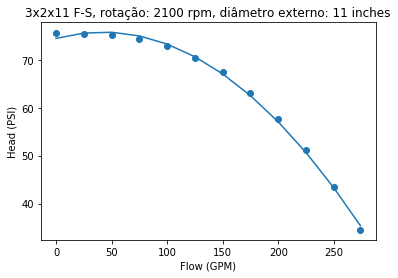

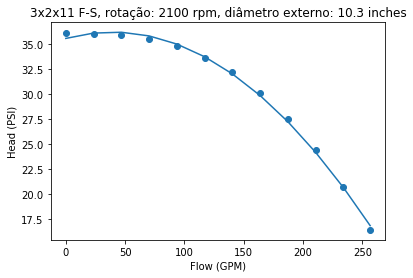

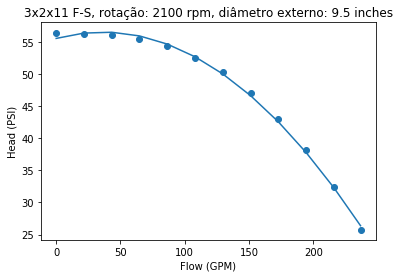

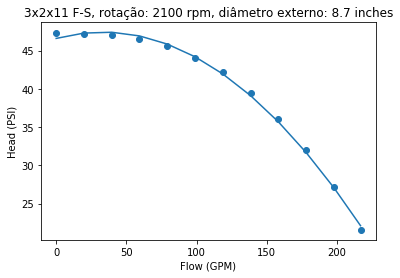

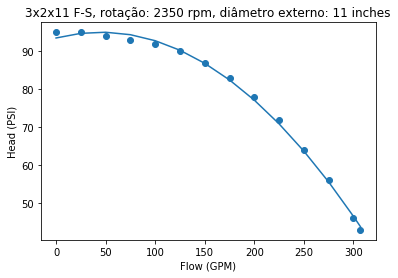

...

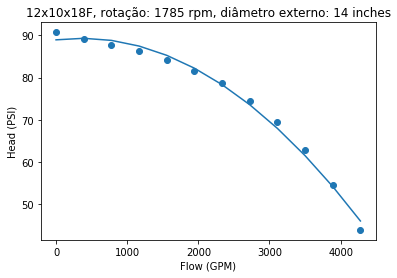

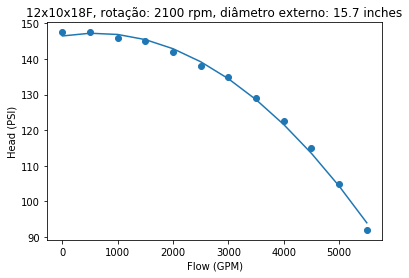

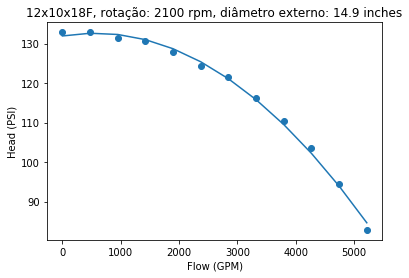

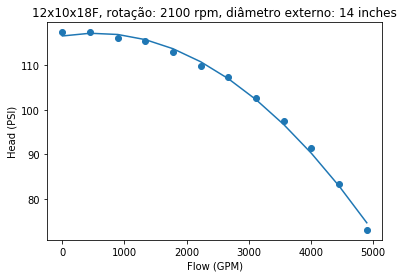

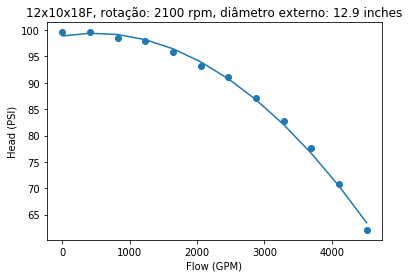

<Figure size 432x288 with 0 Axes>

In [26]:
data = []
for chave in list(dici.keys()):
    
    x = np.array(dici[chave][0])
    y = dici[chave][1]
    p = np.polyfit(x,y,2)
    p = np.flip(p)
    plt.scatter(x,y)
    plt.ylabel('Head (PSI)')
    plt.xlabel('Flow (GPM)')
    plt.title(dici[chave][2][-1]+', rotação: '+str(dici[chave][2][0])+' rpm, diâmetro externo: '+str(dici[chave][2][1])+' inches')
    yn = []
    i = 0
    for cte in p:
        yn.append(cte*x**i)
        i += 1
    plt.plot(x,sum(yn))
    plt.show()
    plt.clf()
    squaredDiffs = np.square(y - sum(yn))
    squaredDiffsFromMean = np.square(y - np.mean(y))
    rSquared = 1 - np.sum(squaredDiffs) / np.sum(squaredDiffsFromMean)
    data.append([dici[chave][2][0],dici[chave][2][1],dici[chave][2][2],dici[chave][2][3],dici[chave][2][4],dici[chave][2][5],dici[chave][2][6],
                dici[chave][2][7],dici[chave][2][8],dici[chave][2][9],p[0],p[1],p[2],dici[chave][0][-1],rSquared])
df_bombas = pd.DataFrame(data, columns=['Rotacao' , 'Dia_externo' , 'Dia_interno_olho' , 'area_entrada','b2','b3', 'Esfera' , 'GD2' , 'N_pas','Modelo',
                                       'a1','a2','a3','xn','r2'])

In [27]:
df_bombas.head()

,Rotacao,Dia_externo,Dia_interno_olho,area_entrada,b2,b3,Esfera,GD2,N_pas,Modelo,a1,a2,a3,xn,r2
0,2100,11.0,2.132,7.7,0.735,1.699,0.25,3.6,6,3x2x11 F-S,74.471923,0.063377,-0.000752,274.000000,0.998192
1,2100,10.3,2.132,7.7,0.735,1.699,0.25,3.6,6,3x2x11 F-S,35.549573,0.032309,-0.000410,256.563636,0.998192
2,2100,9.5,2.132,7.7,0.735,1.699,0.25,3.6,6,3x2x11 F-S,55.546207,0.054735,-0.000752,236.636364,0.998192
3,2100,8.7,2.132,7.7,0.735,1.699,0.25,3.6,6,3x2x11 F-S,46.584958,0.050125,-0.000752,216.709091,0.998192
4,2350,11.0,2.132,7.7,0.735,1.699,0.25,3.6,6,3x2x11 F-S,93.531040,0.067568,-0.000747,307.000000,0.997879


In [28]:
df_bombas.shape

(291, 15)

In [29]:
df_bombas.to_excel('df_bombas_completo_correto_verdadeiro.xlsx',index=False)

In [65]:
df_bombas = pd.read_excel('df_bombas_completo_correto_verdadeiro.xlsx')

In [66]:
df_bombas.shape

(291, 15)

## Para a1

In [67]:
X = df_bombas[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y = df_bombas['a1']

In [68]:
X_train1, X_test1, y_train1, y_test1 = train_test_split(X, y, test_size=0.2, random_state=42)

In [69]:
random_forest = RandomForestRegressor(random_state=42)

In [70]:
random_forest.fit(X_train1,y_train1)

RandomForestRegressor(random_state=42)

In [71]:
y_pred1 = random_forest.predict(X_test1)

In [72]:
mean_absolute_error(y_test1,y_pred1)

5.814500704378715

In [12]:
random_forest.score(X_test1,y_test1)

0.9561401570123644

In [13]:
random_forest.score(X_train1,y_train1)

0.9888453207618932

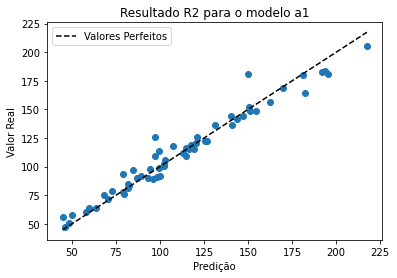

In [14]:
plt.title('Resultado R2 para o modelo a1')
plt.plot(y_test1,y_pred1,'o')
plt.plot([y_test1.min(),y_test1.max()],[y_test1.min(),y_test1.max()],'--k',label = 'Valores Perfeitos')
plt.xlabel('Predição')
plt.ylabel('Valor Real')
plt.legend()

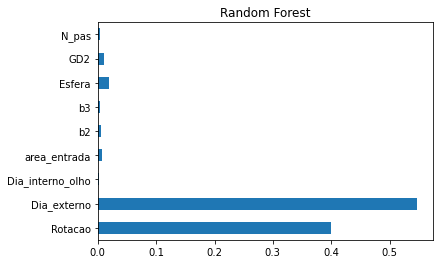

In [15]:
pd.Series(random_forest.feature_importances_, index=X_train1.columns).plot(kind='barh',title='Random Forest')
plt.show()

### Learning Curve

[ 23  46  69  92 116 139 162 185 208 232]
[0.88208624 0.9334387  0.95109584 0.96192974 0.96694633 0.97338237
 0.97646425 0.97898492 0.98092475 0.98194166]
[0.37624816 0.65395285 0.73292663 0.79877172 0.82946909 0.86167
 0.88277161 0.89536214 0.90584268 0.91272608]


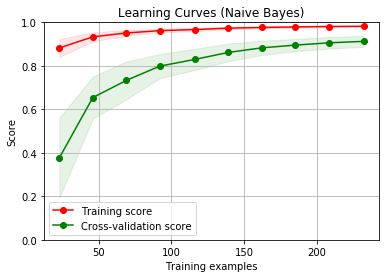

In [42]:
#fig, axes = plt.subplots(3, 2, figsize=(10, 15))

title = "Learning Curves (Naive Bayes)"
# Cross validation with 100 iterations to get smoother mean test and train
# score curves, each time with 20% data randomly selected as a validation set.
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)

estimator = RandomForestRegressor(random_state=42)
plot_learning_curve(
    estimator, title, X, y, ylim=(0, 1.01), cv=cv, n_jobs=4,train_sizes=np.linspace(0.1, 1.0, 10)
)

plt.show()

## Para a2

In [16]:
y = df_bombas['a2']

In [17]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(X, y, test_size=0.2, random_state=42)

In [18]:
random_forest = RandomForestRegressor(random_state=42)

In [19]:
random_forest.fit(X_train2,y_train2)

RandomForestRegressor(random_state=42)

In [20]:
y_pred2 = random_forest.predict(X_test2)

In [21]:
mean_absolute_error(y_test2,y_pred2)

0.0019960953798035873

In [22]:
random_forest.score(X_test2,y_test2)

0.9878652214559901

In [23]:
random_forest.score(X_train2,y_train2)

0.99416034859465

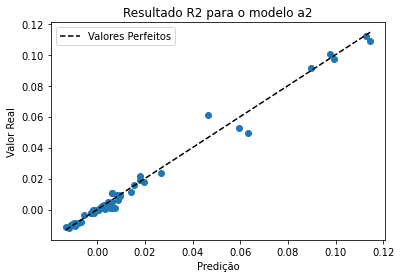

In [24]:
plt.title('Resultado R2 para o modelo a2')
plt.plot(y_test2,y_pred2,'o')
plt.plot([y_test2.min(),y_test2.max()],[y_test2.min(),y_test2.max()],'--k',label = 'Valores Perfeitos')
plt.xlabel('Predição')
plt.ylabel('Valor Real')
plt.legend()

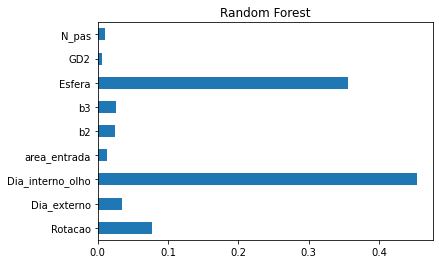

In [25]:
pd.Series(random_forest.feature_importances_, index=X_train2.columns).plot(kind='barh',title='Random Forest')
plt.show()

[ 23  46  69  92 116 139 162 185 208 232]
[0.92687562 0.97524541 0.98437656 0.98816599 0.9892392  0.99112697
 0.99241979 0.99301959 0.99372449 0.99395695]
[0.70275365 0.88023372 0.90840035 0.92747298 0.93866493 0.9450104
 0.95097788 0.95475703 0.95735059 0.96090819]


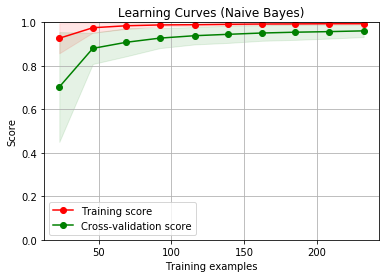

In [53]:
#fig, axes = plt.subplots(3, 2, figsize=(10, 15))

title = "Learning Curves (Naive Bayes)"
# Cross validation with 100 iterations to get smoother mean test and train
# score curves, each time with 20% data randomly selected as a validation set.
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)

estimator = RandomForestRegressor(random_state=42)
plot_learning_curve(
    estimator, title, X, y, ylim=(0, 1.01), cv=cv, n_jobs=4,train_sizes=np.linspace(0.1, 1.0, 10)
)

plt.show()

## Para a3

In [26]:
y = df_bombas['a3']
scaler = StandardScaler()
y = scaler.fit_transform(np.array(y).reshape(-1,1))

In [27]:
X_train3, X_test3, y_train3, y_test3 = train_test_split(X, y, test_size=0.2, random_state=42)

In [28]:
random_forest = RandomForestRegressor(random_state=42)

In [29]:
random_forest.fit(X_train3,y_train3)

C:\Users\evert\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  """Entry point for launching an IPython kernel.


RandomForestRegressor(random_state=42)

In [30]:
y_pred3 = random_forest.predict(X_test3)

In [31]:
mean_absolute_error(y_test3,y_pred3)

0.006730171790356706

In [32]:
random_forest.score(X_test3,y_test3)

0.999551019796754

In [33]:
random_forest.score(X_train3,y_train3)

0.9978926616857404

In [34]:
y_test31 = scaler.inverse_transform(y_test3)
y_pred31 = scaler.inverse_transform(y_pred3.reshape(-1,1))

In [35]:
mean_absolute_error(y_test31,y_pred31)

1.6243410206096649e-06

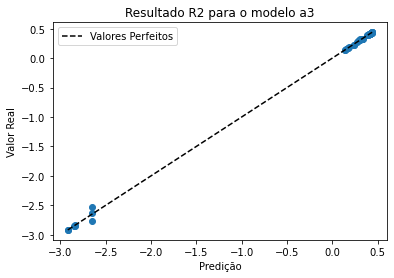

In [36]:
plt.title('Resultado R2 para o modelo a3')
plt.plot(y_test3,y_pred3,'o')
plt.plot([y_test3.min(),y_test3.max()],[y_test3.min(),y_test3.max()],'--k',label = 'Valores Perfeitos')
plt.xlabel('Predição')
plt.ylabel('Valor Real')
plt.legend()

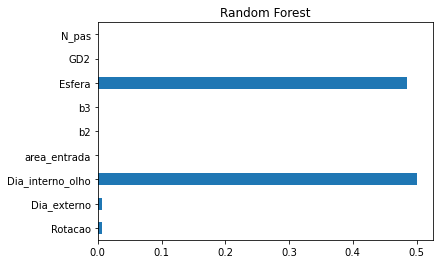

In [37]:
pd.Series(random_forest.feature_importances_, index=X_train3.columns).plot(kind='barh',title='Random Forest')
plt.show()

[ 23  46  69  92 116 139 162 185 208 232]
[0.9644581  0.99462307 0.99810239 0.99826653 0.99818582 0.99819614
 0.9981448  0.99811354 0.998123   0.99824245]
[0.85176166 0.98267238 0.98532913 0.98559493 0.98494826 0.98561519
 0.98532736 0.98540285 0.98557261 0.9858063 ]


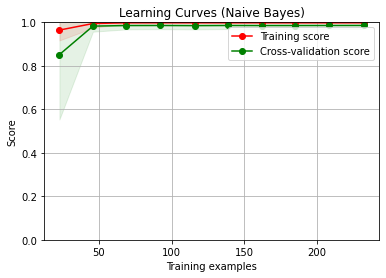

In [49]:
#fig, axes = plt.subplots(3, 2, figsize=(10, 15))

title = "Learning Curves (Naive Bayes)"
# Cross validation with 100 iterations to get smoother mean test and train
# score curves, each time with 20% data randomly selected as a validation set.
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)

estimator = RandomForestRegressor(random_state=42)
plot_learning_curve(
    estimator, title, X, y, ylim=(0, 1.01), cv=cv, n_jobs=4,train_sizes=np.linspace(0.1, 1.0, 10)
)

plt.show()

## Para xn

In [38]:
y = df_bombas['xn']

In [39]:
X_train4, X_test4, y_train4, y_test4 = train_test_split(X, y, test_size=0.2, random_state=42)

In [40]:
random_forest = RandomForestRegressor(random_state=42)

In [41]:
random_forest.fit(X_train4,y_train4)

RandomForestRegressor(random_state=42)

In [42]:
y_pred4 = random_forest.predict(X_test4)

In [43]:
mean_absolute_error(y_test4,y_pred4)

132.9718176593742

In [44]:
random_forest.score(X_test4,y_test4)

0.9798309917826419

In [45]:
random_forest.score(X_train4,y_train4)

0.9943735838499677

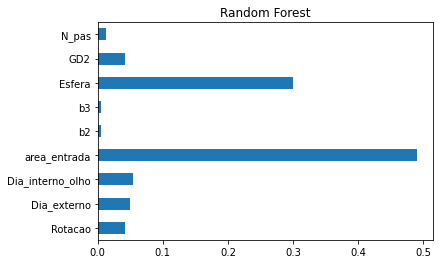

In [46]:
pd.Series(random_forest.feature_importances_, index=X_train4.columns).plot(kind='barh',title='Random Forest')
plt.show()

[ 23  46  69  92 116 139 162 185 208 232]
[0.95090786 0.97128025 0.97965795 0.98391812 0.98559507 0.98780473
 0.9895698  0.99047744 0.9917553  0.99216815]
[0.7367875  0.84982622 0.88267713 0.90411423 0.9208655  0.93342517
 0.93996562 0.94653757 0.95340367 0.9561232 ]


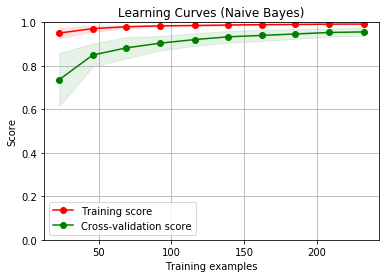

In [76]:
#fig, axes = plt.subplots(3, 2, figsize=(10, 15))

title = "Learning Curves (Naive Bayes)"
# Cross validation with 100 iterations to get smoother mean test and train
# score curves, each time with 20% data randomly selected as a validation set.
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)

estimator = RandomForestRegressor(random_state=42)
plot_learning_curve(
    estimator, title, X, y, ylim=(0, 1.01), cv=cv, n_jobs=4,train_sizes=np.linspace(0.1, 1.0, 10)
)

plt.show()

# Diferença nas Curvas

In [47]:
df_teste = X_test1
df_teste['a1'] = y_test1
df_teste['a2'] = y_test2
df_teste['a3'] = y_test31
df_teste['xn'] = y_test4
df_teste['a1p'] = y_pred1
df_teste['a2p'] = y_pred2
df_teste['a3p'] = y_pred31
df_teste['xnp'] = y_pred4

In [48]:
df_teste.head()

,Rotacao,Dia_externo,Dia_interno_olho,area_entrada,b2,b3,Esfera,GD2,N_pas,a1,a2,a3,xn,a1p,a2p,a3p,xnp
84,2100,13.7,2.133,10.2,0.915,2.116,0.50,3.0,6,119.021978,0.009496,-0.000035,1200.000000,115.527759,0.009052,-0.000036,1350.957153
259,1785,20.2,3.081,68.4,1.383,3.197,0.53,21.7,6,182.334881,-0.001863,-0.000005,4000.000000,164.245508,-0.000057,-0.000005,3754.482387
45,3300,9.1,2.133,5.9,0.654,1.513,0.44,2.4,6,120.423005,0.000215,-0.000074,910.000000,121.037163,-0.000283,-0.000073,923.606122
176,2350,12.2,2.133,27.0,0.855,1.977,0.72,3.6,5,113.152813,-0.002525,-0.000009,1844.186047,111.776819,-0.002446,-0.000009,1753.478682
143,2960,8.2,2.449,15.2,0.668,1.544,0.75,3.1,6,79.640163,-0.008169,-0.000009,1902.400000,76.121591,-0.008396,-0.000009,1879.469176


[array([119.02197802, 119.02197802, 119.02197802, ..., 119.02197802,
       119.02197802, 119.02197802]), array([0.00000000e+00, 9.49550450e-03, 1.89910090e-02, ...,
       1.13661189e+01, 1.13756144e+01, 1.13851099e+01]), array([-0.00000000e+00, -3.45154845e-05, -1.38061938e-04, ...,
       -4.94540969e+01, -4.95367614e+01, -4.96194951e+01])]
[119.02197802 119.03143901 119.04083097 ...  80.93400005  80.86083097
  80.78759286]


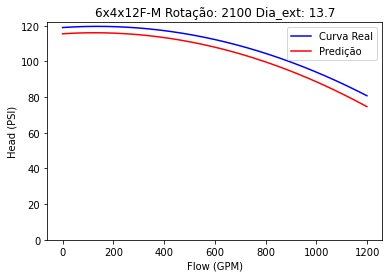

R² = -70426846.95910162
[array([182.33488132, 182.33488132, 182.33488132, ..., 182.33488132,
       182.33488132, 182.33488132]), array([-0.00000000e+00, -1.86326109e-03, -3.72652219e-03, ...,
       -7.44745459e+00, -7.44931785e+00, -7.45118111e+00]), array([-0.00000000e+00, -5.39938080e-06, -2.15975232e-05, ...,
       -8.62605563e+01, -8.63037244e+01, -8.63469032e+01])]
[182.33488132 182.33301266 182.3311332  ...  88.62687039  88.58183908
  88.53679697]


<Figure size 432x288 with 0 Axes>

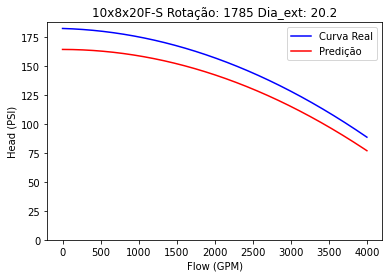

R² = -345798123.17020184
[array([120.42300497, 120.42300497, 120.42300497, 120.42300497,
       120.42300497, 120.42300497, 120.42300497, 120.42300497,
       120.42300497, 120.42300497, 120.42300497, 120.42300497,
       120.42300497, 120.42300497, 120.42300497, 120.42300497,
       120.42300497, 120.42300497, 120.42300497, 120.42300497,
       120.42300497, 120.42300497, 120.42300497, 120.42300497,
       120.42300497, 120.42300497, 120.42300497, 120.42300497,
       120.42300497, 120.42300497, 120.42300497, 120.42300497,
       120.42300497, 120.42300497, 120.42300497, 120.42300497,
       120.42300497, 120.42300497, 120.42300497, 120.42300497,
       120.42300497, 120.42300497, 120.42300497, 120.42300497,
       120.42300497, 120.42300497, 120.42300497, 120.42300497,
       120.42300497, 120.42300497, 120.42300497, 120.42300497,
       120.42300497, 120.42300497, 120.42300497, 120.42300497,
       120.42300497, 120.42300497, 120.42300497, 120.42300497,
       120.42300497, 120.4230

<Figure size 432x288 with 0 Axes>

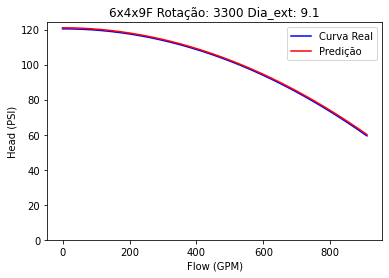

R² = -16392700.864465654
[array([113.15281333, 113.15281333, 113.15281333, ..., 113.15281333,
       113.15281333, 113.15281333]), array([-0.00000000e+00, -2.52514719e-03, -5.05029437e-03, ...,
       -4.65132112e+00, -4.65384626e+00, -4.65637141e+00]), array([-0.00000000e+00, -8.90580230e-06, -3.56232092e-05, ...,
       -3.02170666e+01, -3.02498845e+01, -3.02827202e+01])]
[113.15281333 113.15027927 113.14772741 ...  78.28442562  78.24908259
  78.21372175]


<Figure size 432x288 with 0 Axes>

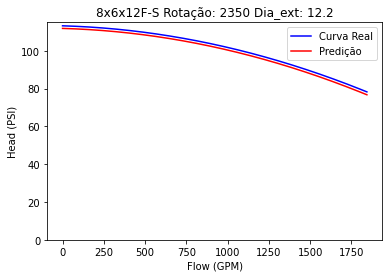

R² = -210182332.49729806
[array([79.64016306, 79.64016306, 79.64016306, ..., 79.64016306,
       79.64016306, 79.64016306]), array([-0.00000000e+00, -8.16924903e-03, -1.63384981e-02, ...,
       -1.55215732e+01, -1.55297424e+01, -1.55379117e+01]), array([-0.00000000e+00, -8.55007253e-06, -3.42002901e-05, ...,
       -3.08657618e+01, -3.08982607e+01, -3.09307766e+01])]
[79.64016306 79.63198526 79.62379036 ... 33.25282808 33.21216
 33.17147483]


<Figure size 432x288 with 0 Axes>

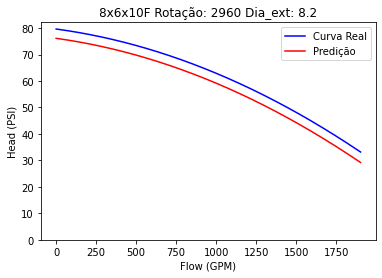

R² = -48026038.633804664
[array([117.59705882, 117.59705882, 117.59705882, ..., 117.59705882,
       117.59705882, 117.59705882]), array([-0.00000000e+00, -1.31770524e-02, -2.63541047e-02, ...,
       -2.30203105e+01, -2.30334875e+01, -2.30466646e+01]), array([-0.00000000e+00, -1.45029089e-05, -5.80116354e-05, ...,
       -4.42630084e+01, -4.43136960e+01, -4.43644127e+01])]
[117.59705882 117.58386727 117.57064671 ...  50.31374     50.24987528
  50.18598155]


<Figure size 432x288 with 0 Axes>

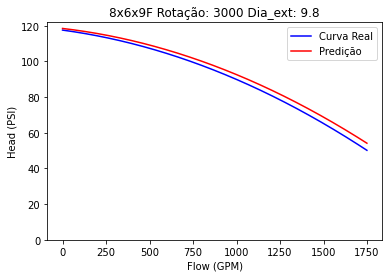

R² = -47175367.6107001
[array([195.5165766, 195.5165766, 195.5165766, ..., 195.5165766,
       195.5165766, 195.5165766]), array([0.00000000e+00, 9.42389153e-03, 1.88477831e-02, ...,
       2.67167325e+01, 2.67261564e+01, 2.67355803e+01]), array([-0.00000000e+00, -1.45042456e-05, -5.80169826e-05, ...,
       -1.16573886e+02, -1.16656139e+02, -1.16738422e+02])]
[195.5165766  195.52598599 195.53536636 ... 105.65942342 105.58659374
 105.51373505]


<Figure size 432x288 with 0 Axes>

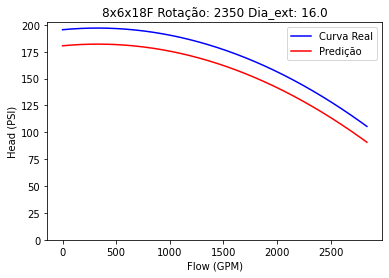

R² = -201213675.1040955
[array([96.11336453, 96.11336453, 96.11336453, ..., 96.11336453,
       96.11336453, 96.11336453]), array([-0.00000000e+00, -1.08513153e-02, -2.17026305e-02, ...,
       -1.17519744e+01, -1.17628257e+01, -1.17736770e+01]), array([-0.00000000e+00, -2.87936328e-05, -1.15174531e-04, ...,
       -3.37717352e+01, -3.38341310e+01, -3.38965844e+01])]
[96.11336453 96.10248442 96.09154672 ... 50.58965489 50.51640777
 50.44310306]


<Figure size 432x288 with 0 Axes>

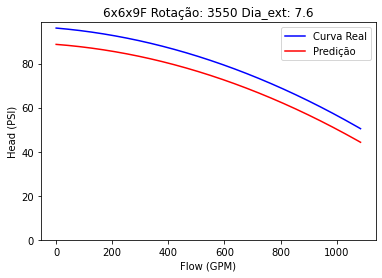

R² = -28273520.720751088
[array([44.64754433, 44.64754433, 44.64754433, 44.64754433, 44.64754433,
       44.64754433, 44.64754433, 44.64754433, 44.64754433, 44.64754433,
       44.64754433, 44.64754433, 44.64754433, 44.64754433, 44.64754433,
       44.64754433, 44.64754433, 44.64754433, 44.64754433, 44.64754433,
       44.64754433, 44.64754433, 44.64754433, 44.64754433, 44.64754433,
       44.64754433, 44.64754433, 44.64754433, 44.64754433, 44.64754433,
       44.64754433, 44.64754433, 44.64754433, 44.64754433, 44.64754433,
       44.64754433, 44.64754433, 44.64754433, 44.64754433, 44.64754433,
       44.64754433, 44.64754433, 44.64754433, 44.64754433, 44.64754433,
       44.64754433, 44.64754433, 44.64754433, 44.64754433, 44.64754433,
       44.64754433, 44.64754433, 44.64754433, 44.64754433, 44.64754433,
       44.64754433, 44.64754433, 44.64754433, 44.64754433, 44.64754433,
       44.64754433, 44.64754433, 44.64754433, 44.64754433, 44.64754433,
       44.64754433, 44.64754433, 44.64

<Figure size 432x288 with 0 Axes>

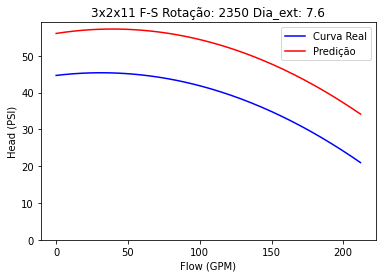

R² = -900309.9037269688
[array([78.94907879, 78.94907879, 78.94907879, ..., 78.94907879,
       78.94907879, 78.94907879]), array([0.00000000e+00, 1.41745691e-02, 2.83491382e-02, ...,
       1.56345497e+01, 1.56487243e+01, 1.56628989e+01]), array([-0.00000000e+00, -3.94257703e-05, -1.57703081e-04, ...,
       -4.79657470e+01, -4.80527597e+01, -4.81398512e+01])]
[78.94907879 78.96321393 78.97727022 ... 46.61788152 46.54504341
 46.47212645]


<Figure size 432x288 with 0 Axes>

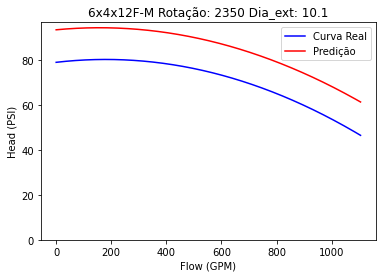

R² = -40423719.5563392
[array([94.02661877, 94.02661877, 94.02661877, ..., 94.02661877,
       94.02661877, 94.02661877]), array([-0.00000000e+00, -8.73568379e-03, -1.74713676e-02, ...,
       -1.80391870e+01, -1.80479227e+01, -1.80566584e+01]), array([-0.00000000e+00, -8.54716196e-06, -3.41886478e-05, ...,
       -3.64470217e+01, -3.64823300e+01, -3.65176554e+01])]
[94.02661877 94.01787454 94.00911321 ... 39.54041005 39.49636604
 39.45230493]


<Figure size 432x288 with 0 Axes>

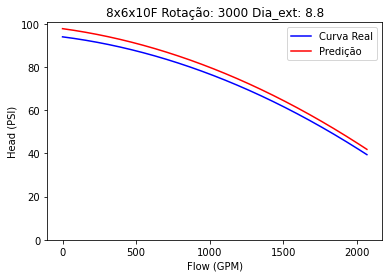

R² = -55788562.02779394
[array([143.5835785, 143.5835785, 143.5835785, ..., 143.5835785,
       143.5835785, 143.5835785]), array([0.00000000e+00, 6.35764349e-03, 1.27152870e-02, ...,
       2.91370801e+01, 2.91434378e+01, 2.91497954e+01]), array([-0.00000000e+00, -5.00176196e-06, -2.00070478e-05, ...,
       -1.05056453e+02, -1.05102304e+02, -1.05148165e+02])]
[143.5835785  143.58993115 143.59627378 ...  67.66420567  67.62471216
  67.58520865]


<Figure size 432x288 with 0 Axes>

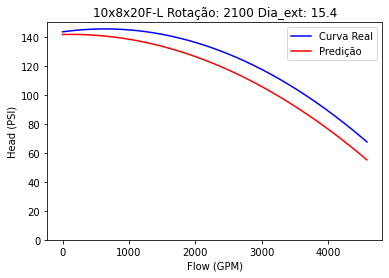

R² = -309657274.8631638
[array([99.7134736, 99.7134736, 99.7134736, 99.7134736, 99.7134736,
       99.7134736, 99.7134736, 99.7134736, 99.7134736, 99.7134736,
       99.7134736, 99.7134736, 99.7134736, 99.7134736, 99.7134736,
       99.7134736, 99.7134736, 99.7134736, 99.7134736, 99.7134736,
       99.7134736, 99.7134736, 99.7134736, 99.7134736, 99.7134736,
       99.7134736, 99.7134736, 99.7134736, 99.7134736, 99.7134736,
       99.7134736, 99.7134736, 99.7134736, 99.7134736, 99.7134736,
       99.7134736, 99.7134736, 99.7134736, 99.7134736, 99.7134736,
       99.7134736, 99.7134736, 99.7134736, 99.7134736, 99.7134736,
       99.7134736, 99.7134736, 99.7134736, 99.7134736, 99.7134736,
       99.7134736, 99.7134736, 99.7134736, 99.7134736, 99.7134736,
       99.7134736, 99.7134736, 99.7134736, 99.7134736, 99.7134736,
       99.7134736, 99.7134736, 99.7134736, 99.7134736, 99.7134736,
       99.7134736, 99.7134736, 99.7134736, 99.7134736, 99.7134736,
       99.7134736, 99.7134736, 99.713

<Figure size 432x288 with 0 Axes>

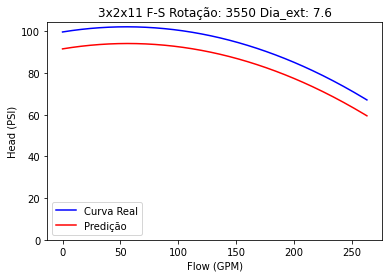

R² = -3640955.550019466
[array([97.40726343, 97.40726343, 97.40726343, ..., 97.40726343,
       97.40726343, 97.40726343]), array([0.00000000e+00, 3.12536169e-03, 6.25072338e-03, ...,
       1.34296792e+01, 1.34328045e+01, 1.34359299e+01]), array([-0.00000000e+00, -2.59681394e-06, -1.03872558e-05, ...,
       -4.79481153e+01, -4.79704350e+01, -4.79927598e+01])]
[97.40726343 97.41038619 97.41350376 ... 62.88882727 62.86963302
 62.85043357]


<Figure size 432x288 with 0 Axes>

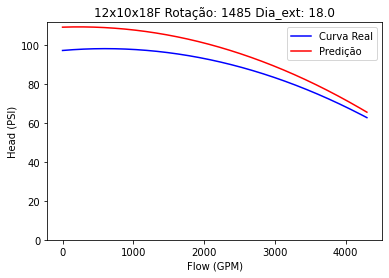

R² = -540105498.6372072
[array([149.69237896, 149.69237896, 149.69237896, ..., 149.69237896,
       149.69237896, 149.69237896]), array([0.00000000e+00, 8.24590509e-03, 1.64918102e-02, ...,
       2.04498446e+01, 2.04580905e+01, 2.04663364e+01]), array([-0.00000000e+00, -1.45042456e-05, -5.80169826e-05, ...,
       -8.92069124e+01, -8.92788679e+01, -8.93508525e+01])]
[149.69237896 149.70061036 149.70881275 ...  80.9353112   80.87160154
  80.80786287]


<Figure size 432x288 with 0 Axes>

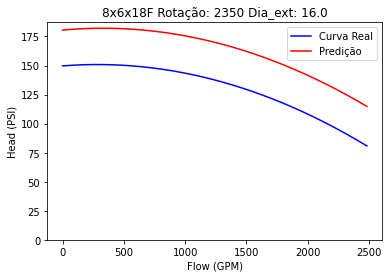

R² = -166263877.6875108
[array([193.56728434, 193.56728434, 193.56728434, ..., 193.56728434,
       193.56728434, 193.56728434]), array([0.00000000e+00, 2.68468731e-02, 5.36937462e-02, ...,
       4.28476095e+01, 4.28744563e+01, 4.29013032e+01]), array([-0.00000000e+00, -4.17532482e-05, -1.67012993e-04, ...,
       -1.06354542e+02, -1.06487860e+02, -1.06621262e+02])]
[193.56728434 193.59408946 193.62081107 ... 130.06035195 129.9538807
 129.84732594]


<Figure size 432x288 with 0 Axes>

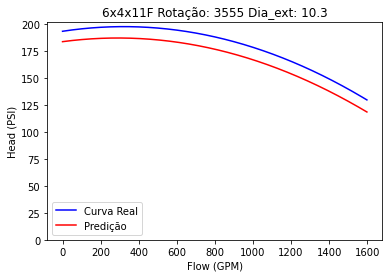

R² = -126977077.65783553
[array([102.60895098, 102.60895098, 102.60895098, 102.60895098,
       102.60895098, 102.60895098, 102.60895098, 102.60895098,
       102.60895098, 102.60895098, 102.60895098, 102.60895098,
       102.60895098, 102.60895098, 102.60895098, 102.60895098,
       102.60895098, 102.60895098, 102.60895098, 102.60895098,
       102.60895098, 102.60895098, 102.60895098, 102.60895098,
       102.60895098, 102.60895098, 102.60895098, 102.60895098,
       102.60895098, 102.60895098, 102.60895098, 102.60895098,
       102.60895098, 102.60895098, 102.60895098, 102.60895098,
       102.60895098, 102.60895098, 102.60895098, 102.60895098,
       102.60895098, 102.60895098, 102.60895098, 102.60895098,
       102.60895098, 102.60895098, 102.60895098, 102.60895098,
       102.60895098, 102.60895098, 102.60895098, 102.60895098,
       102.60895098, 102.60895098, 102.60895098, 102.60895098,
       102.60895098, 102.60895098, 102.60895098, 102.60895098,
       102.60895098, 102.6089

<Figure size 432x288 with 0 Axes>

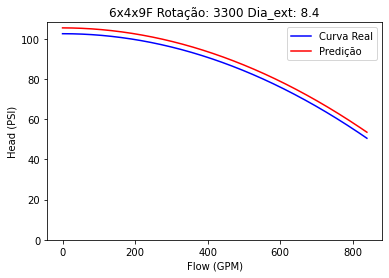

R² = -13895918.139223427
[array([82.00585141, 82.00585141, 82.00585141, 82.00585141, 82.00585141,
       82.00585141, 82.00585141, 82.00585141, 82.00585141, 82.00585141,
       82.00585141, 82.00585141, 82.00585141, 82.00585141, 82.00585141,
       82.00585141, 82.00585141, 82.00585141, 82.00585141, 82.00585141,
       82.00585141, 82.00585141, 82.00585141, 82.00585141, 82.00585141,
       82.00585141, 82.00585141, 82.00585141, 82.00585141, 82.00585141,
       82.00585141, 82.00585141, 82.00585141, 82.00585141, 82.00585141,
       82.00585141, 82.00585141, 82.00585141, 82.00585141, 82.00585141,
       82.00585141, 82.00585141, 82.00585141, 82.00585141, 82.00585141,
       82.00585141, 82.00585141, 82.00585141, 82.00585141, 82.00585141,
       82.00585141, 82.00585141, 82.00585141, 82.00585141, 82.00585141,
       82.00585141, 82.00585141, 82.00585141, 82.00585141, 82.00585141,
       82.00585141, 82.00585141, 82.00585141, 82.00585141, 82.00585141,
       82.00585141, 82.00585141, 82.00

<Figure size 432x288 with 0 Axes>

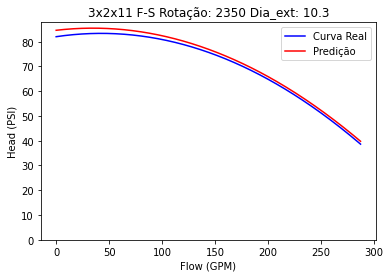

R² = -1415879.410993996
[array([48.18214807, 48.18214807, 48.18214807, ..., 48.18214807,
       48.18214807, 48.18214807]), array([0.00000000e+00, 1.51800529e-03, 3.03601058e-03, ...,
       3.55516839e+00, 3.55668639e+00, 3.55820440e+00]), array([-0.00000000e+00, -3.48072083e-06, -1.39228833e-05, ...,
       -1.90916285e+01, -1.91079356e+01, -1.91242498e+01])]
[48.18214807 48.1836626  48.18517016 ... 32.645688   32.63089883
 32.61610269]


<Figure size 432x288 with 0 Axes>

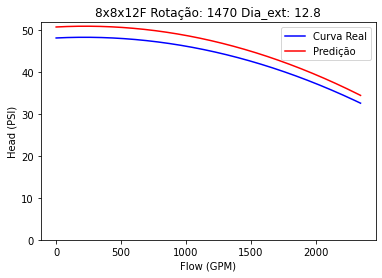

R² = -275600766.30240846
[array([99.20636948, 99.20636948, 99.20636948, ..., 99.20636948,
       99.20636948, 99.20636948]), array([-0.00000000e+00, -1.37438566e-03, -2.74877132e-03, ...,
       -4.05168892e+00, -4.05306331e+00, -4.05443769e+00]), array([-0.00000000e+00, -5.39938080e-06, -2.15975232e-05, ...,
       -4.69244204e+01, -4.69562605e+01, -4.69881115e+01])]
[99.20636948 99.20498969 99.20359911 ... 48.2302602  48.19704566
 48.16382033]


<Figure size 432x288 with 0 Axes>

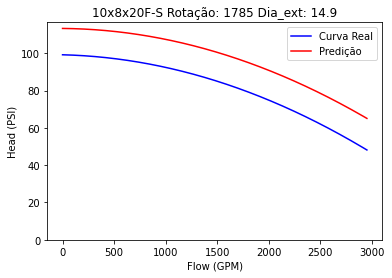

R² = -183706728.189296
[array([57.77227246, 57.77227246, 57.77227246, ..., 57.77227246,
       57.77227246, 57.77227246]), array([-0.00000000e+00, -8.13336012e-03, -1.62667202e-02, ...,
       -9.97149950e+00, -9.97963286e+00, -9.98776622e+00]), array([-0.00000000e+00, -1.55051672e-05, -6.20206689e-05, ...,
       -2.33054447e+01, -2.33434789e+01, -2.33815441e+01])]
[57.77227246 57.76412359 57.75594372 ... 24.49532824 24.4491607
 24.40296215]


<Figure size 432x288 with 0 Axes>

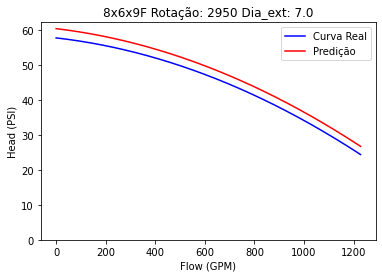

R² = -20658368.148522835
[array([99.2014205, 99.2014205, 99.2014205, ..., 99.2014205, 99.2014205,
       99.2014205]), array([0.00000000e+00, 2.09879835e-03, 4.19759670e-03, ...,
       7.65431759e+00, 7.65641639e+00, 7.65851519e+00]), array([-0.00000000e+00, -3.81678998e-06, -1.52671599e-05, ...,
       -5.07656311e+01, -5.07934746e+01, -5.08213257e+01])]
[99.2014205  99.20351548 99.20560283 ... 56.09010696 56.06436227
 56.03860995]


<Figure size 432x288 with 0 Axes>

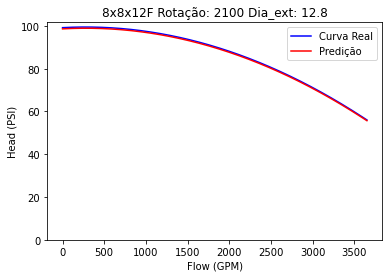

R² = -381188906.5571716
[array([150.80277781, 150.80277781, 150.80277781, ..., 150.80277781,
       150.80277781, 150.80277781]), array([0.00000000e+00, 6.38688064e-03, 1.27737613e-02, ...,
       3.36652478e+01, 3.36716347e+01, 3.36780216e+01]), array([-0.00000000e+00, -4.92807193e-06, -1.97122877e-05, ...,
       -1.36918796e+02, -1.36970752e+02, -1.37022719e+02])]
[150.80277781 150.80915977 150.81553186 ...  47.54922998  47.5036602
  47.45808057]


<Figure size 432x288 with 0 Axes>

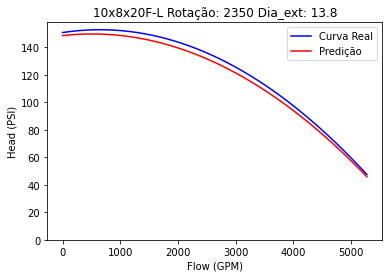

R² = -276293980.7438948
[array([93.12845004, 93.12845004, 93.12845004, ..., 93.12845004,
       93.12845004, 93.12845004]), array([-0.00000000e+00, -9.20236342e-03, -1.84047268e-02, ...,
       -9.60726741e+00, -9.61646977e+00, -9.62567213e+00]), array([-0.00000000e+00, -2.98616758e-05, -1.19446703e-04, ...,
       -3.25473155e+01, -3.26096966e+01, -3.26721373e+01])]
[93.12845004 93.11921781 93.10992586 ... 50.97386711 50.9022837
 50.83064058]


<Figure size 432x288 with 0 Axes>

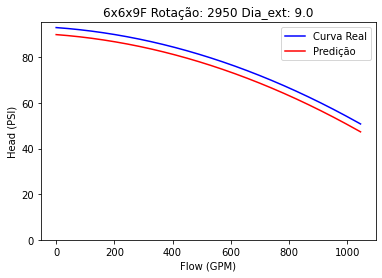

R² = -27393984.27555676
[array([126.62830011, 126.62830011, 126.62830011, ..., 126.62830011,
       126.62830011, 126.62830011]), array([0.00000000e+00, 1.79061276e-02, 3.58122551e-02, ...,
       2.28840310e+01, 2.29019372e+01, 2.29198433e+01]), array([-0.00000000e+00, -3.69727345e-05, -1.47890938e-04, ...,
       -6.03869757e+01, -6.04815150e+01, -6.05761282e+01])]
[126.62830011 126.64616926 126.66396447 ...  89.12535543  89.04872227
  88.97201517]


<Figure size 432x288 with 0 Axes>

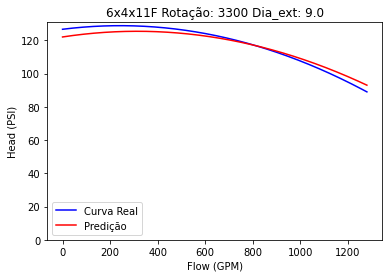

R² = -162070071.6743185
[array([116.46860381, 116.46860381, 116.46860381, ..., 116.46860381,
       116.46860381, 116.46860381]), array([0.00000000e+00, 2.34622066e-03, 4.69244132e-03, ...,
       1.15011737e+01, 1.15035199e+01, 1.15058661e+01]), array([-0.00000000e+00, -2.21328671e-06, -8.85314685e-06, ...,
       -5.31844033e+01, -5.32061045e+01, -5.32278102e+01])]
[116.46860381 116.47094782 116.4732874  ...  74.78537422  74.76601917
  74.74665968]


<Figure size 432x288 with 0 Axes>

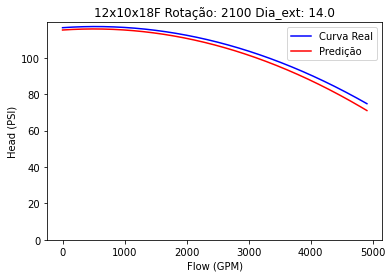

R² = -943634034.6979686
[array([191.82417361, 191.82417361, 191.82417361, ..., 191.82417361,
       191.82417361, 191.82417361]), array([0.00000000e+00, 7.34844507e-03, 1.46968901e-02, ...,
       3.89247136e+01, 3.89320620e+01, 3.89394104e+01]), array([-0.00000000e+00, -5.00176196e-06, -2.00070478e-05, ...,
       -1.40340482e+02, -1.40393476e+02, -1.40446480e+02])]
[191.82417361 191.83151705 191.83885049 ...  90.40840481  90.36275958
  90.31710436]


<Figure size 432x288 with 0 Axes>

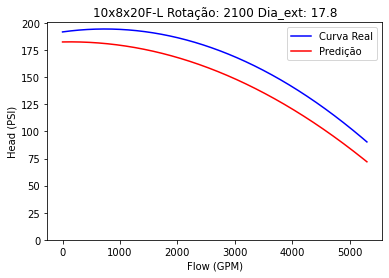

R² = -452618647.53317857
[array([50.11619439, 50.11619439, 50.11619439, 50.11619439, 50.11619439,
       50.11619439, 50.11619439, 50.11619439, 50.11619439, 50.11619439,
       50.11619439, 50.11619439, 50.11619439, 50.11619439, 50.11619439,
       50.11619439, 50.11619439, 50.11619439, 50.11619439, 50.11619439,
       50.11619439, 50.11619439, 50.11619439, 50.11619439, 50.11619439,
       50.11619439, 50.11619439, 50.11619439, 50.11619439, 50.11619439,
       50.11619439, 50.11619439, 50.11619439, 50.11619439, 50.11619439,
       50.11619439, 50.11619439, 50.11619439, 50.11619439, 50.11619439,
       50.11619439, 50.11619439, 50.11619439, 50.11619439, 50.11619439,
       50.11619439, 50.11619439, 50.11619439, 50.11619439, 50.11619439,
       50.11619439, 50.11619439, 50.11619439, 50.11619439, 50.11619439,
       50.11619439, 50.11619439, 50.11619439, 50.11619439, 50.11619439,
       50.11619439, 50.11619439, 50.11619439, 50.11619439, 50.11619439,
       50.11619439, 50.11619439, 50.11

<Figure size 432x288 with 0 Axes>

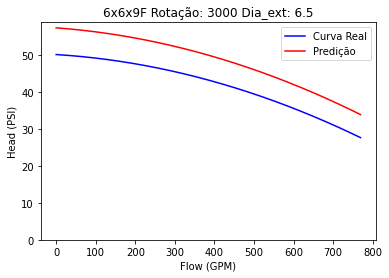

R² = -14288109.424502252
[array([140.44754925, 140.44754925, 140.44754925, 140.44754925,
       140.44754925, 140.44754925, 140.44754925, 140.44754925,
       140.44754925, 140.44754925, 140.44754925, 140.44754925,
       140.44754925, 140.44754925, 140.44754925, 140.44754925,
       140.44754925, 140.44754925, 140.44754925, 140.44754925,
       140.44754925, 140.44754925, 140.44754925, 140.44754925,
       140.44754925, 140.44754925, 140.44754925, 140.44754925,
       140.44754925, 140.44754925, 140.44754925, 140.44754925,
       140.44754925, 140.44754925, 140.44754925, 140.44754925,
       140.44754925, 140.44754925, 140.44754925, 140.44754925,
       140.44754925, 140.44754925, 140.44754925, 140.44754925,
       140.44754925, 140.44754925, 140.44754925, 140.44754925,
       140.44754925, 140.44754925, 140.44754925, 140.44754925,
       140.44754925, 140.44754925, 140.44754925, 140.44754925,
       140.44754925, 140.44754925, 140.44754925, 140.44754925,
       140.44754925, 140.4475

<Figure size 432x288 with 0 Axes>

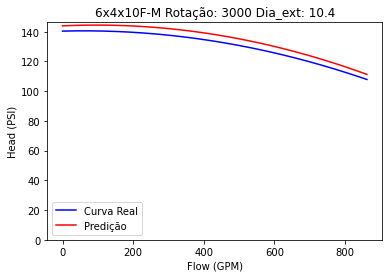

R² = -82851502.09467472
[array([87.10742669, 87.10742669, 87.10742669, ..., 87.10742669,
       87.10742669, 87.10742669]), array([0.00000000e+00, 2.35687976e-03, 4.71375952e-03, ...,
       5.93226636e+00, 5.93462324e+00, 5.93698012e+00]), array([-0.00000000e+00, -7.92607393e-06, -3.17042957e-05, ...,
       -5.02139690e+01, -5.02538767e+01, -5.02938004e+01])]
[87.10742669 87.10977565 87.11210875 ... 42.82572409 42.78817319
 42.75060644]


<Figure size 432x288 with 0 Axes>

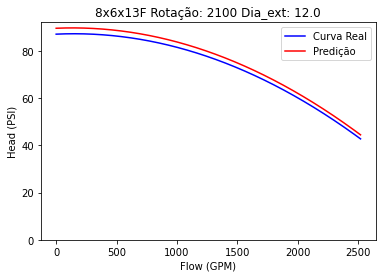

R² = -120577920.82627927
[array([70.6054588, 70.6054588, 70.6054588, 70.6054588, 70.6054588,
       70.6054588, 70.6054588, 70.6054588, 70.6054588, 70.6054588,
       70.6054588, 70.6054588, 70.6054588, 70.6054588, 70.6054588,
       70.6054588, 70.6054588, 70.6054588, 70.6054588, 70.6054588,
       70.6054588, 70.6054588, 70.6054588, 70.6054588, 70.6054588,
       70.6054588, 70.6054588, 70.6054588, 70.6054588, 70.6054588,
       70.6054588, 70.6054588, 70.6054588, 70.6054588, 70.6054588,
       70.6054588, 70.6054588, 70.6054588, 70.6054588, 70.6054588,
       70.6054588, 70.6054588, 70.6054588, 70.6054588, 70.6054588,
       70.6054588, 70.6054588, 70.6054588, 70.6054588, 70.6054588,
       70.6054588, 70.6054588, 70.6054588, 70.6054588, 70.6054588,
       70.6054588, 70.6054588, 70.6054588, 70.6054588, 70.6054588,
       70.6054588, 70.6054588, 70.6054588, 70.6054588, 70.6054588,
       70.6054588, 70.6054588, 70.6054588, 70.6054588, 70.6054588,
       70.6054588, 70.6054588, 70.60

<Figure size 432x288 with 0 Axes>

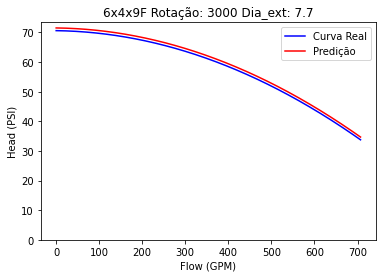

R² = -9189174.503986623
[array([121.03947081, 121.03947081, 121.03947081, 121.03947081,
       121.03947081, 121.03947081, 121.03947081, 121.03947081,
       121.03947081, 121.03947081, 121.03947081, 121.03947081,
       121.03947081, 121.03947081, 121.03947081, 121.03947081,
       121.03947081, 121.03947081, 121.03947081, 121.03947081,
       121.03947081, 121.03947081, 121.03947081, 121.03947081,
       121.03947081, 121.03947081, 121.03947081, 121.03947081,
       121.03947081, 121.03947081, 121.03947081, 121.03947081,
       121.03947081, 121.03947081, 121.03947081, 121.03947081,
       121.03947081, 121.03947081, 121.03947081, 121.03947081,
       121.03947081, 121.03947081, 121.03947081, 121.03947081,
       121.03947081, 121.03947081, 121.03947081, 121.03947081,
       121.03947081, 121.03947081, 121.03947081, 121.03947081,
       121.03947081, 121.03947081, 121.03947081, 121.03947081,
       121.03947081, 121.03947081, 121.03947081, 121.03947081,
       121.03947081, 121.03947

<Figure size 432x288 with 0 Axes>

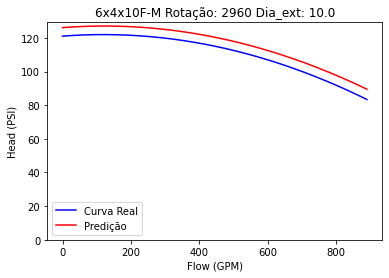

R² = -49887750.03771904
[array([147.04532967, 147.04532967, 147.04532967, ..., 147.04532967,
       147.04532967, 147.04532967]), array([0.00000000e+00, 2.61063936e-03, 5.22127872e-03, ...,
       1.43506846e+01, 1.43532952e+01, 1.43559058e+01]), array([-0.00000000e+00, -2.82367632e-06, -1.12947053e-05, ...,
       -8.53230529e+01, -8.53540992e+01, -8.53851512e+01])]
[147.04532967 147.04793749 147.05053965 ...  76.07296135  76.04452567
  76.01608434]


<Figure size 432x288 with 0 Axes>

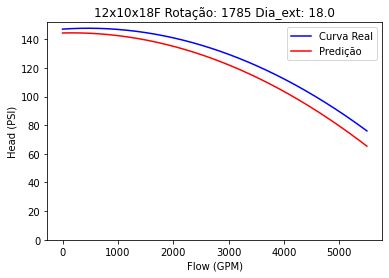

R² = -557006949.8828804
[array([114.63382414, 114.63382414, 114.63382414, ..., 114.63382414,
       114.63382414, 114.63382414]), array([-0.00000000e+00, -1.18507785e-02, -2.37015570e-02, ...,
       -1.40194710e+01, -1.40313217e+01, -1.40431725e+01]), array([-0.00000000e+00, -2.87936328e-05, -1.15174531e-04, ...,
       -4.02963724e+01, -4.03645270e+01, -4.04327391e+01])]
[114.63382414 114.62194457 114.61000741 ...  60.31798075  60.23797544
  60.15791255]


<Figure size 432x288 with 0 Axes>

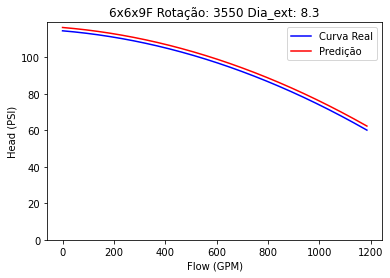

R² = -32454575.913869925
[array([154.27675043, 154.27675043, 154.27675043, 154.27675043,
       154.27675043, 154.27675043, 154.27675043, 154.27675043,
       154.27675043, 154.27675043, 154.27675043, 154.27675043,
       154.27675043, 154.27675043, 154.27675043, 154.27675043,
       154.27675043, 154.27675043, 154.27675043, 154.27675043,
       154.27675043, 154.27675043, 154.27675043, 154.27675043,
       154.27675043, 154.27675043, 154.27675043, 154.27675043,
       154.27675043, 154.27675043, 154.27675043, 154.27675043,
       154.27675043, 154.27675043, 154.27675043, 154.27675043,
       154.27675043, 154.27675043, 154.27675043, 154.27675043,
       154.27675043, 154.27675043, 154.27675043, 154.27675043,
       154.27675043, 154.27675043, 154.27675043, 154.27675043,
       154.27675043, 154.27675043, 154.27675043, 154.27675043,
       154.27675043, 154.27675043, 154.27675043, 154.27675043,
       154.27675043, 154.27675043, 154.27675043, 154.27675043,
       154.27675043, 154.2767

<Figure size 432x288 with 0 Axes>

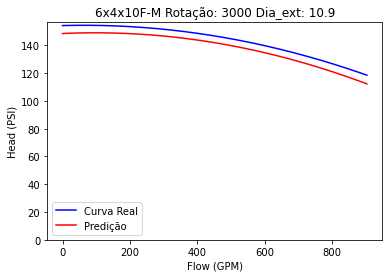

R² = -89214680.6186061
[array([63.57128755, 63.57128755, 63.57128755, ..., 63.57128755,
       63.57128755, 63.57128755]), array([0.00000000e+00, 7.19015798e-04, 1.43803160e-03, ...,
       1.23886422e+00, 1.23958324e+00, 1.24030225e+00]), array([-0.00000000e+00, -1.08116861e-05, -4.32467445e-05, ...,
       -3.20969661e+01, -3.21342340e+01, -3.21715235e+01])]
[63.57128755 63.57199576 63.57268234 ... 32.71318564 32.67663677
 32.64006628]


<Figure size 432x288 with 0 Axes>

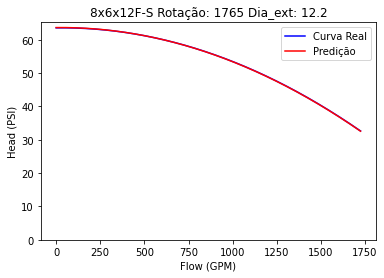

R² = -64462096.41713162
[array([84.85254947, 84.85254947, 84.85254947, ..., 84.85254947,
       84.85254947, 84.85254947]), array([0.00000000e+00, 2.91700424e-03, 5.83400849e-03, ...,
       1.17001040e+01, 1.17030210e+01, 1.17059380e+01]), array([-0.00000000e+00, -2.59681394e-06, -1.03872558e-05, ...,
       -4.17778569e+01, -4.17986911e+01, -4.18195306e+01])]
[84.85254947 84.85546388 84.8583731  ... 54.7747966  54.75687937
 54.73895694]


<Figure size 432x288 with 0 Axes>

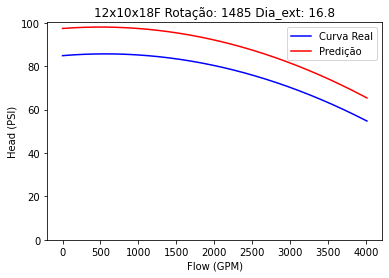

R² = -641621741.7187886
[array([79.18056688, 79.18056688, 79.18056688, 79.18056688, 79.18056688,
       79.18056688, 79.18056688, 79.18056688, 79.18056688, 79.18056688,
       79.18056688, 79.18056688, 79.18056688, 79.18056688, 79.18056688,
       79.18056688, 79.18056688, 79.18056688, 79.18056688, 79.18056688,
       79.18056688, 79.18056688, 79.18056688, 79.18056688, 79.18056688,
       79.18056688, 79.18056688, 79.18056688, 79.18056688, 79.18056688,
       79.18056688, 79.18056688, 79.18056688, 79.18056688, 79.18056688,
       79.18056688, 79.18056688, 79.18056688, 79.18056688, 79.18056688,
       79.18056688, 79.18056688, 79.18056688, 79.18056688, 79.18056688,
       79.18056688, 79.18056688, 79.18056688, 79.18056688, 79.18056688,
       79.18056688, 79.18056688, 79.18056688, 79.18056688, 79.18056688,
       79.18056688, 79.18056688, 79.18056688, 79.18056688, 79.18056688,
       79.18056688, 79.18056688, 79.18056688, 79.18056688, 79.18056688,
       79.18056688, 79.18056688, 79.180

<Figure size 432x288 with 0 Axes>

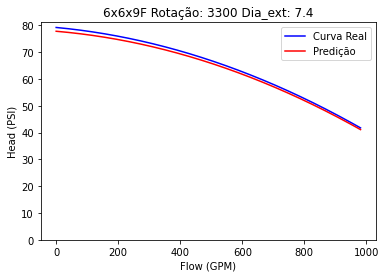

R² = -23035080.039808147
[array([98.39828571, 98.39828571, 98.39828571, ..., 98.39828571,
       98.39828571, 98.39828571]), array([-0.00000000e+00, -9.55352647e-03, -1.91070529e-02, ...,
       -1.99382098e+01, -1.99477633e+01, -1.99573168e+01]), array([-0.00000000e+00, -8.72327672e-06, -3.48931069e-05, ...,
       -3.79948337e+01, -3.80312534e+01, -3.80676905e+01])]
[98.39828571 98.38872346 98.37914377 ... 40.46524229 40.41926908
 40.37327843]


<Figure size 432x288 with 0 Axes>

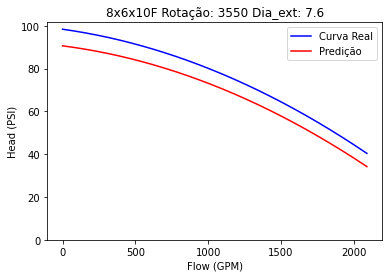

R² = -60367682.98392965
[array([150.21137402, 150.21137402, 150.21137402, ..., 150.21137402,
       150.21137402, 150.21137402]), array([0.00000000e+00, 1.94529059e-02, 3.89058119e-02, ...,
       1.94918118e+01, 1.95112647e+01, 1.95307176e+01]), array([-0.00000000e+00, -6.53594344e-05, -2.61437738e-04, ...,
       -6.56211336e+01, -6.57521793e+01, -6.58833557e+01])]
[150.21137402 150.23076156 150.25001839 ... 104.08205215 103.97045939
 103.85873592]


<Figure size 432x288 with 0 Axes>

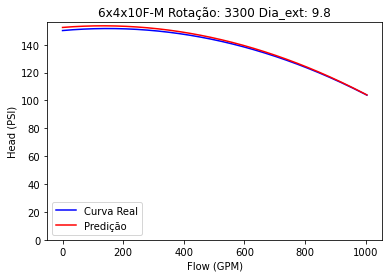

R² = -56291488.20321414
[array([107.28553763, 107.28553763, 107.28553763, ..., 107.28553763,
       107.28553763, 107.28553763]), array([-0.00000000e+00, -9.33129859e-03, -1.86625972e-02, ...,
       -2.05848447e+01, -2.05941760e+01, -2.06035073e+01]), array([-0.00000000e+00, -8.54716196e-06, -3.41886478e-05, ...,
       -4.15942167e+01, -4.16319353e+01, -4.16696710e+01])]
[107.28553763 107.27619779 107.26684085 ...  45.10647629  45.05942637
  45.01235935]


<Figure size 432x288 with 0 Axes>

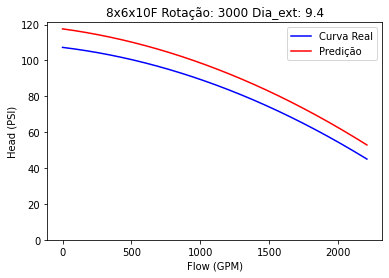

R² = -61927312.32809378
[array([217.40362199, 217.40362199, 217.40362199, ..., 217.40362199,
       217.40362199, 217.40362199]), array([0.00000000e+00, 1.78230547e-02, 3.56461095e-02, ...,
       2.29204484e+01, 2.29382714e+01, 2.29560945e+01]), array([-0.00000000e+00, -6.67977786e-05, -2.67191114e-04, ...,
       -1.10469899e+02, -1.10641770e+02, -1.10813774e+02])]
[217.40362199 217.42137825 217.43900091 ... 129.85417129 129.70012366
 129.54594244]


<Figure size 432x288 with 0 Axes>

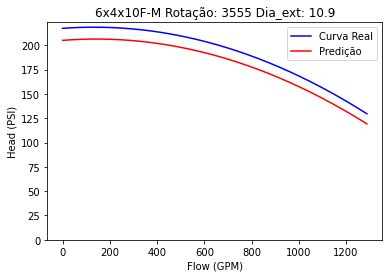

R² = -57950568.786746934
[array([125.67080107, 125.67080107, 125.67080107, ..., 125.67080107,
       125.67080107, 125.67080107]), array([0.00000000e+00, 3.20019399e-03, 6.40038797e-03, ...,
       1.25351598e+01, 1.25383600e+01, 1.25415602e+01]), array([-0.00000000e+00, -5.42127398e-06, -2.16850959e-05, ...,
       -8.31780050e+01, -8.32204806e+01, -8.32629672e+01])]
[125.67080107 125.67399584 125.67717977 ...  55.02795596  54.98868047
  54.94939414]


<Figure size 432x288 with 0 Axes>

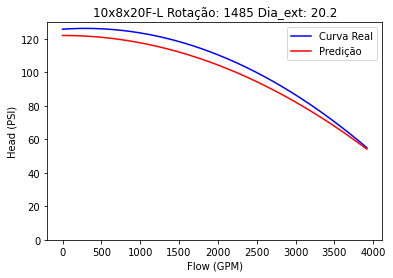

R² = -265932732.81208426
[array([114.54814286, 114.54814286, 114.54814286, ..., 114.54814286,
       114.54814286, 114.54814286]), array([-0.00000000e+00, -1.03077522e-02, -2.06155045e-02, ...,
       -2.32130581e+01, -2.32233658e+01, -2.32336736e+01]), array([-0.00000000e+00, -8.72327672e-06, -3.48931069e-05, ...,
       -4.42401328e+01, -4.42794312e+01, -4.43187470e+01])]
[114.54814286 114.53782638 114.52749246 ...  47.094952    47.04534589
  46.99572233]


<Figure size 432x288 with 0 Axes>

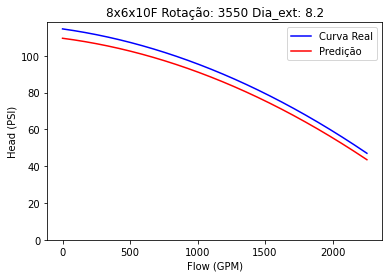

R² = -69725995.5020841
[array([97.28517423, 97.28517423, 97.28517423, ..., 97.28517423,
       97.28517423, 97.28517423]), array([-0.00000000e+00, -1.23748831e-03, -2.47497661e-03, ...,
       -2.79053613e+00, -2.79177362e+00, -2.79301111e+00]), array([-0.00000000e+00, -5.57139678e-06, -2.22855871e-05, ...,
       -2.83306919e+01, -2.83558245e+01, -2.83809682e+01])]
[97.28517423 97.28393117 97.28267697 ... 66.16394617 66.13757611
 66.1111949 ]


<Figure size 432x288 with 0 Axes>

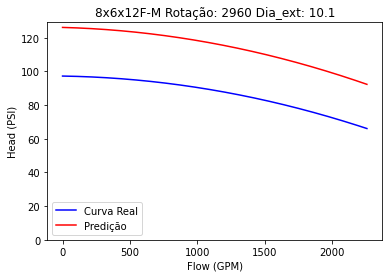

R² = -250021385.96322915
[array([162.4314531, 162.4314531, 162.4314531, 162.4314531, 162.4314531,
       162.4314531, 162.4314531, 162.4314531, 162.4314531, 162.4314531,
       162.4314531, 162.4314531, 162.4314531, 162.4314531, 162.4314531,
       162.4314531, 162.4314531, 162.4314531, 162.4314531, 162.4314531,
       162.4314531, 162.4314531, 162.4314531, 162.4314531, 162.4314531,
       162.4314531, 162.4314531, 162.4314531, 162.4314531, 162.4314531,
       162.4314531, 162.4314531, 162.4314531, 162.4314531, 162.4314531,
       162.4314531, 162.4314531, 162.4314531, 162.4314531, 162.4314531,
       162.4314531, 162.4314531, 162.4314531, 162.4314531, 162.4314531,
       162.4314531, 162.4314531, 162.4314531, 162.4314531, 162.4314531,
       162.4314531, 162.4314531, 162.4314531, 162.4314531, 162.4314531,
       162.4314531, 162.4314531, 162.4314531, 162.4314531, 162.4314531,
       162.4314531, 162.4314531, 162.4314531, 162.4314531, 162.4314531,
       162.4314531, 162.4314531, 162.4

<Figure size 432x288 with 0 Axes>

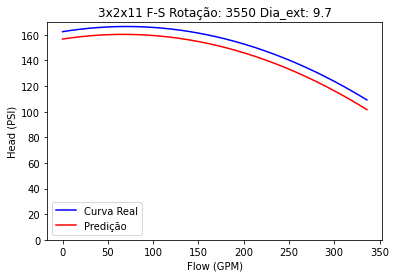

R² = -5476046.388854922
[array([181.09983639, 181.09983639, 181.09983639, 181.09983639,
       181.09983639, 181.09983639, 181.09983639, 181.09983639,
       181.09983639, 181.09983639, 181.09983639, 181.09983639,
       181.09983639, 181.09983639, 181.09983639, 181.09983639,
       181.09983639, 181.09983639, 181.09983639, 181.09983639,
       181.09983639, 181.09983639, 181.09983639, 181.09983639,
       181.09983639, 181.09983639, 181.09983639, 181.09983639,
       181.09983639, 181.09983639, 181.09983639, 181.09983639,
       181.09983639, 181.09983639, 181.09983639, 181.09983639,
       181.09983639, 181.09983639, 181.09983639, 181.09983639,
       181.09983639, 181.09983639, 181.09983639, 181.09983639,
       181.09983639, 181.09983639, 181.09983639, 181.09983639,
       181.09983639, 181.09983639, 181.09983639, 181.09983639,
       181.09983639, 181.09983639, 181.09983639, 181.09983639,
       181.09983639, 181.09983639, 181.09983639, 181.09983639,
       181.09983639, 181.09983

<Figure size 432x288 with 0 Axes>

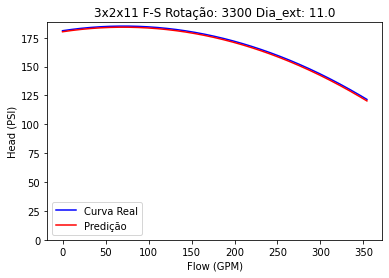

R² = -6247590.672060092
[array([140.82383145, 140.82383145, 140.82383145, 140.82383145,
       140.82383145, 140.82383145, 140.82383145, 140.82383145,
       140.82383145, 140.82383145, 140.82383145, 140.82383145,
       140.82383145, 140.82383145, 140.82383145, 140.82383145,
       140.82383145, 140.82383145, 140.82383145, 140.82383145,
       140.82383145, 140.82383145, 140.82383145, 140.82383145,
       140.82383145, 140.82383145, 140.82383145, 140.82383145,
       140.82383145, 140.82383145, 140.82383145, 140.82383145,
       140.82383145, 140.82383145, 140.82383145, 140.82383145,
       140.82383145, 140.82383145, 140.82383145, 140.82383145,
       140.82383145, 140.82383145, 140.82383145, 140.82383145,
       140.82383145, 140.82383145, 140.82383145, 140.82383145,
       140.82383145, 140.82383145, 140.82383145, 140.82383145,
       140.82383145, 140.82383145, 140.82383145, 140.82383145,
       140.82383145, 140.82383145, 140.82383145, 140.82383145,
       140.82383145, 140.82383

<Figure size 432x288 with 0 Axes>

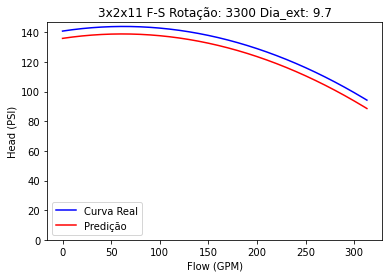

R² = -4821860.160188132
[array([102.31752727, 102.31752727, 102.31752727, ..., 102.31752727,
       102.31752727, 102.31752727]), array([0.00000000e+00, 5.36684191e-03, 1.07336838e-02, ...,
       2.07589445e+01, 2.07643113e+01, 2.07696782e+01]), array([-0.00000000e+00, -5.00176196e-06, -2.00070478e-05, ...,
       -7.48334814e+01, -7.48721800e+01, -7.49108887e+01])]
[102.31752727 102.32288911 102.32824095 ...  48.24299038  48.20965859
  48.1763168 ]


<Figure size 432x288 with 0 Axes>

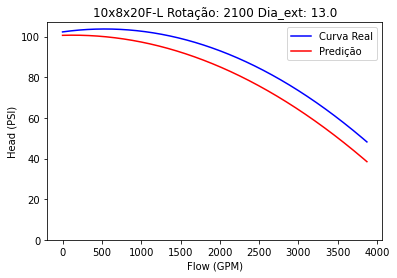

R² = -216706061.7311493
[array([81.53661465, 81.53661465, 81.53661465, 81.53661465, 81.53661465,
       81.53661465, 81.53661465, 81.53661465, 81.53661465, 81.53661465,
       81.53661465, 81.53661465, 81.53661465, 81.53661465, 81.53661465,
       81.53661465, 81.53661465, 81.53661465, 81.53661465, 81.53661465,
       81.53661465, 81.53661465, 81.53661465, 81.53661465, 81.53661465,
       81.53661465, 81.53661465, 81.53661465, 81.53661465, 81.53661465,
       81.53661465, 81.53661465, 81.53661465, 81.53661465, 81.53661465,
       81.53661465, 81.53661465, 81.53661465, 81.53661465, 81.53661465,
       81.53661465, 81.53661465, 81.53661465, 81.53661465, 81.53661465,
       81.53661465, 81.53661465, 81.53661465, 81.53661465, 81.53661465,
       81.53661465, 81.53661465, 81.53661465, 81.53661465, 81.53661465,
       81.53661465, 81.53661465, 81.53661465, 81.53661465, 81.53661465,
       81.53661465, 81.53661465, 81.53661465, 81.53661465, 81.53661465,
       81.53661465, 81.53661465, 81.536

<Figure size 432x288 with 0 Axes>

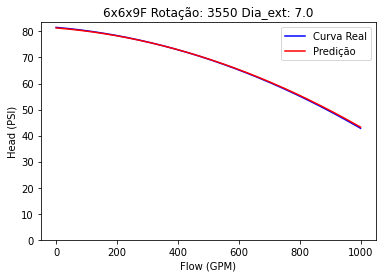

R² = -23504971.044124007
[array([89.12709235, 89.12709235, 89.12709235, ..., 89.12709235,
       89.12709235, 89.12709235]), array([0.00000000e+00, 3.54104623e-03, 7.08209245e-03, ...,
       1.16004674e+01, 1.16040085e+01, 1.16075495e+01]), array([-0.00000000e+00, -4.17208717e-06, -1.66883487e-05, ...,
       -4.47755738e+01, -4.48029135e+01, -4.48302616e+01])]
[89.12709235 89.13062923 89.13415775 ... 55.95198595 55.92818731
 55.90438032]


<Figure size 432x288 with 0 Axes>

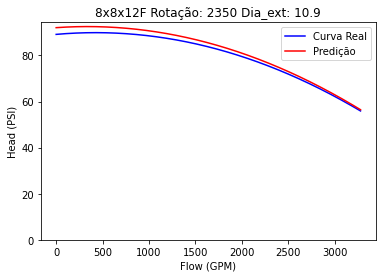

R² = -381105144.21495867
[array([59.40917293, 59.40917293, 59.40917293, 59.40917293, 59.40917293,
       59.40917293, 59.40917293, 59.40917293, 59.40917293, 59.40917293,
       59.40917293, 59.40917293, 59.40917293, 59.40917293, 59.40917293,
       59.40917293, 59.40917293, 59.40917293, 59.40917293, 59.40917293,
       59.40917293, 59.40917293, 59.40917293, 59.40917293, 59.40917293,
       59.40917293, 59.40917293, 59.40917293, 59.40917293, 59.40917293,
       59.40917293, 59.40917293, 59.40917293, 59.40917293, 59.40917293,
       59.40917293, 59.40917293, 59.40917293, 59.40917293, 59.40917293,
       59.40917293, 59.40917293, 59.40917293, 59.40917293, 59.40917293,
       59.40917293, 59.40917293, 59.40917293, 59.40917293, 59.40917293,
       59.40917293, 59.40917293, 59.40917293, 59.40917293, 59.40917293,
       59.40917293, 59.40917293, 59.40917293, 59.40917293, 59.40917293,
       59.40917293, 59.40917293, 59.40917293, 59.40917293, 59.40917293,
       59.40917293, 59.40917293, 59.40

[59.40917293 59.41782697 59.42641229 59.43492889 59.44337677 59.45175593
 59.46006638 59.4683081  59.47648111 59.4845854  59.49262096 59.50058781
 59.50848594 59.51631536 59.52407605 59.53176802 59.53939128 59.54694581
 59.55443163 59.56184873 59.56919711 59.57647677 59.58368771 59.59082994
 59.59790344 59.60490823 59.61184429 59.61871164 59.62551027 59.63224018
 59.63890137 59.64549384 59.6520176  59.65847263 59.66485895 59.67117654
 59.67742542 59.68360558 59.68971702 59.69575974 59.70173375 59.70763903
 59.71347559 59.71924344 59.72494257 59.73057298 59.73613467 59.74162764
 59.74705189 59.75240742 59.75769424 59.76291233 59.76806171 59.77314236
 59.7781543  59.78309752 59.78797202 59.79277781 59.79751487 59.80218321
 59.80678284 59.81131375 59.81577593 59.8201694  59.82449415 59.82875018
 59.8329375  59.83705609 59.84110596 59.84508712 59.84899956 59.85284328
 59.85661828 59.86032456 59.86396212 59.86753096 59.87103108 59.87446249
 59.87782517 59.88111914 59.88434439 59.88750092 59

<Figure size 432x288 with 0 Axes>

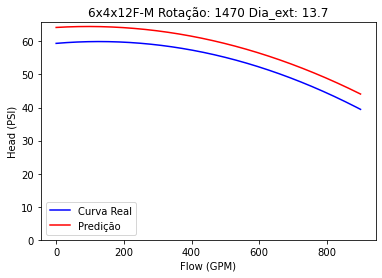

R² = -40607026.298387736
[array([131.16229871, 131.16229871, 131.16229871, 131.16229871,
       131.16229871, 131.16229871, 131.16229871, 131.16229871,
       131.16229871, 131.16229871, 131.16229871, 131.16229871,
       131.16229871, 131.16229871, 131.16229871, 131.16229871,
       131.16229871, 131.16229871, 131.16229871, 131.16229871,
       131.16229871, 131.16229871, 131.16229871, 131.16229871,
       131.16229871, 131.16229871, 131.16229871, 131.16229871,
       131.16229871, 131.16229871, 131.16229871, 131.16229871,
       131.16229871, 131.16229871, 131.16229871, 131.16229871,
       131.16229871, 131.16229871, 131.16229871, 131.16229871,
       131.16229871, 131.16229871, 131.16229871, 131.16229871,
       131.16229871, 131.16229871, 131.16229871, 131.16229871,
       131.16229871, 131.16229871, 131.16229871, 131.16229871,
       131.16229871, 131.16229871, 131.16229871, 131.16229871,
       131.16229871, 131.16229871, 131.16229871, 131.16229871,
       131.16229871, 131.1622

       -7.16858473e+01, -7.21645494e+01])]
[131.16229871 131.25918897 131.35448622 131.44819044 131.54030165
 131.63081983 131.719745   131.80707715 131.89281628 131.97696239
 132.05951548 132.14047556 132.21984261 132.29761665 132.37379767
 132.44838567 132.52138065 132.59278261 132.66259155 132.73080747
 132.79743038 132.86246026 132.92589713 132.98774098 133.04799181
 133.10664962 133.16371441 133.21918618 133.27306493 133.32535067
 133.37604339 133.42514308 133.47264976 133.51856342 133.56288406
 133.60561168 133.64674629 133.68628787 133.72423644 133.76059198
 133.79535451 133.82852402 133.86010051 133.89008398 133.91847443
 133.94527187 133.97047628 133.99408768 134.01610606 134.03653141
 134.05536375 134.07260307 134.08824938 134.10230266 134.11476292
 134.12563017 134.1349044  134.1425856  134.14867379 134.15316896
 134.15607111 134.15738025 134.15709636 134.15521946 134.15174953
 134.14668659 134.14003063 134.13178165 134.12193965 134.11050463
 134.09747659 134.08285554 134.06

<Figure size 432x288 with 0 Axes>

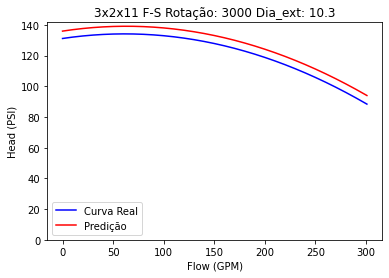

R² = -4840819.110407607
[array([82.45518908, 82.45518908, 82.45518908, ..., 82.45518908,
       82.45518908, 82.45518908]), array([-0.00000000e+00, -1.41119865e-03, -2.82239731e-03, ...,
       -2.31295460e+00, -2.31436579e+00, -2.31577699e+00]), array([-0.00000000e+00, -1.00100094e-05, -4.00400376e-05, ...,
       -2.68900984e+01, -2.69229213e+01, -2.69557641e+01])]
[82.45518908 82.45376787 82.45232664 ... 53.25213604 53.21790202
 53.18364798]


<Figure size 432x288 with 0 Axes>

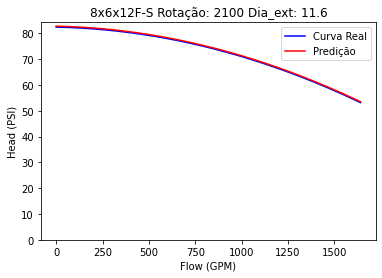

R² = -122125471.50517578
[array([68.12652999, 68.12652999, 68.12652999, ..., 68.12652999,
       68.12652999, 68.12652999]), array([0.00000000e+00, 4.65872273e-03, 9.31744546e-03, ...,
       7.30021852e+00, 7.30487724e+00, 7.30953596e+00]), array([-0.00000000e+00, -1.35603715e-05, -5.42414861e-05, ...,
       -3.32973431e+01, -3.33398549e+01, -3.33823937e+01])]
[68.12652999 68.13117515 68.13579319 ... 42.12940541 42.09155237
 42.05367221]


<Figure size 432x288 with 0 Axes>

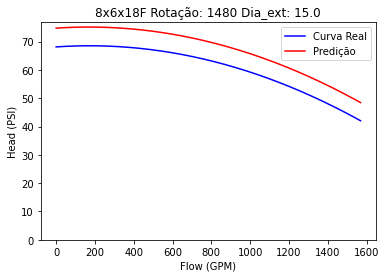

R² = -91736264.64014052
[array([102.29671164, 102.29671164, 102.29671164, ..., 102.29671164,
       102.29671164, 102.29671164]), array([-0.00000000e+00, -2.40095962e-03, -4.80191924e-03, ...,
       -4.20408029e+00, -4.20648125e+00, -4.20888221e+00]), array([-0.00000000e+00, -8.90580230e-06, -3.56232092e-05, ...,
       -2.73051988e+01, -2.73363958e+01, -2.73676106e+01])]
[102.29671164 102.29430178 102.2918741  ...  70.7874326   70.75383461
  70.72021881]


<Figure size 432x288 with 0 Axes>

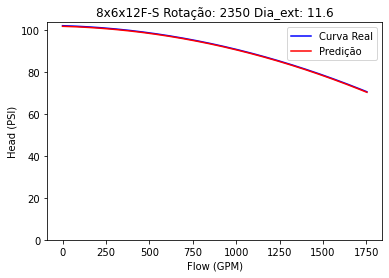

R² = -192142668.40135312
[array([169.64677456, 169.64677456, 169.64677456, ..., 169.64677456,
       169.64677456, 169.64677456]), array([-0.00000000e+00, -5.72528778e-03, -1.14505756e-02, ...,
       -1.44391758e+01, -1.44449011e+01, -1.44506264e+01]), array([-0.00000000e+00, -5.55494913e-06, -2.22197965e-05, ...,
       -3.53321651e+01, -3.53601898e+01, -3.53882256e+01])]
[169.64677456 169.64104372 169.63530176 ... 119.8754337  119.84168369
 119.80792258]


<Figure size 432x288 with 0 Axes>

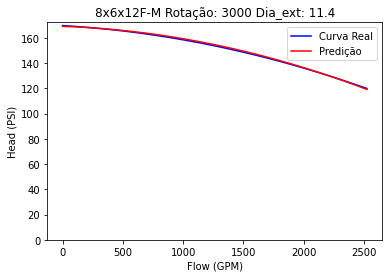

R² = -436057540.4469696
[array([46.19638848, 46.19638848, 46.19638848, ..., 46.19638848,
       46.19638848, 46.19638848]), array([0.00000000e+00, 6.12931500e-04, 1.22586300e-03, ...,
       9.00396374e-01, 9.01009305e-01, 9.01622237e-01]), array([-0.00000000e+00, -1.08116861e-05, -4.32467445e-05, ...,
       -2.33311970e+01, -2.33629725e+01, -2.33947697e+01])]
[46.19638848 46.1969906  46.1975711  ... 23.76558786 23.73442524
 23.70324101]


<Figure size 432x288 with 0 Axes>

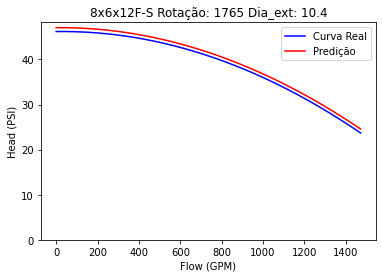

R² = -47301895.614373684
[array([72.7300458, 72.7300458, 72.7300458, 72.7300458, 72.7300458,
       72.7300458, 72.7300458, 72.7300458, 72.7300458, 72.7300458,
       72.7300458, 72.7300458, 72.7300458, 72.7300458, 72.7300458,
       72.7300458, 72.7300458, 72.7300458, 72.7300458, 72.7300458,
       72.7300458, 72.7300458, 72.7300458, 72.7300458, 72.7300458,
       72.7300458, 72.7300458, 72.7300458, 72.7300458, 72.7300458,
       72.7300458, 72.7300458, 72.7300458, 72.7300458, 72.7300458,
       72.7300458, 72.7300458, 72.7300458, 72.7300458, 72.7300458,
       72.7300458, 72.7300458, 72.7300458, 72.7300458, 72.7300458,
       72.7300458, 72.7300458, 72.7300458, 72.7300458, 72.7300458,
       72.7300458, 72.7300458, 72.7300458, 72.7300458, 72.7300458,
       72.7300458, 72.7300458, 72.7300458, 72.7300458, 72.7300458,
       72.7300458, 72.7300458, 72.7300458, 72.7300458, 72.7300458,
       72.7300458, 72.7300458, 72.7300458, 72.7300458, 72.7300458,
       72.7300458, 72.7300458, 72.73

<Figure size 432x288 with 0 Axes>

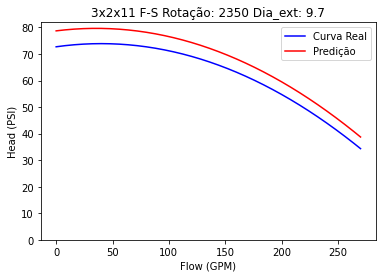

R² = -1227136.5952316625


<Figure size 432x288 with 0 Axes>

In [56]:
dici_erro = {}
for indice in df_teste.index:
    eixo_x = []
    valor_real = []
    valor_previsto = []
    erro_abs = []
    erro_rel = []
    #print(X_test.loc[[i]]['Dia_externo'])
    ig, ax = plt.subplots()
    plt.ylabel('Head (PSI)')
    plt.xlabel('Flow (GPM)')
    #plt.title(dici[chave][2][-1]+', rotação: '+str(dici[chave][2][0])+' rpm, diâmetro externo: '+str(dici[chave][2][1])+' inches')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1'][indice],df_teste.loc[[indice]]['a2'][indice],df_teste.loc[[indice]]['a3'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='blue',label='Curva Real')
    
    for valor in np.linspace(0,df_teste.loc[[indice]]['xn'][indice],5):
        valor = int(valor)
        eixo_x.append(valor)
        valor_real.append(df_teste.loc[[indice]]['a1'][indice] + df_teste.loc[[indice]]['a2'][indice]*valor + df_teste.loc[[indice]]['a3'][indice]*valor**2)
        valor_previsto.append(df_teste.loc[[indice]]['a1p'][indice] + df_teste.loc[[indice]]['a2p'][indice]*valor + df_teste.loc[[indice]]['a3p'][indice]*valor**2)
        erro_abs.append(valor_previsto[-1] - valor_real[-1])
        erro_rel.append(erro_abs[-1]/valor_real[-1])
    
    
    
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1p'][indice],df_teste.loc[[indice]]['a2p'][indice],df_teste.loc[[indice]]['a3p'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='red',label = 'Predição')
    plt.title(str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Modelo)+' Rotação: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Rotacao)+' Dia_ext: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Dia_externo))
    ax.set_ylim(bottom=0)
    plt.legend()
    plt.show()
    plt.clf()
    
    for valor in np.linspace(0,df_teste.loc[[indice]]['xn'][indice],5):
        valor = int(valor)
        eixo_x.append(valor)
        valor_real.append(df_teste.loc[[indice]]['a1'][indice] + df_teste.loc[[indice]]['a2'][indice]*valor + df_teste.loc[[indice]]['a3'][indice]*valor**2)
        valor_previsto.append(df_teste.loc[[indice]]['a1p'][indice] + df_teste.loc[[indice]]['a2p'][indice]*valor + df_teste.loc[[indice]]['a3p'][indice]*valor**2)
        erro_abs.append(valor_previsto[-1] - valor_real[-1])
        erro_rel.append(erro_abs[-1]/valor_real[-1])
    dici_erro[str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Modelo)+' Rotação: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Rotacao)+' Dia_ext: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Dia_externo)] = \
    [eixo_x,valor_real,valor_previsto,erro_abs,erro_rel]
    


In [80]:
df_erro = pd.DataFrame.from_dict(dici_erro).T

In [81]:
df_erro.to_excel('df_erro_verdadeiro.xlsx',index = True)

# Hyperparameter Tuning

## a1

In [9]:
X = df_bombas[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y = df_bombas['a1']

In [7]:
X_train1, X_test1, y_train1, y_test1 = train_test_split(X, y, test_size=0.2, random_state=42)

In [37]:
# Create the random grid
random_grid = {'n_estimators': [10,50,100,200,300,750],
               'max_features': ['auto','sqrt'],
               'min_samples_split': [2,3,4],
               'min_samples_leaf': [1,2,3],
              'max_depth' : [None,10,50,100],
              'criterion':['mse','mae']}

rf = RandomForestRegressor(random_state=42)

rf_random = GridSearchCV(estimator = rf, param_grid = random_grid, scoring = 'r2', cv=5,n_jobs = -1)

rf_random.fit(X_train1, y_train1)

GridSearchCV(cv=5, estimator=RandomForestRegressor(random_state=42), n_jobs=-1,
             param_grid={'criterion': ['mse', 'mae'],
                         'max_depth': [None, 10, 50, 100],
                         'max_features': ['auto', 'sqrt'],
                         'min_samples_leaf': [1, 2, 3],
                         'min_samples_split': [2, 3, 4],
                         'n_estimators': [10, 50, 100, 200, 300, 750]},
             scoring='r2')

In [26]:
# from hyperopt import hp, fmin, tpe, STATUS_OK, Trials
# import warnings
# warnings.filterwarnings("ignore")

# space = {'criterion': hp.choice('criterion', ['mse', 'mae']),
#         'max_depth': hp.quniform('max_depth', 10, 500, 10),
#         'max_features': hp.choice('max_features', ['auto', 'sqrt','log2', None]),
#         'min_samples_leaf': hp.uniform ('min_samples_leaf', 0, 0.5),
#         'min_samples_split' : hp.uniform ('min_samples_split', 0, 1),
#         'n_estimators' : hp.choice('n_estimators', [10, 50, 300, 750, 1200])
#     }

# def objective(space):
#     model = RandomForestRegressor(criterion = space['criterion'], 
#                                    max_depth = space['max_depth'],
#                                  max_features = space['max_features'],
#                                  min_samples_leaf = space['min_samples_leaf'],
#                                  min_samples_split = space['min_samples_split'],
#                                  n_estimators = space['n_estimators'], 
#                                  )
    
#     mae = cross_val_score(model, X_train1, y_train1, cv = 4,scoring='neg_mean_absolute_error',verbose=True,error_score='raise').mean()

#     # We aim to maximize accuracy, therefore we return it as a negative value
#     return {'loss': -mae, 'status': STATUS_OK }
    
# trials = Trials()
# best = fmin(fn= objective,
#             space= space,
#             algo= tpe.suggest,
#             max_evals = 200,
#             trials= trials)
# best

  0%|          | 0/200 [00:00<?, ?trial/s, best loss=?]

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



  0%|          | 1/200 [00:00<01:25,  2.33trial/s, best loss: 35.376790457100476]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.3s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



  1%|          | 2/200 [00:00<01:26,  2.30trial/s, best loss: 35.376790457100476]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.3s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



  2%|▏         | 3/200 [00:09<13:13,  4.03s/trial, best loss: 35.376790457100476]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    8.2s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



  2%|▎         | 5/200 [00:15<10:10,  3.13s/trial, best loss: 34.38052432113451] 

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    5.9s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



  4%|▎         | 7/200 [00:16<05:06,  1.59s/trial, best loss: 23.676858578712388]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.6s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



  4%|▍         | 9/200 [00:16<02:37,  1.21trial/s, best loss: 20.760679708132063]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



  6%|▌         | 11/200 [00:18<02:48,  1.12trial/s, best loss: 20.760679708132063]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    2.1s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



  6%|▌         | 12/200 [00:26<09:34,  3.06s/trial, best loss: 20.760679708132063]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    7.9s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



  6%|▋         | 13/200 [00:27<07:02,  2.26s/trial, best loss: 20.760679708132063]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.3s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



  7%|▋         | 14/200 [00:27<05:16,  1.70s/trial, best loss: 20.760679708132063]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.3s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



  8%|▊         | 15/200 [00:32<08:09,  2.65s/trial, best loss: 20.760679708132063]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    4.7s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



  8%|▊         | 17/200 [00:37<07:07,  2.34s/trial, best loss: 20.760679708132063]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    4.7s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



  9%|▉         | 18/200 [00:44<11:16,  3.72s/trial, best loss: 20.760679708132063]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    6.8s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 10%|▉         | 19/200 [00:49<12:23,  4.11s/trial, best loss: 20.760679708132063]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    4.9s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 10%|█         | 20/200 [00:57<15:44,  5.25s/trial, best loss: 20.760679708132063]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    7.8s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 10%|█         | 21/200 [00:57<11:27,  3.84s/trial, best loss: 20.760679708132063]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.4s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 12%|█▏        | 23/200 [01:01<07:42,  2.62s/trial, best loss: 20.760679708132063]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    3.2s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 12%|█▏        | 24/200 [01:01<05:50,  1.99s/trial, best loss: 20.760679708132063]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.4s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 13%|█▎        | 26/200 [01:04<04:42,  1.62s/trial, best loss: 20.760679708132063]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    2.8s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 14%|█▍        | 28/200 [01:05<02:39,  1.08trial/s, best loss: 20.760679708132063]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.3s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


 14%|█▍        | 29/200 [01:05<01:58,  1.44trial/s, best loss: 20.760679708132063]


[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 16%|█▌        | 31/200 [01:05<01:07,  2.49trial/s, best loss: 20.760679708132063]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 16%|█▌        | 32/200 [01:05<00:56,  2.98trial/s, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 17%|█▋        | 34/200 [01:16<06:43,  2.43s/trial, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   10.4s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 18%|█▊        | 36/200 [01:19<04:58,  1.82s/trial, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    2.7s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 18%|█▊        | 37/200 [01:19<03:33,  1.31s/trial, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 19%|█▉        | 38/200 [01:30<11:30,  4.26s/trial, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   11.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s finished



 20%|█▉        | 39/200 [01:30<08:08,  3.04s/trial, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 20%|██        | 41/200 [01:33<05:33,  2.10s/trial, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    2.6s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 22%|██▏       | 43/200 [01:42<07:35,  2.90s/trial, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    8.6s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 22%|██▎       | 45/200 [01:48<06:40,  2.58s/trial, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    5.2s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 24%|██▎       | 47/200 [01:50<04:25,  1.74s/trial, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    1.9s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 24%|██▍       | 48/200 [01:50<03:24,  1.35s/trial, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.3s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 24%|██▍       | 49/200 [01:55<06:02,  2.40s/trial, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    4.7s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 26%|██▌       | 51/200 [02:03<07:17,  2.94s/trial, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    8.1s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 26%|██▋       | 53/200 [02:09<06:16,  2.56s/trial, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    5.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 27%|██▋       | 54/200 [02:09<04:44,  1.95s/trial, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.4s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 28%|██▊       | 56/200 [02:12<03:33,  1.48s/trial, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    2.2s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 29%|██▉       | 58/200 [02:27<09:19,  3.94s/trial, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   14.9s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 30%|██▉       | 59/200 [02:33<10:28,  4.46s/trial, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    5.5s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 30%|███       | 61/200 [02:33<05:24,  2.34s/trial, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.4s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 32%|███▏      | 63/200 [02:37<04:13,  1.85s/trial, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    3.1s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 32%|███▏      | 64/200 [02:50<12:00,  5.30s/trial, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   13.2s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 32%|███▎      | 65/200 [02:50<08:42,  3.87s/trial, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.4s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 33%|███▎      | 66/200 [02:51<06:12,  2.78s/trial, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 34%|███▎      | 67/200 [02:51<04:29,  2.03s/trial, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 34%|███▍      | 68/200 [02:51<03:15,  1.48s/trial, best loss: 17.617826420471232]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 34%|███▍      | 69/200 [02:51<02:28,  1.13s/trial, best loss: 15.646249845293301]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.2s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 35%|███▌      | 70/200 [02:52<01:52,  1.16trial/s, best loss: 15.646249845293301]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 36%|███▌      | 71/200 [02:52<01:28,  1.46trial/s, best loss: 15.646249845293301]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s finished



 36%|███▌      | 72/200 [02:52<01:09,  1.84trial/s, best loss: 15.646249845293301]

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 36%|███▋      | 73/200 [02:52<00:58,  2.19trial/s, best loss: 15.001941123757678]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 37%|███▋      | 74/200 [02:53<00:50,  2.51trial/s, best loss: 15.001941123757678]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 38%|███▊      | 75/200 [02:53<00:45,  2.72trial/s, best loss: 15.001941123757678]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 38%|███▊      | 76/200 [03:05<07:46,  3.76s/trial, best loss: 13.45146576258418] 

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   11.5s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 38%|███▊      | 77/200 [03:11<09:28,  4.63s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    6.5s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 39%|███▉      | 78/200 [03:21<12:23,  6.09s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    9.4s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 40%|███▉      | 79/200 [03:28<12:58,  6.43s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    7.1s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 40%|████      | 80/200 [03:34<12:34,  6.28s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    5.8s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 40%|████      | 81/200 [03:44<14:45,  7.44s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   10.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 41%|████      | 82/200 [03:49<13:15,  6.74s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    5.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 42%|████▏     | 83/200 [03:55<12:38,  6.48s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    5.7s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 42%|████▏     | 84/200 [03:59<10:46,  5.57s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    3.3s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 42%|████▎     | 85/200 [04:06<11:44,  6.12s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    7.3s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 43%|████▎     | 86/200 [04:14<12:48,  6.74s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    8.1s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 44%|████▎     | 87/200 [04:15<09:06,  4.84s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.3s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 44%|████▍     | 88/200 [04:21<09:44,  5.22s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    6.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 44%|████▍     | 89/200 [04:23<07:53,  4.27s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    1.9s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 45%|████▌     | 90/200 [04:30<09:42,  5.29s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    7.5s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 46%|████▌     | 91/200 [04:35<09:20,  5.14s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    4.7s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 46%|████▌     | 92/200 [04:36<06:42,  3.73s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.3s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 46%|████▋     | 93/200 [04:39<06:28,  3.63s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    3.3s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 48%|████▊     | 95/200 [04:47<06:03,  3.46s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    7.7s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 48%|████▊     | 96/200 [04:47<04:15,  2.46s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 48%|████▊     | 97/200 [04:55<06:51,  3.99s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    7.4s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 49%|████▉     | 98/200 [04:55<05:01,  2.95s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.4s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 50%|█████     | 100/200 [05:01<04:32,  2.72s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    5.7s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 51%|█████     | 102/200 [05:04<03:17,  2.01s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    2.9s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 52%|█████▏    | 104/200 [05:18<06:15,  3.91s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   13.6s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 52%|█████▎    | 105/200 [05:24<06:58,  4.41s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    5.4s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 54%|█████▎    | 107/200 [05:24<03:34,  2.31s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.4s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 54%|█████▍    | 108/200 [05:25<02:32,  1.65s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 55%|█████▍    | 109/200 [05:32<05:06,  3.37s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    7.2s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 56%|█████▌    | 111/200 [05:34<03:11,  2.15s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    2.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 56%|█████▌    | 112/200 [05:46<07:20,  5.01s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   11.6s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 57%|█████▋    | 114/200 [05:52<05:21,  3.74s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    5.8s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 58%|█████▊    | 116/200 [05:53<02:43,  1.95s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.2s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 58%|█████▊    | 117/200 [06:01<05:13,  3.78s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    7.9s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 60%|█████▉    | 119/200 [06:03<03:09,  2.34s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    2.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 60%|██████    | 120/200 [06:10<05:04,  3.81s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    7.1s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 61%|██████    | 122/200 [06:15<03:48,  2.93s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    4.8s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 62%|██████▏   | 124/200 [06:16<02:00,  1.58s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.4s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 62%|██████▎   | 125/200 [06:20<03:01,  2.42s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    4.2s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 64%|██████▎   | 127/200 [06:23<02:09,  1.78s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    2.5s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 64%|██████▍   | 128/200 [06:28<03:31,  2.93s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    5.5s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 65%|██████▌   | 130/200 [06:38<03:58,  3.40s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    9.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 66%|██████▌   | 132/200 [06:38<02:02,  1.81s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.4s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 66%|██████▋   | 133/200 [06:43<02:54,  2.60s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    4.3s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 68%|██████▊   | 135/200 [06:45<01:49,  1.68s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    1.6s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 68%|██████▊   | 136/200 [06:50<02:50,  2.67s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    4.8s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 69%|██████▉   | 138/200 [06:59<03:25,  3.31s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    9.2s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 70%|███████   | 140/200 [07:00<01:44,  1.74s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.3s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 70%|███████   | 141/200 [07:05<02:46,  2.82s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    5.2s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 72%|███████▏  | 143/200 [07:07<01:43,  1.82s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    1.7s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 72%|███████▏  | 144/200 [07:13<02:54,  3.12s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    6.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 72%|███████▎  | 145/200 [07:23<04:45,  5.19s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    9.9s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s finished



 73%|███████▎  | 146/200 [07:23<03:19,  3.69s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s finished



 74%|███████▎  | 147/200 [07:24<02:20,  2.65s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 74%|███████▍  | 148/200 [07:24<01:41,  1.94s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.2s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 74%|███████▍  | 149/200 [07:24<01:12,  1.42s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 75%|███████▌  | 150/200 [07:24<00:52,  1.06s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s finished



 76%|███████▌  | 152/200 [07:25<00:29,  1.64trial/s, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 76%|███████▋  | 153/200 [07:25<00:22,  2.09trial/s, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s finished



 78%|███████▊  | 155/200 [07:25<00:14,  3.07trial/s, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 78%|███████▊  | 156/200 [07:25<00:12,  3.61trial/s, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished



 79%|███████▉  | 158/200 [07:26<00:09,  4.47trial/s, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 80%|████████  | 160/200 [07:27<00:11,  3.52trial/s, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.5s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 81%|████████  | 162/200 [07:35<01:12,  1.90s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    8.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 82%|████████▏ | 163/200 [07:37<01:08,  1.85s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    1.6s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s finished



 82%|████████▏ | 164/200 [07:37<00:48,  1.35s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 82%|████████▎ | 165/200 [07:43<01:43,  2.95s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    6.5s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 84%|████████▎ | 167/200 [07:55<02:11,  3.98s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   11.7s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 84%|████████▍ | 169/200 [07:56<01:04,  2.08s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.3s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 85%|████████▌ | 170/200 [08:02<01:41,  3.37s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    6.3s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.1s finished



 86%|████████▌ | 171/200 [08:03<01:10,  2.42s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 86%|████████▋ | 173/200 [08:06<00:49,  1.84s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    2.8s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 87%|████████▋ | 174/200 [08:11<01:12,  2.77s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    4.8s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 88%|████████▊ | 176/200 [08:18<01:11,  2.99s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    7.4s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 88%|████████▊ | 177/200 [08:19<00:51,  2.23s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.3s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 90%|████████▉ | 179/200 [08:25<00:52,  2.50s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    6.3s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 90%|█████████ | 181/200 [08:28<00:32,  1.72s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    2.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 92%|█████████▏| 183/200 [08:36<00:45,  2.66s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    8.3s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 92%|█████████▎| 185/200 [08:49<01:01,  4.07s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   12.8s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 93%|█████████▎| 186/200 [08:50<00:41,  2.99s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.3s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 94%|█████████▍| 188/200 [08:57<00:36,  3.00s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    7.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 95%|█████████▌| 190/200 [08:59<00:19,  1.97s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    2.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 96%|█████████▌| 192/200 [09:06<00:18,  2.27s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    5.9s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 97%|█████████▋| 194/200 [09:15<00:18,  3.12s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    9.2s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.0s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 98%|█████████▊| 195/200 [09:16<00:11,  2.35s/trial, best loss: 13.45146576258418]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    0.4s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 98%|█████████▊| 196/200 [09:25<00:18,  4.59s/trial, best loss: 13.208327149126177]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    9.7s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 98%|█████████▊| 197/200 [09:31<00:14,  4.93s/trial, best loss: 13.208327149126177]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    5.6s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



 99%|█████████▉| 198/200 [09:36<00:09,  4.89s/trial, best loss: 13.208327149126177]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    4.6s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



100%|█████████▉| 199/200 [09:42<00:05,  5.22s/trial, best loss: 13.208327149126177]

[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    5.9s finished

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.



100%|██████████| 200/200 [09:48<00:00,  2.94s/trial, best loss: 13.208327149126177]


[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:    5.6s finished



{'criterion': 1,
 'max_depth': 100.0,
 'max_features': 3,
 'min_samples_leaf': 0.019048884012857595,
 'min_samples_split': 0.02503708954553059,
 'n_estimators': 3}

In [27]:
# crit = {0: 'mse', 1: 'mae'}
# feat = {0: 'auto', 1: 'sqrt', 2: 'log2', 3: None}
# est = {0: 10, 1: 50, 2: 300, 3: 750, 4: 1200}

# rf_random = RandomForestRegressor(criterion = crit[best['criterion']], 
#                                        max_depth = best['max_depth'], 
#                                        max_features = feat[best['max_features']], 
#                                        min_samples_leaf = best['min_samples_leaf'], 
#                                        min_samples_split = best['min_samples_split'], 
#                                        n_estimators = est[best['n_estimators']]
#                                       ).fit(X_train1,y_train1)

In [38]:
rf_random.best_params_

{'criterion': 'mse',
 'max_depth': 10,
 'max_features': 'auto',
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 300}

In [39]:
rf_random.get_params

<bound method BaseEstimator.get_params of GridSearchCV(cv=5, estimator=RandomForestRegressor(random_state=42), n_jobs=-1,
             param_grid={'criterion': ['mse', 'mae'],
                         'max_depth': [None, 10, 50, 100],
                         'max_features': ['auto', 'sqrt'],
                         'min_samples_leaf': [1, 2, 3],
                         'min_samples_split': [2, 3, 4],
                         'n_estimators': [10, 50, 100, 200, 300, 750]},
             scoring='r2')>

In [40]:
y_pred1 = rf_random.predict(X_test1)

In [41]:
mean_absolute_error(y_test1,y_pred1)

5.7875409661059685

In [42]:
rf_random.score(X_test1,y_test1)

0.9555473377844806

In [43]:
rf_random.score(X_train1,y_train1)

0.9888264461329946

In [44]:
rf = RandomForestRegressor(random_state=42,max_depth = 10, max_features = 'auto', min_samples_leaf = 1, min_samples_split = 2, n_estimators = 300,criterion='mse')
rf.fit(X_train1,y_train1)


RandomForestRegressor(criterion='mse', max_depth=10, n_estimators=300,
                      random_state=42)

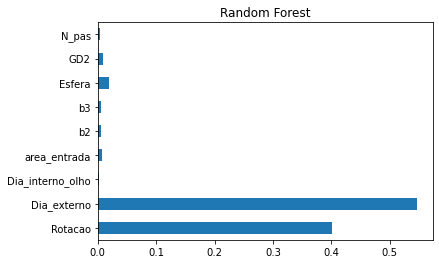

In [45]:
pd.Series(rf.feature_importances_, index=X_train1.columns).plot(kind='barh',title='Random Forest')
plt.show()

[ 23  46  69  92 116 139 162 185 208 232]
[0.9156331  0.95308636 0.96539718 0.97402779 0.97912233 0.98300573
 0.98437331 0.98587619 0.98711667 0.98795296]
[0.41232801 0.68585865 0.77120851 0.82168825 0.85569529 0.88115065
 0.89832391 0.90952609 0.92004152 0.92715134]


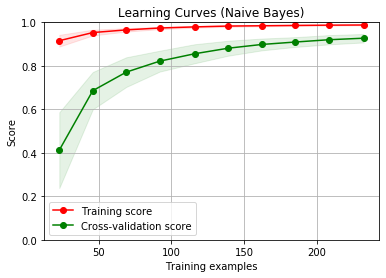

In [92]:
#fig, axes = plt.subplots(3, 2, figsize=(10, 15))

title = "Learning Curves (Naive Bayes)"
# Cross validation with 100 iterations to get smoother mean test and train
# score curves, each time with 20% data randomly selected as a validation set.
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)

estimator = RandomForestRegressor(random_state=42,max_features = 'auto', min_samples_leaf = 1, min_samples_split = 2, n_estimators = 100)
plot_learning_curve(
    estimator, title, X, y, ylim=(0, 1.01), cv=cv, n_jobs=4,train_sizes=np.linspace(0.1, 1.0, 10)
)

plt.show()

## a2

In [46]:
X = df_bombas[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y = df_bombas['a2']

In [47]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(X, y, test_size=0.2, random_state=42)

In [48]:
# Create the random grid
random_grid = {'n_estimators': [10,50,100,200,300,750],
               'max_features': ['auto','sqrt'],
               'min_samples_split': [2,3,4],
               'min_samples_leaf': [1,2,3],
              'max_depth' : [None,10,50,100],
              'criterion':['mse','mae']}

rf = RandomForestRegressor(random_state=42)

rf_random = GridSearchCV(estimator = rf, param_grid = random_grid, scoring = 'r2', cv=5, n_jobs = -1)

rf_random.fit(X_train2, y_train2)

GridSearchCV(cv=5, estimator=RandomForestRegressor(random_state=42), n_jobs=-1,
             param_grid={'criterion': ['mse', 'mae'],
                         'max_depth': [None, 10, 50, 100],
                         'max_features': ['auto', 'sqrt'],
                         'min_samples_leaf': [1, 2, 3],
                         'min_samples_split': [2, 3, 4],
                         'n_estimators': [10, 50, 100, 200, 300, 750]},
             scoring='r2')

In [49]:
rf_random.best_params_

{'criterion': 'mae',
 'max_depth': None,
 'max_features': 'auto',
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 50}

In [50]:
y_pred2 = rf_random.predict(X_test2)

In [51]:
mean_absolute_error(y_test2,y_pred2)

0.00223802787262287

In [52]:
rf_random.score(X_test2,y_test2)

0.9834416991048579

In [53]:
rf_random.score(X_train2,y_train2)

0.9937503601651543

In [56]:
rf = RandomForestRegressor(random_state=42,criterion = 'mae', max_depth = None, max_features = 'auto', min_samples_leaf = 1, min_samples_split = 2, n_estimators = 50)
rf.fit(X_train2,y_train2)

RandomForestRegressor(criterion='mae', n_estimators=50, random_state=42)

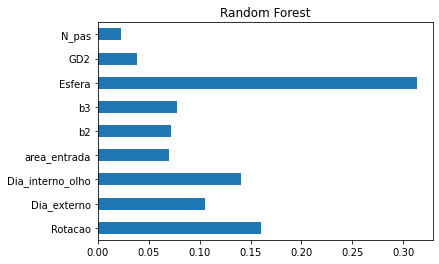

In [57]:
pd.Series(rf.feature_importances_, index=X_train2.columns).plot(kind='barh',title='Random Forest')
plt.show()

[ 23  46  69  92 116 139 162 185 208 232]
[0.92687562 0.97524541 0.98437656 0.98816599 0.9892392  0.99112697
 0.99241979 0.99301959 0.99372449 0.99395695]
[0.70275365 0.88023372 0.90840035 0.92747298 0.93866493 0.9450104
 0.95097788 0.95475703 0.95735059 0.96090819]


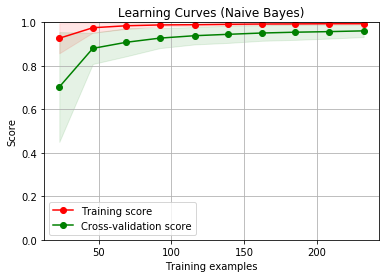

In [103]:
#fig, axes = plt.subplots(3, 2, figsize=(10, 15))

title = "Learning Curves (Naive Bayes)"
# Cross validation with 100 iterations to get smoother mean test and train
# score curves, each time with 20% data randomly selected as a validation set.
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)

estimator = RandomForestRegressor(random_state=42,max_features = 'auto', min_samples_leaf = 1, min_samples_split = 2, n_estimators = 10)
plot_learning_curve(
    estimator, title, X, y, ylim=(0, 1.01), cv=cv, n_jobs=4,train_sizes=np.linspace(0.1, 1.0, 10)
)

plt.show()

## a3

In [10]:
y = df_bombas['a3']
scaler = StandardScaler()
y = scaler.fit_transform(np.array(y).reshape(-1,1))

In [11]:
X_train3, X_test3, y_train3, y_test3 = train_test_split(X, y, test_size=0.2, random_state=42)

In [60]:
# Create the random grid
random_grid = {'n_estimators': [10,50,100,200,300,750],
               'max_features': ['auto','sqrt'],
               'min_samples_split': [2,3,4],
               'min_samples_leaf': [1,2,3],
              'max_depth' : [None,10,50,100],
              'criterion':['mse','mae']}

rf = RandomForestRegressor(random_state=42)

rf_random = GridSearchCV(estimator = rf, param_grid = random_grid, scoring = 'r2', cv=5)

rf_random.fit(X_train3, y_train3)

GridSearchCV(cv=5, estimator=RandomForestRegressor(random_state=42),
             param_grid={'criterion': ['mse', 'mae'],
                         'max_depth': [None, 10, 50, 100],
                         'max_features': ['auto', 'sqrt'],
                         'min_samples_leaf': [1, 2, 3],
                         'min_samples_split': [2, 3, 4],
                         'n_estimators': [10, 50, 100, 200, 300, 750]},
             scoring='r2')

In [61]:
rf_random.best_params_

{'criterion': 'mae',
 'max_depth': None,
 'max_features': 'sqrt',
 'min_samples_leaf': 2,
 'min_samples_split': 2,
 'n_estimators': 100}

In [15]:
y_pred3 = rf_random.predict(X_test3)

In [69]:
mean_absolute_error(y_test3,y_pred3)

0.014740015364408639

In [70]:
rf_random.score(X_test3,y_test3)

0.999078789260701

In [12]:
rf = RandomForestRegressor(random_state=42,criterion = 'mae', max_depth = None, max_features = 'sqrt', min_samples_leaf = 2, min_samples_split = 2, n_estimators = 100)
rf.fit(X_train3,y_train3)

C:\Users\evert\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  
C:\Users\evert\Anaconda3\lib\site-packages\sklearn\ensemble\_forest.py:407: FutureWarning: Criterion 'mae' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='absolute_error'` which is equivalent.
  FutureWarning,


RandomForestRegressor(criterion='mae', max_features='sqrt', min_samples_leaf=2,
                      random_state=42)

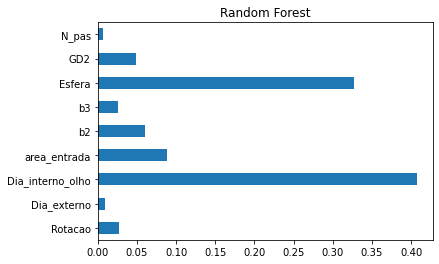

In [72]:
pd.Series(rf.feature_importances_, index=X_train3.columns).plot(kind='barh',title='Random Forest')
plt.show()

[ 23  46  69  92 116 139 162 185 208 232]
[0.92193281 0.96316382 0.98052767 0.98783884 0.99200814 0.99562889
 0.99718227 0.9981601  0.99874745 0.99900638]
[0.52643953 0.7353507  0.88700587 0.94085176 0.96883031 0.9796383
 0.98394641 0.98789314 0.99019134 0.99129365]


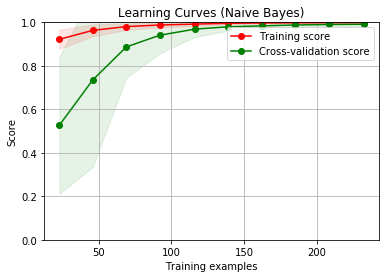

In [111]:
#fig, axes = plt.subplots(3, 2, figsize=(10, 15))

title = "Learning Curves (Naive Bayes)"
# Cross validation with 100 iterations to get smoother mean test and train
# score curves, each time with 20% data randomly selected as a validation set.
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)

estimator = RandomForestRegressor(random_state=42,max_features = 'auto', min_samples_leaf = 1, min_samples_split = 2, n_estimators = 300)
plot_learning_curve(
    estimator, title, X, y, ylim=(0, 1.01), cv=cv, n_jobs=4,train_sizes=np.linspace(0.1, 1.0, 10)
)

plt.show()

In [16]:
y_test31 = scaler.inverse_transform(y_test3)
y_pred31 = scaler.inverse_transform(y_pred3.reshape(-1,1))

In [17]:
mean_absolute_error(y_test31,y_pred31)

3.5575334993873506e-06

## xn

In [75]:
X = df_bombas[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y = df_bombas['xn']

In [76]:
X_train4, X_test4, y_train4, y_test4 = train_test_split(X, y, test_size=0.2, random_state=42)

In [115]:
# Create the random grid
random_grid = {'n_estimators': [10,50,100,200,300,750],
               'max_features': ['auto','sqrt'],
               'min_samples_split': [2,3,4],
               'min_samples_leaf': [1,2,3],
              'max_depth' : [None,10,50,100],
              'criterion':['mse','mae']}

rf = RandomForestRegressor(random_state=42)

rf_random = GridSearchCV(estimator = rf, param_grid = random_grid, scoring = 'r2', cv=5)

rf_random.fit(X_train4, y_train4)

C:\Users\evert\Anaconda3\lib\site-packages\sklearn\model_selection\_search.py:813: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


GridSearchCV(cv=5, error_score='raise-deprecating',
             estimator=RandomForestRegressor(bootstrap=True, criterion='mse',
                                             max_depth=None,
                                             max_features='auto',
                                             max_leaf_nodes=None,
                                             min_impurity_decrease=0.0,
                                             min_impurity_split=None,
                                             min_samples_leaf=1,
                                             min_samples_split=2,
                                             min_weight_fraction_leaf=0.0,
                                             n_estimators='warn', n_jobs=None,
                                             oob_score=False, random_state=42,
                                             verbose=0, warm_start=False),
             iid='warn', n_jobs=None,
             param_grid={'max_features': ['auto', 'sqrt'],

In [116]:
rf_random.best_params_

{'max_features': 'auto',
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 300}

In [117]:
y_pred4 = rf_random.predict(X_test4)

In [118]:
mean_absolute_error(y_test4,y_pred4)

232.2903989471113

In [119]:
rf_random.score(X_test4,y_test4)

0.918698769818429

In [120]:
rf = RandomForestRegressor(random_state=42,max_features = 'auto', min_samples_leaf = 1, min_samples_split = 2, n_estimators = 300)
rf.fit(X_train4,y_train4)

RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=300,
                      n_jobs=None, oob_score=False, random_state=42, verbose=0,
                      warm_start=False)

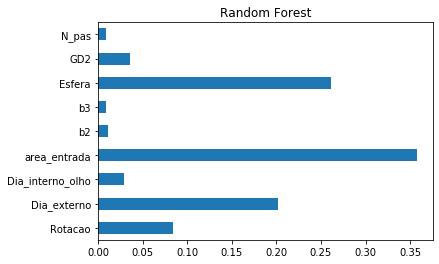

In [121]:
pd.Series(rf.feature_importances_, index=X_train4.columns).plot(kind='barh',title='Random Forest')
plt.show()

[ 23  46  69  92 116 139 162 185 208 232]
[0.93849026 0.95712856 0.9631704  0.96991189 0.97456608 0.97723992
 0.97943972 0.98139546 0.98324413 0.98442027]
[0.58581483 0.70081126 0.75463291 0.78078901 0.81231034 0.83549914
 0.85401148 0.86721034 0.87932736 0.89096361]


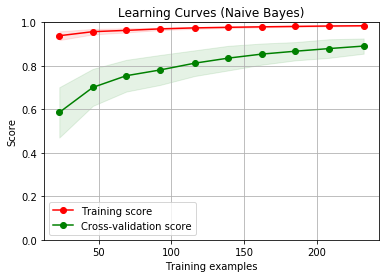

In [122]:
#fig, axes = plt.subplots(3, 2, figsize=(10, 15))

title = "Learning Curves (Naive Bayes)"
# Cross validation with 100 iterations to get smoother mean test and train
# score curves, each time with 20% data randomly selected as a validation set.
cv = ShuffleSplit(n_splits=100, test_size=0.2, random_state=0)

estimator = RandomForestRegressor(random_state=42,max_features = 'auto', min_samples_leaf = 1, min_samples_split = 2, n_estimators = 300)
plot_learning_curve(
    estimator, title, X, y, ylim=(0, 1.01), cv=cv, n_jobs=4,train_sizes=np.linspace(0.1, 1.0, 10)
)

plt.show()

## Diferença nas curvas

In [77]:
df_teste = X_test1
df_teste['a1'] = y_test1
df_teste['a2'] = y_test2
df_teste['a3'] = y_test31
df_teste['xn'] = y_test4
df_teste['a1p'] = y_pred1
df_teste['a2p'] = y_pred2
df_teste['a3p'] = y_pred31
#df_teste['xnp'] = y_pred4

In [78]:
df_teste.head()

,Rotacao,Dia_externo,Dia_interno_olho,area_entrada,b2,b3,Esfera,GD2,N_pas,a1,a2,a3,xn,a1p,a2p,a3p
84,2100,13.7,2.133,10.2,0.915,2.116,0.50,3.0,6,119.021978,0.009496,-0.000035,1200.000000,113.961076,0.011663,-0.000035
259,1785,20.2,3.081,68.4,1.383,3.197,0.53,21.7,6,182.334881,-0.001863,-0.000005,4000.000000,165.902993,0.000246,-0.000005
45,3300,9.1,2.133,5.9,0.654,1.513,0.44,2.4,6,120.423005,0.000215,-0.000074,910.000000,121.724572,-0.000435,-0.000072
176,2350,12.2,2.133,27.0,0.855,1.977,0.72,3.6,5,113.152813,-0.002525,-0.000009,1844.186047,111.720660,-0.002425,-0.000010
143,2960,8.2,2.449,15.2,0.668,1.544,0.75,3.1,6,79.640163,-0.008169,-0.000009,1902.400000,74.590000,-0.008507,-0.000009


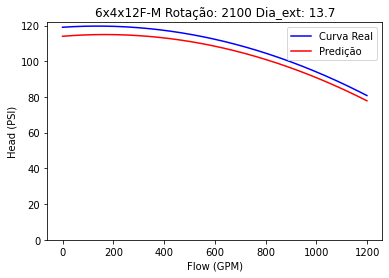

<Figure size 432x288 with 0 Axes>

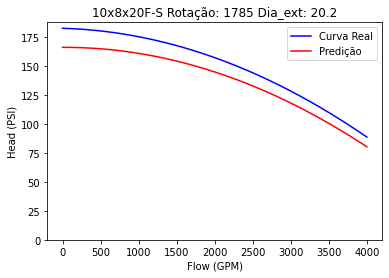

<Figure size 432x288 with 0 Axes>

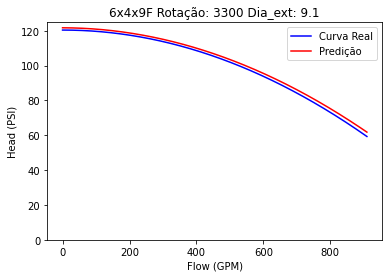

<Figure size 432x288 with 0 Axes>

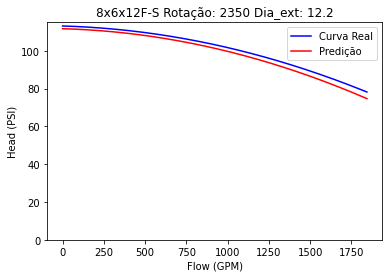

<Figure size 432x288 with 0 Axes>

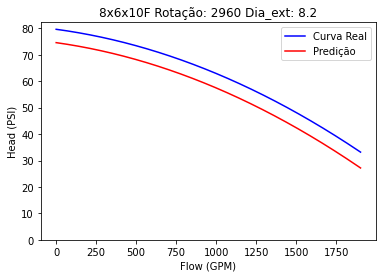

<Figure size 432x288 with 0 Axes>

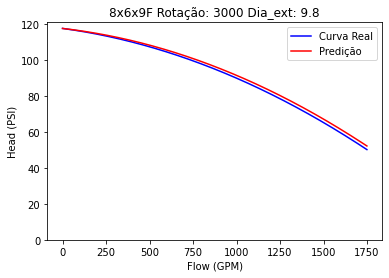

<Figure size 432x288 with 0 Axes>

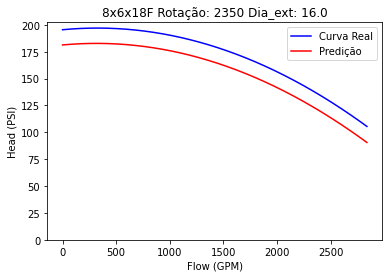

<Figure size 432x288 with 0 Axes>

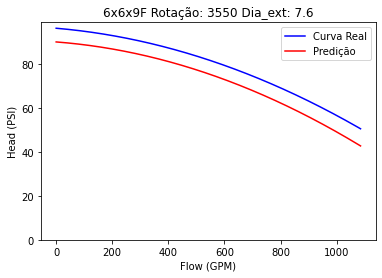

<Figure size 432x288 with 0 Axes>

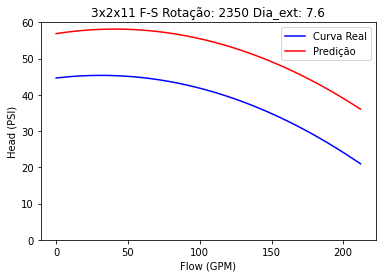

<Figure size 432x288 with 0 Axes>

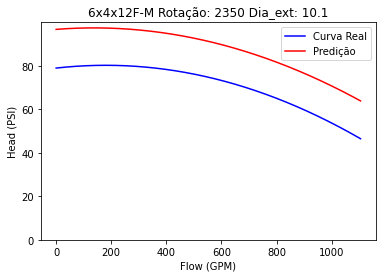

<Figure size 432x288 with 0 Axes>

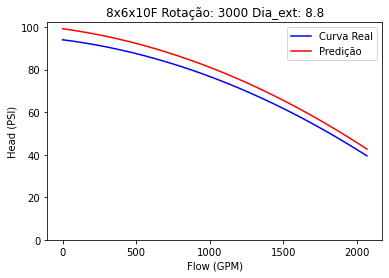

<Figure size 432x288 with 0 Axes>

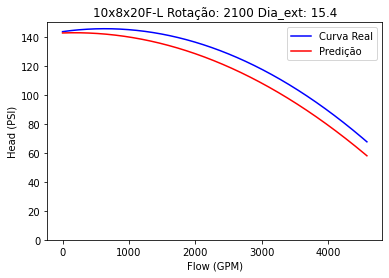

<Figure size 432x288 with 0 Axes>

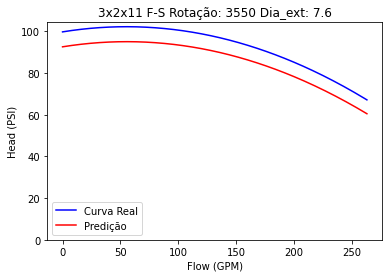

<Figure size 432x288 with 0 Axes>

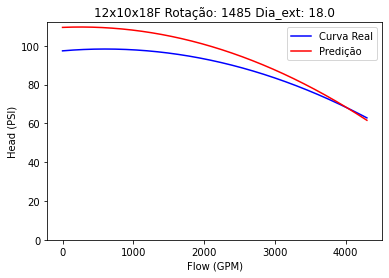

<Figure size 432x288 with 0 Axes>

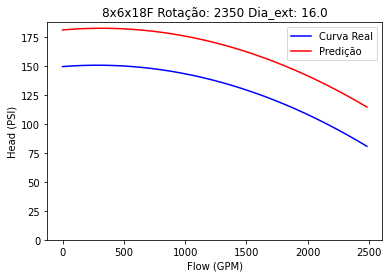

<Figure size 432x288 with 0 Axes>

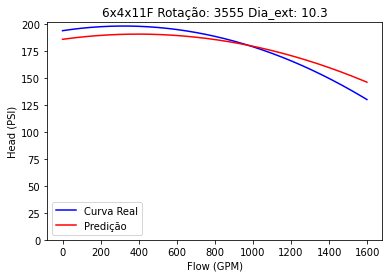

<Figure size 432x288 with 0 Axes>

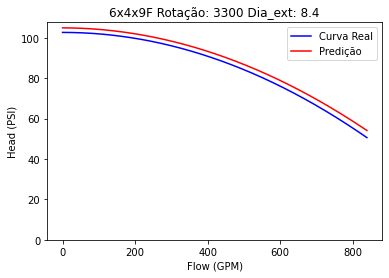

<Figure size 432x288 with 0 Axes>

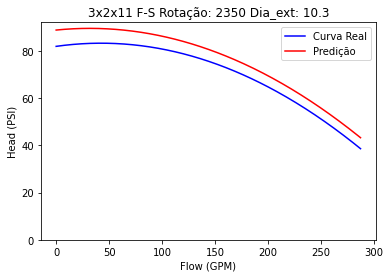

<Figure size 432x288 with 0 Axes>

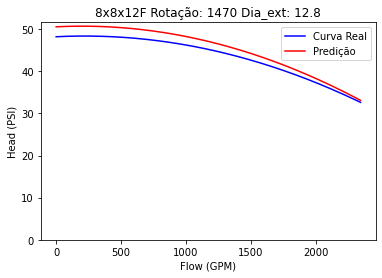

<Figure size 432x288 with 0 Axes>

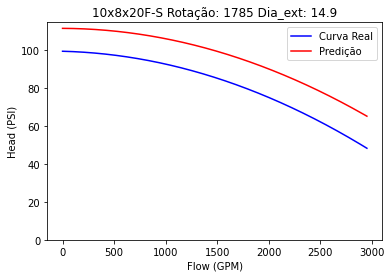

<Figure size 432x288 with 0 Axes>

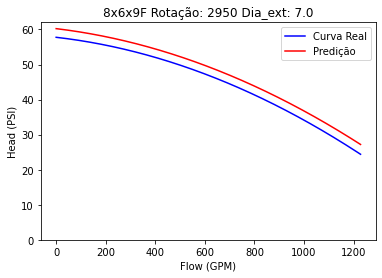

<Figure size 432x288 with 0 Axes>

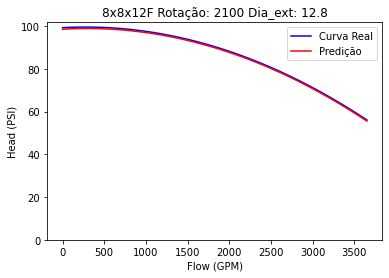

<Figure size 432x288 with 0 Axes>

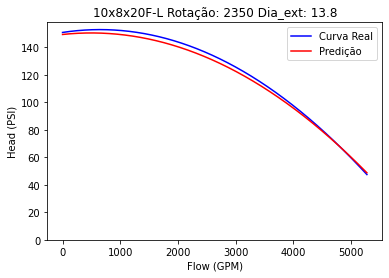

<Figure size 432x288 with 0 Axes>

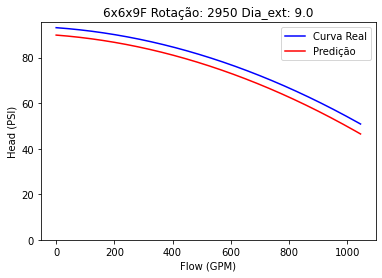

<Figure size 432x288 with 0 Axes>

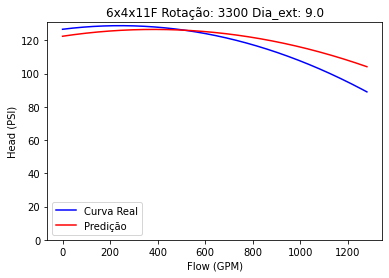

<Figure size 432x288 with 0 Axes>

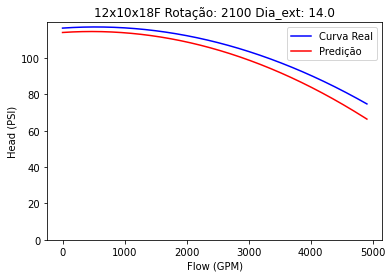

<Figure size 432x288 with 0 Axes>

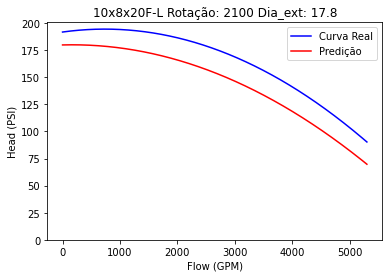

<Figure size 432x288 with 0 Axes>

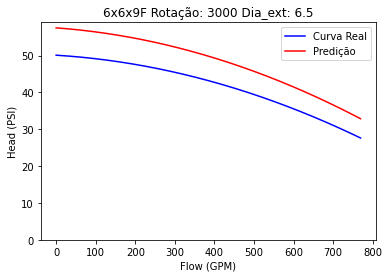

<Figure size 432x288 with 0 Axes>

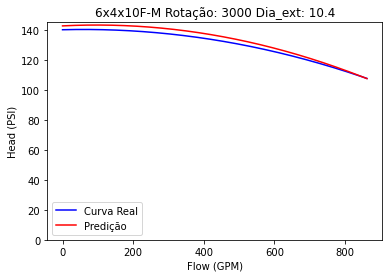

<Figure size 432x288 with 0 Axes>

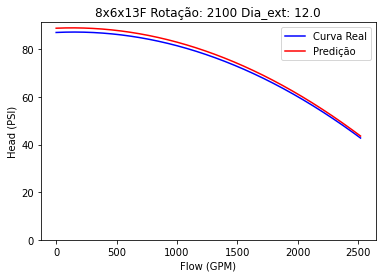

<Figure size 432x288 with 0 Axes>

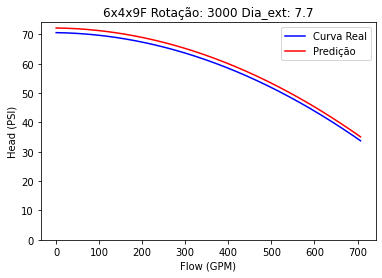

<Figure size 432x288 with 0 Axes>

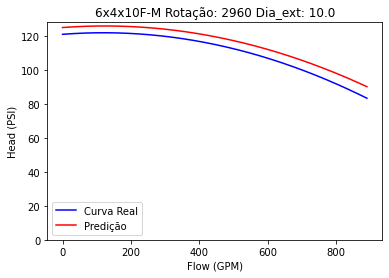

<Figure size 432x288 with 0 Axes>

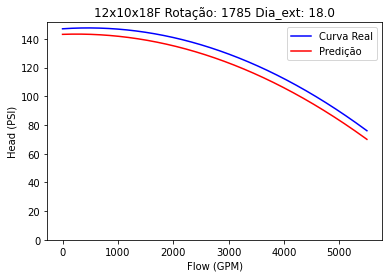

<Figure size 432x288 with 0 Axes>

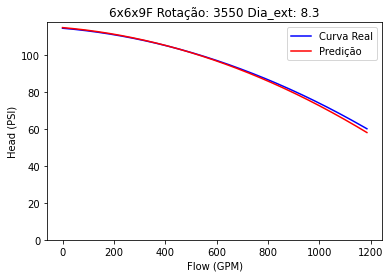

<Figure size 432x288 with 0 Axes>

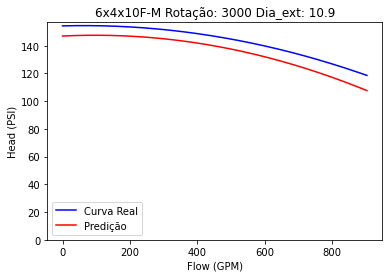

<Figure size 432x288 with 0 Axes>

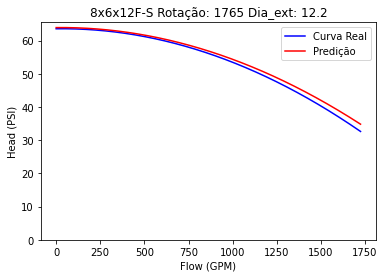

<Figure size 432x288 with 0 Axes>

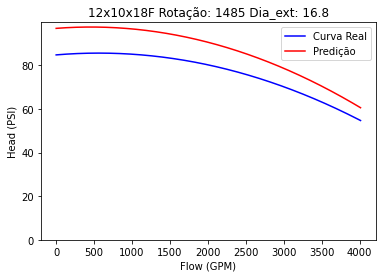

<Figure size 432x288 with 0 Axes>

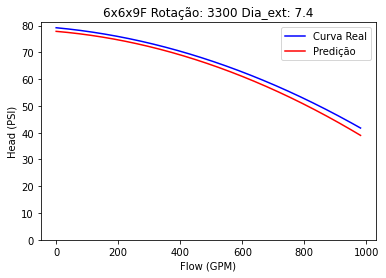

<Figure size 432x288 with 0 Axes>

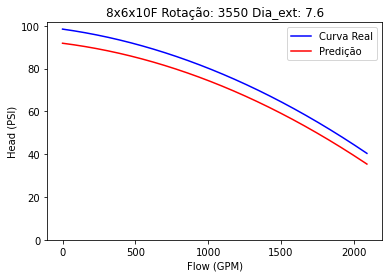

<Figure size 432x288 with 0 Axes>

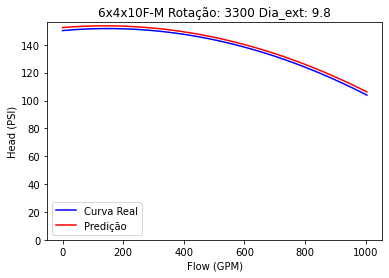

<Figure size 432x288 with 0 Axes>

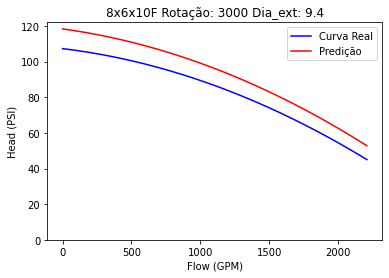

<Figure size 432x288 with 0 Axes>

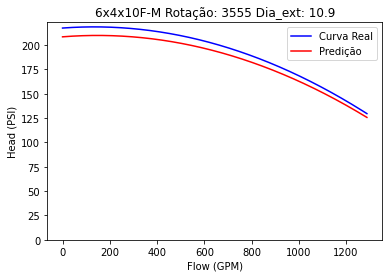

<Figure size 432x288 with 0 Axes>

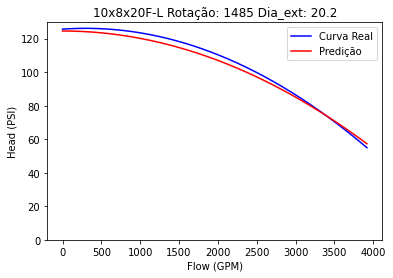

<Figure size 432x288 with 0 Axes>

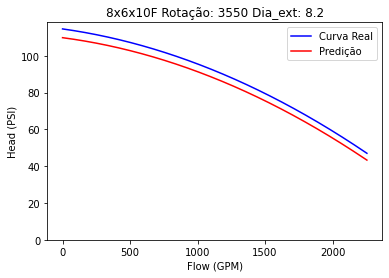

<Figure size 432x288 with 0 Axes>

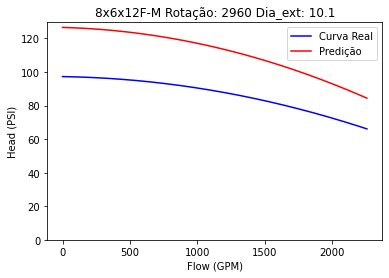

<Figure size 432x288 with 0 Axes>

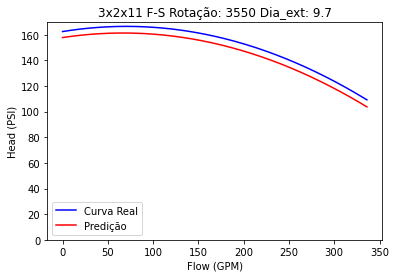

<Figure size 432x288 with 0 Axes>

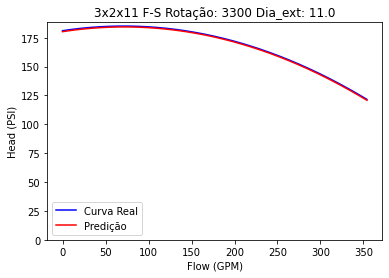

<Figure size 432x288 with 0 Axes>

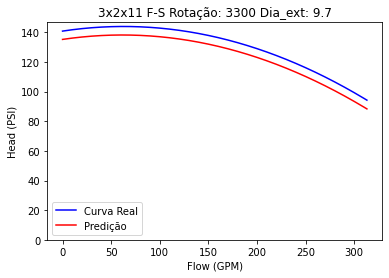

<Figure size 432x288 with 0 Axes>

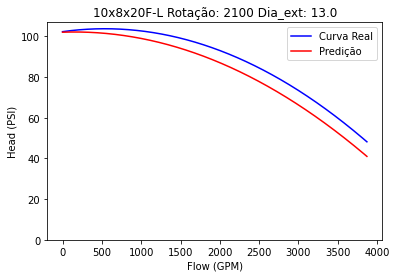

<Figure size 432x288 with 0 Axes>

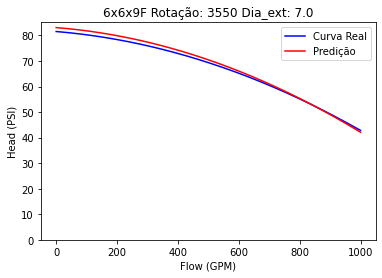

<Figure size 432x288 with 0 Axes>

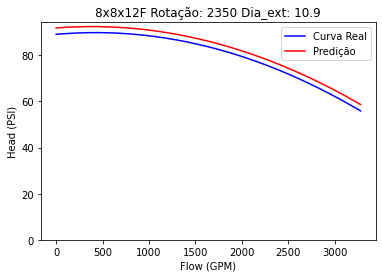

<Figure size 432x288 with 0 Axes>

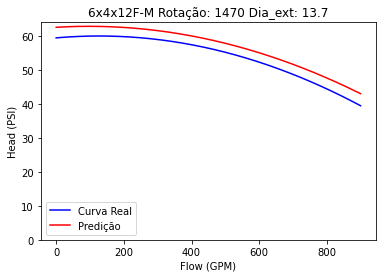

<Figure size 432x288 with 0 Axes>

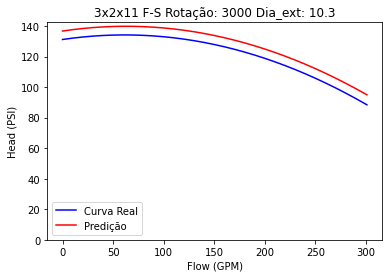

<Figure size 432x288 with 0 Axes>

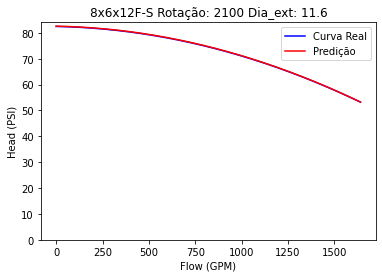

<Figure size 432x288 with 0 Axes>

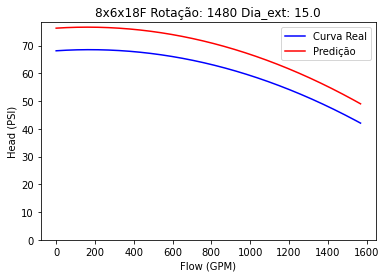

<Figure size 432x288 with 0 Axes>

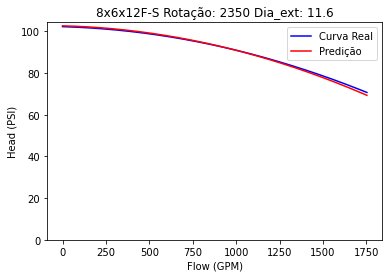

<Figure size 432x288 with 0 Axes>

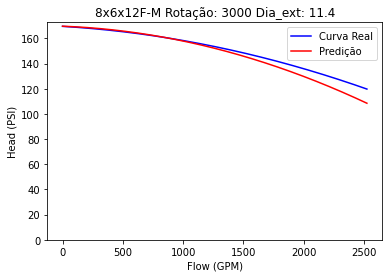

<Figure size 432x288 with 0 Axes>

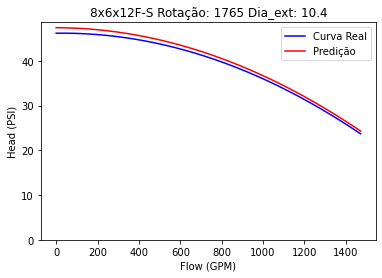

<Figure size 432x288 with 0 Axes>

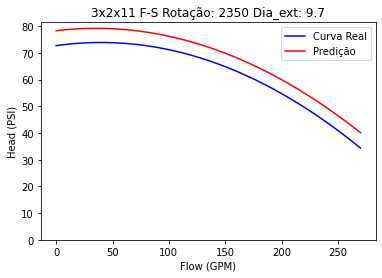

<Figure size 432x288 with 0 Axes>

In [79]:
dici_erro = {}
for indice in df_teste.index:
    eixo_x = []
    valor_real = []
    valor_previsto = []
    erro_abs = []
    erro_rel = []
    #print(X_test.loc[[i]]['Dia_externo'])
    ig, ax = plt.subplots()
    plt.ylabel('Head (PSI)')
    plt.xlabel('Flow (GPM)')
    #plt.title(dici[chave][2][-1]+', rotação: '+str(dici[chave][2][0])+' rpm, diâmetro externo: '+str(dici[chave][2][1])+' inches')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1'][indice],df_teste.loc[[indice]]['a2'][indice],df_teste.loc[[indice]]['a3'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='blue',label='Curva Real')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1p'][indice],df_teste.loc[[indice]]['a2p'][indice],df_teste.loc[[indice]]['a3p'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='red',label = 'Predição')
    plt.title(str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Modelo)+' Rotação: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Rotacao)+' Dia_ext: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Dia_externo))
    ax.set_ylim(bottom=0)
    plt.legend()
    plt.show()
    plt.clf()
    
    for valor in np.linspace(0,df_teste.loc[[indice]]['xn'][indice],5):
        valor = int(valor)
        eixo_x.append(valor)
        valor_real.append(df_teste.loc[[indice]]['a1'][indice] + df_teste.loc[[indice]]['a2'][indice]*valor + df_teste.loc[[indice]]['a3'][indice]*valor**2)
        valor_previsto.append(df_teste.loc[[indice]]['a1p'][indice] + df_teste.loc[[indice]]['a2p'][indice]*valor + df_teste.loc[[indice]]['a3p'][indice]*valor**2)
        erro_abs.append(valor_previsto[-1] - valor_real[-1])
        erro_rel.append(erro_abs[-1]/valor_real[-1])
    dici_erro[str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Modelo)+' Rotação: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Rotacao)+' Dia_ext: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Dia_externo)] = \
    [eixo_x,valor_real,valor_previsto,erro_abs,erro_rel]

In [81]:
df_erro = pd.DataFrame.from_dict(dici_erro).T
df_erro.to_excel('df_erro_Hyper_Tuning_RF.xlsx',index = True)

# Separando uma bomba para teste

# Random Forest

In [7]:
df_bombas.head()

,Rotacao,Dia_externo,Dia_interno_olho,area_entrada,b2,b3,Esfera,GD2,N_pas,Modelo,a1,a2,a3,xn,r2
0,2100,11.0,2.132,7.7,0.735,1.699,0.25,3.6,6,3x2x11 F-S,74.471923,0.063377,-0.000752,274.000000,0.998192
1,2100,10.3,2.132,7.7,0.735,1.699,0.25,3.6,6,3x2x11 F-S,35.549573,0.032309,-0.000410,256.563636,0.998192
2,2100,9.5,2.132,7.7,0.735,1.699,0.25,3.6,6,3x2x11 F-S,55.546207,0.054735,-0.000752,236.636364,0.998192
3,2100,8.7,2.132,7.7,0.735,1.699,0.25,3.6,6,3x2x11 F-S,46.584958,0.050125,-0.000752,216.709091,0.998192
4,2350,11.0,2.132,7.7,0.735,1.699,0.25,3.6,6,3x2x11 F-S,93.531040,0.067568,-0.000747,307.000000,0.997879


In [8]:
df_bombas.Modelo.unique()

array(['3x2x11 F-S', '6x4x9F', '6x4x10F-M', '6x4x11F', '6x4x12F-M',
       '6x6x9F', '8x6x9F', '8x6x10F', '8x6x12F-S', '8x6x12F-M', '8x6x13F',
       '8x6x18F', '8x8x12F', '8x8x17F', '10x8x17F-S', '10x8x17F-L',
       '10x8x20F-S', '10x8x20F-L', '12x10x18F'], dtype=object)

Criando um a3 em escala

In [9]:
y = df_bombas['a3']
scaler = StandardScaler()
y = scaler.fit_transform(np.array(y).reshape(-1,1))
df_bombas['a3_scaled'] = y

Criando df_teste e df_train

In [85]:
df_teste = df_bombas[df_bombas.Modelo.isin(['8x6x10F'])]

In [86]:
df_train = df_bombas[~df_bombas.Modelo.isin(['8x6x10F'])]

array([[<AxesSubplot:title={'center':'Dia_externo'}>]], dtype=object)

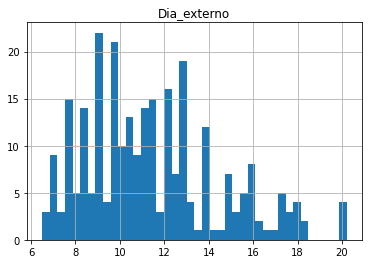

In [87]:
df_train.hist('Dia_externo',bins = 40)

array([[<AxesSubplot:title={'center':'Rotacao'}>]], dtype=object)

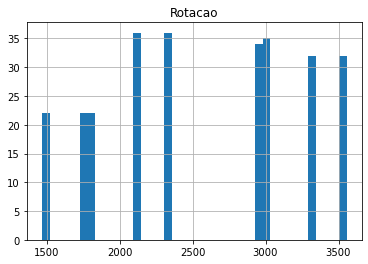

In [88]:
df_train.hist('Rotacao',bins = 40)

## Para a1

In [89]:
X_train1 = df_train[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_train1 = df_train['a1']

In [90]:
# X_train1, X_test1, y_train1, y_test1 = train_test_split(X, y, test_size=0.2, random_state=42)

In [91]:


X_test1 = df_teste[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_test1 = df_teste['a1']

In [92]:
rf = RandomForestRegressor(random_state=42)
rf.fit(X_train1,y_train1)

RandomForestRegressor(random_state=42)

In [93]:
rf.score(X_train1, y_train1)

0.9898563712344796

In [94]:
ypred1 = rf.predict(X_test1)

In [95]:
mean_absolute_error(y_test1,ypred1)

5.520099082622185

In [96]:
rf.score(X_test1,y_test1)

0.872202002261107

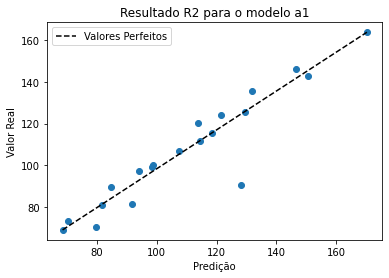

In [97]:
plt.title('Resultado R2 para o modelo a1')
plt.plot(y_test1,ypred1,'o')
plt.plot([y_test1.min(),y_test1.max()],[ypred1.min(),ypred1.max()],'--k',label = 'Valores Perfeitos')
plt.xlabel('Predição')
plt.ylabel('Valor Real')
plt.legend()

## Para a2

In [98]:
X_train2 = df_train[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_train2 = df_train['a2']

In [99]:
# X_train2, X_test2, y_train2, y_test2 = train_test_split(X, y, test_size=0.2, random_state=42)

In [100]:


X_test2 = df_teste[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_test2 = df_teste['a2']

In [101]:
rf = RandomForestRegressor(random_state=42)
rf.fit(X_train2,y_train2)

RandomForestRegressor(random_state=42)

In [102]:
rf.score(X_train2, y_train2)

0.9954141352255421

In [103]:
ypred2 = rf.predict(X_test2)

In [104]:
mean_absolute_error(y_test2,ypred2)

0.00991070659538743

In [105]:
rf.score(X_test2,y_test2)

-56.956321842819605

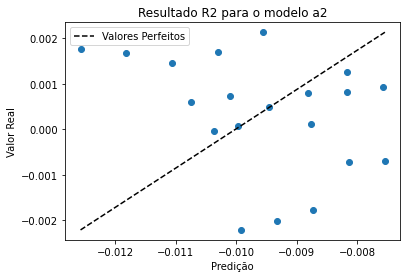

In [106]:
plt.title('Resultado R2 para o modelo a2')
plt.plot(y_test2,ypred2,'o')
plt.plot([y_test2.min(),y_test2.max()],[ypred2.min(),ypred2.max()],'--k',label = 'Valores Perfeitos')
plt.xlabel('Predição')
plt.ylabel('Valor Real')
plt.legend()

## Para a3

In [261]:
X_train3 = df_train[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_train3 = df_train['a3_scaled']

In [262]:
# X_train3, X_test3, y_train3, y_test3 = train_test_split(X, y, test_size=0.2, random_state=42)

In [263]:
X_test3 = df_teste[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_test3 = df_teste['a3_scaled']

In [264]:
rf = RandomForestRegressor(random_state=42)
rf.fit(X_train3,y_train3)

RandomForestRegressor(random_state=42)

In [265]:
rf.score(X_train3, y_train3)

0.9983999162312295

In [266]:
ypred3 = rf.predict(X_test3)

In [267]:
mean_absolute_error(y_test3,ypred3)

0.02762076283959628

In [268]:
rf.score(X_test3,y_test3)

-2367.936678313263

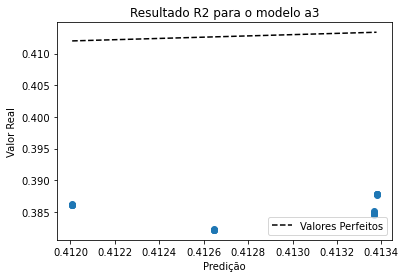

In [269]:
plt.title('Resultado R2 para o modelo a3')
plt.plot(y_test3,ypred3,'o')
plt.plot([y_test3.min(),y_test3.max()],[y_test3.min(),y_test3.max()],'--k',label = 'Valores Perfeitos')
plt.xlabel('Predição')
plt.ylabel('Valor Real')
plt.legend()

In [270]:
y_test31 = scaler.inverse_transform(np.array(y_test3).reshape(-1,1))
ypred31 = scaler.inverse_transform(np.array(ypred3).reshape(-1,1))

## Adicionando xn

In [117]:
X_test4 = df_teste[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_test4 = df_teste['xn']

In [118]:
df_teste

,Rotacao,Dia_externo,Dia_interno_olho,area_entrada,b2,b3,Esfera,GD2,N_pas,Modelo,a1,a2,a3,xn,r2,a3_scaled
140,2960,10.0,2.449,15.2,0.668,1.544,0.75,3.1,6,8x6x10F,118.441646,-0.009962,-0.000009,2320.0,0.997163,0.413366
141,2960,9.4,2.449,15.2,0.668,1.544,0.75,3.1,6,8x6x10F,128.106485,-0.010361,-0.000009,2412.8,0.997163,0.413366
142,2960,8.8,2.449,15.2,0.668,1.544,0.75,3.1,6,8x6x10F,91.721211,-0.008767,-0.000009,2041.6,0.997163,0.413366
143,2960,8.2,2.449,15.2,0.668,1.544,0.75,3.1,6,8x6x10F,79.640163,-0.008169,-0.000009,1902.4,0.997163,0.413366
144,2960,7.6,2.449,15.2,0.668,1.544,0.75,3.1,6,8x6x10F,68.411895,-0.007571,-0.000009,1763.2,0.997163,0.413366
145,3000,10.0,2.449,15.2,0.668,1.544,0.75,3.1,6,8x6x10F,121.418671,-0.009927,-0.000009,2350.0,0.995201,0.413378
146,3000,9.4,2.449,15.2,0.668,1.544,0.75,3.1,6,8x6x10F,107.285538,-0.009331,-0.000009,2209.0,0.995201,0.413378
147,3000,8.8,2.449,15.2,0.668,1.544,0.75,3.1,6,8x6x10F,94.026619,-0.008736,-0.000009,2068.0,0.995201,0.413378
148,3000,8.2,2.449,15.2,0.668,1.544,0.75,3.1,6,8x6x10F,81.641914,-0.008140,-0.000009,1927.0,0.995201,0.413378
149,3000,7.6,2.449,15.2,0.668,1.544,0.75,3.1,6,8x6x10F,70.131424,-0.007544,-0.000009,1786.0,0.995201,0.413378


In [119]:
df_teste = X_test1
df_teste['a1'] = y_test1
df_teste['a2'] = y_test2
df_teste['a3'] = y_test31
df_teste['xn'] = y_test4
df_teste['a1p'] = ypred1
df_teste['a2p'] = ypred2
df_teste['a3p'] = ypred31

C:\Users\evert\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\evert\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\evert\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = v

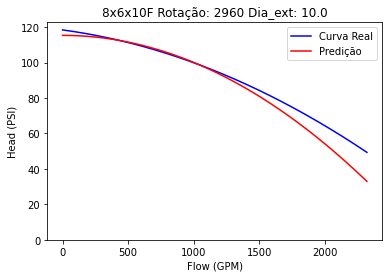

<Figure size 432x288 with 0 Axes>

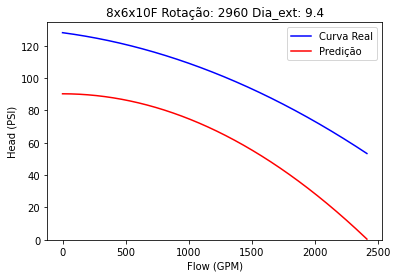

<Figure size 432x288 with 0 Axes>

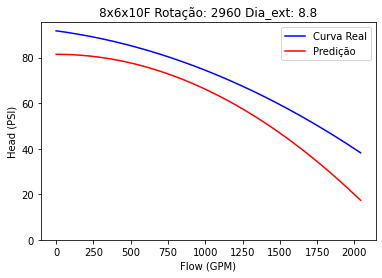

<Figure size 432x288 with 0 Axes>

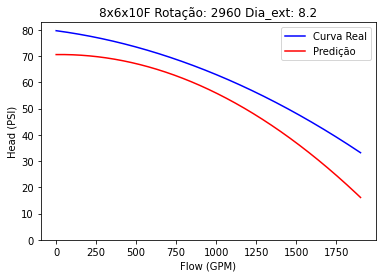

<Figure size 432x288 with 0 Axes>

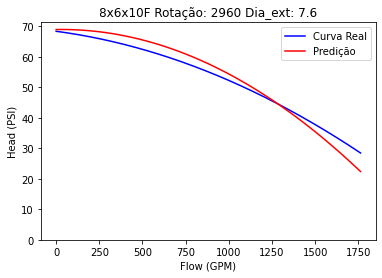

<Figure size 432x288 with 0 Axes>

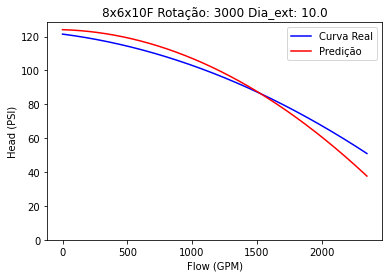

<Figure size 432x288 with 0 Axes>

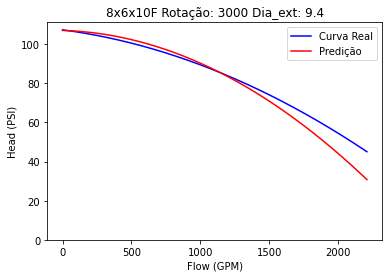

<Figure size 432x288 with 0 Axes>

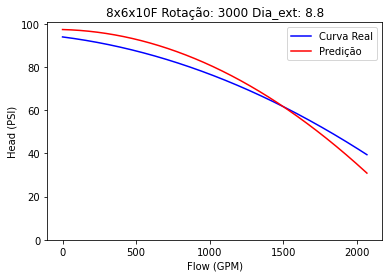

<Figure size 432x288 with 0 Axes>

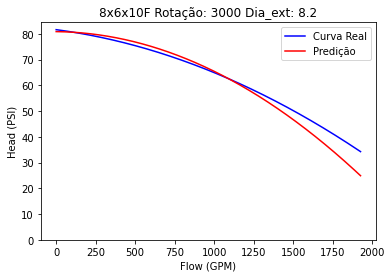

<Figure size 432x288 with 0 Axes>

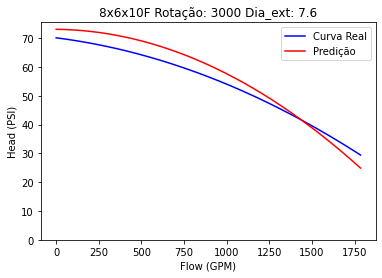

<Figure size 432x288 with 0 Axes>

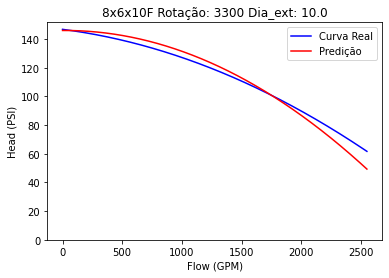

<Figure size 432x288 with 0 Axes>

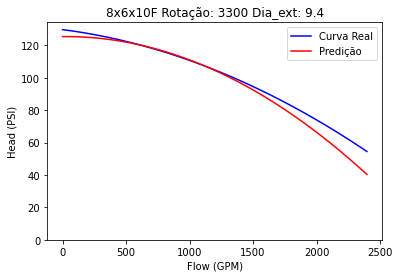

<Figure size 432x288 with 0 Axes>

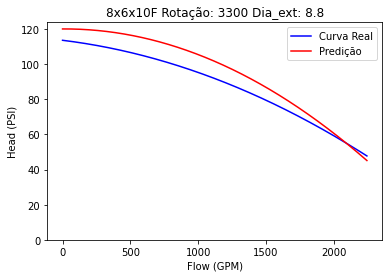

<Figure size 432x288 with 0 Axes>

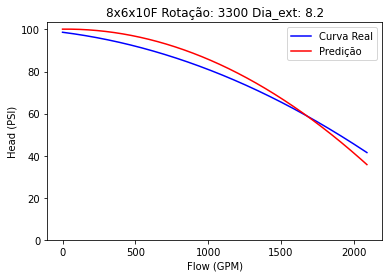

<Figure size 432x288 with 0 Axes>

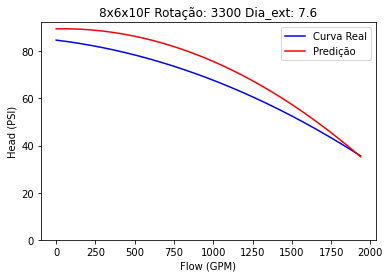

<Figure size 432x288 with 0 Axes>

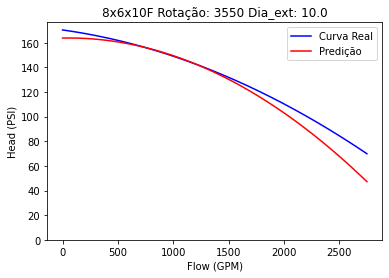

<Figure size 432x288 with 0 Axes>

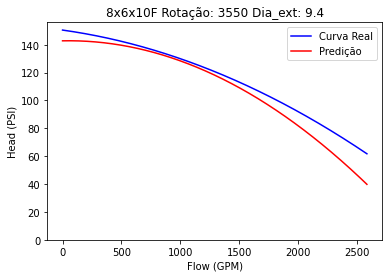

<Figure size 432x288 with 0 Axes>

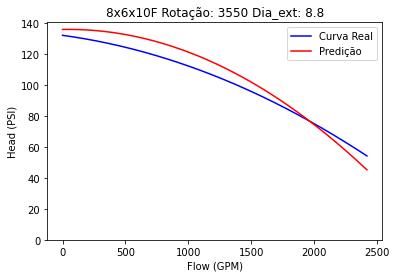

<Figure size 432x288 with 0 Axes>

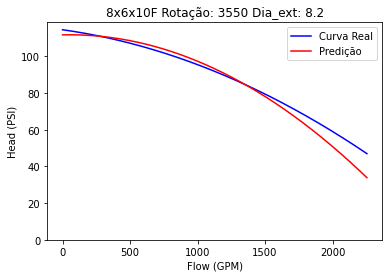

<Figure size 432x288 with 0 Axes>

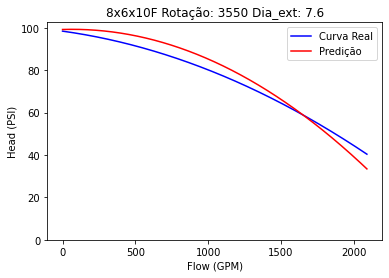

<Figure size 432x288 with 0 Axes>

In [120]:
dici_erro = {}
for indice in df_teste.index:
    eixo_x = []
    valor_real = []
    valor_previsto = []
    erro_abs = []
    erro_rel = []
    #print(X_test.loc[[i]]['Dia_externo'])
    ig, ax = plt.subplots()
    plt.ylabel('Head (PSI)')
    plt.xlabel('Flow (GPM)')
    #plt.title(dici[chave][2][-1]+', rotação: '+str(dici[chave][2][0])+' rpm, diâmetro externo: '+str(dici[chave][2][1])+' inches')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1'][indice],df_teste.loc[[indice]]['a2'][indice],df_teste.loc[[indice]]['a3'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='blue',label = 'Curva Real')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1p'][indice],df_teste.loc[[indice]]['a2p'][indice],df_teste.loc[[indice]]['a3p'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='red',label='Predição')
    plt.title(str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Modelo)+' Rotação: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Rotacao)+' Dia_ext: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Dia_externo))
    ax.set_ylim(bottom=0)
    plt.legend()
    plt.show()
    plt.clf()
        
    for valor in np.linspace(0,df_teste.loc[[indice]]['xn'][indice],5):
        valor = int(valor)
        eixo_x.append(valor)
        valor_real.append(df_teste.loc[[indice]]['a1'][indice] + df_teste.loc[[indice]]['a2'][indice]*valor + df_teste.loc[[indice]]['a3'][indice]*valor**2)
        valor_previsto.append(df_teste.loc[[indice]]['a1p'][indice] + df_teste.loc[[indice]]['a2p'][indice]*valor + df_teste.loc[[indice]]['a3p'][indice]*valor**2)
        erro_abs.append(valor_previsto[-1] - valor_real[-1])
        erro_rel.append(erro_abs[-1]/valor_real[-1])
    dici_erro[str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Modelo)+' Rotação: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Rotacao)+' Dia_ext: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Dia_externo)] = \
    [eixo_x,valor_real,valor_previsto,erro_abs,erro_rel]

In [121]:
df_erro = pd.DataFrame.from_dict(dici_erro).T

In [122]:
df_erro.to_excel('Erro_8x6x10F_RandomForest.xlsx')

# Random Forest: Tuned

## a1

In [157]:
y = df_bombas['a3']
scaler = StandardScaler()
y = scaler.fit_transform(np.array(y).reshape(-1,1))
df_bombas['a3_scaled'] = y

In [158]:
df_teste = df_bombas[df_bombas.Modelo.isin(['8x6x10F'])]
df_train = df_bombas[~df_bombas.Modelo.isin(['8x6x10F'])]

In [159]:
X_train1 = df_train[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_train1 = df_train['a1']

In [160]:
X_test1 = df_teste[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_test1 = df_teste['a1']

In [161]:
rf = RandomForestRegressor(random_state=42,max_depth = 10, max_features = 'auto', min_samples_leaf = 1, min_samples_split = 2, n_estimators = 300,criterion='mse')
rf.fit(X_train1,y_train1)

C:\Users\evert\Anaconda3\lib\site-packages\sklearn\ensemble\_forest.py:400: FutureWarning: Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.
  FutureWarning,


RandomForestRegressor(criterion='mse', max_depth=10, n_estimators=300,
                      random_state=42)

In [162]:
y_pred1 = rf.predict(X_test1)

In [163]:
mean_absolute_error(y_test1,y_pred1)

5.476729843186948

In [164]:
rf.score(X_test1,y_test1)

0.877921991390865

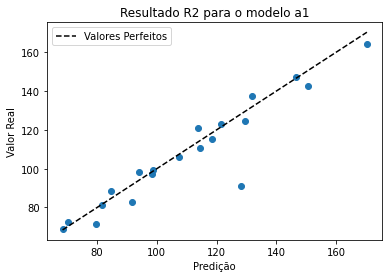

In [165]:
plt.title('Resultado R2 para o modelo a1')
plt.plot(y_test1,y_pred1,'o')
plt.plot([y_test1.min(),y_test1.max()],[y_test1.min(),y_test1.max()],'--k',label = 'Valores Perfeitos')
plt.xlabel('Predição')
plt.ylabel('Valor Real')
plt.legend()

## a2

In [166]:
X_train2 = df_train[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_train2 = df_train['a2']

X_test2 = df_teste[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_test2 = df_teste['a2']

In [167]:
rf = RandomForestRegressor(random_state=42,criterion = 'mae', max_depth = None, max_features = 'auto', min_samples_leaf = 1, min_samples_split = 2, n_estimators = 50)
rf.fit(X_train2,y_train2)

C:\Users\evert\Anaconda3\lib\site-packages\sklearn\ensemble\_forest.py:407: FutureWarning: Criterion 'mae' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='absolute_error'` which is equivalent.
  FutureWarning,


RandomForestRegressor(criterion='mae', n_estimators=50, random_state=42)

In [168]:
y_pred2 = rf.predict(X_test2)
mean_absolute_error(y_test2,y_pred2)

0.006165366751872949

In [169]:
rf.score(X_test2,y_test2)

-21.91398459543553

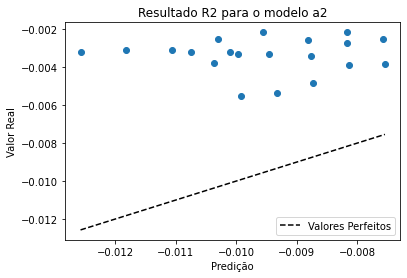

In [170]:
plt.title('Resultado R2 para o modelo a2')
plt.plot(y_test2,y_pred2,'o')
plt.plot([y_test2.min(),y_test2.max()],[y_test2.min(),y_test2.max()],'--k',label = 'Valores Perfeitos')
plt.xlabel('Predição')
plt.ylabel('Valor Real')
plt.legend()

## a3

In [171]:
X_train3 = df_train[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_train3 = df_train['a3_scaled']

X_test3 = df_teste[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_test3 = df_teste['a3_scaled']

In [172]:
rf = RandomForestRegressor(random_state=42,criterion = 'mae', max_depth = None, max_features = 'sqrt', min_samples_leaf = 2, min_samples_split = 2, n_estimators = 100)
rf.fit(X_train3,y_train3)

C:\Users\evert\Anaconda3\lib\site-packages\sklearn\ensemble\_forest.py:407: FutureWarning: Criterion 'mae' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='absolute_error'` which is equivalent.
  FutureWarning,


RandomForestRegressor(criterion='mae', max_features='sqrt', min_samples_leaf=2,
                      random_state=42)

In [173]:
y_pred3 = rf.predict(X_test3)
mean_absolute_error(y_test3,y_pred3)

0.08398373947967834

In [174]:
rf.score(X_test3,y_test3)

-21815.694203268173

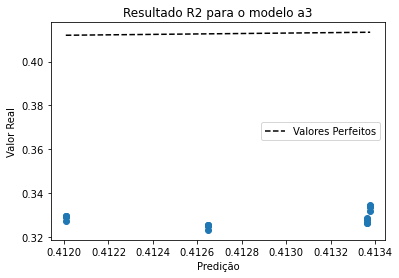

In [175]:
plt.title('Resultado R2 para o modelo a3')
plt.plot(y_test3,y_pred3,'o')
plt.plot([y_test3.min(),y_test3.max()],[y_test3.min(),y_test3.max()],'--k',label = 'Valores Perfeitos')
plt.xlabel('Predição')
plt.ylabel('Valor Real')
plt.legend()

In [176]:
y_test31 = scaler.inverse_transform(np.array(y_test3).reshape(-1,1))
y_pred31 = scaler.inverse_transform(np.array(y_pred3).reshape(-1,1))

In [177]:
mean_absolute_error(y_test31,y_pred31)

2.026965096143659e-05

## Adicionando xn

In [178]:
X_test4 = df_teste[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_test4 = df_teste['xn']

In [179]:
df_teste = X_test1
df_teste['a1'] = y_test1
df_teste['a2'] = y_test2
df_teste['a3'] = y_test31
df_teste['xn'] = y_test4
df_teste['a1p'] = y_pred1
df_teste['a2p'] = y_pred2
df_teste['a3p'] = y_pred31

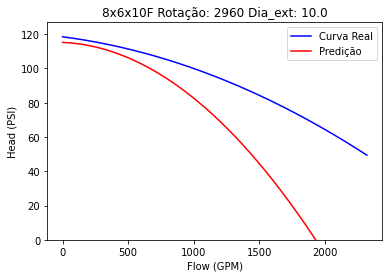

<Figure size 432x288 with 0 Axes>

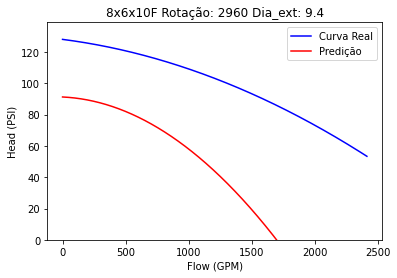

<Figure size 432x288 with 0 Axes>

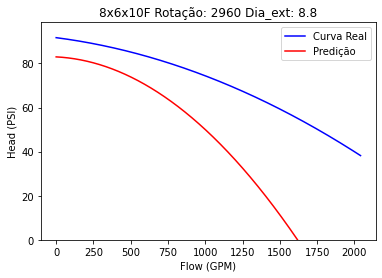

<Figure size 432x288 with 0 Axes>

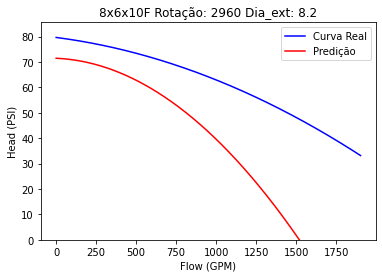

<Figure size 432x288 with 0 Axes>

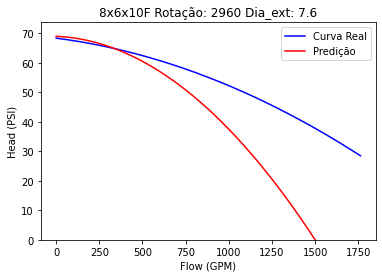

<Figure size 432x288 with 0 Axes>

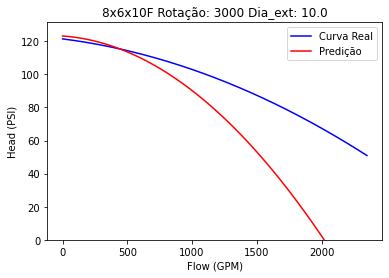

<Figure size 432x288 with 0 Axes>

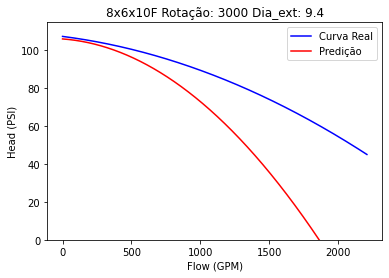

<Figure size 432x288 with 0 Axes>

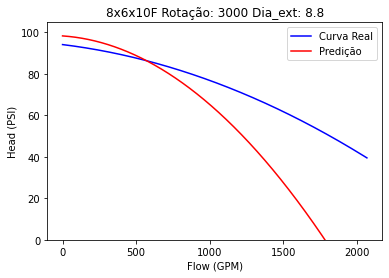

<Figure size 432x288 with 0 Axes>

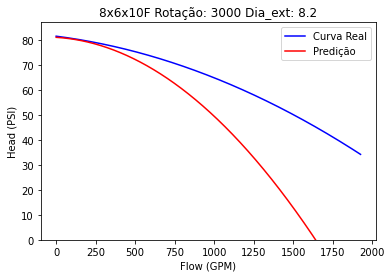

<Figure size 432x288 with 0 Axes>

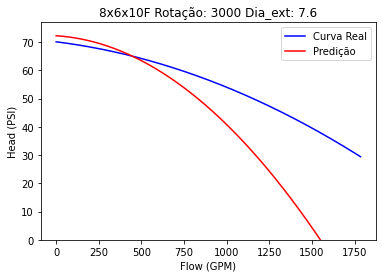

<Figure size 432x288 with 0 Axes>

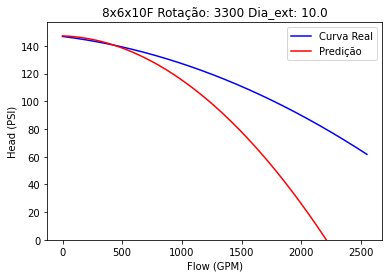

<Figure size 432x288 with 0 Axes>

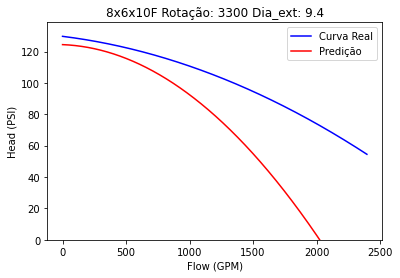

<Figure size 432x288 with 0 Axes>

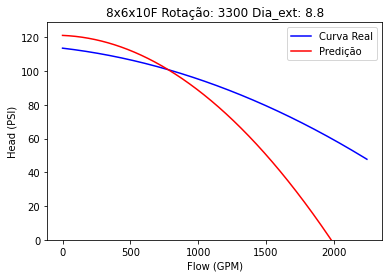

<Figure size 432x288 with 0 Axes>

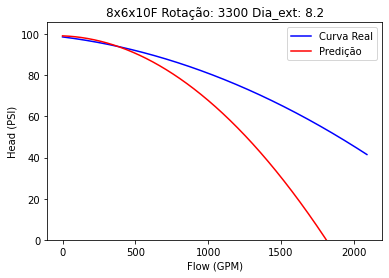

<Figure size 432x288 with 0 Axes>

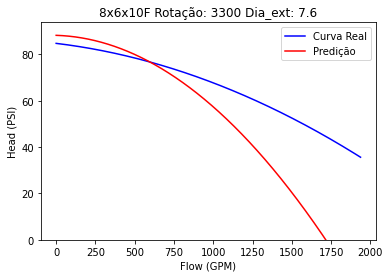

<Figure size 432x288 with 0 Axes>

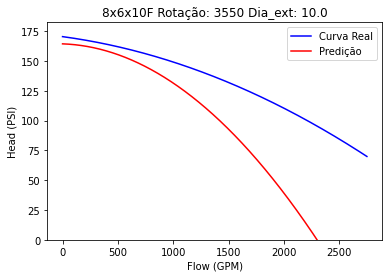

<Figure size 432x288 with 0 Axes>

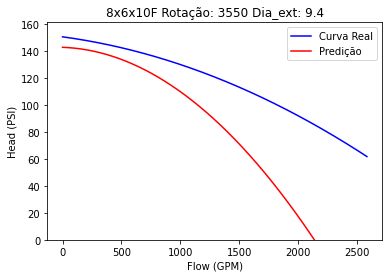

<Figure size 432x288 with 0 Axes>

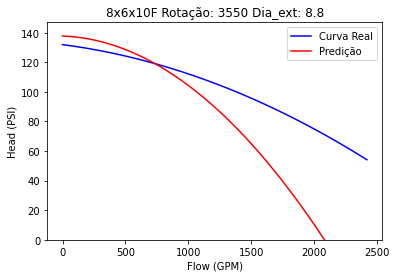

<Figure size 432x288 with 0 Axes>

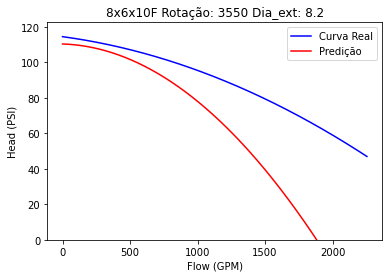

<Figure size 432x288 with 0 Axes>

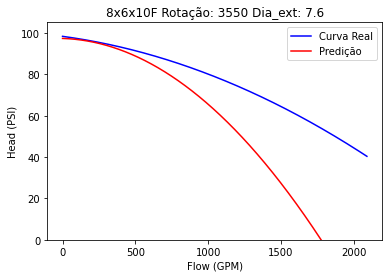

<Figure size 432x288 with 0 Axes>

In [180]:
dici_erro = {}
for indice in df_teste.index:
    eixo_x = []
    valor_real = []
    valor_previsto = []
    erro_abs = []
    erro_rel = []
    #print(X_test.loc[[i]]['Dia_externo'])
    ig, ax = plt.subplots()
    plt.ylabel('Head (PSI)')
    plt.xlabel('Flow (GPM)')
    #plt.title(dici[chave][2][-1]+', rotação: '+str(dici[chave][2][0])+' rpm, diâmetro externo: '+str(dici[chave][2][1])+' inches')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1'][indice],df_teste.loc[[indice]]['a2'][indice],df_teste.loc[[indice]]['a3'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='blue',label = 'Curva Real')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1p'][indice],df_teste.loc[[indice]]['a2p'][indice],df_teste.loc[[indice]]['a3p'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='red',label='Predição')
    plt.title(str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Modelo)+' Rotação: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Rotacao)+' Dia_ext: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Dia_externo))
    ax.set_ylim(bottom=0)
    plt.legend()
    plt.show()
    plt.clf()
        
    for valor in np.linspace(0,df_teste.loc[[indice]]['xn'][indice],5):
        valor = int(valor)
        eixo_x.append(valor)
        valor_real.append(df_teste.loc[[indice]]['a1'][indice] + df_teste.loc[[indice]]['a2'][indice]*valor + df_teste.loc[[indice]]['a3'][indice]*valor**2)
        valor_previsto.append(df_teste.loc[[indice]]['a1p'][indice] + df_teste.loc[[indice]]['a2p'][indice]*valor + df_teste.loc[[indice]]['a3p'][indice]*valor**2)
        erro_abs.append(valor_previsto[-1] - valor_real[-1])
        erro_rel.append(erro_abs[-1]/valor_real[-1])
    dici_erro[str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Modelo)+' Rotação: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Rotacao)+' Dia_ext: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Dia_externo)] = \
    [eixo_x,valor_real,valor_previsto,erro_abs,erro_rel]

# XGBoost

In [6]:
from xgboost import XGBRegressor

In [7]:
xgboost = XGBRegressor(random_state = 42)

## a1

In [8]:
X = df_bombas[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y = df_bombas['a1']

In [9]:
X_train1, X_test1, y_train1, y_test1 = train_test_split(X, y, test_size=0.2, random_state=42)

In [10]:
xgboost.fit(X_train1,y_train1)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.300000012,
             max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=100, n_jobs=8,
             num_parallel_tree=1, predictor='auto', random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [11]:
y_pred1 = xgboost.predict(X_test1)

In [12]:
mean_absolute_error(y_test1,y_pred1)

6.278834053508628

In [13]:
xgboost.score(X_test1,y_test1)

0.9481504764717127

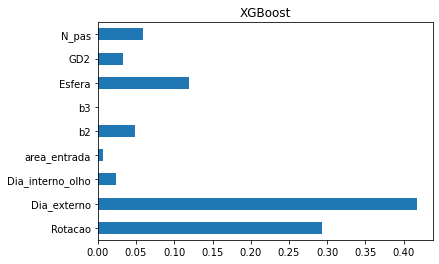

In [16]:
pd.Series(xgboost.feature_importances_, index=X_train1.columns).plot(kind='barh',title='XGBoost')
plt.show()

## a2

In [17]:
y = df_bombas['a2']

In [18]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(X, y, test_size=0.2, random_state=42)

In [19]:
xgboost.fit(X_train2,y_train2)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.300000012,
             max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=100, n_jobs=8,
             num_parallel_tree=1, predictor='auto', random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [20]:
y_pred2 = xgboost.predict(X_test2)

In [21]:
mean_absolute_error(y_test2,y_pred2)

0.0020868471400678386

In [22]:
xgboost.score(X_test2,y_test2)

0.9866016088893581

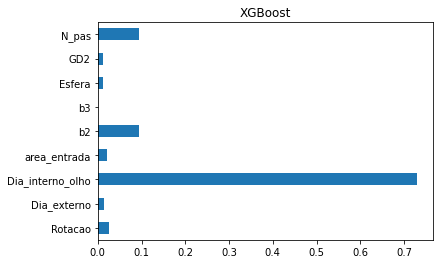

In [23]:
pd.Series(xgboost.feature_importances_, index=X_train1.columns).plot(kind='barh',title='XGBoost')
plt.show()

## a3

In [24]:
y = df_bombas['a3']
scaler = StandardScaler()
y = scaler.fit_transform(np.array(y).reshape(-1,1))

In [25]:
X_train3, X_test3, y_train3, y_test3 = train_test_split(X, y, test_size=0.2, random_state=42)

In [26]:
xgboost.fit(X_train3,y_train3)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.300000012,
             max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=100, n_jobs=8,
             num_parallel_tree=1, predictor='auto', random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [27]:
y_pred3 = xgboost.predict(X_test3)

In [28]:
mean_absolute_error(y_test3,y_pred3)

0.02877793010577768

In [29]:
xgboost.score(X_test3,y_test3)

0.9891671964663932

In [30]:
y_test31 = scaler.inverse_transform(y_test3)
y_pred31 = scaler.inverse_transform(y_pred3.reshape(-1,1))

In [31]:
mean_absolute_error(y_test31,y_pred31)

6.945613761877522e-06

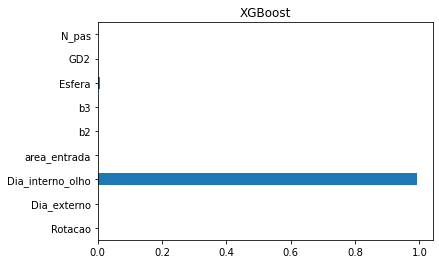

In [32]:
pd.Series(xgboost.feature_importances_, index=X_train1.columns).plot(kind='barh',title='XGBoost')
plt.show()

## xn

In [51]:
X = df_bombas[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y = df_bombas['xn']

In [52]:
X_train4, X_test4, y_train4, y_test4 = train_test_split(X, y, test_size=0.2, random_state=42)

## Diferença entre curvas

In [107]:
df_teste = X_test1
df_teste['a1'] = y_test1
df_teste['a2'] = y_test2
df_teste['a3'] = y_test31
df_teste['xn'] = y_test4
df_teste['a1p'] = y_pred1
df_teste['a2p'] = y_pred2
df_teste['a3p'] = y_pred31

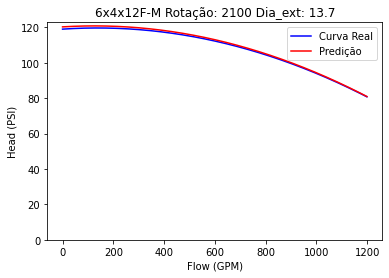

<Figure size 432x288 with 0 Axes>

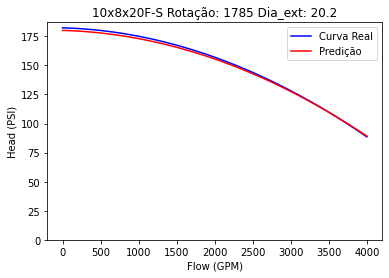

<Figure size 432x288 with 0 Axes>

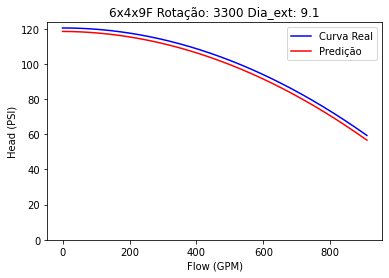

<Figure size 432x288 with 0 Axes>

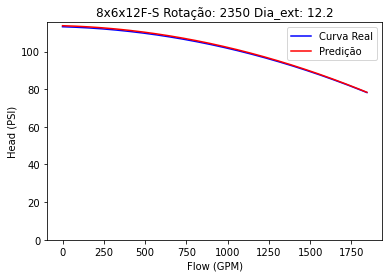

<Figure size 432x288 with 0 Axes>

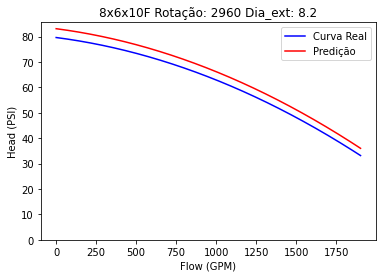

<Figure size 432x288 with 0 Axes>

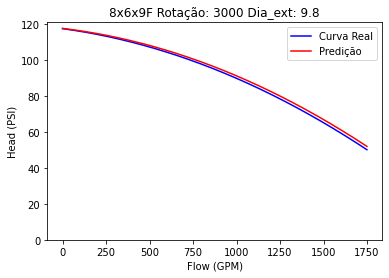

<Figure size 432x288 with 0 Axes>

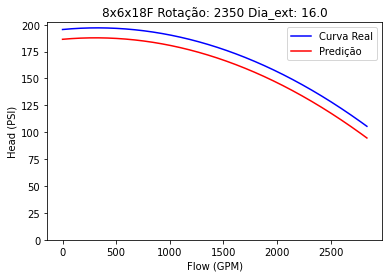

<Figure size 432x288 with 0 Axes>

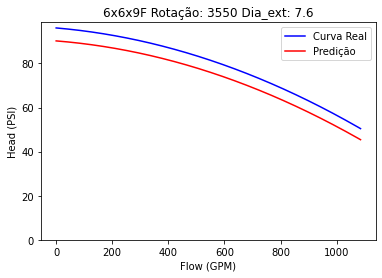

<Figure size 432x288 with 0 Axes>

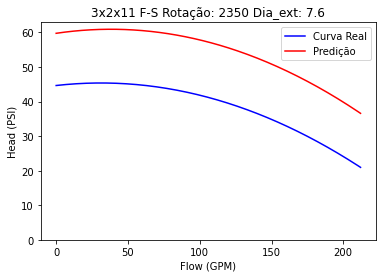

<Figure size 432x288 with 0 Axes>

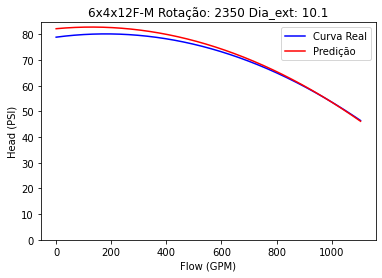

<Figure size 432x288 with 0 Axes>

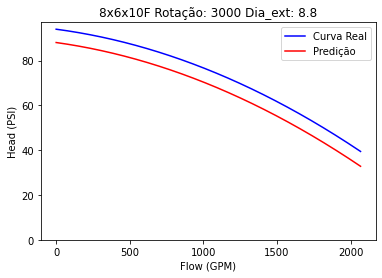

<Figure size 432x288 with 0 Axes>

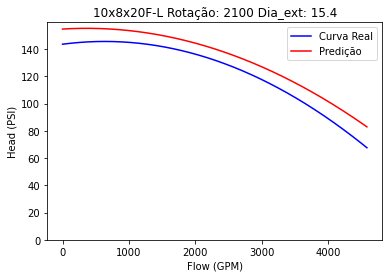

<Figure size 432x288 with 0 Axes>

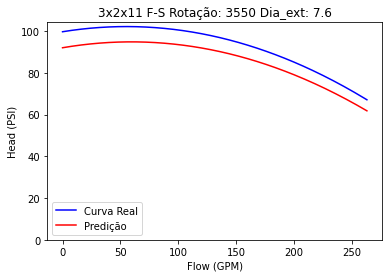

<Figure size 432x288 with 0 Axes>

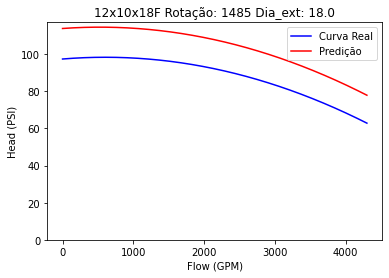

<Figure size 432x288 with 0 Axes>

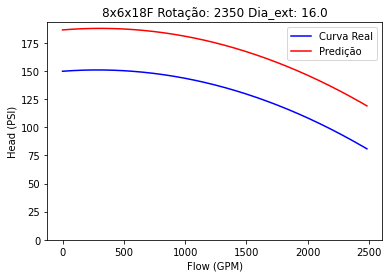

<Figure size 432x288 with 0 Axes>

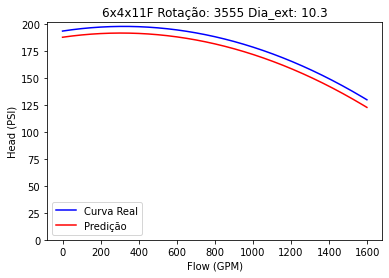

<Figure size 432x288 with 0 Axes>

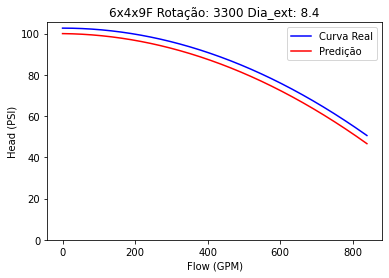

<Figure size 432x288 with 0 Axes>

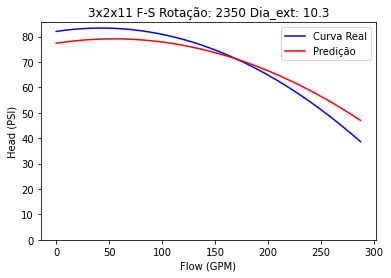

<Figure size 432x288 with 0 Axes>

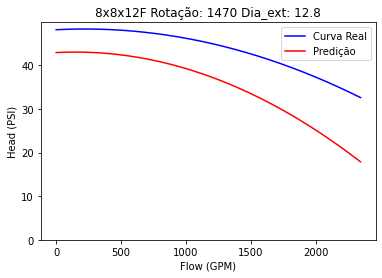

<Figure size 432x288 with 0 Axes>

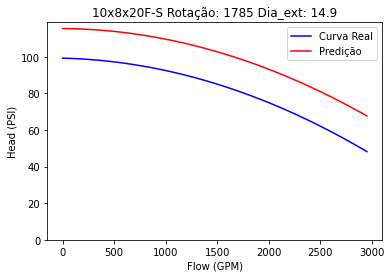

<Figure size 432x288 with 0 Axes>

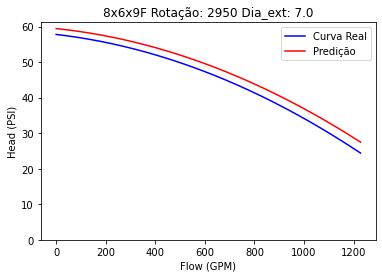

<Figure size 432x288 with 0 Axes>

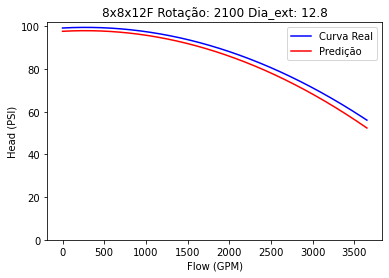

<Figure size 432x288 with 0 Axes>

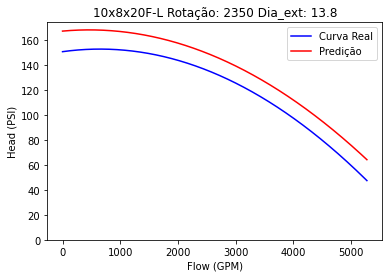

<Figure size 432x288 with 0 Axes>

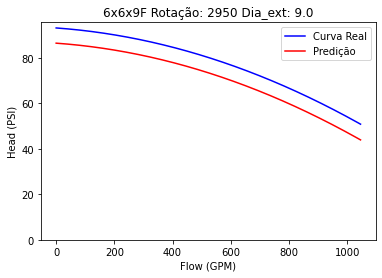

<Figure size 432x288 with 0 Axes>

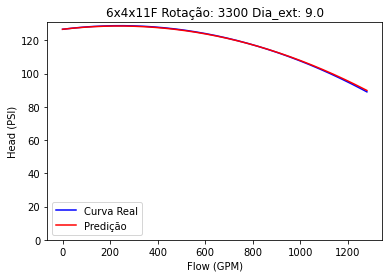

<Figure size 432x288 with 0 Axes>

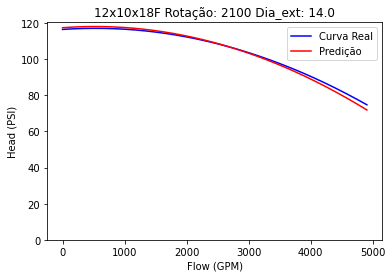

<Figure size 432x288 with 0 Axes>

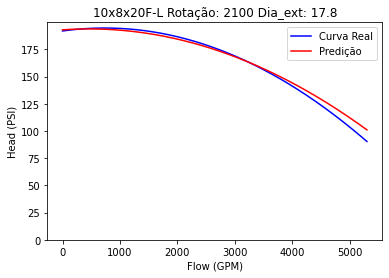

<Figure size 432x288 with 0 Axes>

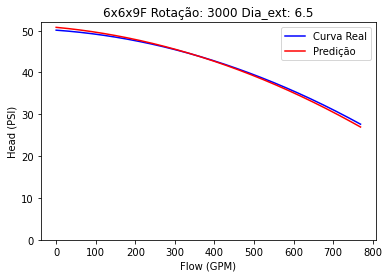

<Figure size 432x288 with 0 Axes>

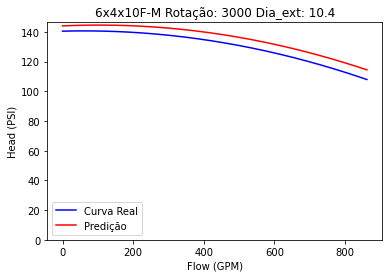

<Figure size 432x288 with 0 Axes>

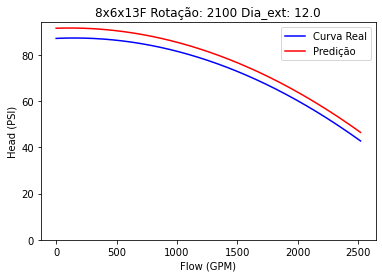

<Figure size 432x288 with 0 Axes>

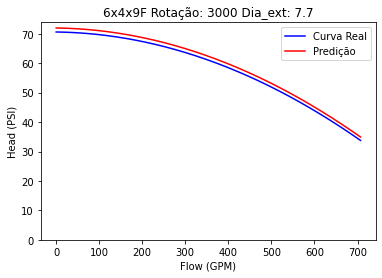

<Figure size 432x288 with 0 Axes>

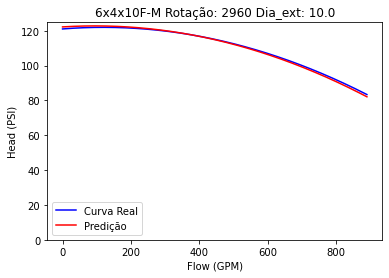

<Figure size 432x288 with 0 Axes>

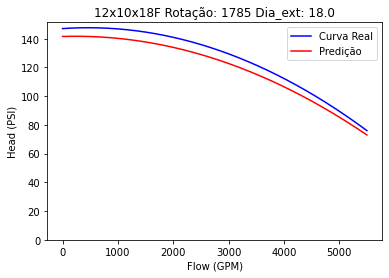

<Figure size 432x288 with 0 Axes>

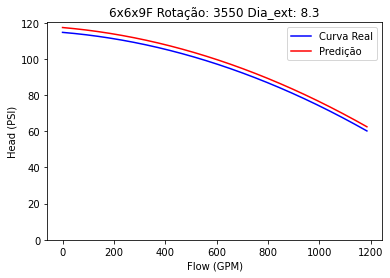

<Figure size 432x288 with 0 Axes>

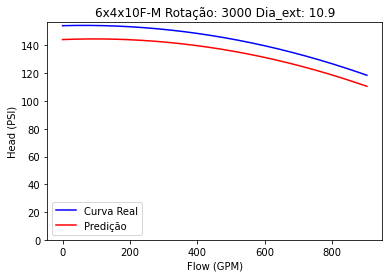

<Figure size 432x288 with 0 Axes>

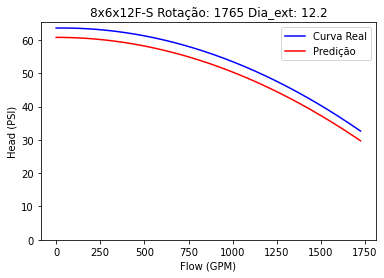

<Figure size 432x288 with 0 Axes>

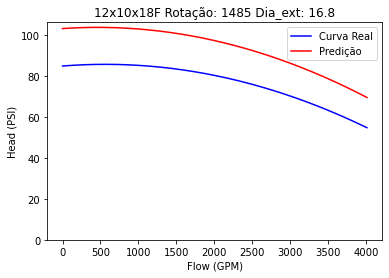

<Figure size 432x288 with 0 Axes>

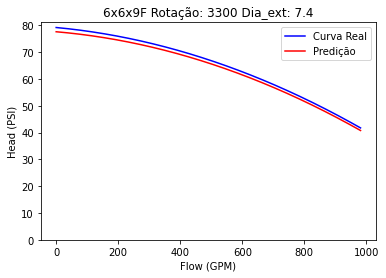

<Figure size 432x288 with 0 Axes>

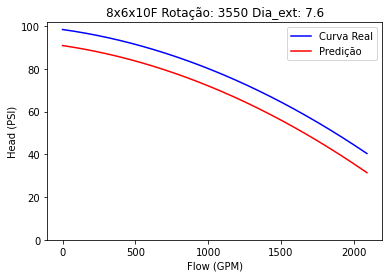

<Figure size 432x288 with 0 Axes>

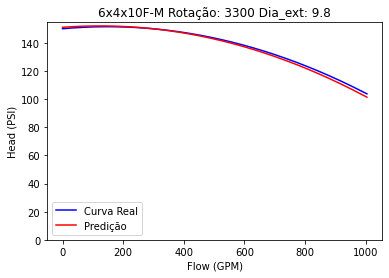

<Figure size 432x288 with 0 Axes>

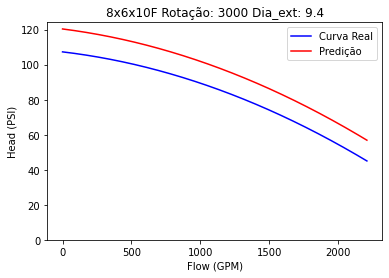

<Figure size 432x288 with 0 Axes>

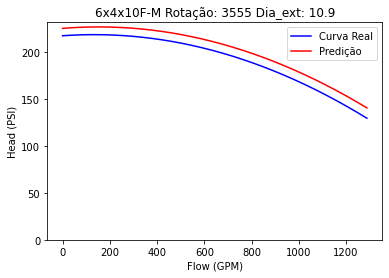

<Figure size 432x288 with 0 Axes>

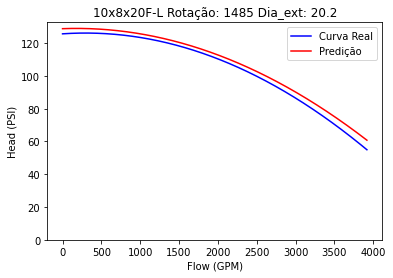

<Figure size 432x288 with 0 Axes>

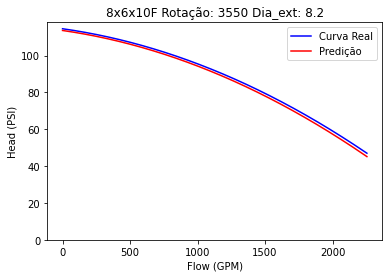

<Figure size 432x288 with 0 Axes>

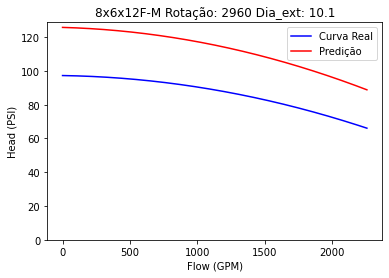

<Figure size 432x288 with 0 Axes>

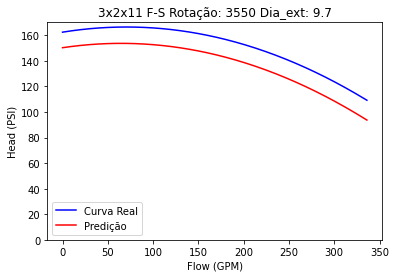

<Figure size 432x288 with 0 Axes>

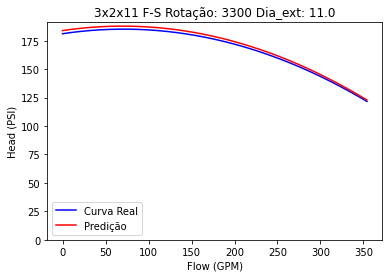

<Figure size 432x288 with 0 Axes>

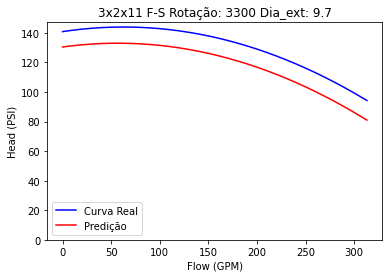

<Figure size 432x288 with 0 Axes>

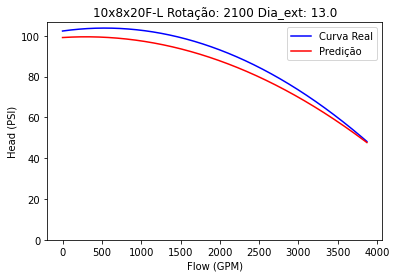

<Figure size 432x288 with 0 Axes>

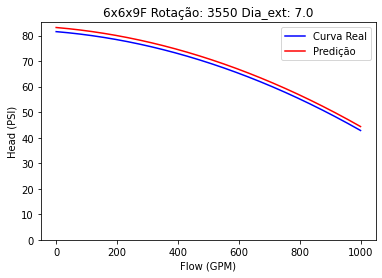

<Figure size 432x288 with 0 Axes>

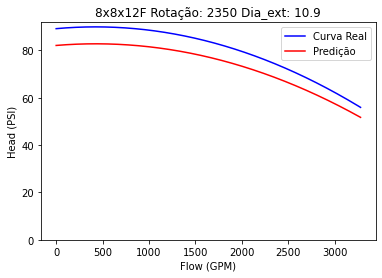

<Figure size 432x288 with 0 Axes>

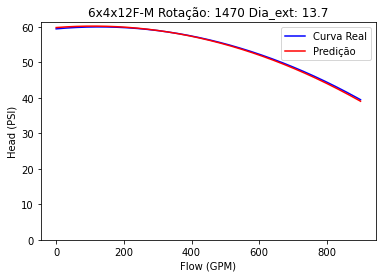

<Figure size 432x288 with 0 Axes>

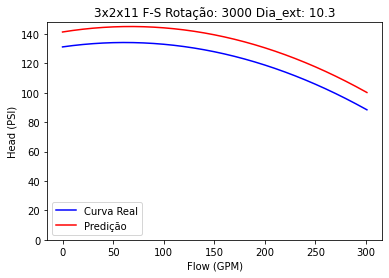

<Figure size 432x288 with 0 Axes>

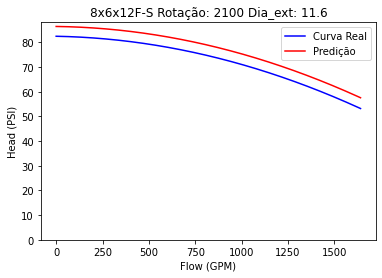

<Figure size 432x288 with 0 Axes>

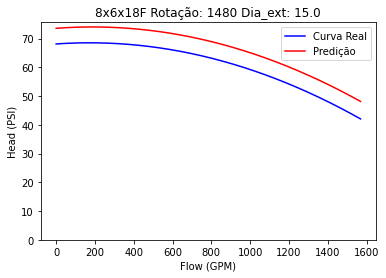

<Figure size 432x288 with 0 Axes>

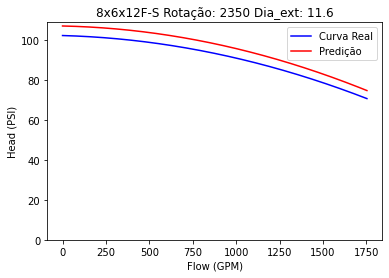

<Figure size 432x288 with 0 Axes>

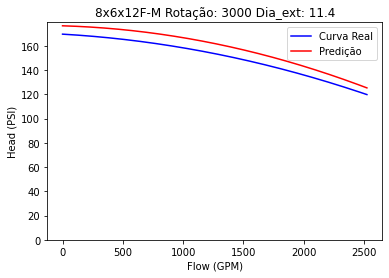

<Figure size 432x288 with 0 Axes>

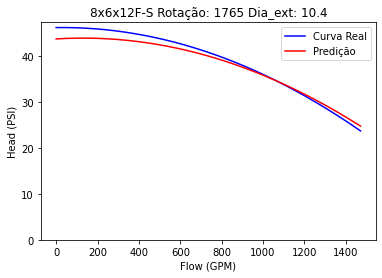

<Figure size 432x288 with 0 Axes>

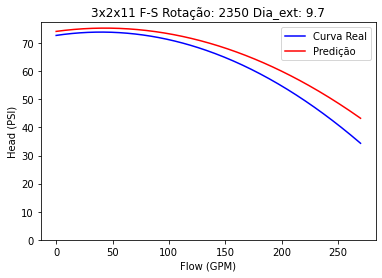

<Figure size 432x288 with 0 Axes>

In [108]:
dici_erro = {}
for indice in df_teste.index:
    eixo_x = []
    valor_real = []
    valor_previsto = []
    erro_abs = []
    erro_rel = []
    #print(X_test.loc[[i]]['Dia_externo'])
    ig, ax = plt.subplots()
    plt.ylabel('Head (PSI)')
    plt.xlabel('Flow (GPM)')
    #plt.title(dici[chave][2][-1]+', rotação: '+str(dici[chave][2][0])+' rpm, diâmetro externo: '+str(dici[chave][2][1])+' inches')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1'][indice],df_teste.loc[[indice]]['a2'][indice],df_teste.loc[[indice]]['a3'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='blue',label = 'Curva Real')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1p'][indice],df_teste.loc[[indice]]['a2p'][indice],df_teste.loc[[indice]]['a3p'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='red',label='Predição')
    plt.title(str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Modelo)+' Rotação: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Rotacao)+' Dia_ext: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Dia_externo))
    ax.set_ylim(bottom=0)
    plt.legend()
    plt.show()
    plt.clf()
        
    for valor in np.linspace(0,df_teste.loc[[indice]]['xn'][indice],5):
        valor = int(valor)
        eixo_x.append(valor)
        valor_real.append(df_teste.loc[[indice]]['a1'][indice] + df_teste.loc[[indice]]['a2'][indice]*valor + df_teste.loc[[indice]]['a3'][indice]*valor**2)
        valor_previsto.append(df_teste.loc[[indice]]['a1p'][indice] + df_teste.loc[[indice]]['a2p'][indice]*valor + df_teste.loc[[indice]]['a3p'][indice]*valor**2)
        erro_abs.append(valor_previsto[-1] - valor_real[-1])
        erro_rel.append(erro_abs[-1]/valor_real[-1])
    dici_erro[str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Modelo)+' Rotação: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Rotacao)+' Dia_ext: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Dia_externo)] = \
    [eixo_x,valor_real,valor_previsto,erro_abs,erro_rel]

In [109]:
df_erro = pd.DataFrame.from_dict(dici_erro).T
df_erro.to_excel('df_erro_XGBoost.xlsx')

# Hyperparameter Tuning

In [18]:
X = df_bombas[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y = df_bombas['a1']

In [19]:
X_train1, X_test1, y_train1, y_test1 = train_test_split(X, y, test_size=0.2, random_state=42)

In [127]:
# Create the random grid
random_grid = {'n_estimators': [100,200,300,500],
               'learning_rate': [0.01,0.05,0.1,0.3],
               'colsample_bytree': [0.5,0.75,1],
               'subsample': [0.6,1],
              'max_depth' : [3,5,7,10]}

xgboost = XGBRegressor(random_state = 42)

xgb_random = GridSearchCV(estimator = xgboost, param_grid = random_grid, scoring = 'r2', cv=5,n_jobs = -1)

xgb_random.fit(X_train1, y_train1)

GridSearchCV(cv=5,
             estimator=XGBRegressor(base_score=None, booster=None,
                                    colsample_bylevel=None,
                                    colsample_bynode=None,
                                    colsample_bytree=None,
                                    enable_categorical=False, gamma=None,
                                    gpu_id=None, importance_type=None,
                                    interaction_constraints=None,
                                    learning_rate=None, max_delta_step=None,
                                    max_depth=None, min_child_weight=None,
                                    missing=nan, monotone_constraints=None,
                                    n...
                                    num_parallel_tree=None, predictor=None,
                                    random_state=42, reg_alpha=None,
                                    reg_lambda=None, scale_pos_weight=None,
                                   

In [128]:
xgb_random.best_params_

{'colsample_bytree': 1,
 'learning_rate': 0.1,
 'max_depth': 3,
 'n_estimators': 300,
 'subsample': 1}

In [23]:
xgb_random = XGBRegressor(random_state = 42, colsample_bytree = 1, learning_rate = 0.1, max_depth = 3, n_estimators = 300, subsample = 1)
xgb_random.fit(X_train1,y_train1)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.1, max_delta_step=0,
             max_depth=3, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=300, n_jobs=8,
             num_parallel_tree=1, predictor='auto', random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [24]:
y_pred1 = xgb_random.predict(X_test1)

In [25]:
mean_absolute_error(y_test1,y_pred1)

5.272372307395537

In [26]:
xgb_random.score(X_test1,y_test1)

0.9654052955194421

In [27]:
xgb_random.score(X_train1,y_train1)

0.9922587557870405

## a2

In [134]:
X = df_bombas[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y = df_bombas['a2']

In [135]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(X, y, test_size=0.2, random_state=42)

In [136]:
# Create the random grid
random_grid = {'n_estimators': [100,200,300,500],
               'learning_rate': [0.01,0.05,0.1,0.3],
               'colsample_bytree': [0.5,0.75,1],
               'subsample': [0.6,1],
              'max_depth' : [3,5,7,10]}

xgboost = XGBRegressor(random_state = 42)

xgb_random = GridSearchCV(estimator = xgboost, param_grid = random_grid, scoring = 'r2', cv=5,n_jobs = -1)

xgb_random.fit(X_train2, y_train2)

GridSearchCV(cv=5,
             estimator=XGBRegressor(base_score=None, booster=None,
                                    colsample_bylevel=None,
                                    colsample_bynode=None,
                                    colsample_bytree=None,
                                    enable_categorical=False, gamma=None,
                                    gpu_id=None, importance_type=None,
                                    interaction_constraints=None,
                                    learning_rate=None, max_delta_step=None,
                                    max_depth=None, min_child_weight=None,
                                    missing=nan, monotone_constraints=None,
                                    n...
                                    num_parallel_tree=None, predictor=None,
                                    random_state=42, reg_alpha=None,
                                    reg_lambda=None, scale_pos_weight=None,
                                   

In [137]:
xgb_random.best_params_

{'colsample_bytree': 0.75,
 'learning_rate': 0.3,
 'max_depth': 10,
 'n_estimators': 200,
 'subsample': 0.6}

In [138]:
y_pred2 = xgb_random.predict(X_test2)

In [139]:
mean_absolute_error(y_test2,y_pred2)

0.00288069310843702

In [140]:
xgb_random.score(X_test2,y_test2)

0.9722716978283767

In [141]:
xgb_random.score(X_train2,y_train2)

0.9994014665523575

## a3

In [142]:
X = df_bombas[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y = df_bombas['a3']
scaler = StandardScaler()
y = scaler.fit_transform(np.array(y).reshape(-1,1))

In [143]:
X_train3, X_test3, y_train3, y_test3 = train_test_split(X, y, test_size=0.2, random_state=42)

In [144]:
# Create the random grid
random_grid = {'n_estimators': [100,200,300,500],
               'learning_rate': [0.01,0.05,0.1,0.3],
               'colsample_bytree': [0.5,0.75,1],
               'subsample': [0.6,1],
              'max_depth' : [3,5,7,10]}

xgboost = XGBRegressor(random_state = 42)

xgb_random = GridSearchCV(estimator = xgboost, param_grid = random_grid, scoring = 'r2', cv=5,n_jobs = -1)

xgb_random.fit(X_train3, y_train3)

GridSearchCV(cv=5,
             estimator=XGBRegressor(base_score=None, booster=None,
                                    colsample_bylevel=None,
                                    colsample_bynode=None,
                                    colsample_bytree=None,
                                    enable_categorical=False, gamma=None,
                                    gpu_id=None, importance_type=None,
                                    interaction_constraints=None,
                                    learning_rate=None, max_delta_step=None,
                                    max_depth=None, min_child_weight=None,
                                    missing=nan, monotone_constraints=None,
                                    n...
                                    num_parallel_tree=None, predictor=None,
                                    random_state=42, reg_alpha=None,
                                    reg_lambda=None, scale_pos_weight=None,
                                   

In [145]:
xgb_random.best_params_

{'colsample_bytree': 0.5,
 'learning_rate': 0.05,
 'max_depth': 3,
 'n_estimators': 100,
 'subsample': 0.6}

In [146]:
y_pred3 = xgb_random.predict(X_test3)

In [147]:
mean_absolute_error(y_test3,y_pred3)

0.022706832104757387

In [148]:
xgb_random.score(X_test3,y_test3)

0.9986317121736465

In [149]:
xgb_random.score(X_train3,y_train3)

0.9919368175118941

In [150]:
y_test31 = scaler.inverse_transform(y_test3)
y_pred31 = scaler.inverse_transform(y_pred3.reshape(-1,1))

In [151]:
mean_absolute_error(y_test31,y_pred31)

5.480339346738683e-06

## Diferença nas curvas

In [152]:
df_teste = X_test1
df_teste['a1'] = y_test1
df_teste['a2'] = y_test2
df_teste['a3'] = y_test31
df_teste['xn'] = y_test4
df_teste['a1p'] = y_pred1
df_teste['a2p'] = y_pred2
df_teste['a3p'] = y_pred31

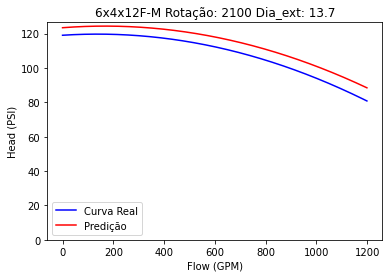

<Figure size 432x288 with 0 Axes>

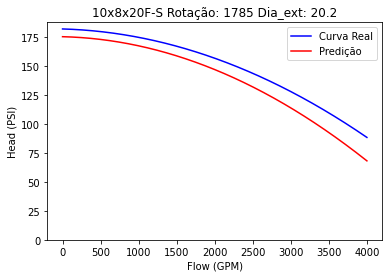

<Figure size 432x288 with 0 Axes>

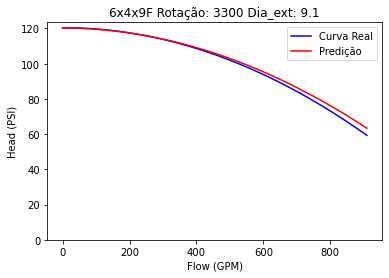

<Figure size 432x288 with 0 Axes>

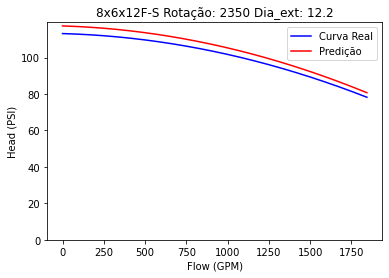

<Figure size 432x288 with 0 Axes>

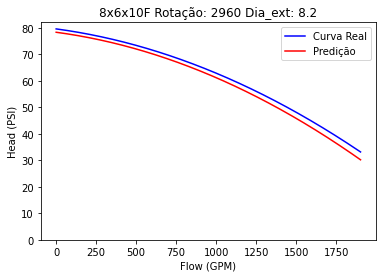

<Figure size 432x288 with 0 Axes>

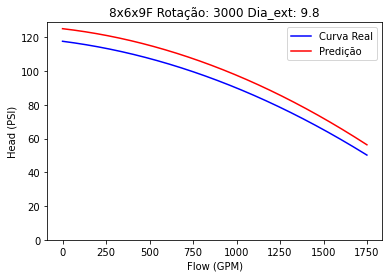

<Figure size 432x288 with 0 Axes>

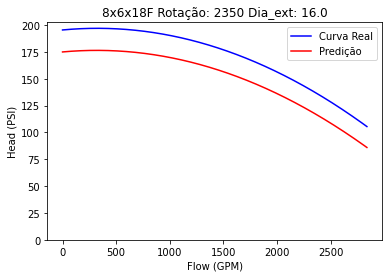

<Figure size 432x288 with 0 Axes>

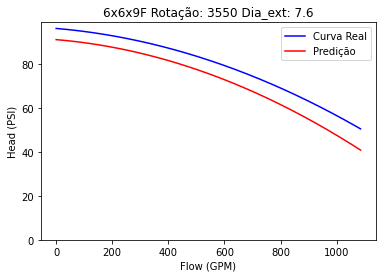

<Figure size 432x288 with 0 Axes>

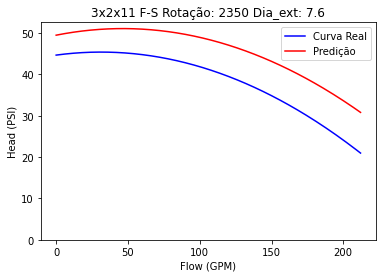

<Figure size 432x288 with 0 Axes>

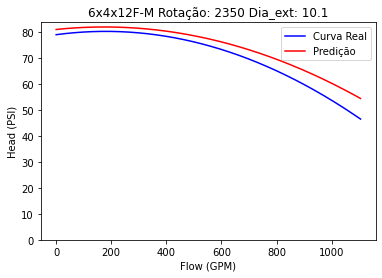

<Figure size 432x288 with 0 Axes>

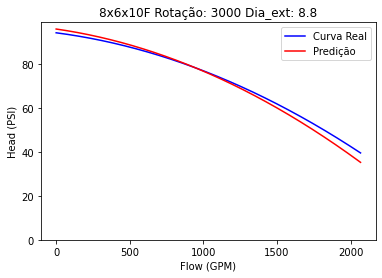

<Figure size 432x288 with 0 Axes>

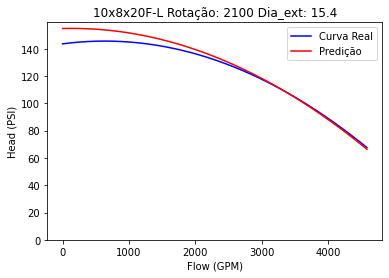

<Figure size 432x288 with 0 Axes>

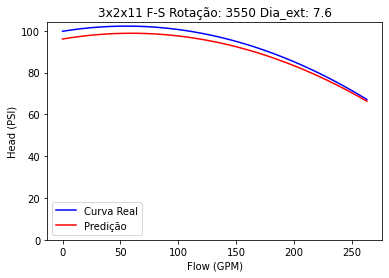

<Figure size 432x288 with 0 Axes>

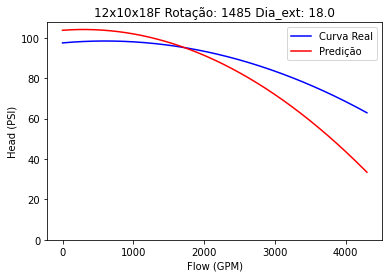

<Figure size 432x288 with 0 Axes>

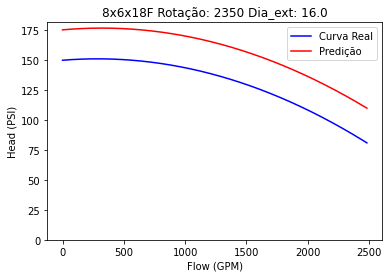

<Figure size 432x288 with 0 Axes>

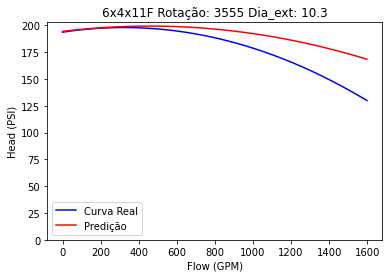

<Figure size 432x288 with 0 Axes>

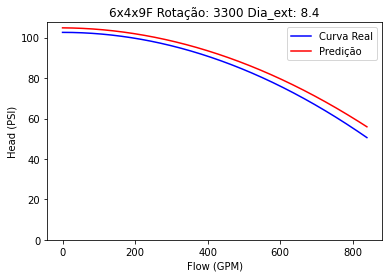

<Figure size 432x288 with 0 Axes>

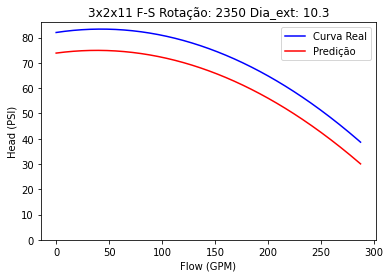

<Figure size 432x288 with 0 Axes>

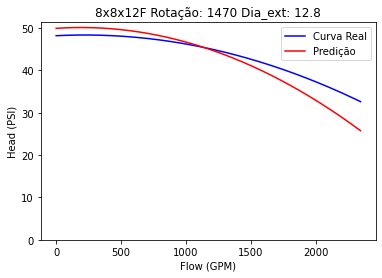

<Figure size 432x288 with 0 Axes>

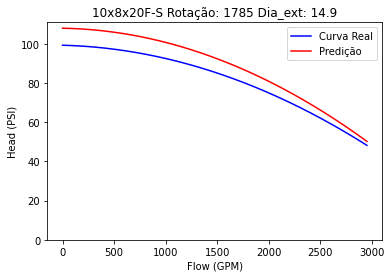

<Figure size 432x288 with 0 Axes>

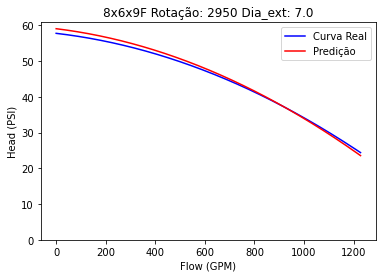

<Figure size 432x288 with 0 Axes>

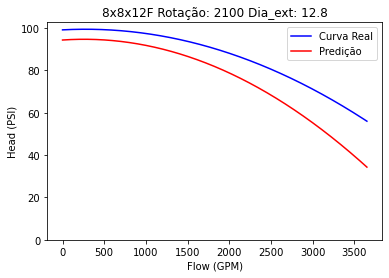

<Figure size 432x288 with 0 Axes>

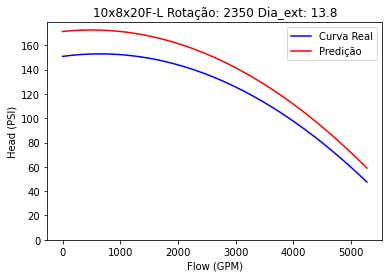

<Figure size 432x288 with 0 Axes>

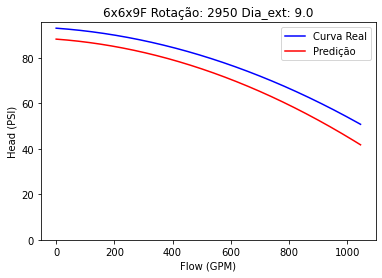

<Figure size 432x288 with 0 Axes>

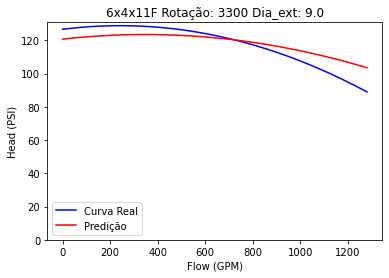

<Figure size 432x288 with 0 Axes>

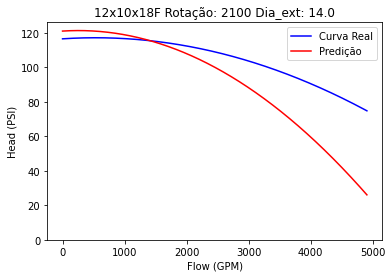

<Figure size 432x288 with 0 Axes>

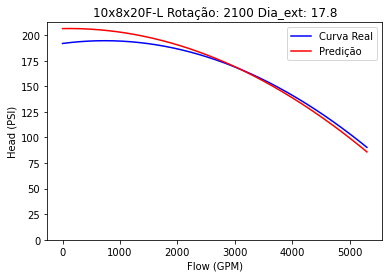

<Figure size 432x288 with 0 Axes>

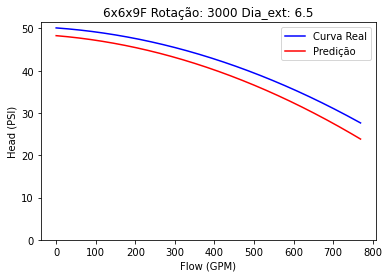

<Figure size 432x288 with 0 Axes>

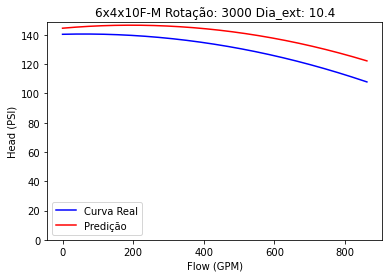

<Figure size 432x288 with 0 Axes>

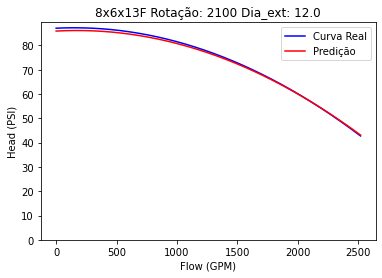

<Figure size 432x288 with 0 Axes>

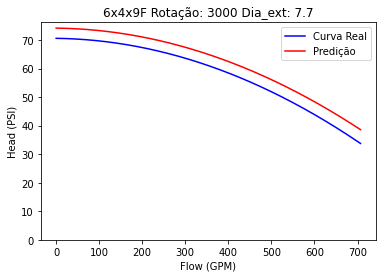

<Figure size 432x288 with 0 Axes>

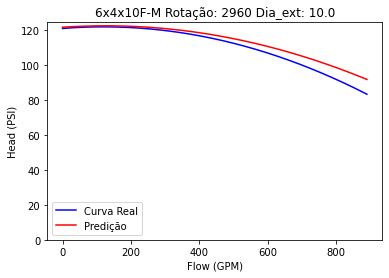

<Figure size 432x288 with 0 Axes>

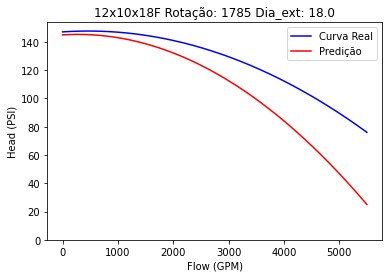

<Figure size 432x288 with 0 Axes>

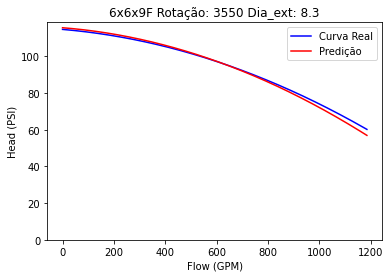

<Figure size 432x288 with 0 Axes>

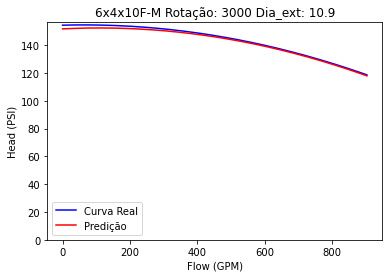

<Figure size 432x288 with 0 Axes>

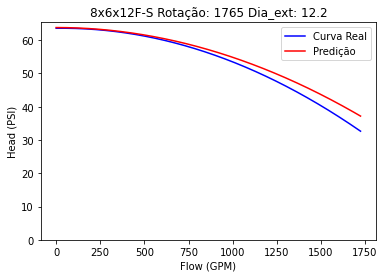

<Figure size 432x288 with 0 Axes>

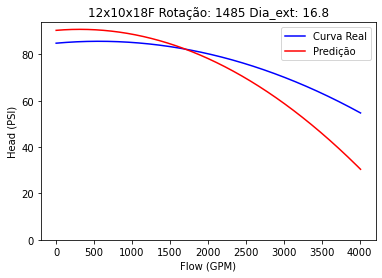

<Figure size 432x288 with 0 Axes>

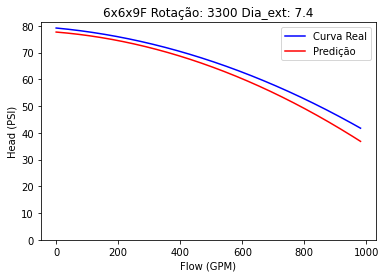

<Figure size 432x288 with 0 Axes>

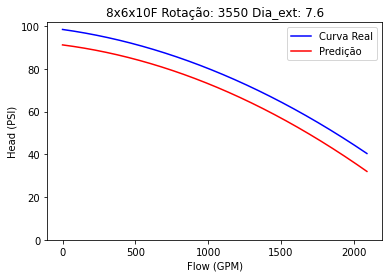

<Figure size 432x288 with 0 Axes>

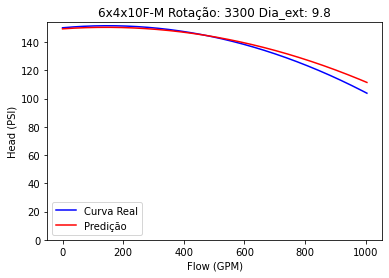

<Figure size 432x288 with 0 Axes>

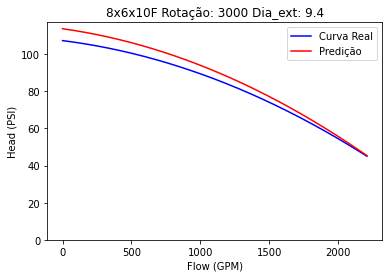

<Figure size 432x288 with 0 Axes>

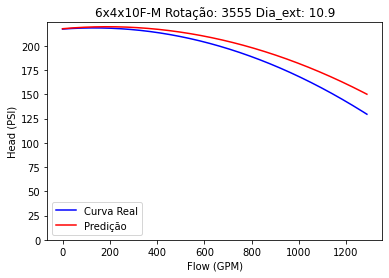

<Figure size 432x288 with 0 Axes>

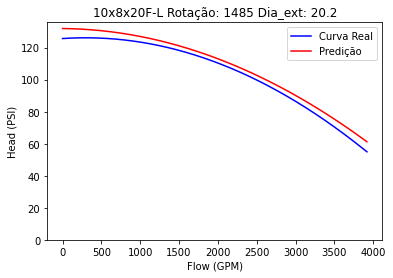

<Figure size 432x288 with 0 Axes>

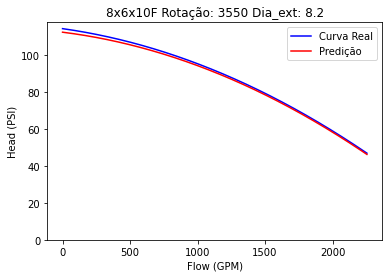

<Figure size 432x288 with 0 Axes>

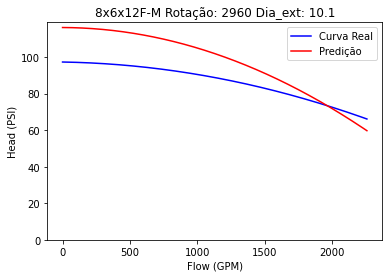

<Figure size 432x288 with 0 Axes>

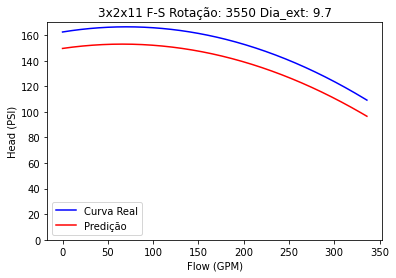

<Figure size 432x288 with 0 Axes>

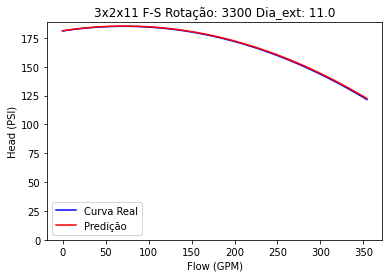

<Figure size 432x288 with 0 Axes>

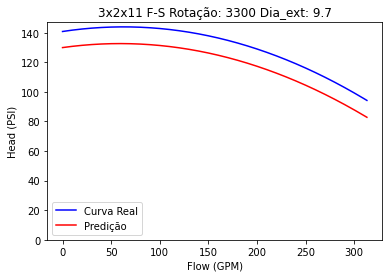

<Figure size 432x288 with 0 Axes>

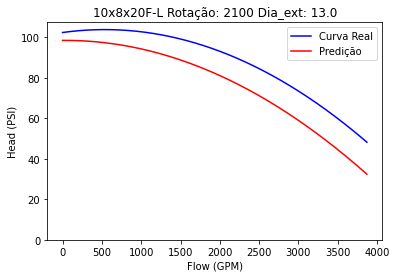

<Figure size 432x288 with 0 Axes>

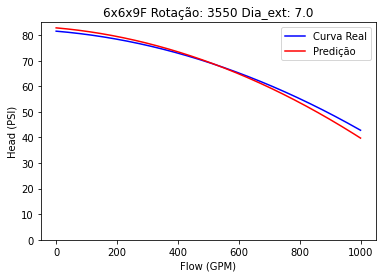

<Figure size 432x288 with 0 Axes>

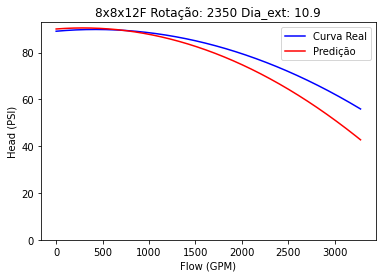

<Figure size 432x288 with 0 Axes>

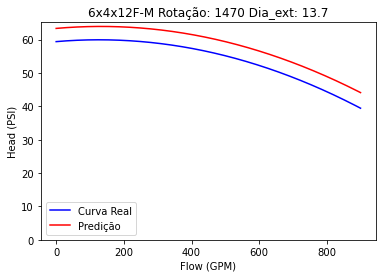

<Figure size 432x288 with 0 Axes>

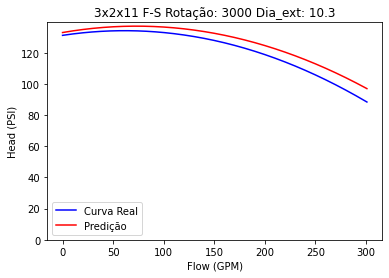

<Figure size 432x288 with 0 Axes>

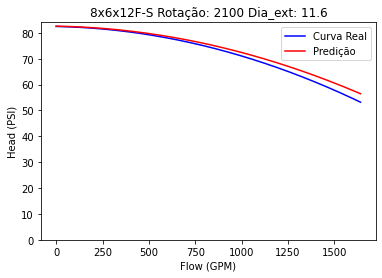

<Figure size 432x288 with 0 Axes>

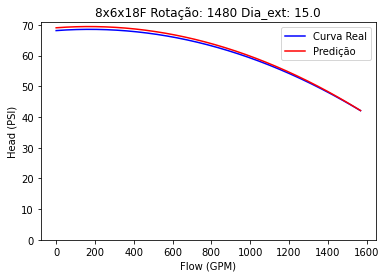

<Figure size 432x288 with 0 Axes>

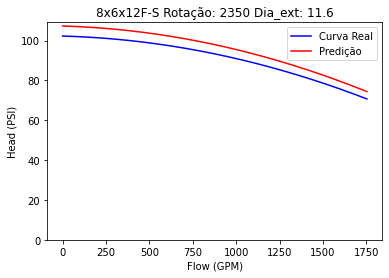

<Figure size 432x288 with 0 Axes>

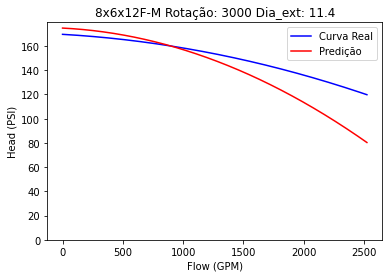

<Figure size 432x288 with 0 Axes>

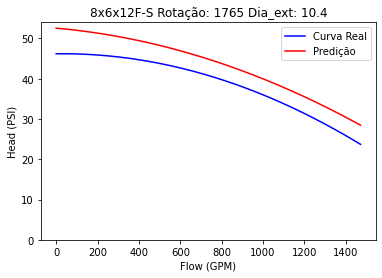

<Figure size 432x288 with 0 Axes>

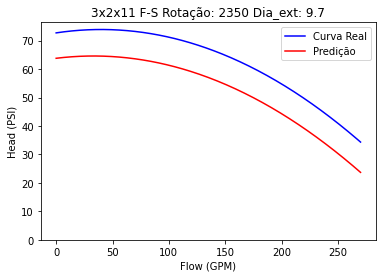

<Figure size 432x288 with 0 Axes>

In [153]:
dici_erro = {}
for indice in df_teste.index:
    eixo_x = []
    valor_real = []
    valor_previsto = []
    erro_abs = []
    erro_rel = []
    #print(X_test.loc[[i]]['Dia_externo'])
    ig, ax = plt.subplots()
    plt.ylabel('Head (PSI)')
    plt.xlabel('Flow (GPM)')
    #plt.title(dici[chave][2][-1]+', rotação: '+str(dici[chave][2][0])+' rpm, diâmetro externo: '+str(dici[chave][2][1])+' inches')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1'][indice],df_teste.loc[[indice]]['a2'][indice],df_teste.loc[[indice]]['a3'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='blue',label = 'Curva Real')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1p'][indice],df_teste.loc[[indice]]['a2p'][indice],df_teste.loc[[indice]]['a3p'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='red',label='Predição')
    plt.title(str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Modelo)+' Rotação: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Rotacao)+' Dia_ext: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Dia_externo))
    ax.set_ylim(bottom=0)
    plt.legend()
    plt.show()
    plt.clf()
        
    for valor in np.linspace(0,df_teste.loc[[indice]]['xn'][indice],5):
        valor = int(valor)
        eixo_x.append(valor)
        valor_real.append(df_teste.loc[[indice]]['a1'][indice] + df_teste.loc[[indice]]['a2'][indice]*valor + df_teste.loc[[indice]]['a3'][indice]*valor**2)
        valor_previsto.append(df_teste.loc[[indice]]['a1p'][indice] + df_teste.loc[[indice]]['a2p'][indice]*valor + df_teste.loc[[indice]]['a3p'][indice]*valor**2)
        erro_abs.append(valor_previsto[-1] - valor_real[-1])
        erro_rel.append(erro_abs[-1]/valor_real[-1])
    dici_erro[str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Modelo)+' Rotação: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Rotacao)+' Dia_ext: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Dia_externo)] = \
    [eixo_x,valor_real,valor_previsto,erro_abs,erro_rel]

In [154]:
df_erro = pd.DataFrame.from_dict(dici_erro).T
df_erro.to_excel('df_erro_XGBoost_Hyper_Tuning.xlsx')

# Separando uma bomba para teste

# XGBoost

In [181]:
y = df_bombas['a3']
scaler = StandardScaler()
y = scaler.fit_transform(np.array(y).reshape(-1,1))
df_bombas['a3_scaled'] = y

In [182]:
df_teste = df_bombas[df_bombas.Modelo.isin(['8x6x10F'])]
df_train = df_bombas[~df_bombas.Modelo.isin(['8x6x10F'])]

## a1

In [183]:
X_train1 = df_train[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_train1 = df_train['a1']

X_test1 = df_teste[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_test1 = df_teste['a1']

In [186]:
xgboost.fit(X_train1,y_train1)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.300000012,
             max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=100, n_jobs=8,
             num_parallel_tree=1, predictor='auto', random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [187]:
y_pred1 = xgboost.predict(X_test1)
mean_absolute_error(y_test1,y_pred1)

6.17542215470036

In [188]:
xgboost.score(X_test1,y_test1)

0.8729815902942328

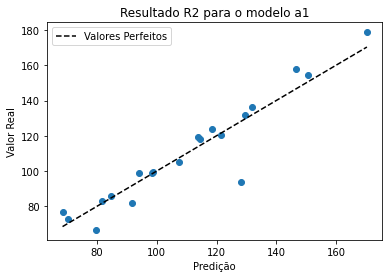

In [189]:
plt.title('Resultado R2 para o modelo a1')
plt.plot(y_test1,y_pred1,'o')
plt.plot([y_test1.min(),y_test1.max()],[y_test1.min(),y_test1.max()],'--k',label = 'Valores Perfeitos')
plt.xlabel('Predição')
plt.ylabel('Valor Real')
plt.legend()

## a2

In [256]:
X_train2 = df_train[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_train2 = df_train['a2']

X_test2 = df_teste[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_test2 = df_teste['a2']

In [257]:
xgboost.fit(X_train2,y_train2)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.300000012,
             max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=100, n_jobs=8,
             num_parallel_tree=1, predictor='auto', random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [258]:
y_pred2 = xgboost.predict(X_test2)
mean_absolute_error(y_test2,y_pred2)

0.0019028792675497056

In [259]:
xgboost.score(X_test2,y_test2)

-3.035288603495699

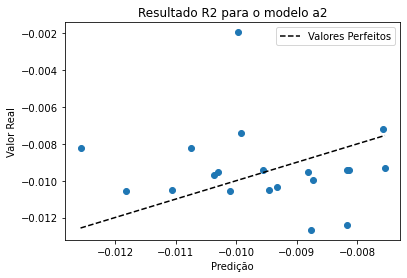

In [260]:
plt.title('Resultado R2 para o modelo a2')
plt.plot(y_test2,y_pred2,'o')
plt.plot([y_test2.min(),y_test2.max()],[y_test2.min(),y_test2.max()],'--k',label = 'Valores Perfeitos')
plt.xlabel('Predição')
plt.ylabel('Valor Real')
plt.legend()

## a3

In [195]:
X_train3 = df_train[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_train3 = df_train['a3_scaled']

X_test3 = df_teste[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_test3 = df_teste['a3_scaled']

In [196]:
xgboost.fit(X_train3,y_train3)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.300000012,
             max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=100, n_jobs=8,
             num_parallel_tree=1, predictor='auto', random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [198]:
y_pred3 = xgboost.predict(X_test3)
mean_absolute_error(y_test3,y_pred3)

0.02782054332084848

In [199]:
xgboost.score(X_test3,y_test3)

-2424.0163485726907

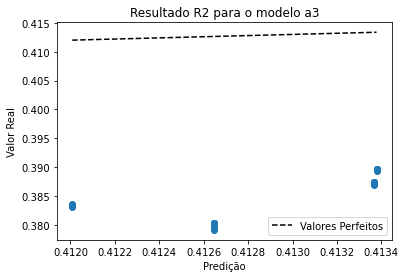

In [200]:
plt.title('Resultado R2 para o modelo a3')
plt.plot(y_test3,y_pred3,'o')
plt.plot([y_test3.min(),y_test3.max()],[y_test3.min(),y_test3.max()],'--k',label = 'Valores Perfeitos')
plt.xlabel('Predição')
plt.ylabel('Valor Real')
plt.legend()

In [203]:
y_test31 = scaler.inverse_transform(np.array(y_test3).reshape(-1,1))
y_pred31 = scaler.inverse_transform(y_pred3.reshape(-1,1))

## Adicionando xn

In [204]:
X_test4 = df_teste[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_test4 = df_teste['xn']

In [205]:
df_teste = X_test1
df_teste['a1'] = y_test1
df_teste['a2'] = y_test2
df_teste['a3'] = y_test31
df_teste['xn'] = y_test4
df_teste['a1p'] = y_pred1
df_teste['a2p'] = y_pred2
df_teste['a3p'] = y_pred31

C:\Users\evert\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\evert\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
C:\Users\evert\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = v

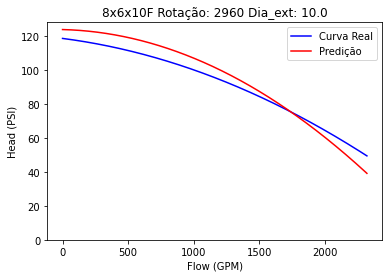

<Figure size 432x288 with 0 Axes>

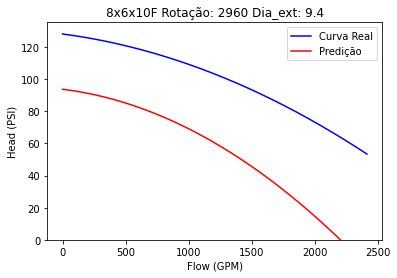

<Figure size 432x288 with 0 Axes>

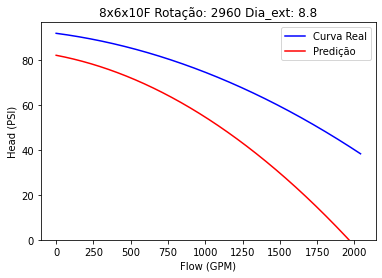

<Figure size 432x288 with 0 Axes>

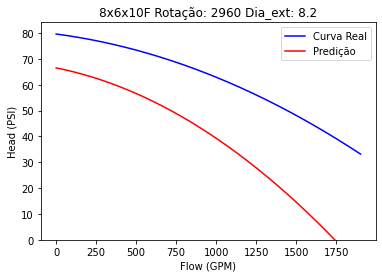

<Figure size 432x288 with 0 Axes>

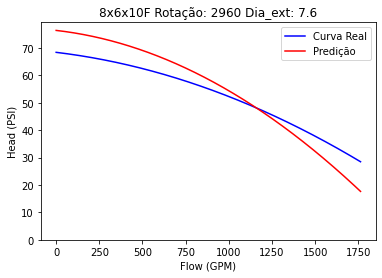

<Figure size 432x288 with 0 Axes>

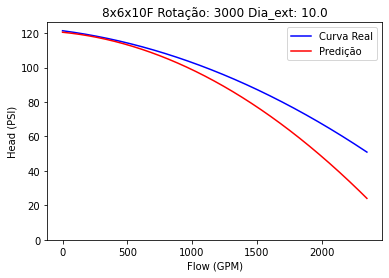

<Figure size 432x288 with 0 Axes>

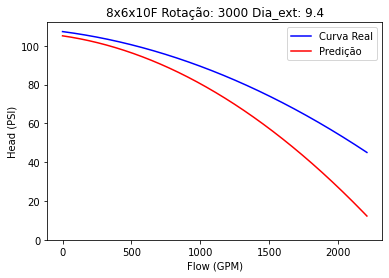

<Figure size 432x288 with 0 Axes>

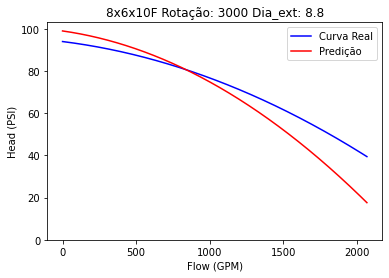

<Figure size 432x288 with 0 Axes>

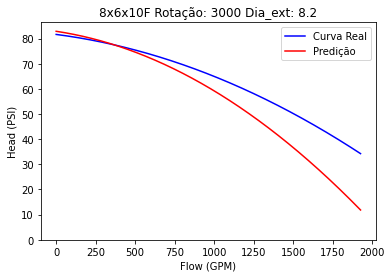

<Figure size 432x288 with 0 Axes>

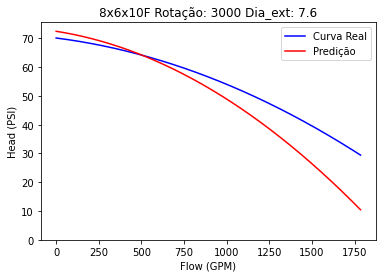

<Figure size 432x288 with 0 Axes>

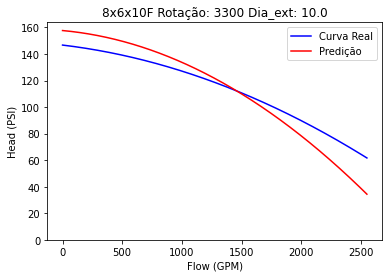

<Figure size 432x288 with 0 Axes>

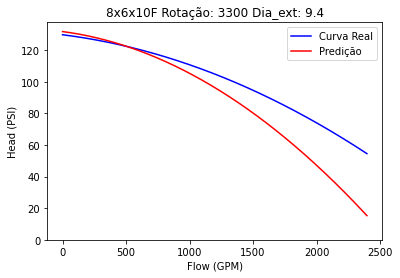

<Figure size 432x288 with 0 Axes>

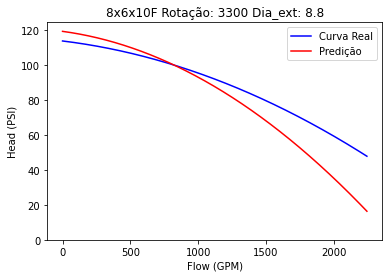

<Figure size 432x288 with 0 Axes>

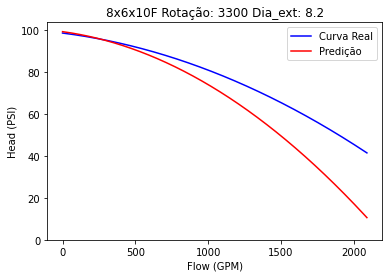

<Figure size 432x288 with 0 Axes>

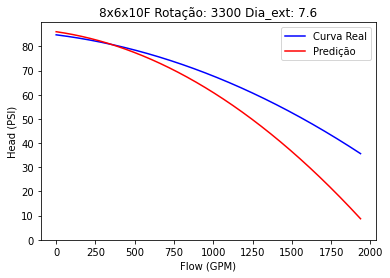

<Figure size 432x288 with 0 Axes>

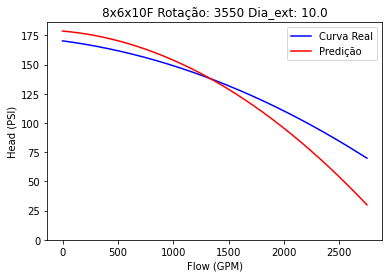

<Figure size 432x288 with 0 Axes>

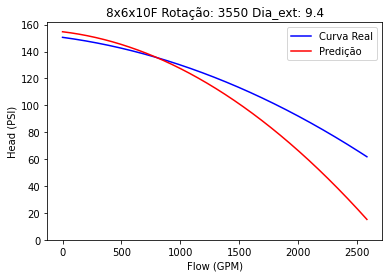

<Figure size 432x288 with 0 Axes>

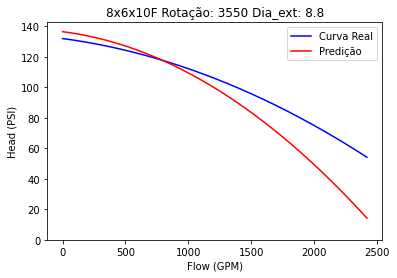

<Figure size 432x288 with 0 Axes>

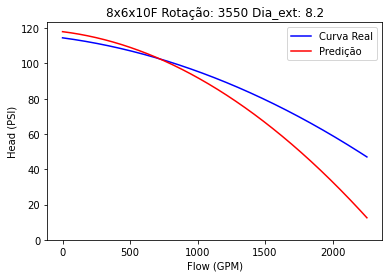

<Figure size 432x288 with 0 Axes>

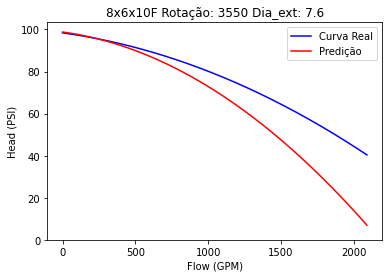

<Figure size 432x288 with 0 Axes>

In [206]:
dici_erro = {}
for indice in df_teste.index:
    eixo_x = []
    valor_real = []
    valor_previsto = []
    erro_abs = []
    erro_rel = []
    #print(X_test.loc[[i]]['Dia_externo'])
    ig, ax = plt.subplots()
    plt.ylabel('Head (PSI)')
    plt.xlabel('Flow (GPM)')
    #plt.title(dici[chave][2][-1]+', rotação: '+str(dici[chave][2][0])+' rpm, diâmetro externo: '+str(dici[chave][2][1])+' inches')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1'][indice],df_teste.loc[[indice]]['a2'][indice],df_teste.loc[[indice]]['a3'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='blue',label = 'Curva Real')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1p'][indice],df_teste.loc[[indice]]['a2p'][indice],df_teste.loc[[indice]]['a3p'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='red',label='Predição')
    plt.title(str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Modelo)+' Rotação: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Rotacao)+' Dia_ext: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Dia_externo))
    ax.set_ylim(bottom=0)
    plt.legend()
    plt.show()
    plt.clf()
        
    for valor in np.linspace(0,df_teste.loc[[indice]]['xn'][indice],5):
        valor = int(valor)
        eixo_x.append(valor)
        valor_real.append(df_teste.loc[[indice]]['a1'][indice] + df_teste.loc[[indice]]['a2'][indice]*valor + df_teste.loc[[indice]]['a3'][indice]*valor**2)
        valor_previsto.append(df_teste.loc[[indice]]['a1p'][indice] + df_teste.loc[[indice]]['a2p'][indice]*valor + df_teste.loc[[indice]]['a3p'][indice]*valor**2)
        erro_abs.append(valor_previsto[-1] - valor_real[-1])
        erro_rel.append(erro_abs[-1]/valor_real[-1])
    dici_erro[str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Modelo)+' Rotação: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Rotacao)+' Dia_ext: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Dia_externo)] = \
    [eixo_x,valor_real,valor_previsto,erro_abs,erro_rel]

# Xgboost: Tuned

In [249]:
y = df_bombas['a3']
scaler = StandardScaler()
y = scaler.fit_transform(np.array(y).reshape(-1,1))
df_bombas['a3_scaled'] = y

In [250]:
df_teste = df_bombas[df_bombas.Modelo.isin(['8x6x10F'])]
df_train = df_bombas[~df_bombas.Modelo.isin(['8x6x10F'])]

## a1

In [251]:
X_train1 = df_train[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_train1 = df_train['a1']

X_test1 = df_teste[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_test1 = df_teste['a1']

In [252]:
xgb_random = XGBRegressor(random_state = 42, colsample_bytree = 1, learning_rate = 0.1, max_depth = 3, n_estimators = 300, subsample = 1)
xgb_random.fit(X_train1,y_train1)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.1, max_delta_step=0,
             max_depth=3, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=300, n_jobs=8,
             num_parallel_tree=1, predictor='auto', random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [253]:
y_pred1 = xgb_random.predict(X_test1)
mean_absolute_error(y_test1,y_pred1)

4.090745685126827

In [254]:
xgb_random.score(X_test1,y_test1)

0.938716780959535

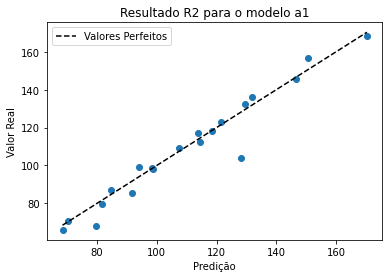

In [255]:
plt.title('Resultado R2 para o modelo a1')
plt.plot(y_test1,y_pred1,'o')
plt.plot([y_test1.min(),y_test1.max()],[y_test1.min(),y_test1.max()],'--k',label = 'Valores Perfeitos')
plt.xlabel('Predição')
plt.ylabel('Valor Real')
plt.legend()

## a2

In [235]:
X_train2 = df_train[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_train2 = df_train['a2']

X_test2 = df_teste[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_test2 = df_teste['a2']

In [236]:
xgb_random = XGBRegressor(random_state = 42, colsample_bytree = 0.75, learning_rate = 0.3, max_depth = 10, n_estimators = 200, subsample = 0.6)
xgb_random.fit(X_train2,y_train2)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=0.75,
             enable_categorical=False, gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.3, max_delta_step=0,
             max_depth=10, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=200, n_jobs=8,
             num_parallel_tree=1, predictor='auto', random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=0.6,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [237]:
y_pred2 = xgb_random.predict(X_test2)
mean_absolute_error(y_test2,y_pred2)

0.0013639323576439706

In [238]:
xgb_random.score(X_test2,y_test2)

-0.7447987904755868

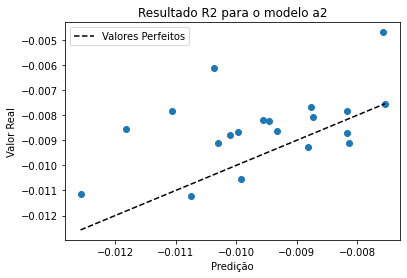

In [239]:
plt.title('Resultado R2 para o modelo a2')
plt.plot(y_test2,y_pred2,'o')
plt.plot([y_test2.min(),y_test2.max()],[y_test2.min(),y_test2.max()],'--k',label = 'Valores Perfeitos')
plt.xlabel('Predição')
plt.ylabel('Valor Real')
plt.legend()

## a3

In [240]:
X_train3 = df_train[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_train3 = df_train['a3_scaled']

X_test3 = df_teste[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_test3 = df_teste['a3_scaled']

In [241]:
xgb_random = XGBRegressor(random_state = 42, colsample_bytree = 0.5, learning_rate = 0.05, max_depth = 3, n_estimators = 100, subsample = 0.6)
xgb_random.fit(X_train3,y_train3)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=0.5, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.05, max_delta_step=0,
             max_depth=3, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=100, n_jobs=8,
             num_parallel_tree=1, predictor='auto', random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=0.6,
             tree_method='exact', validate_parameters=1, verbosity=None)

In [242]:
y_pred3 = xgb_random.predict(X_test3)
mean_absolute_error(y_test3,y_pred3)

0.05916517463512612

In [243]:
xgb_random.score(X_test3,y_test3)

-10819.403634339327

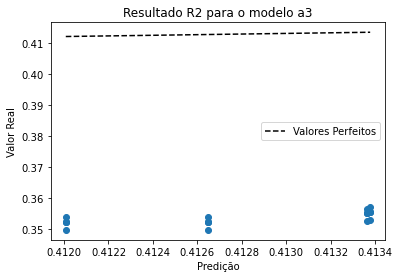

In [244]:
plt.title('Resultado R2 para o modelo a3')
plt.plot(y_test3,y_pred3,'o')
plt.plot([y_test3.min(),y_test3.max()],[y_test3.min(),y_test3.max()],'--k',label = 'Valores Perfeitos')
plt.xlabel('Predição')
plt.ylabel('Valor Real')
plt.legend()

In [245]:
y_test31 = scaler.inverse_transform(np.array(y_test3).reshape(-1,1))
y_pred31 = scaler.inverse_transform(y_pred3.reshape(-1,1))

## Adicionando xn

In [271]:
X_test4 = df_teste[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_test4 = df_teste['xn']

In [247]:
df_teste = X_test1
df_teste['a1'] = y_test1
df_teste['a2'] = y_test2
df_teste['a3'] = y_test31
df_teste['xn'] = y_test4
df_teste['a1p'] = y_pred1
df_teste['a2p'] = y_pred2
df_teste['a3p'] = y_pred31

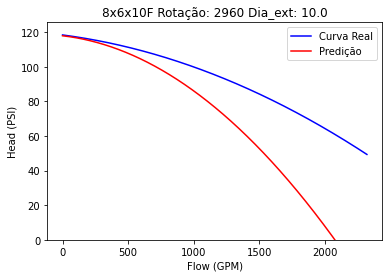

<Figure size 432x288 with 0 Axes>

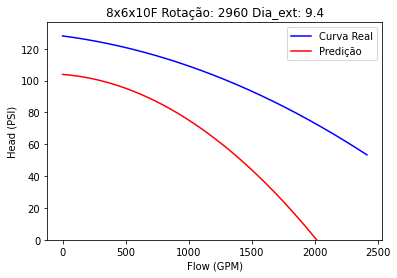

<Figure size 432x288 with 0 Axes>

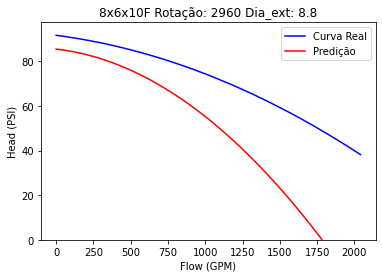

<Figure size 432x288 with 0 Axes>

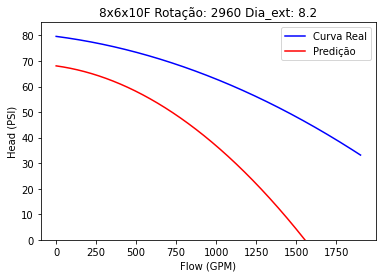

<Figure size 432x288 with 0 Axes>

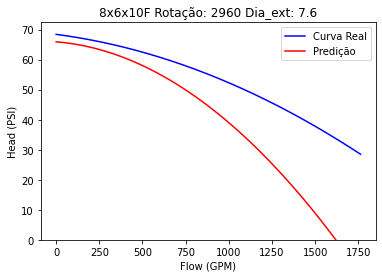

<Figure size 432x288 with 0 Axes>

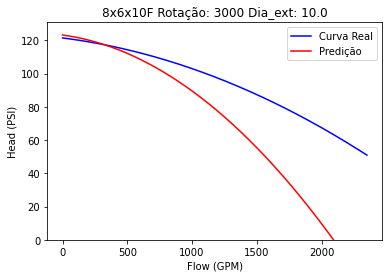

<Figure size 432x288 with 0 Axes>

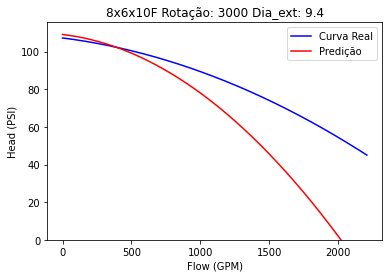

<Figure size 432x288 with 0 Axes>

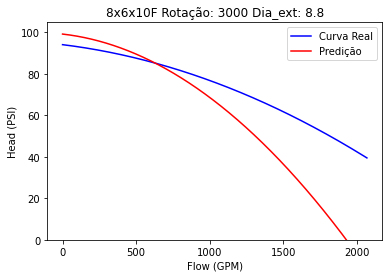

<Figure size 432x288 with 0 Axes>

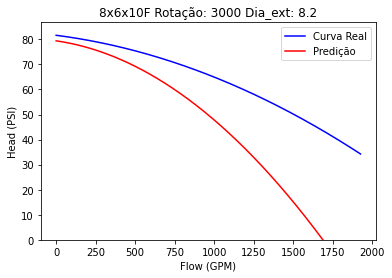

<Figure size 432x288 with 0 Axes>

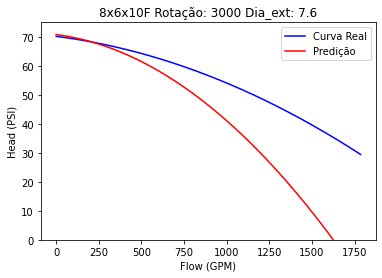

<Figure size 432x288 with 0 Axes>

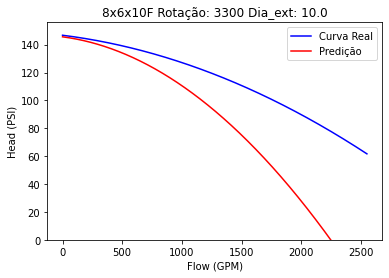

<Figure size 432x288 with 0 Axes>

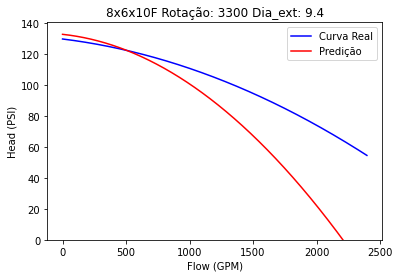

<Figure size 432x288 with 0 Axes>

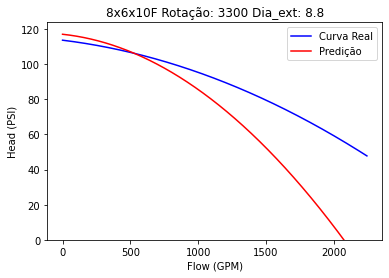

<Figure size 432x288 with 0 Axes>

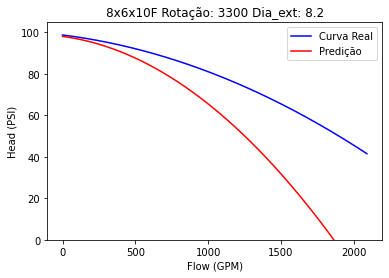

<Figure size 432x288 with 0 Axes>

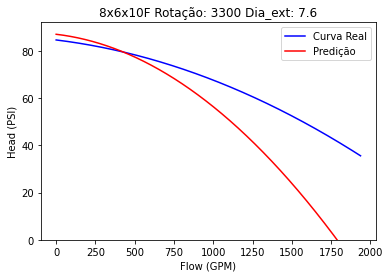

<Figure size 432x288 with 0 Axes>

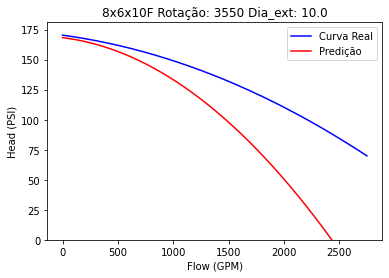

<Figure size 432x288 with 0 Axes>

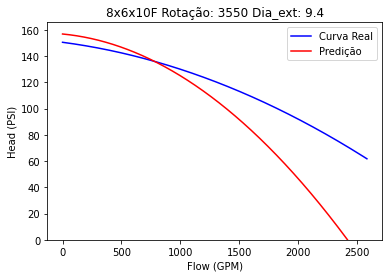

<Figure size 432x288 with 0 Axes>

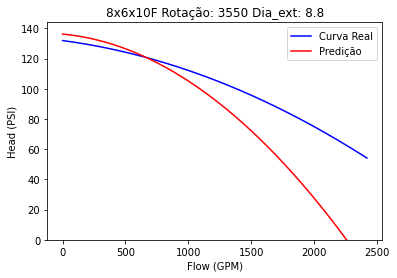

<Figure size 432x288 with 0 Axes>

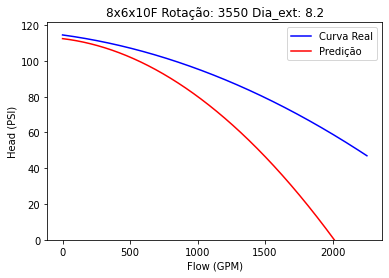

<Figure size 432x288 with 0 Axes>

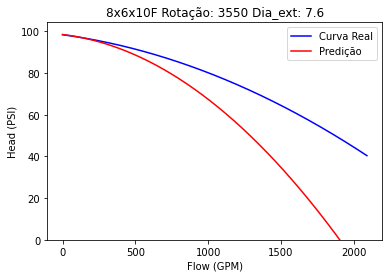

<Figure size 432x288 with 0 Axes>

In [248]:
dici_erro = {}
for indice in df_teste.index:
    eixo_x = []
    valor_real = []
    valor_previsto = []
    erro_abs = []
    erro_rel = []
    #print(X_test.loc[[i]]['Dia_externo'])
    ig, ax = plt.subplots()
    plt.ylabel('Head (PSI)')
    plt.xlabel('Flow (GPM)')
    #plt.title(dici[chave][2][-1]+', rotação: '+str(dici[chave][2][0])+' rpm, diâmetro externo: '+str(dici[chave][2][1])+' inches')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1'][indice],df_teste.loc[[indice]]['a2'][indice],df_teste.loc[[indice]]['a3'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='blue',label = 'Curva Real')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1p'][indice],df_teste.loc[[indice]]['a2p'][indice],df_teste.loc[[indice]]['a3p'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='red',label='Predição')
    plt.title(str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Modelo)+' Rotação: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Rotacao)+' Dia_ext: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Dia_externo))
    ax.set_ylim(bottom=0)
    plt.legend()
    plt.show()
    plt.clf()
        
    for valor in np.linspace(0,df_teste.loc[[indice]]['xn'][indice],5):
        valor = int(valor)
        eixo_x.append(valor)
        valor_real.append(df_teste.loc[[indice]]['a1'][indice] + df_teste.loc[[indice]]['a2'][indice]*valor + df_teste.loc[[indice]]['a3'][indice]*valor**2)
        valor_previsto.append(df_teste.loc[[indice]]['a1p'][indice] + df_teste.loc[[indice]]['a2p'][indice]*valor + df_teste.loc[[indice]]['a3p'][indice]*valor**2)
        erro_abs.append(valor_previsto[-1] - valor_real[-1])
        erro_rel.append(erro_abs[-1]/valor_real[-1])
    dici_erro[str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Modelo)+' Rotação: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Rotacao)+' Dia_ext: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Dia_externo)] = \
    [eixo_x,valor_real,valor_previsto,erro_abs,erro_rel]

# Melhores modelos

In [53]:
df_teste = X_test1
df_teste['a1'] = y_test1
df_teste['a2'] = y_test2
df_teste['a3'] = y_test31
df_teste['xn'] = y_test4
df_teste['a1p'] = y_pred1
df_teste['a2p'] = y_pred2
df_teste['a3p'] = y_pred31

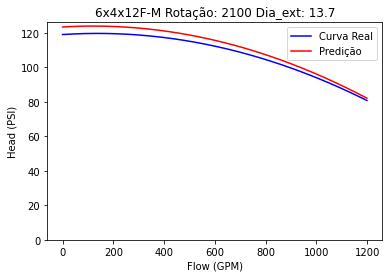

<Figure size 432x288 with 0 Axes>

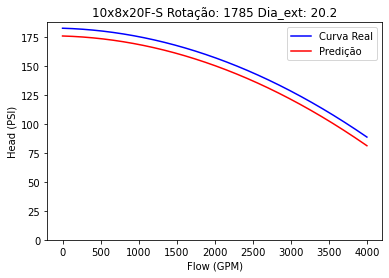

<Figure size 432x288 with 0 Axes>

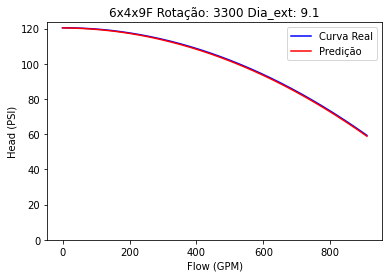

<Figure size 432x288 with 0 Axes>

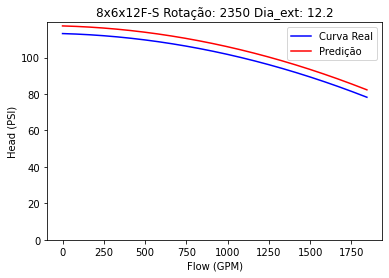

<Figure size 432x288 with 0 Axes>

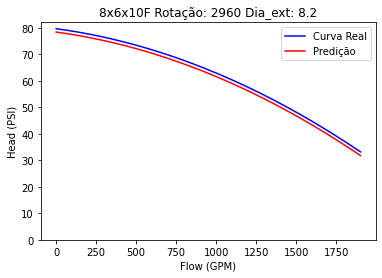

<Figure size 432x288 with 0 Axes>

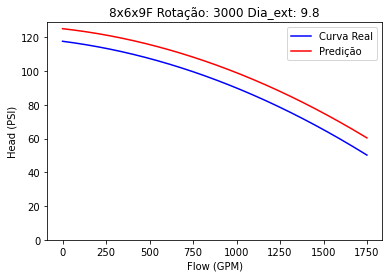

<Figure size 432x288 with 0 Axes>

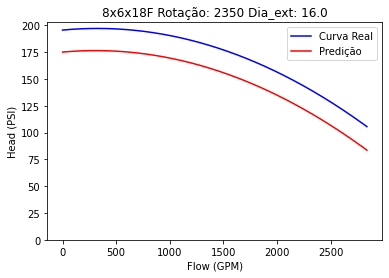

<Figure size 432x288 with 0 Axes>

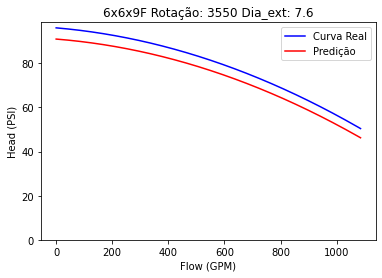

<Figure size 432x288 with 0 Axes>

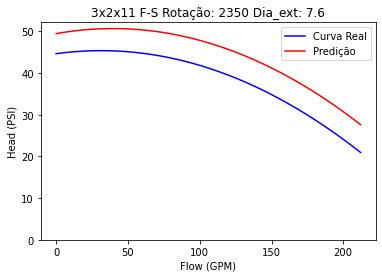

<Figure size 432x288 with 0 Axes>

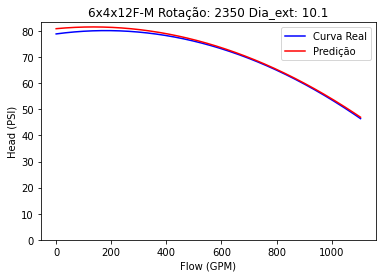

<Figure size 432x288 with 0 Axes>

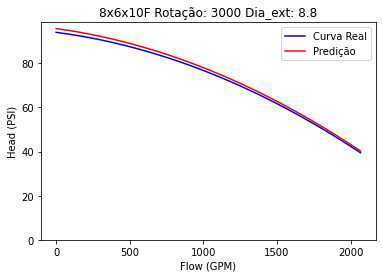

<Figure size 432x288 with 0 Axes>

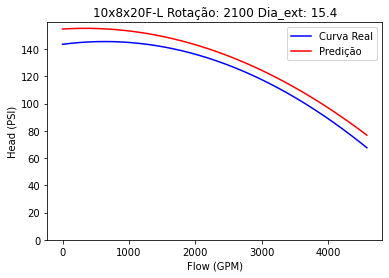

<Figure size 432x288 with 0 Axes>

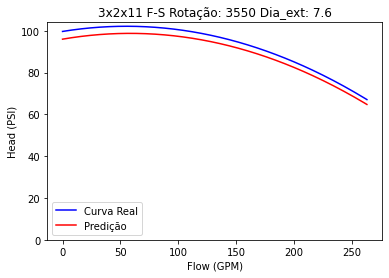

<Figure size 432x288 with 0 Axes>

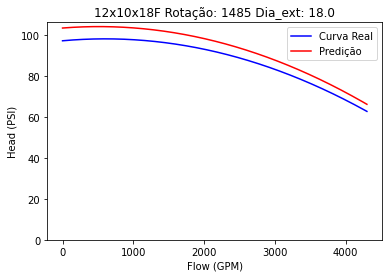

<Figure size 432x288 with 0 Axes>

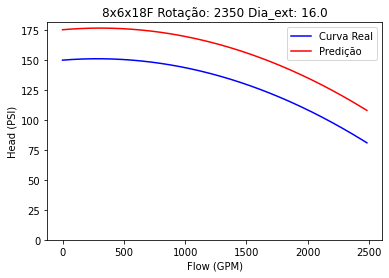

<Figure size 432x288 with 0 Axes>

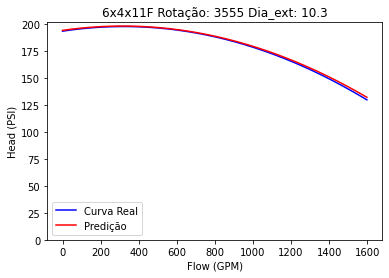

<Figure size 432x288 with 0 Axes>

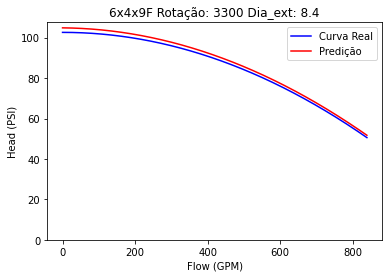

<Figure size 432x288 with 0 Axes>

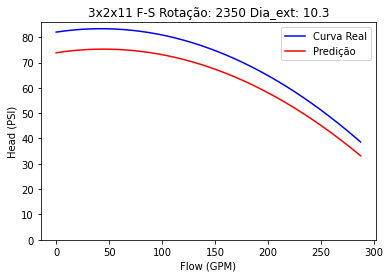

<Figure size 432x288 with 0 Axes>

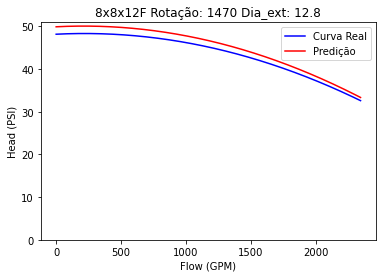

<Figure size 432x288 with 0 Axes>

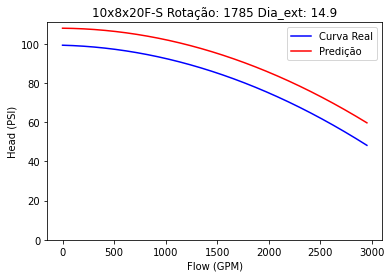

<Figure size 432x288 with 0 Axes>

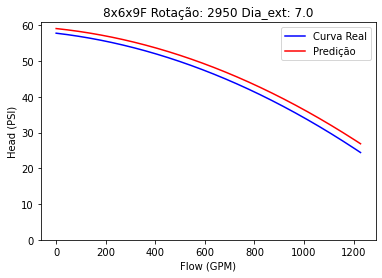

<Figure size 432x288 with 0 Axes>

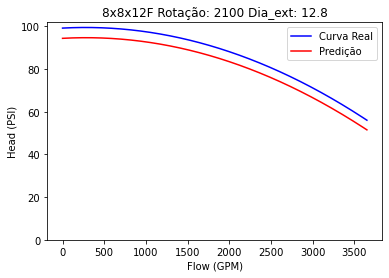

<Figure size 432x288 with 0 Axes>

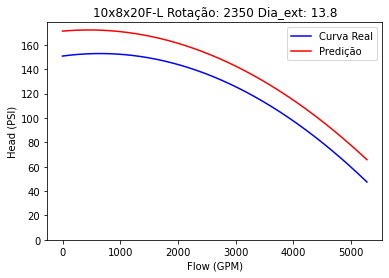

<Figure size 432x288 with 0 Axes>

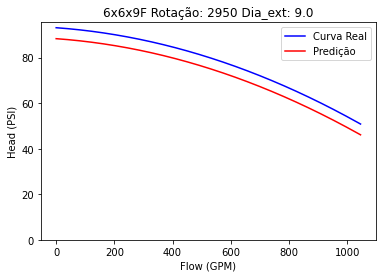

<Figure size 432x288 with 0 Axes>

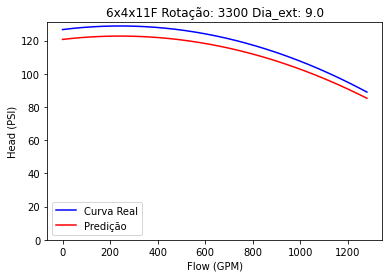

<Figure size 432x288 with 0 Axes>

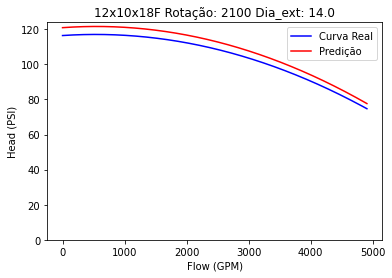

<Figure size 432x288 with 0 Axes>

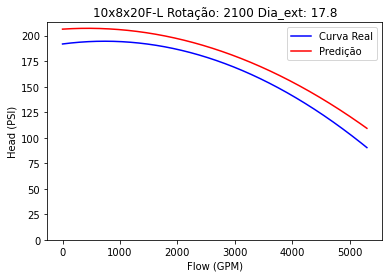

<Figure size 432x288 with 0 Axes>

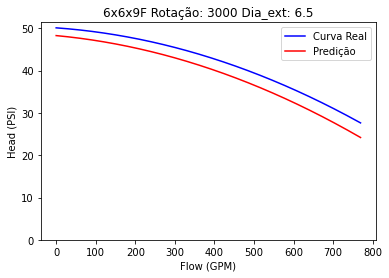

<Figure size 432x288 with 0 Axes>

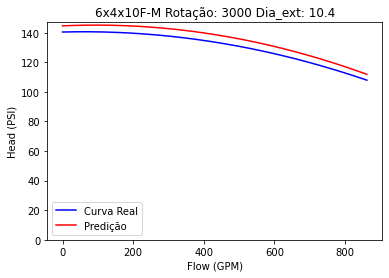

<Figure size 432x288 with 0 Axes>

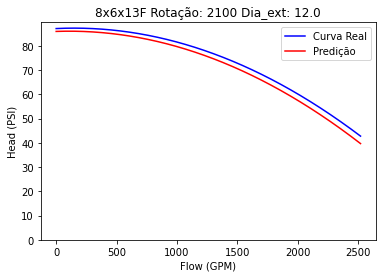

<Figure size 432x288 with 0 Axes>

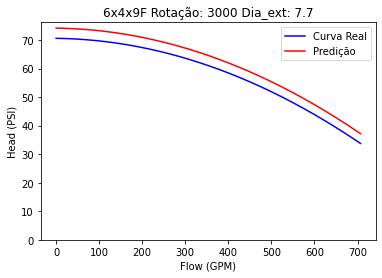

<Figure size 432x288 with 0 Axes>

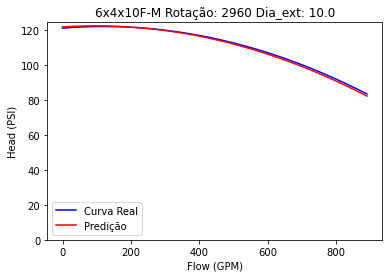

<Figure size 432x288 with 0 Axes>

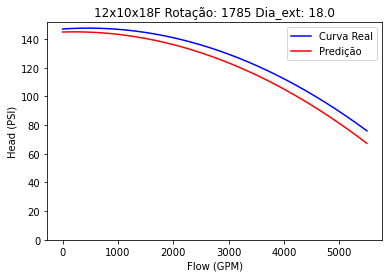

<Figure size 432x288 with 0 Axes>

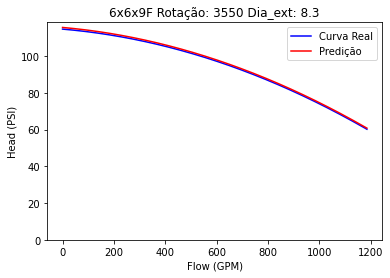

<Figure size 432x288 with 0 Axes>

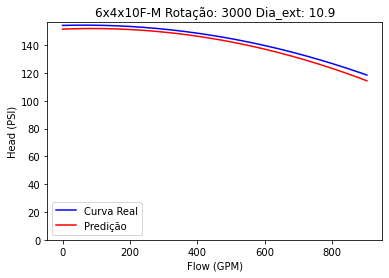

<Figure size 432x288 with 0 Axes>

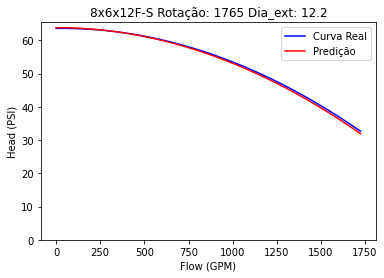

<Figure size 432x288 with 0 Axes>

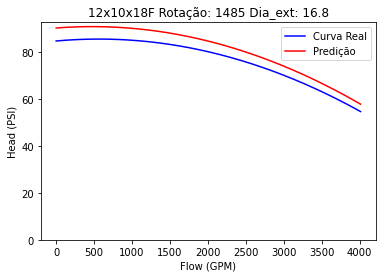

<Figure size 432x288 with 0 Axes>

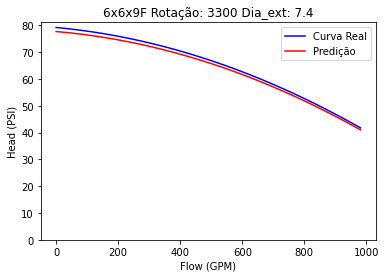

<Figure size 432x288 with 0 Axes>

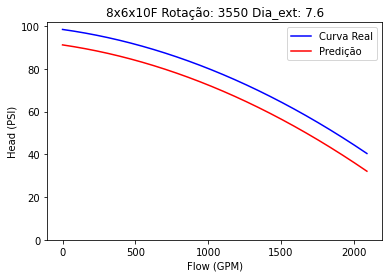

<Figure size 432x288 with 0 Axes>

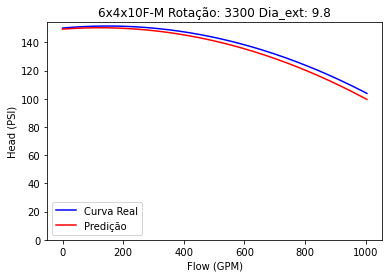

<Figure size 432x288 with 0 Axes>

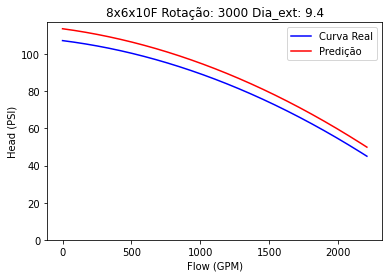

<Figure size 432x288 with 0 Axes>

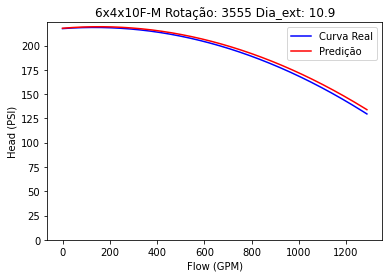

<Figure size 432x288 with 0 Axes>

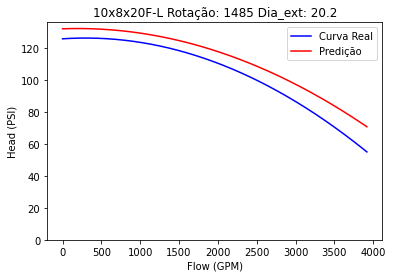

<Figure size 432x288 with 0 Axes>

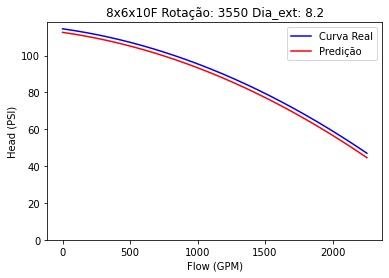

<Figure size 432x288 with 0 Axes>

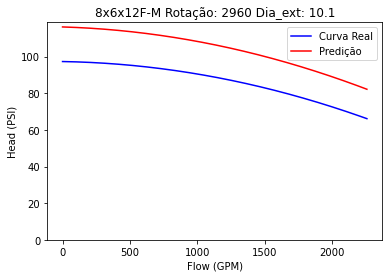

<Figure size 432x288 with 0 Axes>

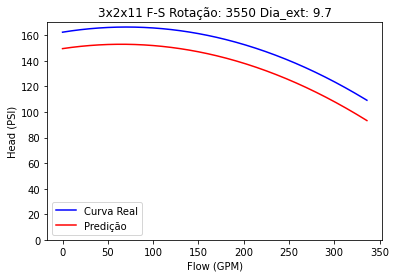

<Figure size 432x288 with 0 Axes>

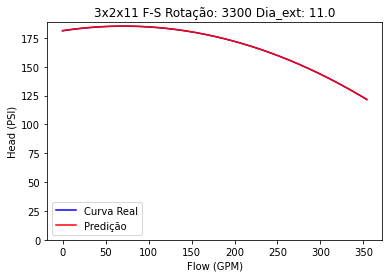

<Figure size 432x288 with 0 Axes>

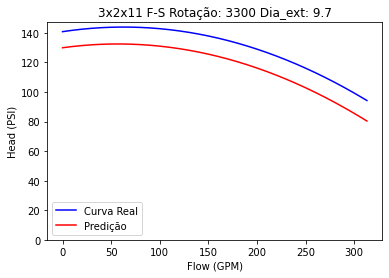

<Figure size 432x288 with 0 Axes>

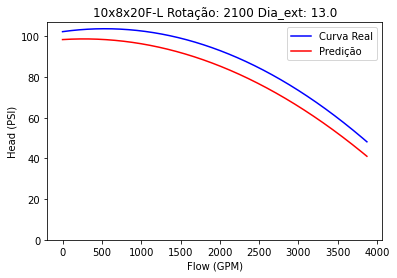

<Figure size 432x288 with 0 Axes>

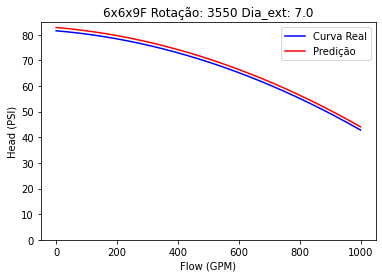

<Figure size 432x288 with 0 Axes>

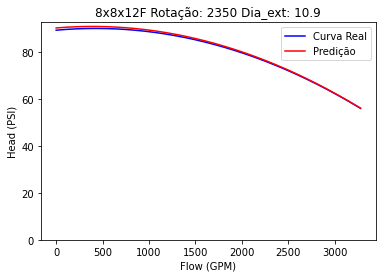

<Figure size 432x288 with 0 Axes>

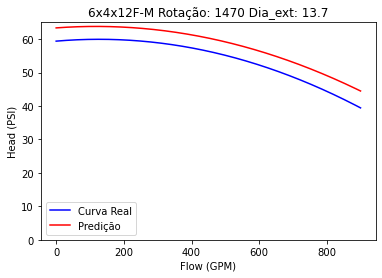

<Figure size 432x288 with 0 Axes>

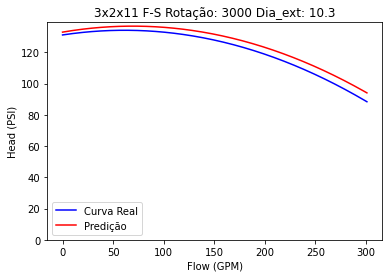

<Figure size 432x288 with 0 Axes>

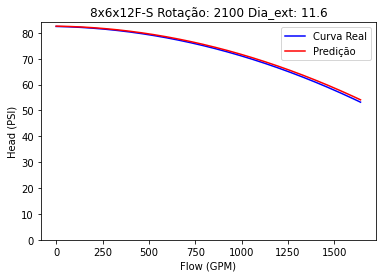

<Figure size 432x288 with 0 Axes>

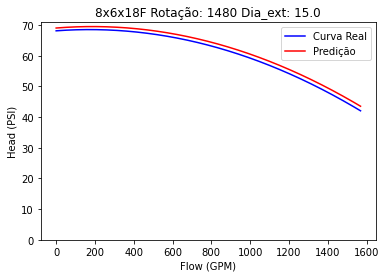

<Figure size 432x288 with 0 Axes>

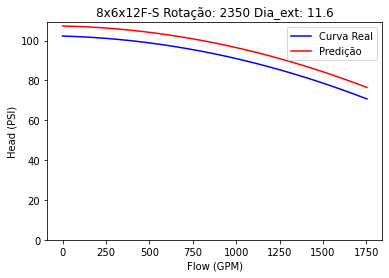

<Figure size 432x288 with 0 Axes>

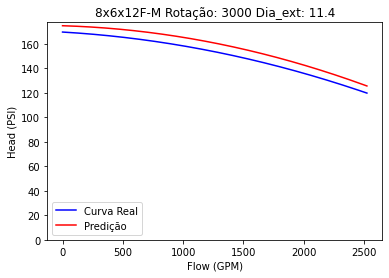

<Figure size 432x288 with 0 Axes>

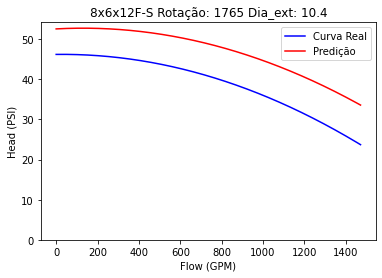

<Figure size 432x288 with 0 Axes>

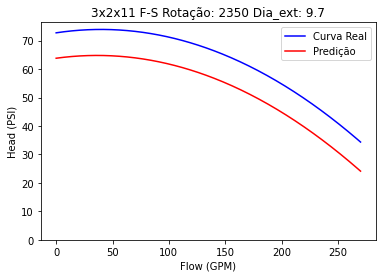

<Figure size 432x288 with 0 Axes>

In [54]:
dici_erro = {}
for indice in df_teste.index:
    eixo_x = []
    valor_real = []
    valor_previsto = []
    erro_abs = []
    erro_rel = []
    #print(X_test.loc[[i]]['Dia_externo'])
    ig, ax = plt.subplots()
    plt.ylabel('Head (PSI)')
    plt.xlabel('Flow (GPM)')
    #plt.title(dici[chave][2][-1]+', rotação: '+str(dici[chave][2][0])+' rpm, diâmetro externo: '+str(dici[chave][2][1])+' inches')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1'][indice],df_teste.loc[[indice]]['a2'][indice],df_teste.loc[[indice]]['a3'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='blue',label = 'Curva Real')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1p'][indice],df_teste.loc[[indice]]['a2p'][indice],df_teste.loc[[indice]]['a3p'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='red',label='Predição')
    plt.title(str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Modelo)+' Rotação: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Rotacao)+' Dia_ext: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Dia_externo))
    ax.set_ylim(bottom=0)
    plt.legend()
    plt.show()
    plt.clf()
        
    for valor in np.linspace(0,df_teste.loc[[indice]]['xn'][indice],5):
        valor = int(valor)
        eixo_x.append(valor)
        valor_real.append(df_teste.loc[[indice]]['a1'][indice] + df_teste.loc[[indice]]['a2'][indice]*valor + df_teste.loc[[indice]]['a3'][indice]*valor**2)
        valor_previsto.append(df_teste.loc[[indice]]['a1p'][indice] + df_teste.loc[[indice]]['a2p'][indice]*valor + df_teste.loc[[indice]]['a3p'][indice]*valor**2)
        erro_abs.append(valor_previsto[-1] - valor_real[-1])
        erro_rel.append(erro_abs[-1]/valor_real[-1])
    dici_erro[str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Modelo)+' Rotação: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Rotacao)+' Dia_ext: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Dia_externo)] = \
    [eixo_x,valor_real,valor_previsto,erro_abs,erro_rel]

In [55]:
df_erro = pd.DataFrame.from_dict(dici_erro).T
df_erro.to_excel('df_erro_SuperModelo.xlsx')

# Separando uma bomba para teste

In [272]:
df_teste = X_test1
df_teste['a1'] = y_test1
df_teste['a2'] = y_test2
df_teste['a3'] = y_test31
df_teste['xn'] = y_test4
df_teste['a1p'] = y_pred1
df_teste['a2p'] = y_pred2
df_teste['a3p'] = ypred31

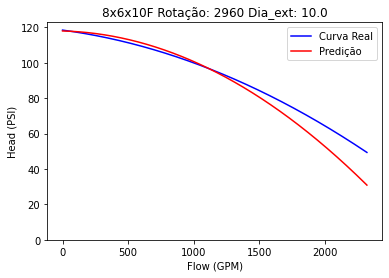

<Figure size 432x288 with 0 Axes>

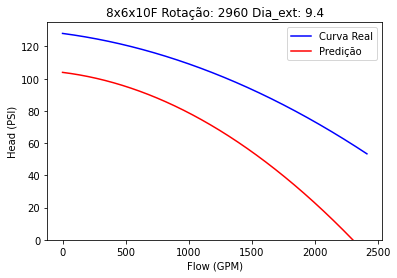

<Figure size 432x288 with 0 Axes>

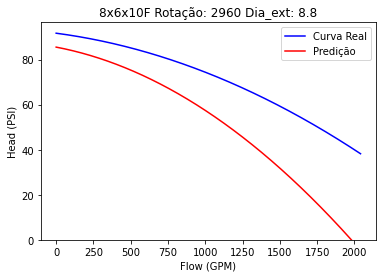

<Figure size 432x288 with 0 Axes>

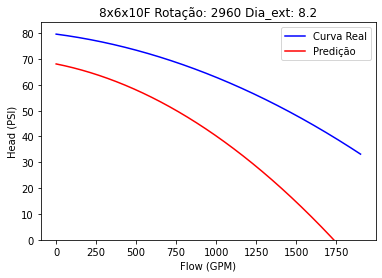

<Figure size 432x288 with 0 Axes>

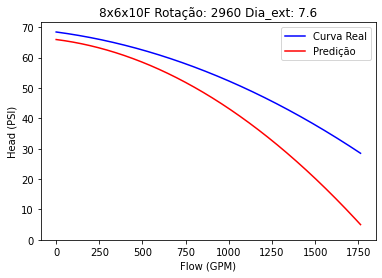

<Figure size 432x288 with 0 Axes>

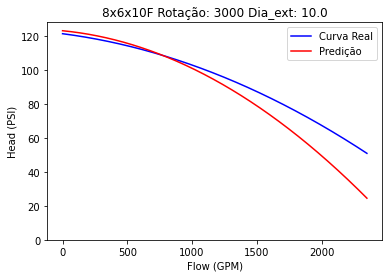

<Figure size 432x288 with 0 Axes>

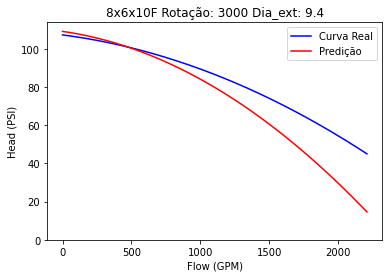

<Figure size 432x288 with 0 Axes>

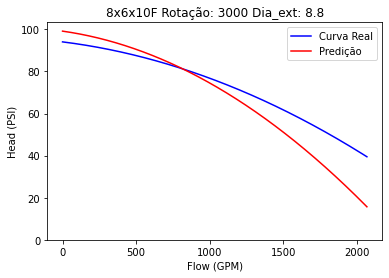

<Figure size 432x288 with 0 Axes>

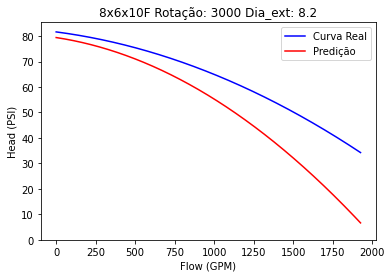

<Figure size 432x288 with 0 Axes>

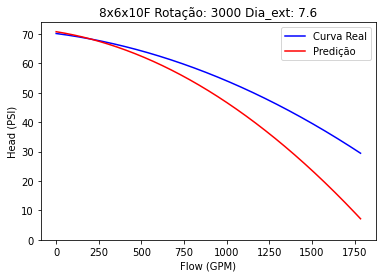

<Figure size 432x288 with 0 Axes>

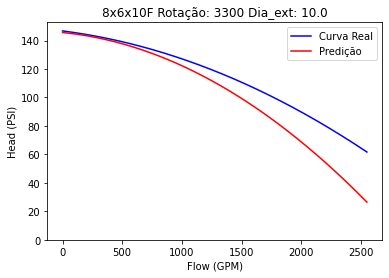

<Figure size 432x288 with 0 Axes>

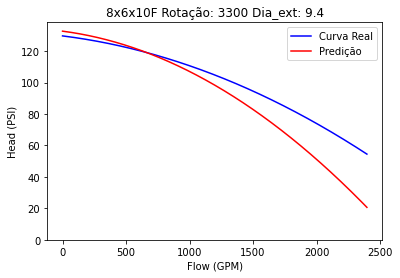

<Figure size 432x288 with 0 Axes>

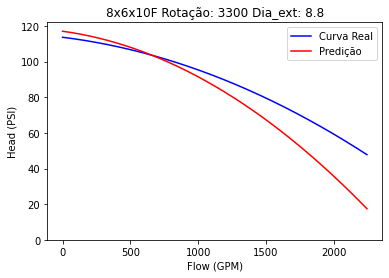

<Figure size 432x288 with 0 Axes>

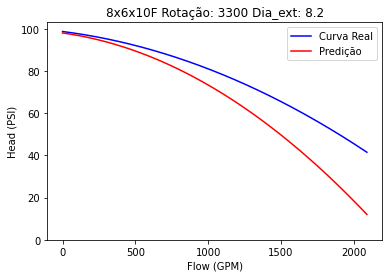

<Figure size 432x288 with 0 Axes>

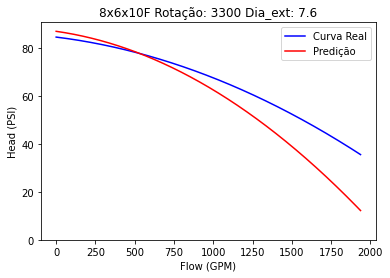

<Figure size 432x288 with 0 Axes>

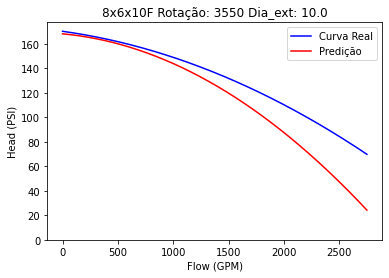

<Figure size 432x288 with 0 Axes>

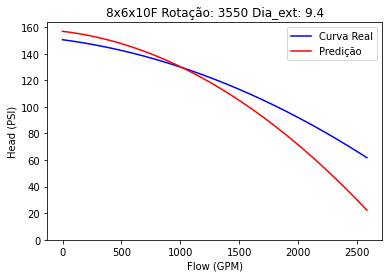

<Figure size 432x288 with 0 Axes>

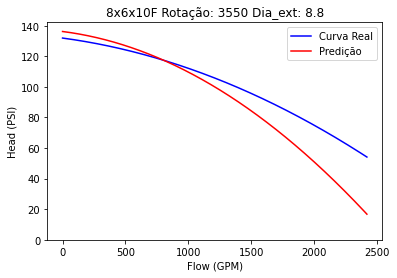

<Figure size 432x288 with 0 Axes>

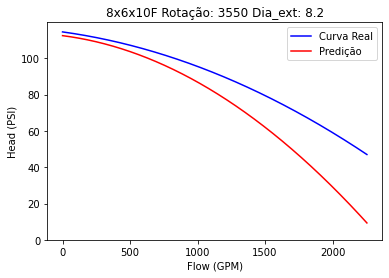

<Figure size 432x288 with 0 Axes>

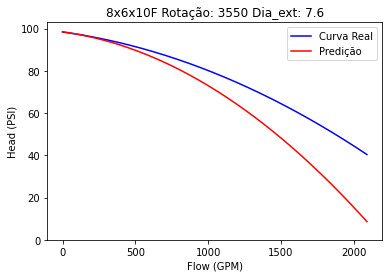

<Figure size 432x288 with 0 Axes>

In [273]:
dici_erro = {}
for indice in df_teste.index:
    eixo_x = []
    valor_real = []
    valor_previsto = []
    erro_abs = []
    erro_rel = []
    #print(X_test.loc[[i]]['Dia_externo'])
    ig, ax = plt.subplots()
    plt.ylabel('Head (PSI)')
    plt.xlabel('Flow (GPM)')
    #plt.title(dici[chave][2][-1]+', rotação: '+str(dici[chave][2][0])+' rpm, diâmetro externo: '+str(dici[chave][2][1])+' inches')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1'][indice],df_teste.loc[[indice]]['a2'][indice],df_teste.loc[[indice]]['a3'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='blue',label = 'Curva Real')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1p'][indice],df_teste.loc[[indice]]['a2p'][indice],df_teste.loc[[indice]]['a3p'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='red',label='Predição')
    plt.title(str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Modelo)+' Rotação: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Rotacao)+' Dia_ext: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Dia_externo))
    ax.set_ylim(bottom=0)
    plt.legend()
    plt.show()
    plt.clf()
        
    for valor in np.linspace(0,df_teste.loc[[indice]]['xn'][indice],5):
        valor = int(valor)
        eixo_x.append(valor)
        valor_real.append(df_teste.loc[[indice]]['a1'][indice] + df_teste.loc[[indice]]['a2'][indice]*valor + df_teste.loc[[indice]]['a3'][indice]*valor**2)
        valor_previsto.append(df_teste.loc[[indice]]['a1p'][indice] + df_teste.loc[[indice]]['a2p'][indice]*valor + df_teste.loc[[indice]]['a3p'][indice]*valor**2)
        erro_abs.append(valor_previsto[-1] - valor_real[-1])
        erro_rel.append(erro_abs[-1]/valor_real[-1])
    dici_erro[str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Modelo)+' Rotação: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Rotacao)+' Dia_ext: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Dia_externo)] = \
    [eixo_x,valor_real,valor_previsto,erro_abs,erro_rel]

# Rascunho

In [57]:
X = df_bombas[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y = df_bombas[['a1','a2','a3']]

In [59]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [60]:
random_forest = RandomForestRegressor(random_state=42)

In [61]:
random_forest.fit(X_train,y_train)

RandomForestRegressor(random_state=42)

In [62]:
random_forest.score(X_test,y_test)

0.733230194993841

In [64]:
y_pred = random_forest.predict(X_test)

In [77]:
mean_absolute_error(y_test['a1'],y_pred_df[0])

5.787862068982434

In [78]:
mean_absolute_error(y_test['a2'],y_pred_df[1])

0.01119523325121062

In [79]:
mean_absolute_error(y_test['a3'],y_pred_df[2])

8.430123479527868e-05

In [72]:
y_pred_df = pd.DataFrame(y_pred)

In [76]:
y_pred_df[0]

0     116.001374
1     163.778054
2     121.420205
3     111.922861
4      76.064136
5     118.445441
6     181.410155
7      88.860931
8      55.942292
9      92.215132
10     98.360915
11    141.874867
12     91.536534
13    109.711953
14    181.410155
15    184.116701
16    105.230637
17     84.409630
18     50.829928
19    112.740795
20     60.531579
21     98.823081
22    148.500427
23     89.654177
24    122.270984
25    115.232924
26    182.695612
27     57.273293
28    144.468755
29     89.876191
30     71.604547
31    126.682247
32    144.230229
33    116.573567
34    148.709070
35     63.677982
36     97.684932
37     78.014913
38     90.550061
39    152.881269
40    117.903018
41    205.043729
42    122.114300
43    109.726170
44    126.842050
45    156.389951
46    179.799730
47    136.233335
48    101.200883
49     81.331358
50     92.325439
51     62.775309
52    135.727863
53     82.704691
54     74.468649
55    102.389568
56    168.418731
57     47.276623
58     77.7049

# Ajustando a equação de variação de diâmetro

In [80]:
_8x6x10F_2960_10 = [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,2000,2125,2250,2320],
                   [121,118,115,112,110,107,105,102,100,97,93,90,85,81,76,70,65,58,52,48],
                   [2960,10,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']]

_8x6x10F_2960_76 = [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,2000,2025],
                    [68,66,65,64,62.5,61,60,58,56,54,50,47,43,38,33,27.5,22,20],
                    [2960,7.6,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']]

ajustada_8x6x10F_2960_76 = [list(np.array(_8x6x10F_2960_10[0])*(7.6/10)**0.75),
                  list(np.array(_8x6x10F_2960_10[1])*(7.6/10)**2),
                   [2960,7.6,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']]

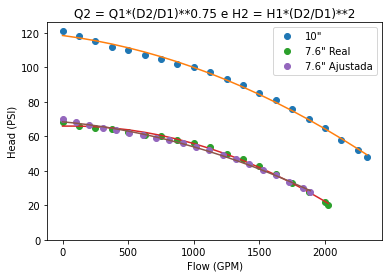

In [82]:
ig, ax = plt.subplots()
x = np.array(_8x6x10F_2960_10[0])
y = _8x6x10F_2960_10[1]

p = np.polyfit(x,y,2)

p = np.flip(p)

plt.plot(x,y,'o',label = '10"')
yn = []
i = 0
for cte in p:
    yn.append(cte*x**i)
    i += 1
plt.plot(x,sum(yn))

x = np.array(_8x6x10F_2960_76[0])
y = _8x6x10F_2960_76[1]

p = np.polyfit(x,y,2)

p = np.flip(p)

plt.plot(x,y,'o',label = '7.6" Real')
yn = []
i = 0
for cte in p:
    yn.append(cte*x**i)
    i += 1
plt.plot(x,sum(yn))

x = np.array(ajustada_8x6x10F_2960_76[0])
y = ajustada_8x6x10F_2960_76[1]

p = np.polyfit(x,y,2)

p = np.flip(p)

plt.plot(x,y,'o',label = '7.6" Ajustada')
yn = []
i = 0
for cte in p:
    yn.append(cte*x**i)
    i += 1
plt.plot(x,sum(yn))

plt.ylabel('Head (PSI)')
plt.xlabel('Flow (GPM)')
ax.set_ylim(bottom=0)
plt.legend()
plt.title('Q2 = Q1*(D2/D1)**0.75 e H2 = H1*(D2/D1)**2')
plt.show()

# Montando o DataFrame

In [102]:
dici = {'_2100_11_s_3x2x11FS' : [[0,25,50,75,100,125,150,175,200,225,250,274],
                       [75.5,75.3,75.1,74.4,72.9,70.4,67.4,63,57.6,51.2,43.4,34.5],
                      [2100,11,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2100_103_s_3x2x11FS' : [list(np.array(_2100_11_s_3x2x11FS[0])*(10.3/11)**0.75),
                       list(np.array(_2100_11_s_3x2x11FS[1])*(7.6/11)**2),
                       [2100,10.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2100_95_s_3x2x11FS' : [list(np.array(_2100_11_s_3x2x11FS[0])*(9.5/11)**0.75),
                      list(np.array(_2100_11_s_3x2x11FS[1])*(9.5/11)**2),
                      [2100,9.5,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2100_87_s_3x2x11FS' : [list(np.array(_2100_11_s_3x2x11FS[0])*(8.7/11)**0.75),
                      list(np.array(_2100_11_s_3x2x11FS[1])*(8.7/11)**2),
                      [2100,8.7,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2350_11_s_3x2x11FS' : [[0,25,50,75,100,125,150,175,200,225,250,275,300,307],
                               [95,95,94,93,92,90,87,83,78,72,64,56,46,43],
                      [2350,11,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2350_103_s_3x2x11FS' : [list(np.array(_2350_11_s_3x2x11FS[0])*(10.3/11)**0.75),
                       list(np.array(_2350_11_s_3x2x11FS[1])*(10.3/11)**2),
                       [2350,10.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2350_97_s_3x2x11FS' : [list(np.array(_2350_11_s_3x2x11FS[0])*(9.7/11)**0.75),
                      list(np.array(_2350_11_s_3x2x11FS[1])*(9.7/11)**2),
                      [2350,9.7,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2350_9_s_3x2x11FS' : [list(np.array(_2350_11_s_3x2x11FS[0])*(9/11)**0.75),
                     list(np.array(_2350_11_s_3x2x11FS[1])*(9/11)**2),
                     [2350,9,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2350_83_s_3x2x11FS' : [list(np.array(_2350_11_s_3x2x11FS[0])*(8.3/11)**0.75),
                      list(np.array(_2350_11_s_3x2x11FS[1])*(8.3/11)**2),
                      [2350,8.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2350_76_s_3x2x11FS' : [list(np.array(_2350_11_s_3x2x11FS[0])*(7.6/11)**0.75),
                      list(np.array(_2350_11_s_3x2x11FS[1])*(7.6/11)**2),
                      [2350,7.6,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2960_11_s_3x2x11FS' : [[0,25,50,75,100,125,150,175,200,225,250,275,300,318],
                                   [147.5,148,148,147.5,146,145,143,140,136,130,123,114,104,96],
                      [2960,11,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2960_103_s_3x2x11FS' : [list(np.array(_2960_11_s_3x2x11FS[0])*(10.3/11)**0.75),
                      list(np.array(_2960_11_s_3x2x11FS[1])*(10.3/11)**2),
                       [2960,10.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2960_97_s_3x2x11FS' : [list(np.array(_2960_11_s_3x2x11FS[0])*(9.7/11)**0.75),
                      list(np.array(_2350_11_s_3x2x11FS[1])*(9.7/11)**2),
                      [2960,9.7,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2960_9_s_3x2x11FS' : [list(np.array(_2960_11_s_3x2x11FS[0])*(9/11)**0.75),
                     list(np.array(_2350_11_s_3x2x11FS[1])*(9/11)**2),
                     [2960,9,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2960_83_s_3x2x11FS' : [list(np.array(_2960_11_s_3x2x11FS[0])*(8.3/11)**0.75),
                      list(np.array(_2350_11_s_3x2x11FS[1])*(8.3/11)**2),
                      [2960,8.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_2960_76_s_3x2x11FS' : [list(np.array(_2960_11_s_3x2x11FS[0])*(7.6/11)**0.75),
                      list(np.array(_2960_11_s_3x2x11FS[1])*(7.6/11)**2),
                      [2960,7.6,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3000_11_s_3x2x11FS' : [[0,25,50,75,100,125,150,175,200,225,250,275,300,322.5],
                                   [152,152,152,151,150,149,147,144,140,135,127,119,109,98],
                      [3000,11,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3000_103_s_3x2x11FS' : [list(np.array(_3000_11_s_3x2x11FS[0])*(10.3/11)**0.75),
                       list(np.array(_3000_11_s_3x2x11FS[1])*(10.3/11)**2),
                       [3000,10.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3000_97_s_3x2x11FS' : [list(np.array(_3000_11_s_3x2x11FS[0])*(9.7/11)**0.75),
                      list(np.array(_3000_11_s_3x2x11FS[1])*(9.7/11)**2),
                      [3000,9.7,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3000_9_s_3x2x11FS' : [list(np.array(_3000_11_s_3x2x11FS[0])*(9/11)**0.75),
                     list(np.array(_3000_11_s_3x2x11FS[1])*(9/11)**2),
                     [3000,9,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3000_83_s_3x2x11FS' : [list(np.array(_3000_11_s_3x2x11FS[0])*(8.3/11)**0.75),
                      list(np.array(_3000_11_s_3x2x11FS[1])*(8.3/11)**2),
                      [3000,8.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3000_76_s_3x2x11FS' : [list(np.array(_3000_11_s_3x2x11FS[0])*(7.6/11)**0.75),
                      list(np.array(_3000_11_s_3x2x11FS[1])*(7.6/11)**2),
                      [3000,7.6,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3300_11_s_3x2x11FS' : [[0,25,50,75,100,125,150,175,200,225,250,275,300,325,350,355],
                               [184,184,184,183,182.5,181,179,176,173,168,162,154,145,134,122,119],
                      [3300,11,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3300_103_s_3x2x11FS' : [list(np.array(_3300_11_s_3x2x11FS[0])*(10.3/11)**0.75),
                       list(np.array(_3300_11_s_3x2x11FS[1])*(10.3/11)**2),
                       [3300,10.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3300_97_s_3x2x11FS' : [list(np.array(_3300_11_s_3x2x11FS[0])*(9.7/11)**0.75),
                      list(np.array(_3300_11_s_3x2x11FS[1])*(9.7/11)**2),
                      [3300,9.7,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3300_9_s_3x2x11FS' : [list(np.array(_3300_11_s_3x2x11FS[0])*(9/11)**0.75),
                     list(np.array(_3300_11_s_3x2x11FS[1])*(9/11)**2),
                     [3300,9,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3300_83_s_3x2x11FS' : [list(np.array(_3300_11_s_3x2x11FS[0])*(8.3/11)**0.75),
                      list(np.array(_3300_11_s_3x2x11FS[1])*(8.3/11)**2),
                      [3300,8.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3300_76_s_3x2x11FS' : [list(np.array(_3300_11_s_3x2x11FS[0])*(7.6/11)**0.75),
                      list(np.array(_3300_11_s_3x2x11FS[1])*(7.6/11)**2),
                      [3300,7.6,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3550_11_s_3x2x11FS' : [[0,25,50,75,100,125,150,175,200,225,250,275,300,325,350,375,382],
                               [212.5,212.5,212.5,212,211,210,209,206,202.5,198,192.5,186,177,167,155,141,137.5],
                      [3550,11,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3550_103_s_3x2x11FS' : [list(np.array(_3550_11_s_3x2x11FS[0])*(10.3/11)**0.75),
                      list(np.array(_3550_11_s_3x2x11FS[1])*(10.3/11)**2),
                       [3550,10.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3550_97_s_3x2x11FS' : [list(np.array(_3550_11_s_3x2x11FS[0])*(9.7/11)**0.75),
                      list(np.array(_3550_11_s_3x2x11FS[1])*(9.7/11)**2),
                      [3550,9.7,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3550_9_s_3x2x11FS' : [list(np.array(_3550_11_s_3x2x11FS[0])*(9/11)**0.75),
                     list(np.array(_3550_11_s_3x2x11FS[1])*(9/11)**2),
                     [3550,9,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3550_83_s_3x2x11FS' : [list(np.array(_3550_11_s_3x2x11FS[0])*(8.3/11)**0.75),
                      list(np.array(_3550_11_s_3x2x11FS[1])*(8.3/11)**2),
                      [3550,8.3,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
'_3550_76_s_3x2x11FS' : [list(np.array(_3550_11_s_3x2x11FS[0])*(7.6/11)**0.75),
                      list(np.array(_3550_11_s_3x2x11FS[1])*(7.6/11)**2),
                      [3550,7.6,2.132,7.7,0.735,1.699,0.25,3.6,6,'3x2x11 F-S']],
        '_2950_98_6x4x9F' : [[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700,750,800,850,890],
                            [115,115,114,112,110,108,106,104,102,99,96,92.5,88,84,78,73,67,60,54],
                  [2950,9.8,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_2950_91_6x4x9F' : [list(np.array(_2950_98_6x4x9F[0])*(9.1/9.8)**0.75),
                  list(np.array(_2950_98_6x4x9F[1])*(9.1/9.8)**2),
                  [2950,9.1,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_2950_84_6x4x9F' : [list(np.array(_2950_98_6x4x9F[0])*(8.4/9.8)**0.75),
                  list(np.array(_2950_98_6x4x9F[1])*(8.4/9.8)**2),
                  [2950,8.4,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_2950_77_6x4x9F' : [list(np.array(_2950_98_6x4x9F[0])*(7.7/9.8)**0.75),
                  list(np.array(_2950_98_6x4x9F[1])*(7.7/9.8)**2),
                  [2950,7.7,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_2950_7_6x4x9F' : [list(np.array(_2950_98_6x4x9F[0])*(7/9.8)**0.75),
                 list(np.array(_2950_98_6x4x9F[1])*(7/9.8)**2),
                 [2950,7,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3000_98_6x4x9F' : [[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700,750,800,850,900],
                            [117,116,115,113,112,110,108,105,103,100,97.5,94,90,85,80,74,67,61,54],
                  [3000,9.8,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3000_91_6x4x9F' : [list(np.array(_3000_98_6x4x9F[0])*(9.1/9.8)**0.75),
                  list(np.array(_2950_98_6x4x9F[1])*(9.1/9.8)**2),
                  [3000,9.1,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3000_84_6x4x9F' : [list(np.array(_3000_98_6x4x9F[0])*(8.4/9.8)**0.75),
                  list(np.array(_2950_98_6x4x9F[1])*(8.4/9.8)**2),
                  [3000,8.4,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3000_77_6x4x9F' : [list(np.array(_3000_98_6x4x9F[0])*(7.7/9.8)**0.75),
                  list(np.array(_2950_98_6x4x9F[1])*(7.7/9.8)**2),
                  [3000,7.7,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3000_7_6x4x9F' : [list(np.array(_3000_98_6x4x9F[0])*(7/9.8)**0.75),
                  list(np.array(_2950_98_6x4x9F[1])*(7/9.8)**2),
                 [3000,7,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3300_98_6x4x9F' : [[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700,750,800,850,900,950,980],
                           [141,140,139,138,136,134,132,130,127.5,124,121,117.5,114,109,105,99,93,87,80,72,67],
                  [3300,9.8,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3300_91_6x4x9F' : [list(np.array(_3300_98_6x4x9F[0])*(9.1/9.8)**0.75),
                  list(np.array(_3300_98_6x4x9F[1])*(9.1/9.8)**2),
                  [3300,9.1,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3300_84_6x4x9F' : [list(np.array(_3300_98_6x4x9F[0])*(8.4/9.8)**0.75),
                  list(np.array(_3300_98_6x4x9F[1])*(8.4/9.8)**2),
                  [3300,8.4,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3300_77_6x4x9F' : [list(np.array(_3300_98_6x4x9F[0])*(7.7/9.8)**0.75),
                  list(np.array(_3300_98_6x4x9F[1])*(7.7/9.8)**2),
                  [3300,7.7,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3300_7_6x4x9F' : [list(np.array(_3300_98_6x4x9F[0])*(7/9.8)**0.75),
                  list(np.array(_3300_98_6x4x9F[1])*(7/9.8)**2),
                 [3300,7,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3550_98_6x4x9F' : [[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700,750,800,850,900,950,980],
                            [164,162.5,161,159,157.5,156,154,151,149,146,143,140,135.5,131,126,121,115,109,102,95,90],
                  [3550,9.8,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3550_91_6x4x9F' : [list(np.array(_3550_98_6x4x9F[0])*(9.1/9.8)**0.75),
                  list(np.array(_3550_98_6x4x9F[1])*(9.1/9.8)**2),
                  [3550,9.1,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3550_84_6x4x9F' : [list(np.array(_3550_98_6x4x9F[0])*(8.4/9.8)**0.75),
                  list(np.array(_3550_98_6x4x9F[1])*(8.4/9.8)**2),
                  [3550,8.4,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3550_77_6x4x9F' : [list(np.array(_3550_98_6x4x9F[0])*(7.7/9.8)**0.75),
                  list(np.array(_3550_98_6x4x9F[1])*(7.7/9.8)**2),
                  [3550,7.7,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
'_3550_7_6x4x9F' : [list(np.array(_3550_98_6x4x9F[0])*(7/9.8)**0.75),
                  list(np.array(_3550_98_6x4x9F[1])*(7/9.8)**2),
                 [3550,7,2.133,5.9,0.654,1.513,0.44,2.4,6,'6x4x9F']],
        '_6x4x10FM_2960_12' : [[0,100,200,300,400,500,600,700,800,900,1000,1070],
                        [175,175,175,174,171,167.5,162.5,156,148,138,128,120],
                      [2960,12,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_2960_11' : [list(np.array(_6x4x10FM_2960_12[0])*(11/12)**0.75),
                  list(np.array(_6x4x10FM_2960_12[1])*(11/12)**2),
                    [2960,11,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_2960_10' : [list(np.array(_6x4x10FM_2960_12[0])*(10/12)**0.75),
                  list(np.array(_6x4x10FM_2960_12[1])*(10/12)**2),
                    [2960,10,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3000_12' : [[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700,750,800,850,900,950,995],
                      [187.5,187.5,187,187,186,185,184,183,182,180,177.5,175.5,173,170,167.5,164,160,157,152,147.5,143],
                      [3000,12,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3000_115' : [list(np.array(_6x4x10FM_3000_12[0])*(11.5/12)**0.75),
                  list(np.array(_6x4x10FM_3000_12[1])*(11.5/12)**2),
                     [3000,11.5,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3000_109' : [list(np.array(_6x4x10FM_3000_12[0])*(10.9/12)**0.75),
                  list(np.array(_6x4x10FM_3000_12[1])*(10.9/12)**2),
                     [3000,10.9,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3000_104' : [list(np.array(_6x4x10FM_3000_12[0])*(10.4/12)**0.75),
                  list(np.array(_6x4x10FM_3000_12[1])*(10.4/12)**2),
                     [3000,10.4,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3300_12' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1230],
                     [227.5,227,226,225,223,220,216,210,204,195,185,173,161,152],
                     [3300,12,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3300_109' : [list(np.array(_6x4x10FM_3300_12[0])*(10.9/12)**0.75),
                  list(np.array(_6x4x10FM_3300_12[1])*(10.9/12)**2),
                     [3300,10.9,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3300_98' : [list(np.array(_6x4x10FM_3300_12[0])*(9.8/12)**0.75),
                  list(np.array(_6x4x10FM_3300_12[1])*(9.8/12)**2),
                    [3300,9.8,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3300_88' : [list(np.array(_6x4x10FM_3300_12[0])*(8.8/12)**0.75),
                  list(np.array(_6x4x10FM_3300_12[1])*(8.8/12)**2),
                    [3300,8.8,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3555_12' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1418],
                     [265,265,264,262,260,256,251,245,237,227.5,217,205,191,176,159,157],
                     [3555,12,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3555_109' : [list(np.array(_6x4x10FM_3555_12[0])*(10.9/12)**0.75),
                  list(np.array(_6x4x10FM_3555_12[1])*(10.9/12)**2),
                     [3555,10.9,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3555_98' : [list(np.array(_6x4x10FM_3555_12[0])*(9.8/12)**0.75),
                  list(np.array(_6x4x10FM_3555_12[1])*(9.8/12)**2),
                    [3555,9.8,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
'_6x4x10FM_3555_87' : [list(np.array(_6x4x10FM_3555_12[0])*(8.7/12)**0.75),
                  list(np.array(_6x4x10FM_3555_12[1])*(8.7/12)**2),
                    [3555,8.7,2.449,15.9,0.801,1.853,0.5,2.9,6,'6x4x10F-M']],
        '_6x4x11F_2960_116' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1500,1600,1620],
                    [174.5,174.5,174.5,174,173,172,170,167.5,165,161.5,157,151,145,137.5,130,120,110,108],
                    [2960,11.6,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']],
'_6x4x11F_2960_105' : [list(np.array(_6x4x11F_2960_116[0])*(10.5/11.6)**0.75),
                  list(np.array(_6x4x11F_2960_116[1])*(10.5/11.6)**2),
                    [2960,10.5,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']],
'_6x4x11F_3000_116' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1500,1600,1640],
                    [178,178,178,177.5,177,176,175,172.5,169,165,160,155,148,140,132.5,124,115,110],
                    [3000,11.6,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']],
'_6x4x11F_3000_105' : [list(np.array(_6x4x11F_3000_116[0])*(10.5/11.6)**0.75),
                  list(np.array(_6x4x11F_3000_116[1])*(10.5/11.6)**2),
                    [3000,10.5,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']],
'_6x4x11F_3300_116' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1650],
                    [212.5,212.5,212.5,212.5,211,210,207.5,203,197.5,191,182.5,170.2,162,150,147.5],
                    [3300,11.6,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']],
'_6x4x11F_3300_103' : [list(np.array(_6x4x11F_3300_116[0])*(10.3/11.6)**0.75),
                  list(np.array(_6x4x11F_3300_116[1])*(10.3/11.6)**2),
                    [3300,10.3,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']],
'_6x4x11F_3300_9' : [list(np.array(_6x4x11F_3300_116[0])*(9/11.6)**0.75),
                  list(np.array(_6x4x11F_3300_116[1])*(9/11.6)**2),
                  [3300,9,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']],
'_6x4x11F_3555_116' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1800],
                    [249,249,249,249,248,246,244.5,240,235,227.5,220,210,197,188,168,162],
                    [3555,11.6,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']],
'_6x4x11F_3555_103' : [list(np.array(_6x4x11F_3555_116[0])*(10.3/11.6)**0.75),
                  list(np.array(_6x4x11F_3555_116[1])*(10.3/11.6)**2),
                    [3555,10.3,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']],
'_6x4x11F_3555_9' : [list(np.array(_6x4x11F_3555_116[0])*(9/11.6)**0.75),
                  list(np.array(_6x4x11F_3555_116[1])*(9/11.6)**2),
                  [3555,9,2.449,19.6,0.775,1.791,0.7,3,6,'6x4x11F']],
        '_6x4x12FM_1470_137' : [[0,50,100,150,200,250,300,350,400,450,500,550,600,650,700,750,800,850,900],
                     [60,60,59.9,59.6,59.3,59,58.7,58,57.3,56.5,55.3,54,52.6,51,49,46.7,44.2,41.8,39],
                     [1470,13.7,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_1470_124' : [list(np.array(_6x4x12FM_1470_137[0])*(12.4/13.7)**0.75),
                  list(np.array(_6x4x12FM_1470_137[1])*(12.4/13.7)**2),
                     [1470,12.4,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_1770_137' : [[0,100,200,300,400,500,600,700,800,900,1000,1050],
                     [87.5,87,86.5,85.5,84,82,79.5,76.5,73,68.5,63.5,60.5],
                     [1770,13.7,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_1770_122' : [list(np.array(_6x4x12FM_1770_137[0])*(12.2/13.7)**0.75),
                  list(np.array(_6x4x12FM_1770_137[1])*(12.2/13.7)**2),
                     [1770,12.2,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_1770_102' : [list(np.array(_6x4x12FM_1770_137[0])*(10.2/13.7)**0.75),
                  list(np.array(_6x4x12FM_1770_137[1])*(10.2/13.7)**2),
                     [1770,10.2,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2100_137' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200],
                     [120,120,119,118,116,115,112,109,105,101,95,88,79],
                     [2100,13.7,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2100_123' : [list(np.array(_6x4x12FM_2100_137[0])*(12.3/13.7)**0.75),
                  list(np.array(_6x4x12FM_2100_137[1])*(12.3/13.7)**2),
                     [2100,12.3,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2100_105' : [list(np.array(_6x4x12FM_2100_137[0])*(10.5/13.7)**0.75),
                  list(np.array(_6x4x12FM_2100_137[1])*(10.5/13.7)**2),
                     [2100,10.5,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2100_86' : [list(np.array(_6x4x12FM_2100_137[0])*(8.6/13.7)**0.75),
                  list(np.array(_6x4x12FM_2100_137[1])*(8.6/13.7)**2),
                    [2100,8.6,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2350_137' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1500],
                     [147.5,147,146.5,146,145,144,142.5,140,136,132,126,119,112.5,103,94,85],
                     [2350,13.7,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2350_119' : [list(np.array(_6x4x12FM_2350_137[0])*(11.9/13.7)**0.75),
                  list(np.array(_6x4x12FM_2350_137[1])*(11.9/13.7)**2),
                     [2350,11.9,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2350_101' : [list(np.array(_6x4x12FM_2350_137[0])*(10.1/13.7)**0.75),
                  list(np.array(_6x4x12FM_2350_137[1])*(10.1/13.7)**2),
                     [2350,10.1,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2350_78' : [list(np.array(_6x4x12FM_2350_137[0])*(7.8/13.7)**0.75),
                  list(np.array(_6x4x12FM_2350_137[1])*(7.8/13.7)**2),
                    [2350,7.8,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2960_137' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1460],
                     [231,230,230,229,228,225,221,217,210,201,192,181,176],
                     [2960,13.7,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2960_124' : [list(np.array(_6x4x12FM_2960_137[0])*(12.4/13.7)**0.75),
                  list(np.array(_6x4x12FM_2960_137[1])*(12.4/13.7)**2),
                     [2960,12.4,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2960_11' : [list(np.array(_6x4x12FM_2960_137[0])*(11/13.7)**0.75),
                  list(np.array(_6x4x12FM_2960_137[1])*(11/13.7)**2),
                    [2960,11,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_2960_95' : [list(np.array(_6x4x12FM_2960_137[0])*(9.5/13.7)**0.75),
                  list(np.array(_6x4x12FM_2960_137[1])*(9.5/13.7)**2),
                    [2960,9.5,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_3000_137' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1487],
                     [242,241,240,239,236,231,228,222,217,209,200,189,177],
                     [3000,13.7,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_3000_124' : [list(np.array(_6x4x12FM_3000_137[0])*(12.4/13.7)**0.75),
                  list(np.array(_6x4x12FM_3000_137[1])*(12.4/13.7)**2),
                     [3000,12.4,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_3000_11' : [list(np.array(_6x4x12FM_3000_137[0])*(11/13.7)**0.75),
                  list(np.array(_6x4x12FM_3000_137[1])*(11/13.7)**2),
                    [3000,11,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
'_6x4x12FM_3000_95' : [list(np.array(_6x4x12FM_3000_137[0])*(9.5/13.7)**0.75),
                  list(np.array(_6x4x12FM_3000_137[1])*(9.5/13.7)**2),
                    [3000,9.5,2.133,10.2,0.915,2.116,0.5,3,6,'6x4x12F-M']],
        '_6x6x9F_2950_98' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1140],
                  [112,109,106,104,100.5,97.5,94,90,84,78,71,63,59],
                  [2950,9.8,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_2950_9' : [list(np.array(_6x6x9F_2950_98[0])*(9/9.8)**0.75),
                  list(np.array(_6x6x9F_2950_98[1])*(9/9.8)**2),
                 [2950,9,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_2950_82' : [list(np.array(_6x6x9F_2950_98[0])*(8.2/9.8)**0.75),
                  list(np.array(_6x6x9F_2950_98[1])*(8.2/9.8)**2),
                  [2950,8.2,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_2950_74' : [list(np.array(_6x6x9F_2950_98[0])*(7.4/9.8)**0.75),
                  list(np.array(_6x6x9F_2950_98[1])*(7.4/9.8)**2),
                  [2950,7.4,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_2950_65' : [list(np.array(_6x6x9F_2950_98[0])*(6.5/9.8)**0.75),
                  list(np.array(_6x6x9F_2950_98[1])*(6.5/9.8)**2),
                  [2950,6.5,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3000_98' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1160],
                  [115,112.5,110,107.5,105,101,97.5,93,87.5,82,75,67,62],
                  [3000,9.8,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3000_9' : [list(np.array(_6x6x9F_3000_98[0])*(9/9.8)**0.75),
                  list(np.array(_6x6x9F_3000_98[1])*(9/9.8)**2),
                 [3000,9,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3000_82' : [list(np.array(_6x6x9F_3000_98[0])*(8.2/9.8)**0.75),
                  list(np.array(_6x6x9F_3000_98[1])*(8.2/9.8)**2),
                  [3000,8.2,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3000_74' : [list(np.array(_6x6x9F_3000_98[0])*(7.4/9.8)**0.75),
                  list(np.array(_6x6x9F_3000_98[1])*(7.4/9.8)**2),
                  [3000,7.4,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3000_65' : [list(np.array(_6x6x9F_3000_98[0])*(6.5/9.8)**0.75),
                  list(np.array(_6x6x9F_3000_98[1])*(6.5/9.8)**2),
                  [3000,6.5,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3300_98' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300],
                  [140,137.5,134.5,131,127.5,124.5,120,115,110,105,97.5,90,81,72],
                  [3300,9.8,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3300_9' : [list(np.array(_6x6x9F_3300_98[0])*(9/9.8)**0.75),
                  list(np.array(_6x6x9F_3300_98[1])*(9/9.8)**2),
                 [3300,9,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3300_82' : [list(np.array(_6x6x9F_3300_98[0])*(8.2/9.8)**0.75),
                  list(np.array(_6x6x9F_3300_98[1])*(8.2/9.8)**2),
                  [3300,8.2,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3300_74' : [list(np.array(_6x6x9F_3300_98[0])*(7.4/9.8)**0.75),
                  list(np.array(_6x6x9F_3300_98[1])*(7.4/9.8)**2),
                  [3300,7.4,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3300_65' : [list(np.array(_6x6x9F_3300_98[0])*(6.5/9.8)**0.75),
                  list(np.array(_6x6x9F_3300_98[1])*(6.5/9.8)**2),
                  [3300,6.5,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3550_98' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400],
                  [162,158,155,152,148,145,140,136,132,125,118,110,102,92.5,82.5],
                  [3550,9.8,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3550_9' : [list(np.array(_6x6x9F_3550_98[0])*(9/9.8)**0.75),
                  list(np.array(_6x6x9F_3550_98[1])*(9/9.8)**2),
                  [3550,9,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3550_83' : [list(np.array(_6x6x9F_3550_98[0])*(8.3/9.8)**0.75),
                  list(np.array(_6x6x9F_3550_98[1])*(8.3/9.8)**2),
                  [3550,8.3,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3550_76' : [list(np.array(_6x6x9F_3550_98[0])*(7.6/9.8)**0.75),
                  list(np.array(_6x6x9F_3550_98[1])*(7.6/9.8)**2),
                  [3550,7.6,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
'_6x6x9F_3550_7' : [list(np.array(_6x6x9F_3550_98[0])*(7/9.8)**0.75),
                  list(np.array(_6x6x9F_3550_98[1])*(7/9.8)**2),
                 [3550,7,2.133,5.9,0.654,1.513,0.48,2.5,6,'6x6x9F']],
        '_8x6x9F_2950_98' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1500,1600,1700,1720],
                    [115,112.5,110,107.5,105,102.5,100,97,94.5,90.5,87,83,78,73,67.5,62,55,48,47],
                    [2950,9.8,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_2950_91' : [list(np.array(_8x6x9F_2950_98[0])*(9.1/9.8)**0.75),
                  list(np.array(_8x6x9F_2950_98[1])*(9.1/9.8)**2),
                  [2950,9.1,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_2950_84' : [list(np.array(_8x6x9F_2950_98[0])*(8.4/9.8)**0.75),
                  list(np.array(_8x6x9F_2950_98[1])*(8.4/9.8)**2),
                  [2950,8.4,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_2950_77' : [list(np.array(_8x6x9F_2950_98[0])*(7.7/9.8)**0.75),
                  list(np.array(_8x6x9F_2950_98[1])*(7.7/9.8)**2),
                  [2950,7.7,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_2950_7' : [list(np.array(_8x6x9F_2950_98[0])*(7/9.8)**0.75),
                  list(np.array(_8x6x9F_2950_98[1])*(7/9.8)**2),
                 [2950,7,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3000_98' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750],
                    [119.5,115.5,112.5,110,106,103,99.5,95,90.5,85,80,72.5,65.5,57.5,49],
                    [3000,9.8,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3000_91' : [list(np.array(_8x6x9F_3000_98[0])*(9.1/9.8)**0.75),
                  list(np.array(_8x6x9F_3000_98[1])*(9.1/9.8)**2),
                  [3000,9.1,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3000_84' : [list(np.array(_8x6x9F_3000_98[0])*(8.4/9.8)**0.75),
                  list(np.array(_8x6x9F_3000_98[1])*(8.4/9.8)**2),
                  [3000,8.4,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3000_77' : [list(np.array(_8x6x9F_3000_98[0])*(7.7/9.8)**0.75),
                  list(np.array(_8x6x9F_3000_98[1])*(7.7/9.8)**2),
                  [3000,7.7,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3000_7' : [list(np.array(_8x6x9F_3000_98[0])*(7/9.8)**0.75),
                  list(np.array(_8x6x9F_3000_98[1])*(7/9.8)**2),
                 [3000,7,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3300_98' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875],
                    [143,140,137,133,130,126,122.5,117,114,108,102.5,95.5,88,80,72,62.5],
                    [3300,9.8,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3300_91' : [list(np.array(_8x6x9F_3300_98[0])*(9.1/9.8)**0.75),
                  list(np.array(_8x6x9F_3300_98[1])*(9.1/9.8)**2),
                  [3300,9.1,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3300_84' : [list(np.array(_8x6x9F_3300_98[0])*(8.4/9.8)**0.75),
                  list(np.array(_8x6x9F_3300_98[1])*(8.4/9.8)**2),
                  [3300,8.4,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3300_77' : [list(np.array(_8x6x9F_3300_98[0])*(7.7/9.8)**0.75),
                  list(np.array(_8x6x9F_3300_98[1])*(7.7/9.8)**2),
                  [3300,7.7,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3300_7' : [list(np.array(_8x6x9F_3300_98[0])*(7/9.8)**0.75),
                  list(np.array(_8x6x9F_3300_98[1])*(7/9.8)**2),
                 [3300,7,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3550_98' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,1950],
                  [165,162,159,155,152,148,145,140,135,130,124,117,110,102,93,84,78],
                  [3550,9.8,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3550_91' : [list(np.array(_8x6x9F_3550_98[0])*(9.1/9.8)**0.75),
                  list(np.array(_8x6x9F_3550_98[1])*(9.1/9.8)**2),
                  [3550,9.1,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3550_84' : [list(np.array(_8x6x9F_3550_98[0])*(8.4/9.8)**0.75),
                  list(np.array(_8x6x9F_3550_98[1])*(8.4/9.8)**2),
                  [3550,8.4,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3550_77' : [list(np.array(_8x6x9F_3550_98[0])*(7.7/9.8)**0.75),
                  list(np.array(_8x6x9F_3550_98[1])*(7.7/9.8)**2),
                  [3550,7.7,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
'_8x6x9F_3550_7' : [list(np.array(_8x6x9F_3550_98[0])*(7/9.8)**0.75),
                  list(np.array(_8x6x9F_3550_98[1])*(7/9.8)**2),
                 [3550,7,2.133,12,0.654,1.513,0.64,2.6,6,'8x6x9F']],
        '_8x6x10F_2960_10' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,2000,2125,2250,2320],
                   [121,118,115,112,110,107,105,102,100,97,93,90,85,81,76,70,65,58,52,48],
                   [2960,10,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_2960_94' : [list(np.array(_8x6x10F_2960_10[0])*(10.4/10)**0.75),
                  list(np.array(_8x6x10F_2960_10[1])*(10.4/10)**2),
                   [2960,9.4,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_2960_88' : [list(np.array(_8x6x10F_2960_10[0])*(8.8/10)**0.75),
                  list(np.array(_8x6x10F_2960_10[1])*(8.8/10)**2),
                   [2960,8.8,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_2960_82' : [list(np.array(_8x6x10F_2960_10[0])*(8.2/10)**0.75),
                  list(np.array(_8x6x10F_2960_10[1])*(8.2/10)**2),
                   [2960,8.2,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_2960_76' : [list(np.array(_8x6x10F_2960_10[0])*(7.6/10)**0.75),
                  list(np.array(_8x6x10F_2960_10[1])*(7.6/10)**2),
                   [2960,7.6,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3000_10' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,2000,2125,2250,2350],
                   [125,121,117.5,115,112.5,110,107.5,105,102,100,96,93,89,85,79,74,67.5,61,55,49],
                   [3000,10,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3000_94' : [list(np.array(_8x6x10F_3000_10[0])*(9.4/10)**0.75),
                  list(np.array(_8x6x10F_3000_10[1])*(9.4/10)**2),
                   [3000,9.4,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3000_88' : [list(np.array(_8x6x10F_3000_10[0])*(8.8/10)**0.75),
                  list(np.array(_8x6x10F_3000_10[1])*(8.8/10)**2),
                   [3000,8.8,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3000_82' : [list(np.array(_8x6x10F_3000_10[0])*(8.2/10)**0.75),
                  list(np.array(_8x6x10F_3000_10[1])*(8.2/10)**2),
                   [3000,8.2,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3000_76' : [list(np.array(_8x6x10F_3000_10[0])*(7.6/10)**0.75),
                  list(np.array(_8x6x10F_3000_10[1])*(7.6/10)**2),
                   [3000,7.6,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3300_10' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2550],
                   [151,142,136,131,126,120,112.5,103,92,78,63,60],
                   [3300,10,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3300_94' : [list(np.array(_8x6x10F_3300_10[0])*(9.4/10)**0.75),
                  list(np.array(_8x6x10F_3300_10[1])*(9.4/10)**2),
                   [3300,9.4,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3300_88' : [list(np.array(_8x6x10F_3300_10[0])*(8.8/10)**0.75),
                  list(np.array(_8x6x10F_3300_10[1])*(8.8/10)**2),
                   [3300,8.8,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3300_82' : [list(np.array(_8x6x10F_3300_10[0])*(8.2/10)**0.75),
                  list(np.array(_8x6x10F_3300_10[1])*(8.2/10)**2),
                   [3300,8.2,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3300_76' : [list(np.array(_8x6x10F_3300_10[0])*(7.6/10)**0.75),
                  list(np.array(_8x6x10F_3300_10[1])*(7.6/10)**2),
                   [3300,7.6,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3550_10' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750],
                   [175,165,159,153,147.5,141,134,124,112,99,84,67.5],
                   [3550,10,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3550_94' : [list(np.array(_8x6x10F_3550_10[0])*(9.4/10)**0.75),
                  list(np.array(_8x6x10F_3550_10[1])*(9.4/10)**2),
                   [3550,9.4,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3550_88' : [list(np.array(_8x6x10F_3550_10[0])*(8.8/10)**0.75),
                  list(np.array(_8x6x10F_3550_10[1])*(8.8/10)**2),
                   [3550,8.8,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3550_82' : [list(np.array(_8x6x10F_3550_10[0])*(8.2/10)**0.75),
                  list(np.array(_8x6x10F_3550_10[1])*(8.2/10)**2),
                   [3550,8.2,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
'_8x6x10F_3550_76' : [list(np.array(_8x6x10F_3550_10[0])*(7.6/10)**0.75),
                  list(np.array(_8x6x10F_3550_10[1])*(7.6/10)**2),
                   [3550,7.6,2.449,15.2,0.668,1.544,0.75,3.1,6,'8x6x10F']],
        '_8x6x12FS_1485_129' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400],
                     [51.3,50.8,50.1,49.2,48.4,47.3,46.2,44.9,43.6,42,40.4,38.5,36.5,34,31.9],
                     [1485,12.9,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_1485_128' : [list(np.array(_8x6x12FS_1485_129[0])*(12.8/12.9)**0.75),
                  list(np.array(_8x6x12FS_1485_129[1])*(12.8/12.9)**2),
                     [1485,12.9,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_1485_122' : [list(np.array(_8x6x12FS_1485_129[0])*(12.2/12.9)**0.75),
                  list(np.array(_8x6x12FS_1485_129[1])*(12.2/12.9)**2),
                     [1485,12.2,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_1765_129' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1825],
                     [72,71.1,70.1,69.5,68,66.8,65.5,63.7,61,58.7,55.8,52,48,44,39,35.9],
                     [1765,12.9,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_1765_128' : [list(np.array(_8x6x12FS_1765_129[0])*(12.8/12.9)**0.75),
                  list(np.array(_8x6x12FS_1765_129[1])*(12.8/12.9)**2),
                     [1765,12.8,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_1765_122' : [list(np.array(_8x6x12FS_1765_129[0])*(12.2/12.9)**0.75),
                  list(np.array(_8x6x12FS_1765_129[1])*(12.2/12.9)**2),
                     [1765,12.2,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_1765_116' : [list(np.array(_8x6x12FS_1765_129[0])*(11.6/12.9)**0.75),
                  list(np.array(_8x6x12FS_1765_129[1])*(11.6/12.9)**2),
                     [1765,11.6,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_1765_11' : [list(np.array(_8x6x12FS_1765_129[0])*(11/12.9)**0.75),
                  list(np.array(_8x6x12FS_1765_129[1])*(11/12.9)**2),
                     [1765,11,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_1765_104' : [list(np.array(_8x6x12FS_1765_129[0])*(10.4/12.9)**0.75),
                  list(np.array(_8x6x12FS_1765_129[1])*(10.4/12.9)**2),
                     [1765,10.4,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_2100_129' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1825],
                     [104,102,100,99,97,96,95,93,91,88,85,82,78,74,69,63],
                     [2100,12.9,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_2100_128' : [list(np.array(_8x6x12FS_2100_129[0])*(12.8/12.9)**0.75),
                  list(np.array(_8x6x12FS_2100_129[1])*(12.8/12.9)**2),
                     [2100,12.8,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_2100_122' : [list(np.array(_8x6x12FS_2100_129[0])*(12.2/12.9)**0.75),
                  list(np.array(_8x6x12FS_2100_129[1])*(12.2/12.9)**2),
                     [2100,12.2,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_2100_116' : [list(np.array(_8x6x12FS_2100_129[0])*(11.6/12.9)**0.75),
                  list(np.array(_8x6x12FS_2100_129[1])*(11.6/12.9)**2),
                     [2100,11.6,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_2100_11' : [list(np.array(_8x6x12FS_2100_129[0])*(11/12.9)**0.75),
                  list(np.array(_8x6x12FS_2100_129[1])*(11/12.9)**2),
                     [2100,11,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_2350_129' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,1950],
                     [128,126,125,124,122,120,119,117,115,113,110,107,103,99,95,90,86],
                     [2350,12.9,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_2350_128' : [list(np.array(_8x6x12FS_2350_129[0])*(12.8/12.9)**0.75),
                  list(np.array(_8x6x12FS_2350_129[1])*(12.8/12.9)**2),
                     [2350,12.8,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_2350_122' : [list(np.array(_8x6x12FS_2350_129[0])*(12.2/12.9)**0.75),
                  list(np.array(_8x6x12FS_2350_129[1])*(12.2/12.9)**2),
                     [2350,12.2,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_2350_116' : [list(np.array(_8x6x12FS_2350_129[0])*(11.6/12.9)**0.75),
                  list(np.array(_8x6x12FS_2350_129[1])*(11.6/12.9)**2),
                     [2350,11.6,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
'_8x6x12FS_2350_11' : [list(np.array(_8x6x12FS_2350_129[0])*(11/12.9)**0.75),
                  list(np.array(_8x6x12FS_2350_129[1])*(11/12.9)**2),
                     [2350,11,2.133,27,0.855,1.977,0.72,3.6,5,'8x6x12F-S']],
        '_8x6x12FM_2960_115' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2570],
                     [160,158,155,152.5,149,145,140,135,130,120,110,106],
                     [2960,11.5,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_2960_108' : [list(np.array(_8x6x12FM_2960_115[0])*(10.8/11.5)**0.75),
                  list(np.array(_8x6x12FM_2960_115[1])*(10.8/12.9)**2),
                     [2960,10.8,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_2960_101' : [list(np.array(_8x6x12FM_2960_115[0])*(10.1/11.5)**0.75),
                  list(np.array(_8x6x12FM_2960_115[1])*(10.1/12.9)**2),
                     [2960,10.1,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_2960_93' : [list(np.array(_8x6x12FM_2960_115[0])*(9.3/11.5)**0.75),
                  list(np.array(_8x6x12FM_2960_115[1])*(9.3/12.9)**2),
                     [2960,9.3,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3000_114' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2525],
                     [169,168,165.5,163,159,154,148,142,135,129,121,120],
                     [3000,11.4,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3000_107' : [list(np.array(_8x6x12FM_3000_114[0])*(10.7/11.4)**0.75),
                  list(np.array(_8x6x12FM_3000_114[1])*(10.7/11.4)**2),
                     [3000,10.7,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3000_10' : [list(np.array(_8x6x12FM_3000_114[0])*(10/11.4)**0.75),
                  list(np.array(_8x6x12FM_3000_114[1])*(10/11.4)**2),
                     [3000,10,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3000_92' : [list(np.array(_8x6x12FM_3000_114[0])*(9.2/11.4)**0.75),
                  list(np.array(_8x6x12FM_3000_114[1])*(9.2/11.4)**2),
                     [3000,9.2,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3300_114' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3200],
                     [200,199,197.5,195,192,188,184,177.5,171,164,155,145,135,125],
                     [3300,11.4,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3300_102' : [list(np.array(_8x6x12FM_3300_114[0])*(10.2/11.4)**0.75),
                  list(np.array(_8x6x12FM_3300_114[1])*(10.2/11.4)**2),
                     [3300,10.2,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3300_91' : [list(np.array(_8x6x12FM_3300_114[0])*(9.1/11.4)**0.75),
                  list(np.array(_8x6x12FM_3300_114[1])*(9.1/11.4)**2),
                     [3300,9.1,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3300_8' : [list(np.array(_8x6x12FM_3300_114[0])*(8/11.4)**0.75),
                  list(np.array(_8x6x12FM_3300_114[1])*(8/11.4)**2),
                     [3300,8,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3555_113' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500],
                     [230,229,225,222,220,216,210,204,199,190,182,174,165,153,141],
                     [3555,11.3,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3555_102' : [list(np.array(_8x6x12FM_3555_113[0])*(10.2/11.3)**0.75),
                  list(np.array(_8x6x12FM_3555_113[1])*(10.2/11.3)**2),
                     [3555,10.2,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3555_91' : [list(np.array(_8x6x12FM_3555_113[0])*(9.1/11.3)**0.75),
                  list(np.array(_8x6x12FM_3555_113[1])*(9.1/11.3)**2),
                     [3555,9.1,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
'_8x6x12FM_3555_8' : [list(np.array(_8x6x12FM_3555_113[0])*(8/11.3)**0.75),
                  list(np.array(_8x6x12FM_3555_113[1])*(8/11.3)**2),
                     [3555,8,2.449,19.6,0.775,1.791,0.7,3,5,'8x6x12F-M']],
        '_8x6x13F_1480_131' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1500,1600,1700,1800],
                    [52.4,51.9,51.1,50.8,50.2,49.8,49.1,48.5,47.8,46.8,45.5,44,42.5,40.8,38.8,36.5,34,31.5,28.8],
                    [1480,13.1,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_1480_125' : [list(np.array(_8x6x13F_1480_131[0])*(12.5/13.1)**0.75),
                  list(np.array(_8x6x13F_1480_131[1])*(12.5/13.1)**2),
                    [1480,12.5,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_1780_131' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,2000,2125,2250,2300],
                    [76.5,75.5,74.5,74,73.5,72.5,72,71,70,68,66.5,64,62,58.5,55.5,52,48,43.5,39,37.5],
                    [1780,13.1,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_1780_124' : [list(np.array(_8x6x13F_1780_131[0])*(12.4/13.1)**0.75),
                  list(np.array(_8x6x13F_1780_131[1])*(12.4/13.1)**2),
                    [1780,12.4,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_1780_117' : [list(np.array(_8x6x13F_1780_131[0])*(11.7/13.1)**0.75),
                  list(np.array(_8x6x13F_1780_131[1])*(11.7/13.1)**2),
                    [1780,11.7,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_1780_11' : [list(np.array(_8x6x13F_1780_131[0])*(11/13.1)**0.75),
                  list(np.array(_8x6x13F_1780_131[1])*(11/13.1)**2),
                    [1780,11,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_2100_131' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750],
                    [105.5,103.5,102,100,98,94.5,90.5,85,78,70,60.5,50],
                    [2100,13.1,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_2100_12' : [list(np.array(_8x6x13F_2100_131[0])*(12/13.1)**0.75),
                  list(np.array(_8x6x13F_2100_131[1])*(12/13.1)**2),
                   [2100,12,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_2100_108' : [list(np.array(_8x6x13F_2100_131[0])*(10.8/13.1)**0.75),
                  list(np.array(_8x6x13F_2100_131[1])*(10.8/13.1)**2),
                   [2100,10.8,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_2100_96' : [list(np.array(_8x6x13F_2100_131[0])*(9.6/13.1)**0.75),
                  list(np.array(_8x6x13F_2100_131[1])*(9.6/13.1)**2),
                   [2100,9.6,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_2350_131' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750],
                    [134.5,132,130,127.5,125,121.5,117.5,112.5,105.5,98,90,79.5],
                    [2350,13.1,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_2350_121' : [list(np.array(_8x6x13F_2350_131[0])*(12.1/13.1)**0.75),
                  list(np.array(_8x6x13F_2350_131[1])*(12.1/13.1)**2),
                    [2350,12.1,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_2350_11' : [list(np.array(_8x6x13F_2350_131[0])*(11/13.1)**0.75),
                  list(np.array(_8x6x13F_2350_131[1])*(11/13.1)**2),
                    [2350,11,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_2350_99' : [list(np.array(_8x6x13F_2350_131[0])*(9.9/13.1)**0.75),
                  list(np.array(_8x6x13F_2350_131[1])*(9.9/13.1)**2),
                    [2350,9.9,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
'_8x6x13F_2350_86' : [list(np.array(_8x6x13F_2350_131[0])*(8.6/13.1)**0.75),
                  list(np.array(_8x6x13F_2350_131[1])*(8.6/13.1)**2),
                    [2350,8.6,2.449,44.4,0.875,2.023,1,5.3,7,'8x6x13F']],
        '_8x6x18F_1480_172' : [[0,100,200,300,400,500,600,700,800,900,1000,1100,1200,1300,1400,1500,1600,1700,1800],
                    [90,90,90,90,89.5,88.5,87.8,86.2,85,83.4,81.5,79,76.5,74,70.8,67.5,63.8,59.3,54.5],
                    [1480,17.2,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_1480_16' : [list(np.array(_8x6x18F_1480_172[0])*(16/17.2)**0.75),
                  list(np.array(_8x6x18F_1480_172[1])*(16/17.2)**2),
                   [1480,16,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_1480_15' : [list(np.array(_8x6x18F_1480_172[0])*(15/17.2)**0.75),
                  list(np.array(_8x6x18F_1480_172[1])*(15/17.2)**2),
                   [1480,15,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_1480_14' : [list(np.array(_8x6x18F_1480_172[0])*(14/17.2)**0.75),
                  list(np.array(_8x6x18F_1480_172[1])*(14/17.2)**2),
                   [1480,14,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_1480_13' : [list(np.array(_8x6x18F_1480_172[0])*(13/17.2)**0.75),
                  list(np.array(_8x6x18F_1480_172[1])*(13/17.2)**2),
                   [1480,13,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_1780_172' : [[0,125,250,375,500,625,750,875,1000,1125,1250,1375,1500,1625,1750,1875,2000,2125,2250],
                    [130,130,130,130,129.5,127.5,126,125,122.5,120,117,114,110,105,100,95,88,80,72.5],
                    [1780,17.2,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_1780_16' : [list(np.array(_8x6x18F_1780_172[0])*(16/17.2)**0.75),
                  list(np.array(_8x6x18F_1780_172[1])*(16/17.2)**2),
                   [1780,16,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_1780_15' : [list(np.array(_8x6x18F_1780_172[0])*(15/17.2)**0.75),
                  list(np.array(_8x6x18F_1780_172[1])*(15/17.2)**2),
                   [1780,15,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_1780_14' : [list(np.array(_8x6x18F_1780_172[0])*(14/17.2)**0.75),
                  list(np.array(_8x6x18F_1780_172[1])*(14/17.2)**2),
                   [1780,14,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_1780_13' : [list(np.array(_8x6x18F_1780_172[0])*(13/17.2)**0.75),
                  list(np.array(_8x6x18F_1780_172[1])*(13/17.2)**2),
                   [1780,13,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_2100_172' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500],
                    [182,182,180,179,175,170,163,154,142,128,113],
                    [2100,17.2,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_2100_16' : [list(np.array(_8x6x18F_2100_172[0])*(16/17.2)**0.75),
                  list(np.array(_8x6x18F_2100_172[1])*(16/17.2)**2),
                   [2100,16,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_2100_15' : [list(np.array(_8x6x18F_2100_172[0])*(15/17.2)**0.75),
                  list(np.array(_8x6x18F_2100_172[1])*(15/17.2)**2),
                   [2100,15,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_2100_14' : [list(np.array(_8x6x18F_2100_172[0])*(14/17.2)**0.75),
                  list(np.array(_8x6x18F_2100_172[1])*(14/17.2)**2),
                   [2100,14,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_2100_13' : [list(np.array(_8x6x18F_2100_172[0])*(13/17.2)**0.75),
                  list(np.array(_8x6x18F_2100_172[1])*(13/17.2)**2),
                   [2100,16,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_2350_172' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3050],
                    [227,228,227,225,220,215,208,199,189,177,162.5,145,125,120],
                    [2350,17.2,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_2350_16' : [list(np.array(_8x6x18F_2350_172[0])*(16/17.2)**0.75),
                  list(np.array(_8x6x18F_2350_172[1])*(16/17.2)**2),
                   [2350,16,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_2350_15' : [list(np.array(_8x6x18F_2350_172[0])*(15/17.2)**0.75),
                  list(np.array(_8x6x18F_2350_172[1])*(15/17.2)**2),
                   [2350,15,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_2350_14' : [list(np.array(_8x6x18F_2350_172[0])*(14/17.2)**0.75),
                  list(np.array(_8x6x18F_2350_172[1])*(14/17.2)**2),
                   [2350,16,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
'_8x6x18F_2350_13' : [list(np.array(_8x6x18F_2350_172[0])*(13/17.2)**0.75),
                  list(np.array(_8x6x18F_2350_172[1])*(13/17.2)**2),
                   [2350,13,2.449,18.3,1.149,2.656,0.7,18,6,'8x6x18F']],
        '_8x8x12F_1470_128' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2345],
                    [48.5,48,48,47.2,46.2,44.9,42.9,40.1,37.1,33.9,32.7],
                    [1470,12.8,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_1470_121' : [list(np.array(_8x8x12F_1470_128[0])*(12.1/12.8)**0.75),
                  list(np.array(_8x8x12F_1470_128[1])*(12.1/12.8)**2),
                    [1470,12.1,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_1785_128' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3100],
                    [72.2,71.5,70.5,70,69,68,66,64,61,57.5,53.5,48.5,44,42],
                    [1785,12.8,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_1785_122' : [list(np.array(_8x8x12F_1785_128[0])*(12.2/12.8)**0.75),
                  list(np.array(_8x8x12F_1785_128[1])*(12.2/12.8)**2),
                    [1785,12.2,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_1785_116' : [list(np.array(_8x8x12F_1785_128[0])*(11.6/12.8)**0.75),
                  list(np.array(_8x8x12F_1785_128[1])*(11.6/12.8)**2),
                    [1785,11.6,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_1785_109' : [list(np.array(_8x8x12F_1785_128[0])*(10.9/12.8)**0.75),
                  list(np.array(_8x8x12F_1785_128[1])*(10.9/12.8)**2),
                    [1785,10.9,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_1785_102' : [list(np.array(_8x8x12F_1785_128[0])*(10.2/12.8)**0.75),
                  list(np.array(_8x8x12F_1785_128[1])*(10.2/12.8)**2),
                    [1785,10.2,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_2100_128' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3650],
                    [100.5,100,98.5,98,96.5,95,93.5,91,88,85.5,81.5,77,72,66,59,55],
                    [2100,12.8,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_2100_122' : [list(np.array(_8x8x12F_2100_128[0])*(12.2/12.8)**0.75),
                  list(np.array(_8x8x12F_2100_128[1])*(12.2/12.8)**2),
                    [2100,12.2,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_2100_116' : [list(np.array(_8x8x12F_2100_128[0])*(11.6/12.8)**0.75),
                  list(np.array(_8x8x12F_2100_128[1])*(11.6/12.8)**2),
                    [2100,11.6,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_2100_109' : [list(np.array(_8x8x12F_2100_128[0])*(10.9/12.8)**0.75),
                  list(np.array(_8x8x12F_2100_128[1])*(10.9/12.8)**2),
                    [2100,10.9,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_2100_102' : [list(np.array(_8x8x12F_2100_128[0])*(10.2/12.8)**0.75),
                  list(np.array(_8x8x12F_2100_128[1])*(10.2/12.8)**2),
                    [2100,10.2,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_2350_128' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,3850],
                    [126,124,123,122,121,120,119,117,115,112,108,104,100,94,87,78,75],
                    [2350,12.8,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_2350_122' : [list(np.array(_8x8x12F_2350_128[0])*(12.2/12.8)**0.75),
                  list(np.array(_8x8x12F_2350_128[1])*(12.2/12.8)**2),
                    [2350,12.2,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_2350_116' : [list(np.array(_8x8x12F_2350_128[0])*(11.6/12.8)**0.75),
                  list(np.array(_8x8x12F_2350_128[1])*(11.6/12.8)**2),
                    [2350,11.6,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_2350_109' : [list(np.array(_8x8x12F_2350_128[0])*(10.9/12.8)**0.75),
                  list(np.array(_8x8x12F_2350_128[1])*(10.9/12.8)**2),
                    [2350,10.9,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
'_8x8x12F_2350_102' : [list(np.array(_8x8x12F_2350_128[0])*(10.2/12.8)**0.75),
                  list(np.array(_8x8x12F_2350_128[1])*(10.2/12.8)**2),
                    [2350,10.2,2.449,61.9,0.855,1.977,1.13,8.1,7,'8x8x12F']],
        '_8x8x17F_1780_177' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3075],
                    [144.5,141,140,137.5,135,132,127.5,122,115,107.5,97.5,85,72.5,67.5],
                    [1780,17.7,3.081,40.2,1.182,2.733,0.98,17,7,'8x8x17F']],
'_8x8x17F_1780_163' : [list(np.array(_8x8x17F_1780_177[0])*(16.3/17.7)**0.75),
                  list(np.array(_8x8x17F_1780_177[1])*(16.3/17.7)**2),
                    [1780,16.3,3.081,40.2,1.182,2.733,0.98,17,7,'8x8x17F']],
'_8x8x17F_1780_148' : [list(np.array(_8x8x17F_1780_177[0])*(14.8/17.7)**0.75),
                  list(np.array(_8x8x17F_1780_177[1])*(14.8/17.7)**2),
                    [1780,14.8,3.081,40.2,1.182,2.733,0.98,17,7,'8x8x17F']],
'_8x8x17F_1780_129' : [list(np.array(_8x8x17F_1780_177[0])*(12.9/17.7)**0.75),
                  list(np.array(_8x8x17F_1780_177[1])*(12.9/17.7)**2),
                    [1780,12.9,3.081,40.2,1.182,2.733,0.98,17,7,'8x8x17F']],
        '_10x8x17FS_1785_176' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,4000,4200],
                      [142.5,143,143,142,141,140,137.5,135,131,127.5,122.5,117.5,112,105,98,90,82.5,75],
                      [1785,17.6,3.081,57.5,1.135,2.625,0.97,20.7,7,'10x8x17F-S']],
'_10x8x17FS_1785_153' : [list(np.array(_10x8x17FS_1785_176[0])*(15.3/17.6)**0.75),
                  list(np.array(_10x8x17FS_1785_176[1])*(15.3/17.6)**2),
                      [1785,15.3,3.081,57.5,1.135,2.625,0.97,20.7,7,'10x8x17F-S']],
'_10x8x17FS_1785_129' : [list(np.array(_10x8x17FS_1785_176[0])*(12.9/17.6)**0.75),
                  list(np.array(_10x8x17FS_1785_176[1])*(12.9/17.6)**2),
                      [1785,12.9,3.081,57.5,1.135,2.625,0.97,20.7,7,'10x8x17F-S']],
        '_10x8x17FL_1785_172' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,4000,4220],
                      [144,142.5,141,140,139,138,136,135,132.5,130,127.5,125,121,118,115,110,106,103],
                      [1785,17.2,3.081,65.6,1.155,2.672,1.15,22.4,5,'10x8x17F-L']],
'_10x8x17FL_1785_159' : [list(np.array(_10x8x17FL_1785_172[0])*(15.9/17.7)**0.75),
                  list(np.array(_10x8x17FL_1785_172[1])*(15.9/17.7)**2),
                      [1785,15.9,3.081,65.6,1.155,2.672,1.15,22.4,5,'10x8x17F-L']],
'_10x8x17FL_1785_136' : [list(np.array(_10x8x17FL_1785_172[0])*(13.6/17.7)**0.75),
                  list(np.array(_10x8x17FL_1785_172[1])*(13.6/17.7)**2),
                      [1785,13.6,3.081,65.6,1.155,2.672,1.15,22.4,5,'10x8x17F-L']],
        '_10x8x20FS_1485_202' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3675],
                      [125,123,121,120,117.5,115,112,108,103,97.5,91,85,76,67,57,48],
                      [1485,20.2,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
'_10x8x20FS_1485_184' : [list(np.array(_10x8x20FS_1485_202[0])*(18.4/20.2)**0.75),
                  list(np.array(_10x8x20FS_1485_202[1])*(18.4/20.2)**2),
                      [1485,18.4,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
'_10x8x20FS_1785_202' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,4000],
                      [182.5,181,180,178,175,172,167.5,163,157.5,150,144,136,128,119,110,99,89],
                      [1785,20.2,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
'_10x8x20FS_1785_18' : [list(np.array(_10x8x20FS_1785_202[0])*(18/20.2)**0.75),
                  list(np.array(_10x8x20FS_1785_202[1])*(18/20.2)**2),
                     [1785,18,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
'_10x8x20FS_1785_16' : [list(np.array(_10x8x20FS_1785_202[0])*(16/20.2)**0.75),
                  list(np.array(_10x8x20FS_1785_202[1])*(16/20.2)**2),
                     [1785,16,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
'_10x8x20FS_1785_149' : [list(np.array(_10x8x20FS_1785_202[0])*(14.9/20.2)**0.75),
                  list(np.array(_10x8x20FS_1785_202[1])*(14.9/20.2)**2),
                     [1785,14.9,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
'_10x8x20FS_2100_184' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,4000,4250,4500,4700],
                      [212,210,208,205,201,200,198,194,190,186,180,175,170,160,152,142,131,120,110,99],
                      [2100,18.4,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
'_10x8x20FS_2100_125' : [list(np.array(_10x8x20FS_2100_184[0])*(12.5/18.4)**0.75),
                  list(np.array(_10x8x20FS_2100_184[1])*(12.5/18.4)**2),
                      [2100,12.5,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
'_10x8x20FS_2350_161' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,4000,4250,4500,4720],
                      [205.5,204,201,199,196,194,190,188,184,180,175,169,163,155,148,138,128,117.5,105,94],
                      [2350,16.1,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
'_10x8x20FS_2350_143' : [list(np.array(_10x8x20FS_2350_161[0])*(14.3/16.1)**0.75),
                  list(np.array(_10x8x20FS_2350_161[1])*(14.3/16.1)**2),
                      [2350,14.3,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
'_10x8x20FS_2350_125' : [list(np.array(_10x8x20FS_2350_161[0])*(12.5/16.1)**0.75),
                  list(np.array(_10x8x20FS_2350_161[1])*(12.5/16.1)**2),
                      [2350,12.5,3.081,68.4,1.383,3.197,0.53,21.7,6,'10x8x20F-S']],
        '_10x8x20FL_1485_202' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,3920],
                      [126,126,125.5,125,124,121,118,115,110,105,100,94,86,80,70,61,55],
                      [1485,20.2,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
'_10x8x20FL_1485_157' : [list(np.array(_10x8x20FL_1485_202[0])*(15.7/20.2)**0.75),
                  list(np.array(_10x8x20FL_1485_202[1])*(15.7/20.2)**2),
                      [1485,15.7,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
'_10x8x20FL_1785_202' : [[0,500,1000,1500,2000,2500,3000,3500,4000,4200],
                      [189,186,182.5,177,169,160,148,136,121,115],
                      [1785,20.2,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
'_10x8x20FL_1785_18' : [list(np.array(_10x8x20FL_1785_202[0])*(18/20.2)**0.75),
                  list(np.array(_10x8x20FL_1785_202[1])*(18/20.2)**2),
                     [1785,18,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
'_10x8x20FL_1785_157' : [list(np.array(_10x8x20FL_1785_202[0])*(15.7/20.2)**0.75),
                  list(np.array(_10x8x20FL_1785_202[1])*(15.7/20.2)**2),
                      [1785,15.7,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
'_10x8x20FL_2100_178' : [[0,500,1000,1500,2000,2500,3000,3500,4000,4500,5000,5300],
                      [195,194,192,189,185,178,170,158,144,126,103,87],
                      [2100,17.8,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
'_10x8x20FL_2100_154' : [list(np.array(_10x8x20FL_2100_178[0])*(15.4/17.8)**0.75),
                  list(np.array(_10x8x20FL_2100_178[1])*(15.4/17.8)**2),
                      [2100,15.4,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
'_10x8x20FL_2100_13' : [list(np.array(_10x8x20FL_2100_178[0])*(13/17.8)**0.75),
                  list(np.array(_10x8x20FL_2100_178[1])*(13/17.8)**2),
                      [2100,13,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
'_10x8x20FL_2350_157' : [[0,500,1000,1500,2000,2500,3000,3500,4000,4500,5000,5500,6000,],
                      [200,197.5,195,192,187,180,172.5,162,148,132,112,86,56],
                      [2350,15.7,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
'_10x8x20FL_2350_138' : [list(np.array(_10x8x20FL_2350_157[0])*(13.8/15.7)**0.75),
                  list(np.array(_10x8x20FL_2350_157[1])*(13.8/15.7)**2),
                      [2350,13.8,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
'_10x8x20FL_2350_118' : [list(np.array(_10x8x20FL_2350_157[0])*(11.8/15.7)**0.75),
                  list(np.array(_10x8x20FL_2350_157[1])*(11.8/15.7)**2),
                      [2350,11.8,3.081,74,1.349,3.119,0.75,22.5,6,'10x8x20F-L']],
        '_12x10x18F_1485_18' : [[0,250,500,750,1000,1250,1500,1750,2000,2250,2500,2750,3000,3250,3500,3750,4000,4250,4300],
                     [99,98.5,98,97.5,97,96,95.5,94.5,93.5,91.5,89.5,87,84,81,77.5,73,68,63,62],
                     [1485,18,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']],
'_12x10x18F_1485_168' : [list(np.array(_12x10x18F_1485_18[0])*(16.8/18)**0.75),
                  list(np.array(_12x10x18F_1485_18[1])*(16.8/18)**2),
                      [1485,16.8,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']],
'_12x10x18F_1485_157' : [list(np.array(_12x10x18F_1485_18[0])*(15.7/18)**0.75),
                  list(np.array(_12x10x18F_1485_18[1])*(15.7/18)**2),
                      [1485,15.7,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']],
'_12x10x18F_1485_145' : [list(np.array(_12x10x18F_1485_18[0])*(14.5/18)**0.75),
                  list(np.array(_12x10x18F_1485_18[1])*(14.5/18)**2),
                      [1485,14.5,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']],
'_12x10x18F_1785_18' : [[0,500,1000,1500,2000,2500,3000,3500,4000,4500,5000,5500],
                     [150,147.5,145,142.5,139,135,130,123,115,104,90,72.5],
                     [1785,18,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']],
'_12x10x18F_1785_167' : [list(np.array(_12x10x18F_1785_18[0])*(16.7/18)**0.75),
                  list(np.array(_12x10x18F_1785_18[1])*(16.7/18)**2),
                      [1785,16.7,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']],
'_12x10x18F_1785_153' : [list(np.array(_12x10x18F_1785_18[0])*(15.3/18)**0.75),
                  list(np.array(_12x10x18F_1785_18[1])*(15.3/18)**2),
                      [1785,15.3,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']],
'_12x10x18F_1785_14' : [list(np.array(_12x10x18F_1785_18[0])*(14/18)**0.75),
                  list(np.array(_12x10x18F_1785_18[1])*(14/18)**2),
                      [1785,14,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']],
'_12x10x18F_2100_157' : [[0,500,1000,1500,2000,2500,3000,3500,4000,4500,5000,5500],
                      [147.5,147.5,146,145,142,138,135,129,122.5,115,105,92],
                      [2100,15.7,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']],
'_12x10x18F_2100_149' : [list(np.array(_12x10x18F_2100_157[0])*(14.9/15.7)**0.75),
                  list(np.array(_12x10x18F_2100_157[1])*(14.9/15.7)**2),
                      [2100,14.9,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']],
'_12x10x18F_2100_14' : [list(np.array(_12x10x18F_2100_157[0])*(14/15.7)**0.75),
                  list(np.array(_12x10x18F_2100_157[1])*(14/15.7)**2),
                      [2100,14,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']],
'_12x10x18F_2100_129' : [list(np.array(_12x10x18F_2100_157[0])*(12.9/15.7)**0.75),
                  list(np.array(_12x10x18F_2100_157[1])*(12.9/15.7)**2),
                      [2100,12.9,3.081,53.4,1.202,2.780,0.9,24.2,8,'12x10x18F']]
    
}

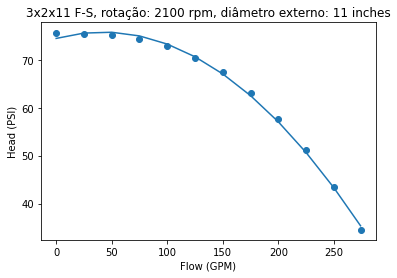

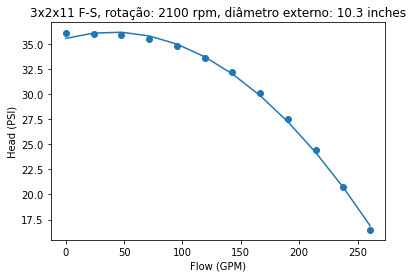

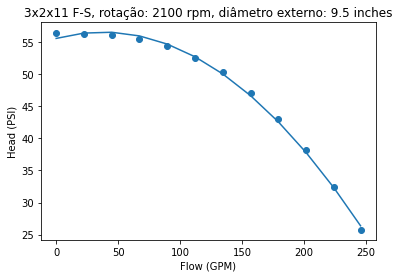

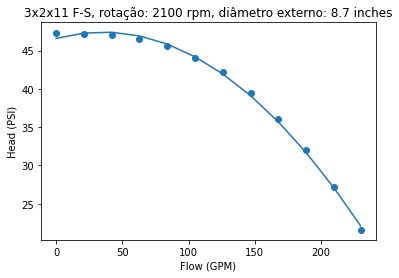

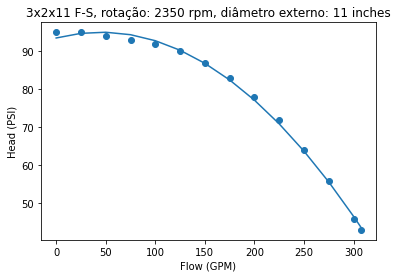

...

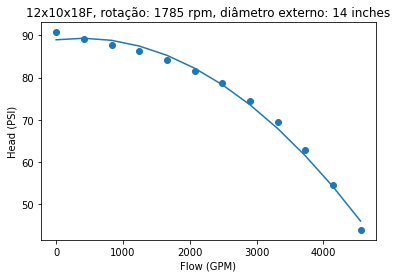

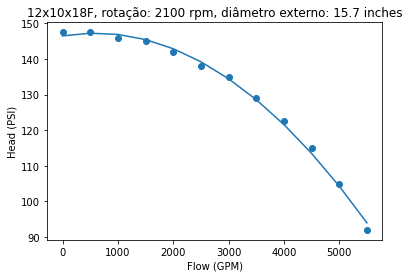

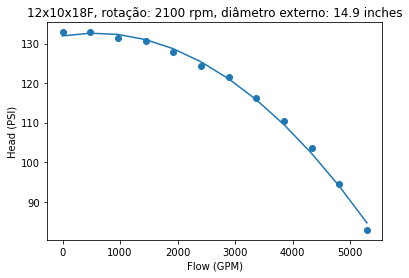

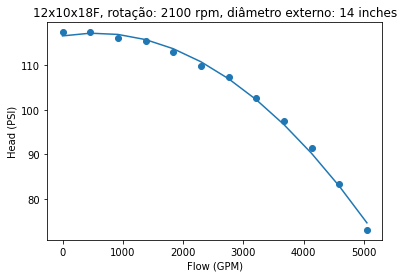

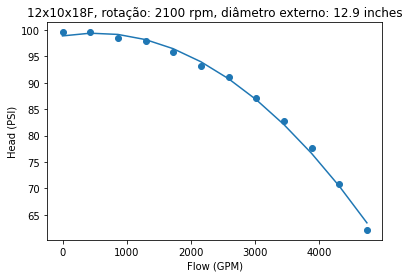

<Figure size 432x288 with 0 Axes>

In [103]:
data = []
for chave in list(dici.keys()):
    
    x = np.array(dici[chave][0])
    y = dici[chave][1]
    p = np.polyfit(x,y,2)
    p = np.flip(p)
    plt.scatter(x,y)
    plt.ylabel('Head (PSI)')
    plt.xlabel('Flow (GPM)')
    plt.title(dici[chave][2][-1]+', rotação: '+str(dici[chave][2][0])+' rpm, diâmetro externo: '+str(dici[chave][2][1])+' inches')
    yn = []
    i = 0
    for cte in p:
        yn.append(cte*x**i)
        i += 1
    plt.plot(x,sum(yn))
    plt.show()
    plt.clf()
    squaredDiffs = np.square(y - sum(yn))
    squaredDiffsFromMean = np.square(y - np.mean(y))
    rSquared = 1 - np.sum(squaredDiffs) / np.sum(squaredDiffsFromMean)
    data.append([dici[chave][2][0],dici[chave][2][1],dici[chave][2][2],dici[chave][2][3],dici[chave][2][4],dici[chave][2][5],dici[chave][2][6],
                dici[chave][2][7],dici[chave][2][8],dici[chave][2][9],p[0],p[1],p[2],dici[chave][0][-1],rSquared])
df_bombas = pd.DataFrame(data, columns=['Rotacao' , 'Dia_externo' , 'Dia_interno_olho' , 'area_entrada','b2','b3', 'Esfera' , 'GD2' , 'N_pas','Modelo',
                                       'a1','a2','a3','xn','r2'])

In [104]:
df_bombas.to_excel('Banco_de_curvas_novo_ajuste.xlsx',index=False)

In [5]:
df_bombas = pd.read_excel('Banco_de_curvas_novo_ajuste.xlsx')

# Separando uma bomba para teste

## Random Forest

In [24]:
y = df_bombas['a3']
scaler = StandardScaler()
y = scaler.fit_transform(np.array(y).reshape(-1,1))
df_bombas['a3_scaled'] = y

In [25]:
df_teste = df_bombas[df_bombas.Modelo.isin(['8x6x10F'])]
df_train = df_bombas[~df_bombas.Modelo.isin(['8x6x10F'])]

## Para a1

In [26]:
X_train1 = df_train[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_train1 = df_train['a1']

X_test1 = df_teste[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_test1 = df_teste['a1']

In [27]:
rf = RandomForestRegressor(random_state = 42)
rf.fit(X_train1,y_train1)

RandomForestRegressor(random_state=42)

In [28]:
rf.score(X_test1,y_test1)

0.8678662039478438

In [29]:
y_pred1 = rf.predict(X_test1)
mean_absolute_error(y_test1,y_pred1)

5.629471112701543

## Para a2

In [30]:
X_train2 = df_train[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_train2 = df_train['a2']

X_test2 = df_teste[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_test2 = df_teste['a2']

In [31]:
rf = RandomForestRegressor(random_state=42)
rf.fit(X_train2,y_train2)

RandomForestRegressor(random_state=42)

In [32]:
rf.score(X_test2,y_test2)

-36.78788165010559

In [33]:
y_pred2 = rf.predict(X_test2)
mean_absolute_error(y_test2,y_pred2)

0.008837810806042873

## Para a3

In [34]:
X_train3 = df_train[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_train3 = df_train['a3_scaled']

X_test3 = df_teste[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_test3 = df_teste['a3_scaled']

In [35]:
rf = RandomForestRegressor(random_state=42)
rf.fit(X_train3,y_train3)

RandomForestRegressor(random_state=42)

In [36]:
rf.score(X_test3,y_test3)

-194.1823982890881

In [37]:
y_pred3 = rf.predict(X_test3)
mean_absolute_error(y_test3,y_pred3)

0.02706965781646431

In [38]:
y_test31 = scaler.inverse_transform(np.array(y_test3).reshape(-1,1))
y_pred31 = scaler.inverse_transform(y_pred3.reshape(-1,1))

## Adicionando xn

In [39]:
X_test4 = df_teste[['Rotacao','Dia_externo','Dia_interno_olho','area_entrada','b2','b3','Esfera','GD2','N_pas']]
y_test4 = df_teste['xn']

In [40]:
df_teste = X_test1
df_teste['a1'] = y_test1
df_teste['a2'] = y_test2
df_teste['a3'] = y_test31
df_teste['xn'] = y_test4
df_teste['a1p'] = y_pred1
df_teste['a2p'] = y_pred2
df_teste['a3p'] = y_pred31

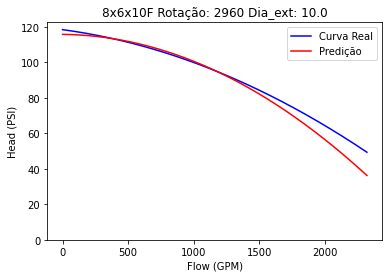

<Figure size 432x288 with 0 Axes>

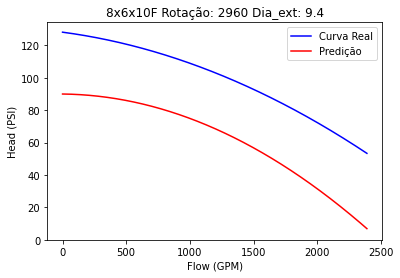

<Figure size 432x288 with 0 Axes>

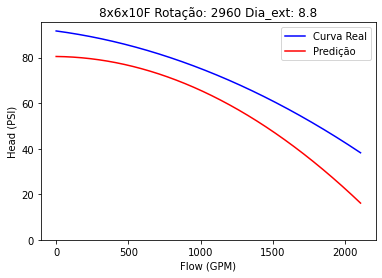

<Figure size 432x288 with 0 Axes>

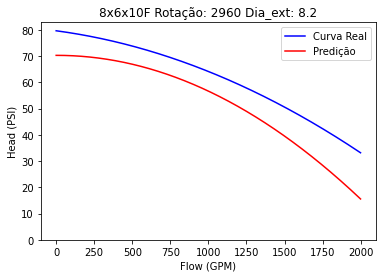

<Figure size 432x288 with 0 Axes>

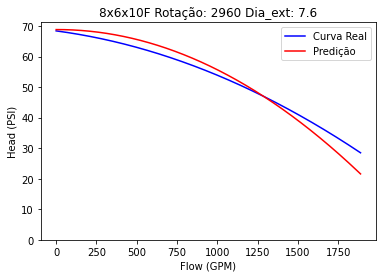

<Figure size 432x288 with 0 Axes>

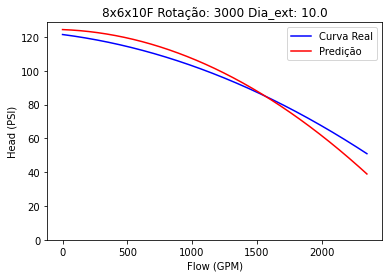

<Figure size 432x288 with 0 Axes>

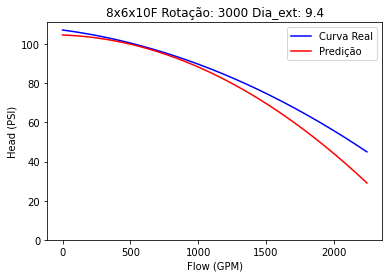

<Figure size 432x288 with 0 Axes>

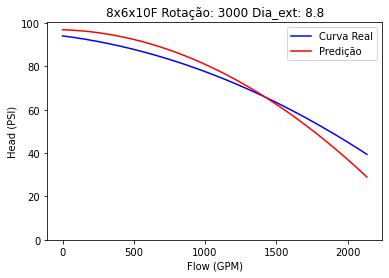

<Figure size 432x288 with 0 Axes>

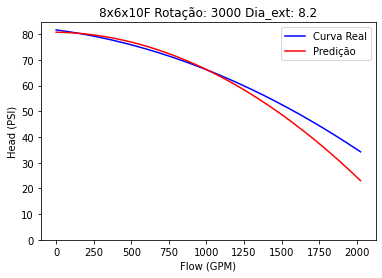

<Figure size 432x288 with 0 Axes>

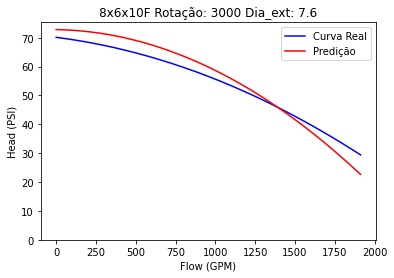

<Figure size 432x288 with 0 Axes>

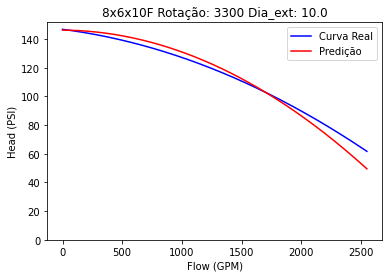

<Figure size 432x288 with 0 Axes>

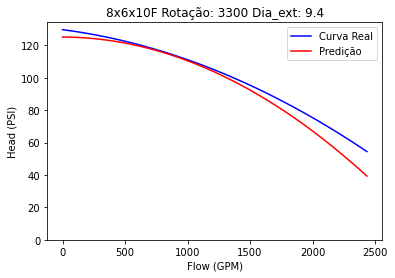

<Figure size 432x288 with 0 Axes>

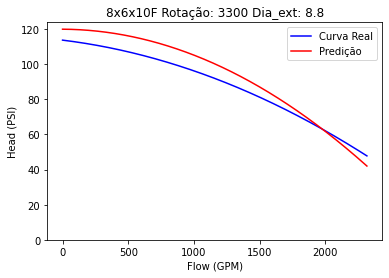

<Figure size 432x288 with 0 Axes>

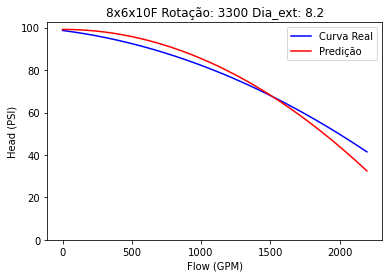

<Figure size 432x288 with 0 Axes>

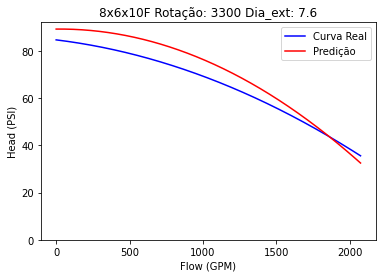

<Figure size 432x288 with 0 Axes>

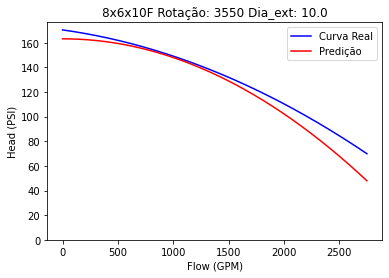

<Figure size 432x288 with 0 Axes>

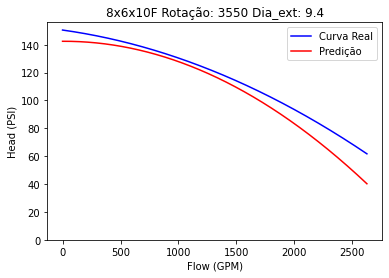

<Figure size 432x288 with 0 Axes>

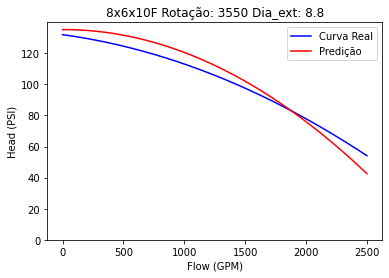

<Figure size 432x288 with 0 Axes>

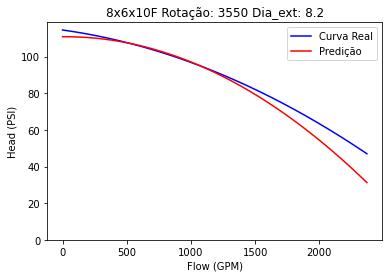

<Figure size 432x288 with 0 Axes>

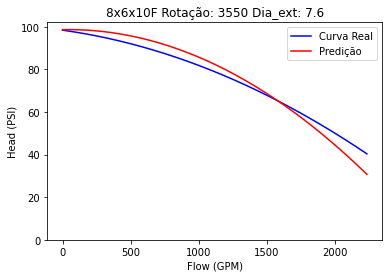

<Figure size 432x288 with 0 Axes>

In [41]:
dici_erro = {}
for indice in df_teste.index:
    eixo_x = []
    valor_real = []
    valor_previsto = []
    erro_abs = []
    erro_rel = []
    #print(X_test.loc[[i]]['Dia_externo'])
    ig, ax = plt.subplots()
    plt.ylabel('Head (PSI)')
    plt.xlabel('Flow (GPM)')
    #plt.title(dici[chave][2][-1]+', rotação: '+str(dici[chave][2][0])+' rpm, diâmetro externo: '+str(dici[chave][2][1])+' inches')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1'][indice],df_teste.loc[[indice]]['a2'][indice],df_teste.loc[[indice]]['a3'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='blue',label = 'Curva Real')
    yn = []
    i = 0
    for cte in [df_teste.loc[[indice]]['a1p'][indice],df_teste.loc[[indice]]['a2p'][indice],df_teste.loc[[indice]]['a3p'][indice]]:
        yn.append(cte*np.arange(df_teste.loc[[indice]]['xn'][indice])**i)
        i += 1
    plt.plot(np.arange(df_teste.loc[[indice]]['xn'][indice]),sum(yn),color='red',label='Predição')
    plt.title(str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Modelo)+' Rotação: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Rotacao)+' Dia_ext: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Dia_externo))
    ax.set_ylim(bottom=0)
    plt.legend()
    plt.show()
    plt.clf()
        
    for valor in np.linspace(0,df_teste.loc[[indice]]['xn'][indice],5):
        valor = int(valor)
        eixo_x.append(valor)
        valor_real.append(df_teste.loc[[indice]]['a1'][indice] + df_teste.loc[[indice]]['a2'][indice]*valor + df_teste.loc[[indice]]['a3'][indice]*valor**2)
        valor_previsto.append(df_teste.loc[[indice]]['a1p'][indice] + df_teste.loc[[indice]]['a2p'][indice]*valor + df_teste.loc[[indice]]['a3p'][indice]*valor**2)
        erro_abs.append(valor_previsto[-1] - valor_real[-1])
        erro_rel.append(erro_abs[-1]/valor_real[-1])
    dici_erro[str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Modelo)+' Rotação: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Rotacao)+' Dia_ext: '+str(df_bombas.iloc[df_teste.loc[[indice]].index[0]].Dia_externo)] = \
    [eixo_x,valor_real,valor_previsto,erro_abs,erro_rel]